# Improvement of learning scheme -- find peaks

In [1]:
#Data processing
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from nptdms import TdmsFile #Process ramping file

#For building ML models
import keras
import keras.models as models
from keras.layers.core import Dense
from keras import regularizers
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from scipy.signal import find_peaks

np.random.seed(1337) # for reproducibility


Bad key "text.kerning_factor" on line 4 in
/uscms_data/d3/dhoang/miniconda3/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test_patch.mplstyle.
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.1.3/matplotlibrc.template
or from the matplotlib source distribution
Using TensorFlow backend.


In [2]:
def load_sensor(dir_path, sensor, time_range = None):
    
    data = pd.DataFrame(data = {sensor: np.load(dir_path + sensor + ".npy"),
                                "time": np.load(dir_path + "time.npy")})
    
    start = min(data["time"])
    end = max(data["time"])
    
    if time_range:
        start = time_range[0]
        end = time_range[1]
    
    
    data = data[(data["time"] > start) & (data["time"] < end)]
   
    %reset -f in
    
    return data[sensor]

def load_time_label(dir_path, time_range, window = 2000, step = 10):
    
    time_label =  np.load(dir_path + "time.npy")
    
    start = min(time_label)
    end = max(time_label)
    
    if time_range:
        start = time_range[0]
        end = time_range[1]
    
    
    time_label = time_label[(time_label > start) & (time_label < end)][window-1::step]
    
    %reset -f in
    
    return time_label

#### Mean of abs(signal)
def generate_mean_data(dir_path, time_range, window = 2000, step = 10):
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    
    #Calculate the product
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_mean = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_mean

#### SD of signal
def generate_sd_data(dir_path, time_range, window = 2000, step = 10):
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    
    #Calculate the product
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_sd = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_sd

#### Thresholded zero crossings
def zero_crossings(array):
    
    #Set values outside of range (0.001, 0.1) = 0
    array[abs(array) > 0.1] = 0
    array[abs(array) < 0.005] = 0
    
    #Calculate number of zero-crossing points, normalized by the window size
    zero_crossings = ((array[:-1] * array[1:]) < 0).sum()/array.size
    
    return zero_crossings


def generate_crossings_data(dir_path, time_range = None, window = 5000, step = 10):
    
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_crossings = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_crossings


def generate_data(dir_path, time_range, window = 2000, thres_win = 25000, step = 10):
    
    #Selection index due to using different window
    selection_index = int((thres_win - window)/step)
    
    moving_mean = generate_mean_data(dir_path, time_range, window = window, step = step)[selection_index:]
    moving_sd = generate_sd_data(dir_path, time_range, window = window, step = step)[selection_index:]
    #moving_thres_crossings = generate_crossings_data(dir_path, time_range, window = thres_win, step = step)
    time_label = load_time_label(dir_path, time_range, window = window, step = step)[selection_index:]
    
    all_data = np.concatenate((moving_mean, moving_sd), axis = 1)
    
    print("All data's shape: ", all_data.shape)
    
    %reset -f in
    
    return all_data, time_label

#####-------INCREMENTAL LEARNING IMPLEMENTATION-------######

def create_model():
    
    #================BUILD THE MODEL====================
    # Simple model
    # Simple model
    model = models.Sequential()

    model.add(Dense(6, activation = 'elu', kernel_initializer='glorot_uniform',
                    kernel_regularizer=regularizers.l2(0.0),
                    input_dim=12))

    model.add(Dense(3,activation='elu',
                    kernel_initializer='glorot_uniform'))

    model.add(Dense(6,activation='elu',
                    kernel_initializer='glorot_uniform'))

    model.add(Dense(12,
                    kernel_initializer='glorot_uniform'))

    model.compile(loss='mse',optimizer='adam')


    return model

def train(current_weights, X, time_axis, time_range):
    """Take a model, train it in the appropritate time range, return the new weights
    and its reconstruction loss distribution"""
    
    print("Training for section: ", time_range)
    #Select the appropriate time
    start_index = None
    
    if time_range[0] is not None:
        start_index = np.argmax(time_axis > time_range[0])
    else:
        start_index = 0
    
    if time_range[1] == 0:
        end_index = None
    else:
        end_index = np.argmax(time_axis > time_range[1])
    
    X_train = np.copy(X[start_index:end_index])
    time_train = time_axis[start_index:end_index]
    
    #Create model
    model = create_model()
    
    if current_weights:
        model.set_weights(current_weights)
    
    #Scaler initiation
    scaler = MinMaxScaler()
    scaler.fit(X_train)
    X_train = scaler.transform(X_train)
    
    #Train the model and extract new weights
    model.fit(X_train, X_train,
              batch_size=2000,
              epochs=30, verbose = 0)
    
    new_weights = model.get_weights()
    
    #Evaluate the losses and update the distribution
    X_pred = model.predict(X_train)
    loss = np.mean(np.abs(X_pred-X_train), axis = 1)
    
    #Plot the reconstruction loss
    plt.figure(figsize=(20,2))
    plt.plot(time_train, loss)
    plt.title("TRAINING reconstruction loss on {}".format(time_range))
    plt.xlabel("Time [s]")
    plt.show()
    
    #Take the mean of the log loss and update the mean threshold
    current_median = np.median(np.log10(loss))
    
    print("Finished training, median of the log(loss) is: ", current_median)
    
    return new_weights, current_median, scaler

def trigger(current_weights, X, time_axis, time_range, prev_median, scaler):
    
    print("Triggering for section: ", time_range)
    print("Using this median for triggering:", prev_median)
    
    #Select the appropriate time
    start_index = None
    
    if time_range[0] is not None:
        start_index = np.argmax(time_axis > time_range[0])
    else:
        start_index = 0
    
    if time_range[1] == 0:
        end_index = None
    else:
        end_index = np.argmax(time_axis > time_range[1])
    
    time_test = time_axis[start_index:end_index]
    X_test = np.copy(X[start_index:end_index])
    
    X_test = scaler.transform(X_test) #Scale the current data
    
    #Create model
    model = create_model()
    model.set_weights(current_weights)
        
    #Find the test loss (doing this in parallel for the sake of simulation), but in a practical system
    #Ideally we need to do inference every single data point come in
    X_pred_test = model.predict(X_test)
    test_loss = np.mean(np.abs(X_pred_test-X_test), axis = 1)
    
    
    #Plot the reconstruction loss just to check
    plt.figure(figsize=(20,2))
    plt.plot(time_test, test_loss)
    plt.title("Reconstruction loss on {}".format(time_range))
    plt.xlabel("Time [s]")
    plt.show()
    
    #Quantify how much each data point is far away from the distribution
    log_test_loss = np.log10(test_loss) - prev_median
    
    #Find the trigger time
    trigger_index = np.argmax(log_test_loss > 2.7)
    
    if  trigger_index != 0:
        #Plot the triggered time
        plt.figure(figsize=(20,2))
        plt.plot(time_test, log_test_loss, color = "firebrick")
        plt.title("Log reconstruction loss on {}".format(time_range))
        plt.xlabel("Time [s]")
        
        #Trigger time
        plt.vlines(time_test[trigger_index], log_test_loss.min(), log_test_loss.max(), color = "blue", linestyles = "dashed", label = "Trigger time")
        plt.legend(loc = "upper left")
        
        
        ### Find trigger times
        peaks, _ = find_peaks(log_test_loss, height=2.7, distance = 5000)
        print("Other trigger time: ", time_test[peaks])
        print("Their log loss values are: ", log_test_loss[peaks])
        
        for i in range(len(peaks)):
            plt.vlines(time_test[peaks[i]], log_test_loss.min(), log_test_loss.max(), color = "blue", linestyles = "dashed")
            
        plt.show()
        
        return list(time_test[peaks])
    
    else:
        return None
    

def simulation(dir_path, section_size, time_range):
    
    #Load data and create the model
    X, time_axis = generate_data(dir_path, time_range = time_range, window = 2000, step = 10)
    
    #For updating model
    current_weights = None
    new_weights = None
    
    #For keeping track of distribution history
    prev_median = None
    updated_median = None
    
    #Keeping track of scaler after training
    past_scaler = None
    
    #Calculate number of sections
    num_section = int(abs(time_range[0])/section_size)
    print("Number of sections:", num_section)
    
    #Keeping log of all the trigger time
    trigger_log = []
    
    #Sequentially go through the data
    for i in range(num_section):
        
        print("Entering sections: ", (-section_size*(num_section - i), -section_size*(num_section - i - 1)))
        print("-------->")
        
        if i == 0:
            continue
        elif i == 1:
            #Train on the first segment
            time_range = (None, -section_size*(num_section - i))
            new_weights, updated_median, new_scaler = train(current_weights, X, time_axis, time_range)
        else:
            
            #Set previous distrubution to the newly trained disttribution
            prev_median = updated_median
            current_scaler = new_scaler
            current_weights = new_weights
            
            #Selecting appropriate time range for training and triggering
            train_time_range = (-section_size*(num_section - i + 1), -section_size*(num_section - i))
            trigger_time_range = (-section_size*(num_section - i), -section_size*(num_section - i - 1))
            
            #Train and predict simutaneously
            new_weights, updated_median, new_scaler = train(current_weights, X, time_axis, train_time_range)
            trigger_time = trigger(current_weights, X, time_axis, trigger_time_range, prev_median, current_scaler)
            
            if trigger_time is not None:
                print("Triggered at: ", trigger_time)
                trigger_log.extend(trigger_time)
        
        print("<--------")
        
    print("Finished simulation, all the triggered times are: ", trigger_log)

## 2.7 threshold, 5 seconds sections

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (897500, 12)
Flushing input history
Number of sections: 18
Entering sections:  (-90, -85)
-------->
Entering sections:  (-85, -80)
-------->
Training for section:  (None, -85)


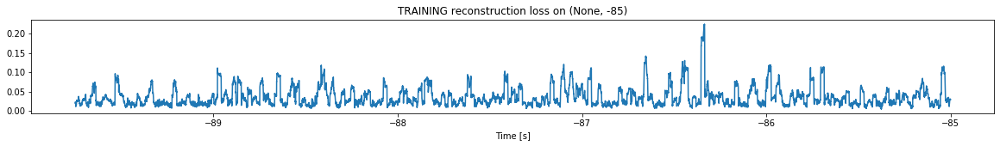

Finished training, median of the log(loss) is:  -1.540265654499489
<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


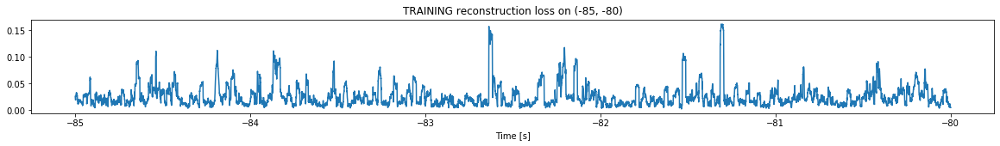

Finished training, median of the log(loss) is:  -1.6899096486865282
Triggering for section:  (-80, -75)
Using this median for triggering: -1.540265654499489


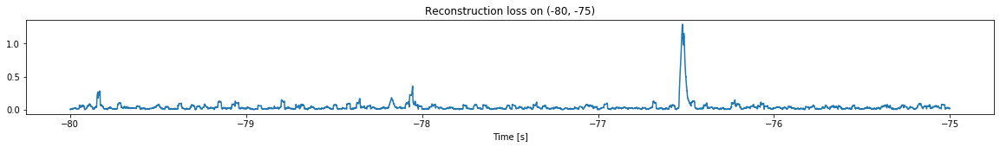

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


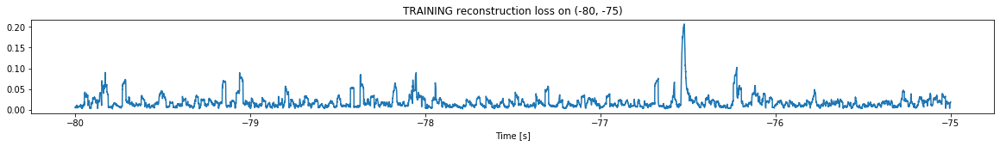

Finished training, median of the log(loss) is:  -1.8522766866281013
Triggering for section:  (-75, -70)
Using this median for triggering: -1.6899096486865282


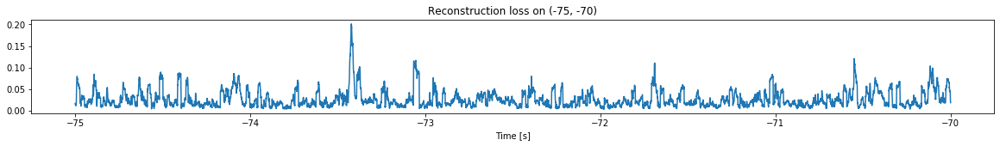

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


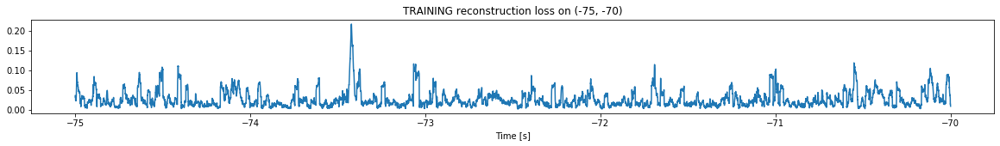

Finished training, median of the log(loss) is:  -1.676276517056488
Triggering for section:  (-70, -65)
Using this median for triggering: -1.8522766866281013


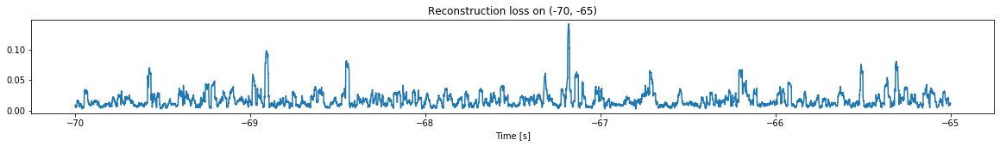

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


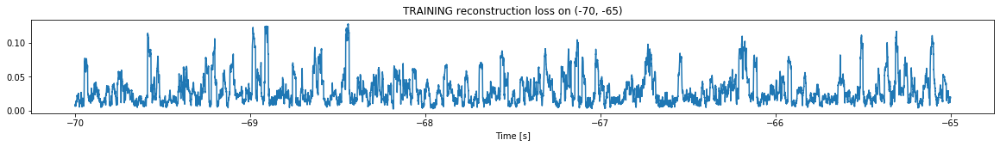

Finished training, median of the log(loss) is:  -1.6164724718960453
Triggering for section:  (-65, -60)
Using this median for triggering: -1.676276517056488


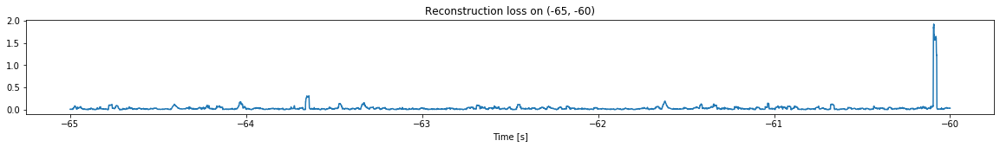

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


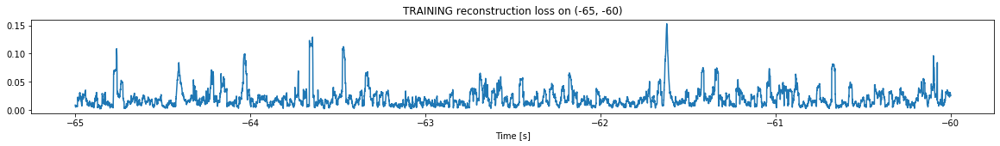

Finished training, median of the log(loss) is:  -1.7753339924901113
Triggering for section:  (-60, -55)
Using this median for triggering: -1.6164724718960453


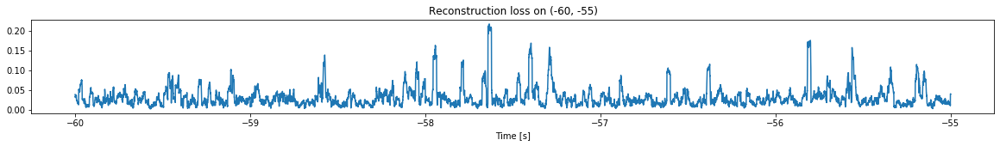

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


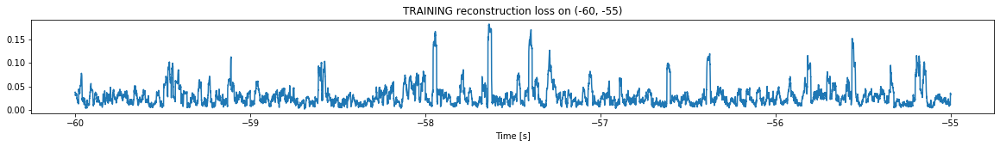

Finished training, median of the log(loss) is:  -1.6290883555884057
Triggering for section:  (-55, -50)
Using this median for triggering: -1.7753339924901113


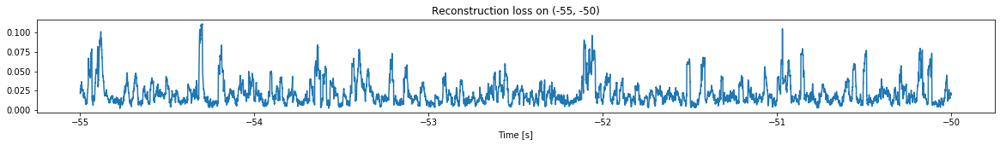

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


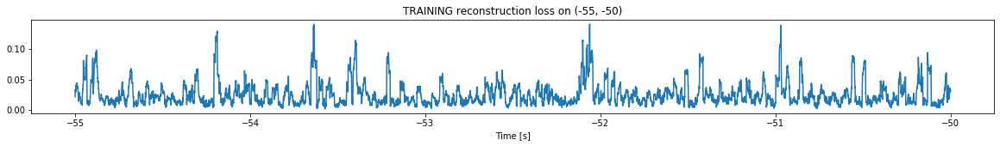

Finished training, median of the log(loss) is:  -1.6977519066124211
Triggering for section:  (-50, -45)
Using this median for triggering: -1.6290883555884057


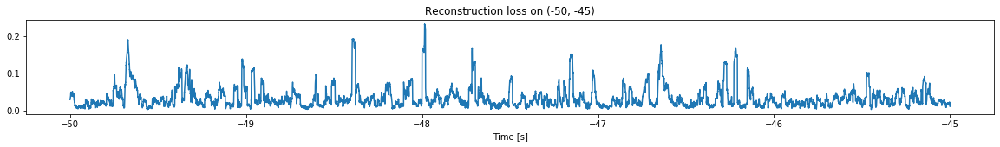

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


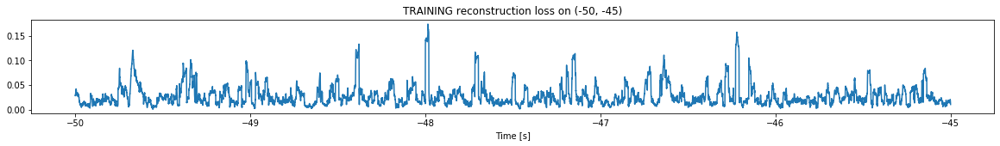

Finished training, median of the log(loss) is:  -1.6529027553473084
Triggering for section:  (-45, -40)
Using this median for triggering: -1.6977519066124211


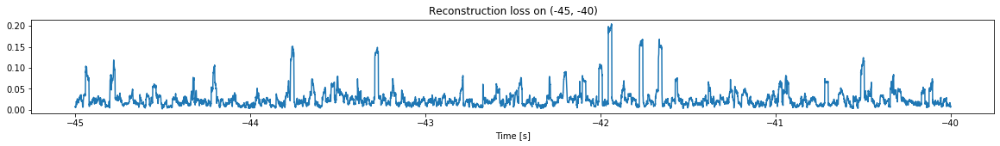

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


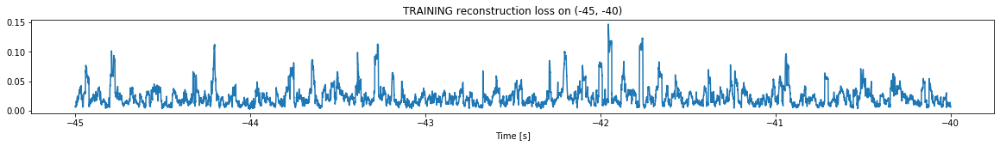

Finished training, median of the log(loss) is:  -1.697693565921241
Triggering for section:  (-40, -35)
Using this median for triggering: -1.6529027553473084


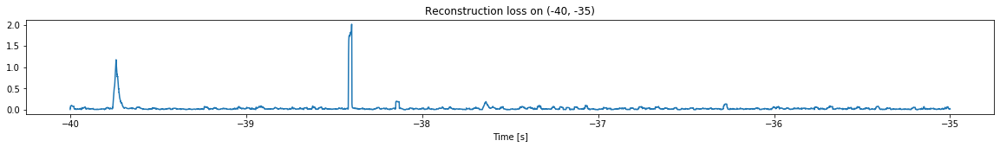

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


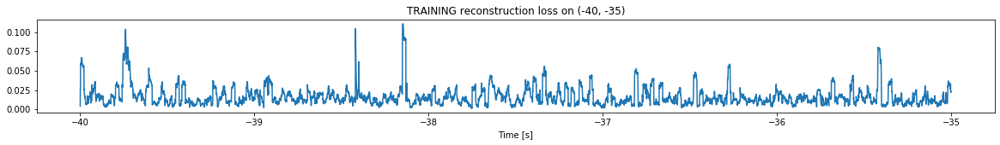

Finished training, median of the log(loss) is:  -1.8774678667325966
Triggering for section:  (-35, -30)
Using this median for triggering: -1.697693565921241


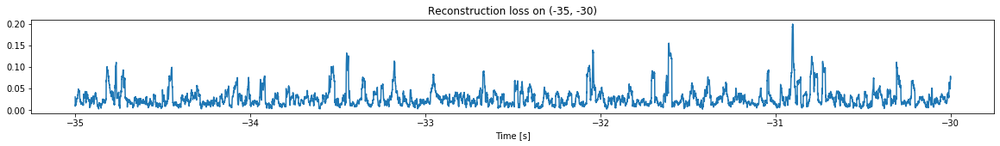

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


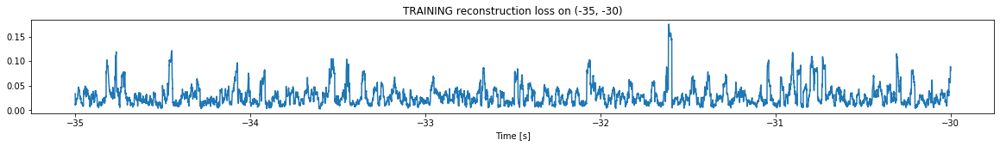

Finished training, median of the log(loss) is:  -1.6069151701083806
Triggering for section:  (-30, -25)
Using this median for triggering: -1.8774678667325966


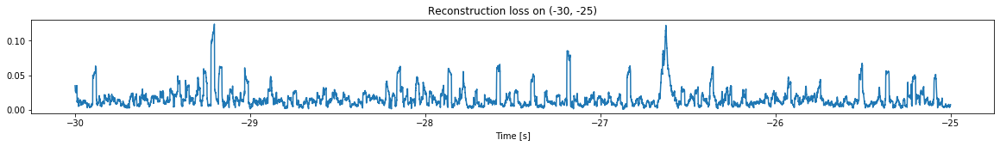

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


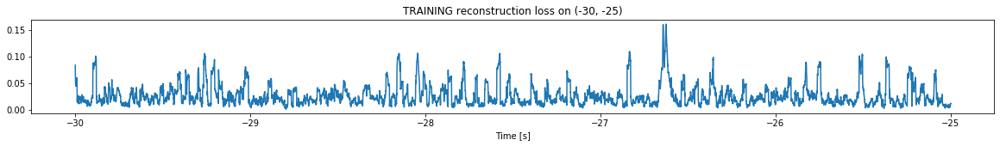

Finished training, median of the log(loss) is:  -1.65798895976252
Triggering for section:  (-25, -20)
Using this median for triggering: -1.6069151701083806


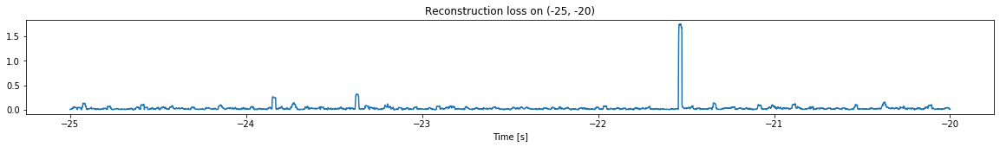

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


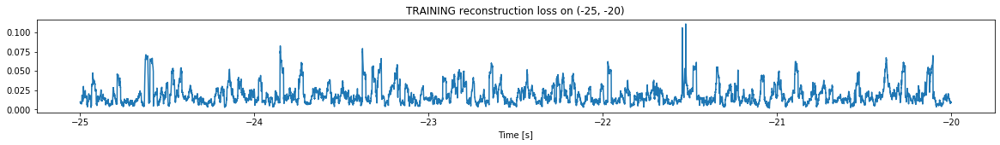

Finished training, median of the log(loss) is:  -1.801737669236417
Triggering for section:  (-20, -15)
Using this median for triggering: -1.65798895976252


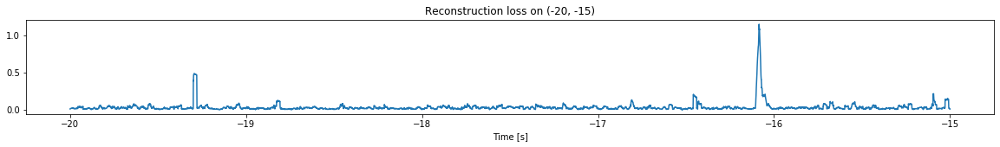

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


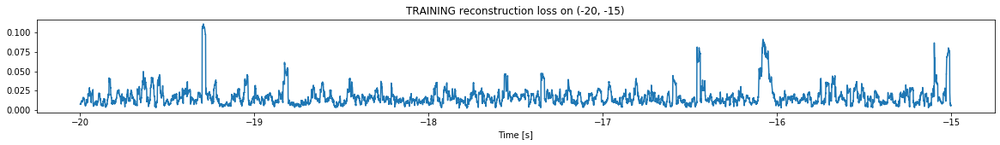

Finished training, median of the log(loss) is:  -1.8470241709548223
Triggering for section:  (-15, -10)
Using this median for triggering: -1.801737669236417


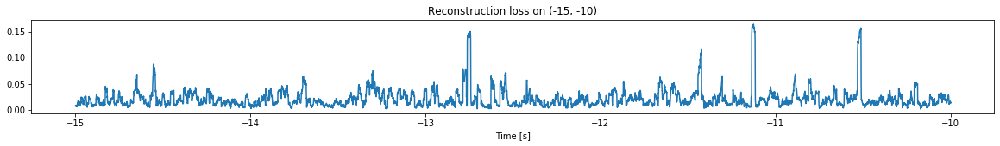

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


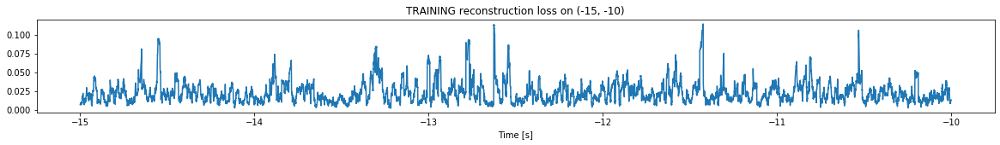

Finished training, median of the log(loss) is:  -1.6868441258532116
Triggering for section:  (-10, -5)
Using this median for triggering: -1.8470241709548223


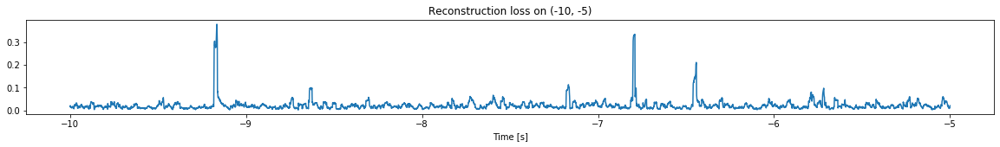

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


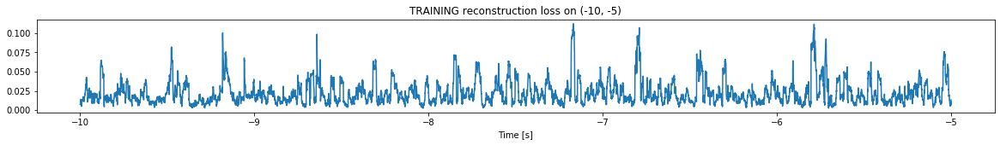

Finished training, median of the log(loss) is:  -1.7312461257129033
Triggering for section:  (-5, 0)
Using this median for triggering: -1.6868441258532116


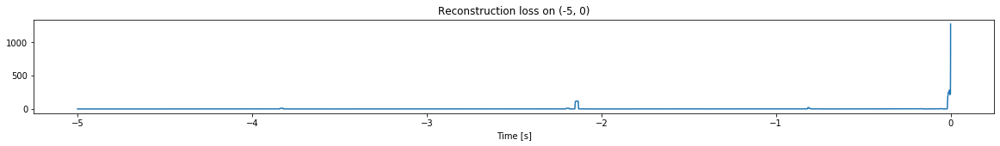

Other trigger time:  [-3.823  -2.1432 -0.8125 -0.006 ]
Their log loss values are:  [2.74907029 3.75843743 3.05568531 4.14010377]


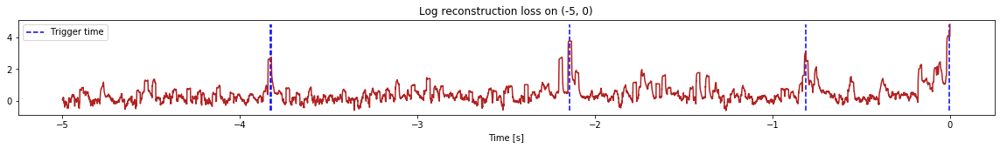

Triggered at:  [-3.823, -2.1432, -0.8125, -0.006]
<--------
Finished simulation, all the triggered times are:  [[-3.823, -2.1432, -0.8125, -0.006]]


In [9]:
simulation("./data/Ramp4/", 5, (-90,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (897500, 12)
Flushing input history
Number of sections: 18
Entering sections:  (-90, -85)
-------->
Entering sections:  (-85, -80)
-------->
Training for section:  (None, -85)


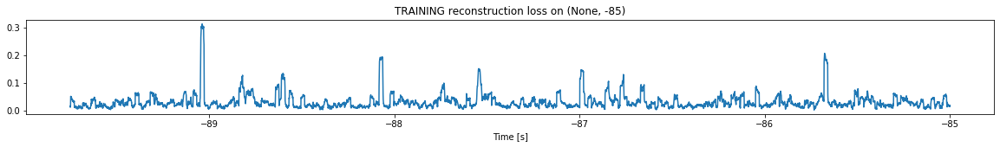

Finished training, median of the log(loss) is:  -1.5917206785216154
<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


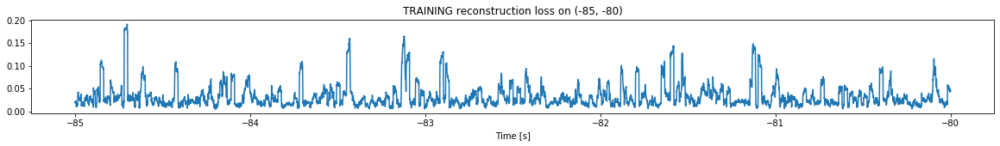

Finished training, median of the log(loss) is:  -1.595754869748034
Triggering for section:  (-80, -75)
Using this median for triggering: -1.5917206785216154


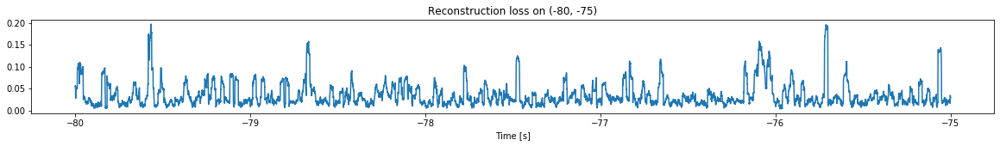

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


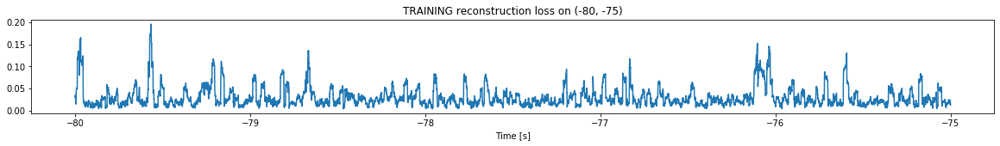

Finished training, median of the log(loss) is:  -1.6228450145329794
Triggering for section:  (-75, -70)
Using this median for triggering: -1.595754869748034


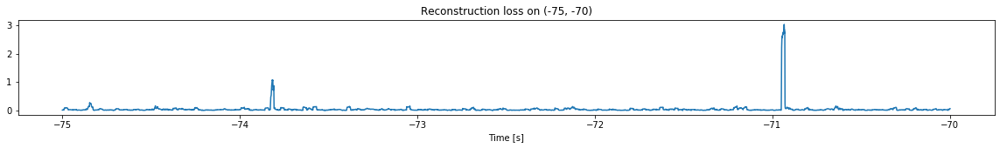

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


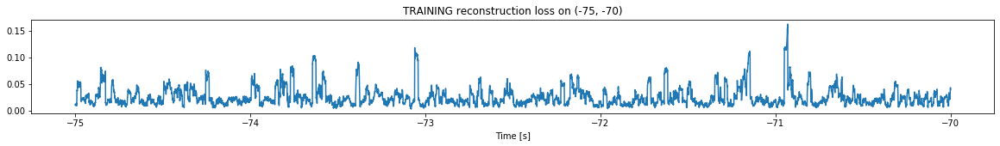

Finished training, median of the log(loss) is:  -1.6872738575015753
Triggering for section:  (-70, -65)
Using this median for triggering: -1.6228450145329794


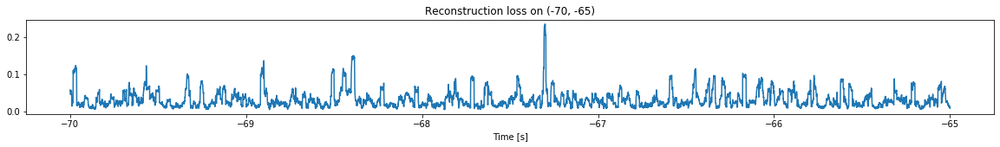

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


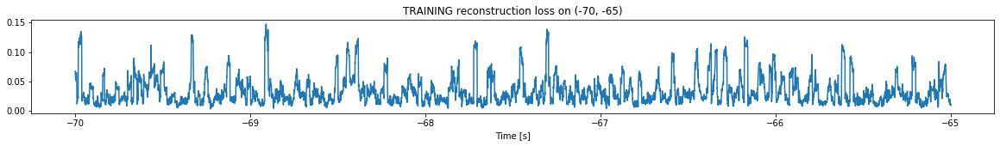

Finished training, median of the log(loss) is:  -1.565207650511491
Triggering for section:  (-65, -60)
Using this median for triggering: -1.6872738575015753


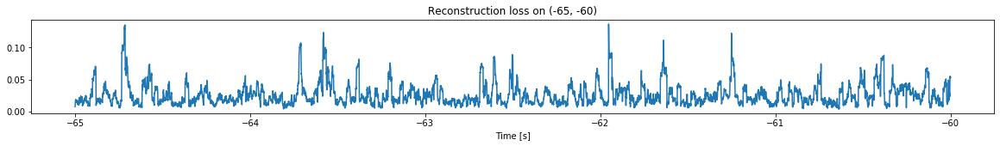

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


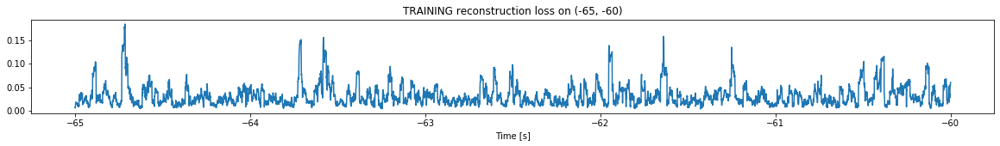

Finished training, median of the log(loss) is:  -1.5816968348985179
Triggering for section:  (-60, -55)
Using this median for triggering: -1.565207650511491


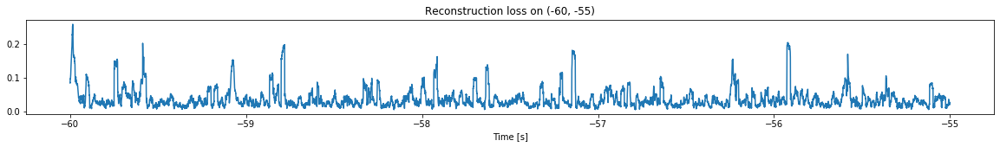

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


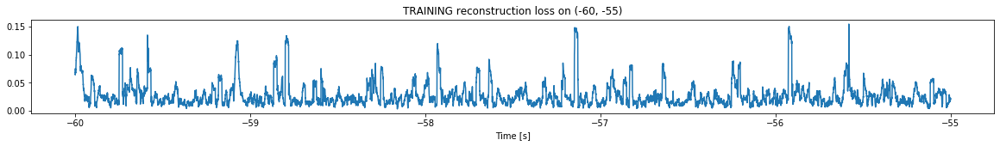

Finished training, median of the log(loss) is:  -1.653160870066745
Triggering for section:  (-55, -50)
Using this median for triggering: -1.5816968348985179


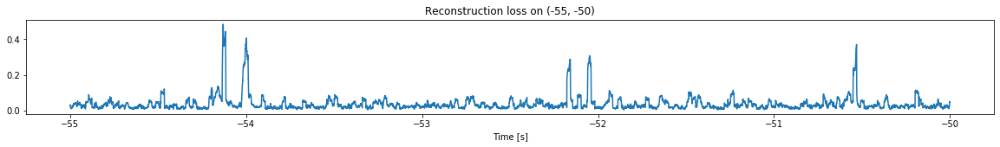

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


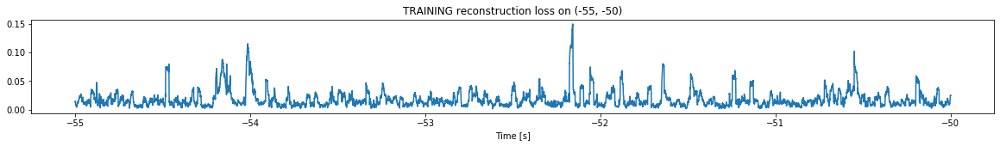

Finished training, median of the log(loss) is:  -1.8621421332537569
Triggering for section:  (-50, -45)
Using this median for triggering: -1.653160870066745


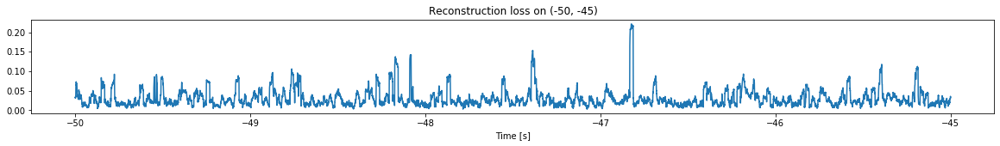

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


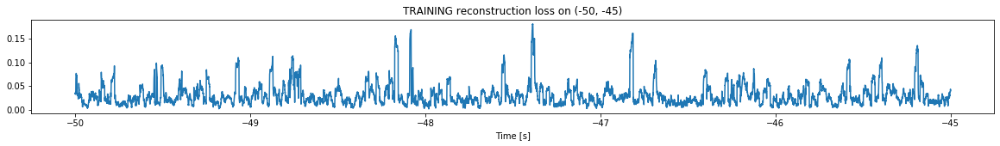

Finished training, median of the log(loss) is:  -1.5974591882818603
Triggering for section:  (-45, -40)
Using this median for triggering: -1.8621421332537569


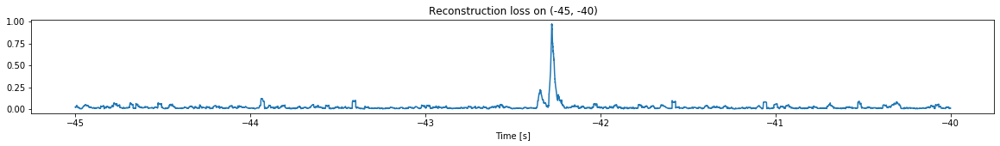

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


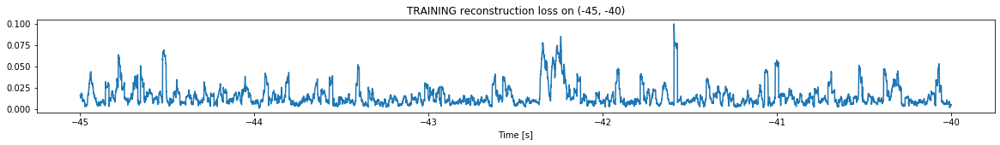

Finished training, median of the log(loss) is:  -1.9338175432467979
Triggering for section:  (-40, -35)
Using this median for triggering: -1.5974591882818603


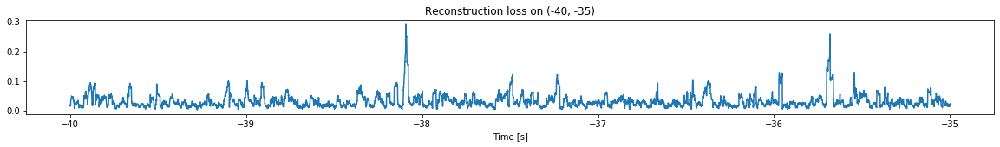

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


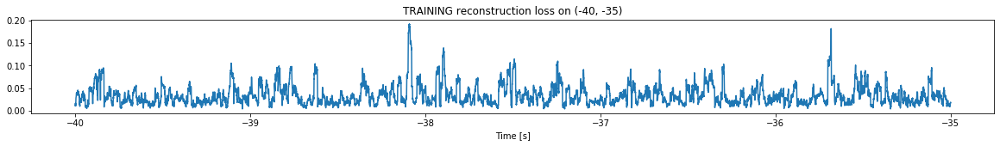

Finished training, median of the log(loss) is:  -1.540100508784154
Triggering for section:  (-35, -30)
Using this median for triggering: -1.9338175432467979


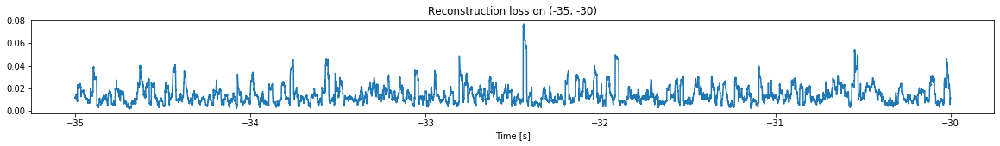

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


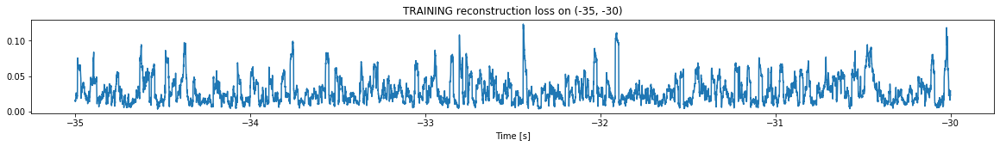

Finished training, median of the log(loss) is:  -1.6033672847337028
Triggering for section:  (-30, -25)
Using this median for triggering: -1.540100508784154


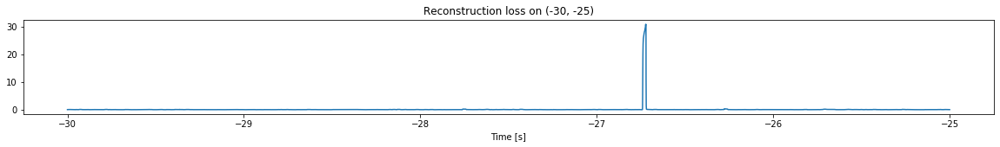

Other trigger time:  [-26.7218]
Their log loss values are:  [3.03066216]


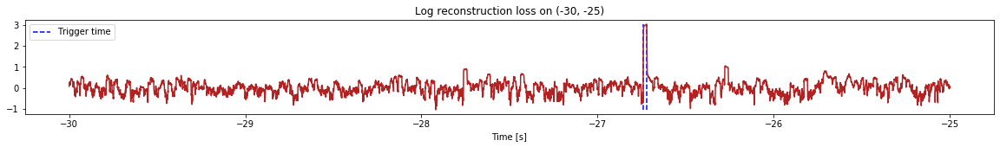

Triggered at:  [-26.7218]
<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


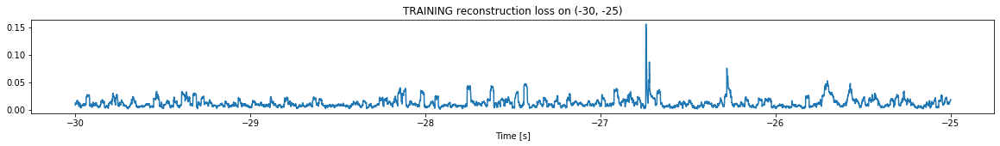

Finished training, median of the log(loss) is:  -2.0168998658955073
Triggering for section:  (-25, -20)
Using this median for triggering: -1.6033672847337028


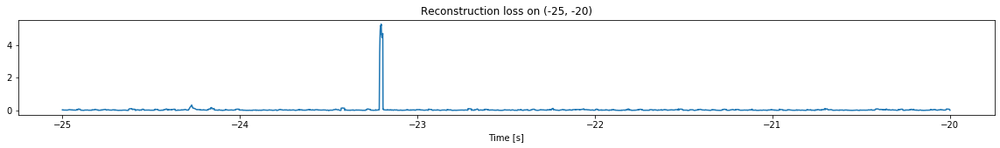

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


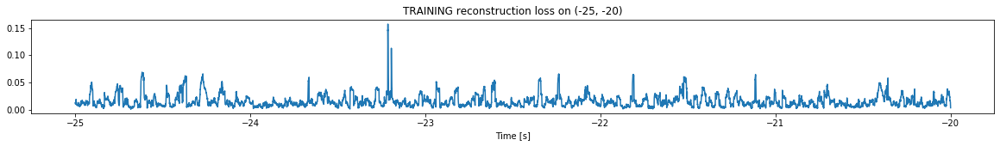

Finished training, median of the log(loss) is:  -1.8760641763649355
Triggering for section:  (-20, -15)
Using this median for triggering: -2.0168998658955073


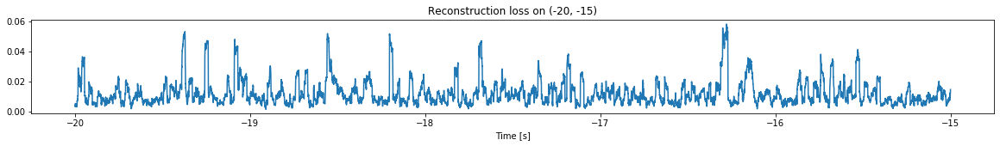

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


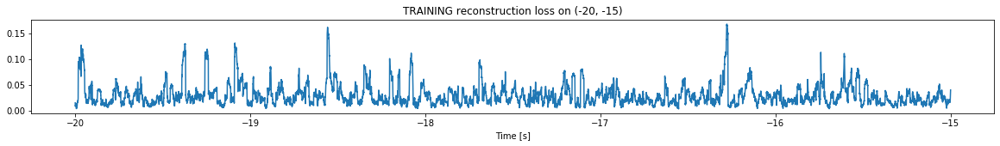

Finished training, median of the log(loss) is:  -1.6039550794728417
Triggering for section:  (-15, -10)
Using this median for triggering: -1.8760641763649355


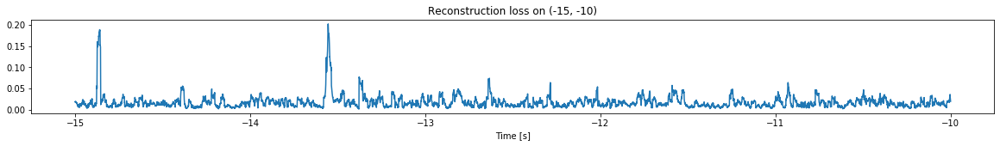

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


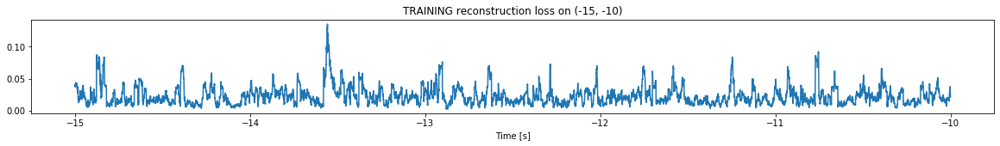

Finished training, median of the log(loss) is:  -1.6968832811928034
Triggering for section:  (-10, -5)
Using this median for triggering: -1.6039550794728417


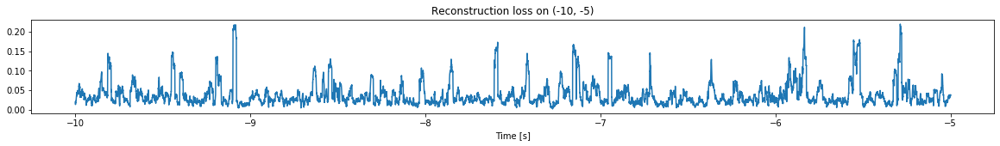

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


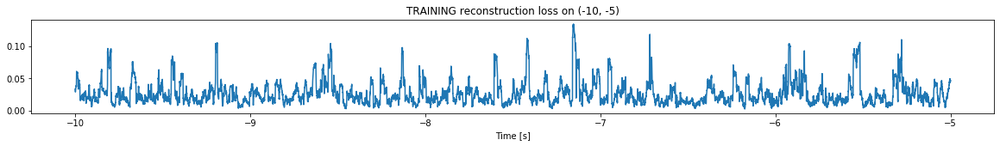

Finished training, median of the log(loss) is:  -1.6578752858250074
Triggering for section:  (-5, 0)
Using this median for triggering: -1.6968832811928034


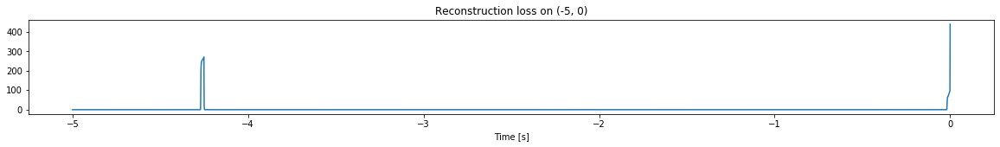

Other trigger time:  [-4.251  -0.0135]
Their log loss values are:  [4.12978695 3.52152421]


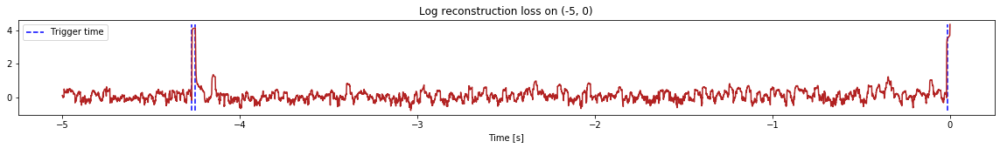

Triggered at:  [-4.251, -0.013499999]
<--------
Finished simulation, all the triggered times are:  [[-26.7218], [-4.251, -0.013499999]]


In [10]:
simulation("./data/Ramp5/", 5, (-90,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (997500, 12)
Flushing input history
Number of sections: 20
Entering sections:  (-100, -95)
-------->
Entering sections:  (-95, -90)
-------->
Training for section:  (None, -95)


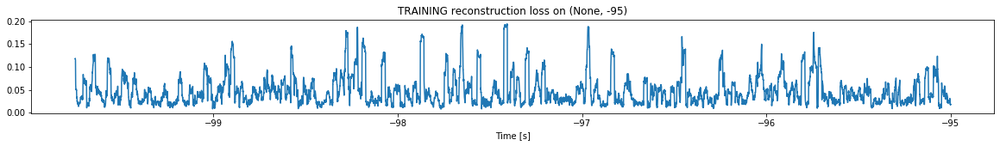

Finished training, median of the log(loss) is:  -1.4068378982755358
<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)


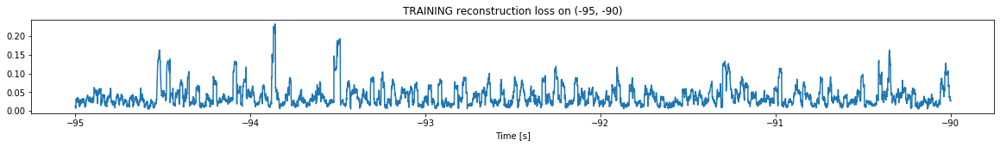

Finished training, median of the log(loss) is:  -1.5002707946102056
Triggering for section:  (-90, -85)
Using this median for triggering: -1.4068378982755358


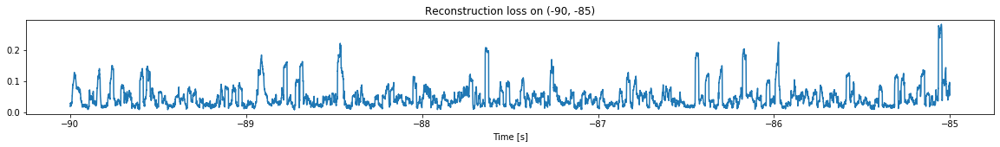

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)


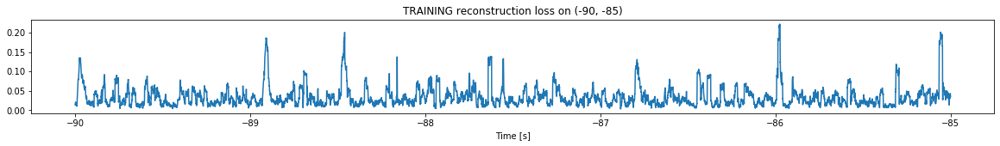

Finished training, median of the log(loss) is:  -1.5706252896054624
Triggering for section:  (-85, -80)
Using this median for triggering: -1.5002707946102056


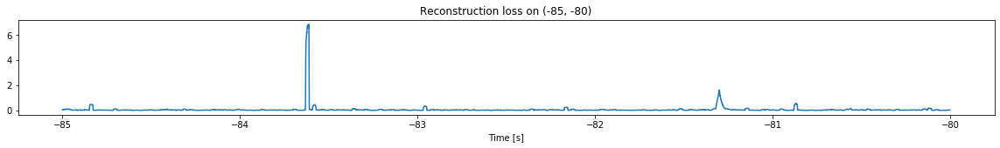

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


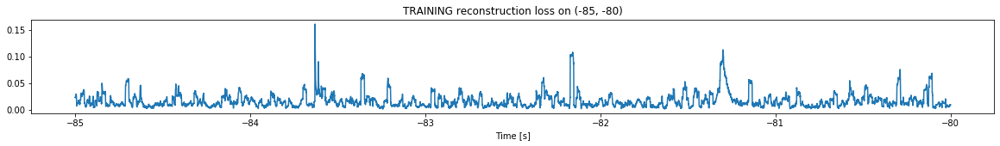

Finished training, median of the log(loss) is:  -1.8739480255663497
Triggering for section:  (-80, -75)
Using this median for triggering: -1.5706252896054624


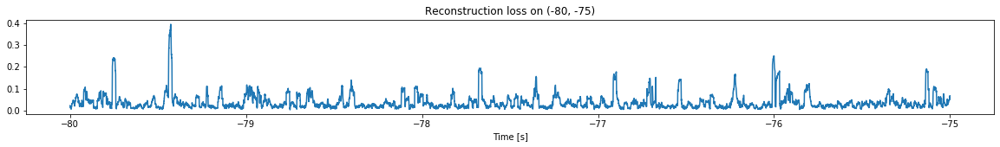

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


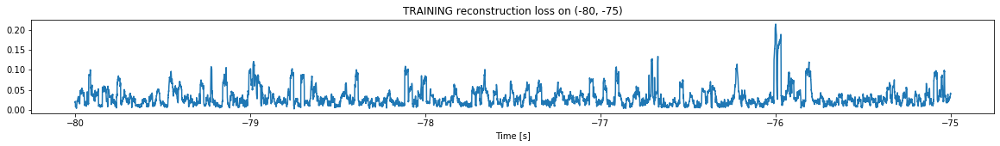

Finished training, median of the log(loss) is:  -1.6164690762178004
Triggering for section:  (-75, -70)
Using this median for triggering: -1.8739480255663497


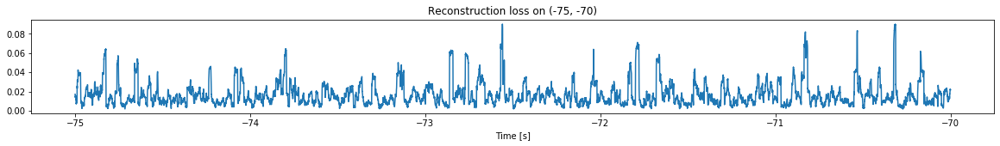

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


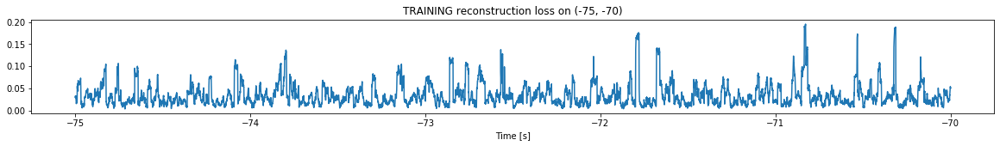

Finished training, median of the log(loss) is:  -1.5544092422425155
Triggering for section:  (-70, -65)
Using this median for triggering: -1.6164690762178004


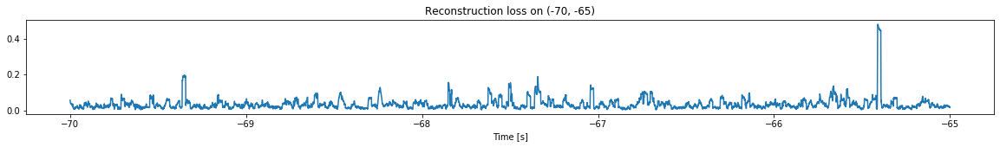

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


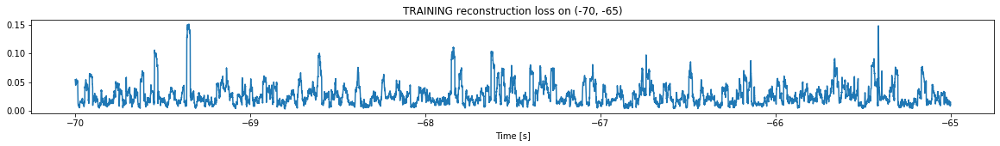

Finished training, median of the log(loss) is:  -1.6418817349457444
Triggering for section:  (-65, -60)
Using this median for triggering: -1.5544092422425155


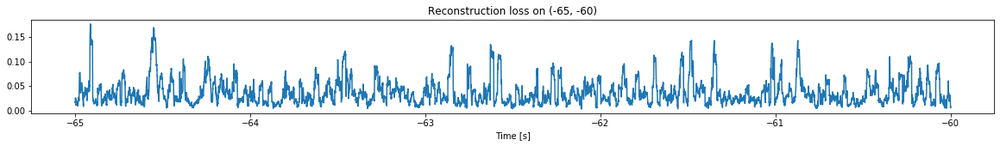

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


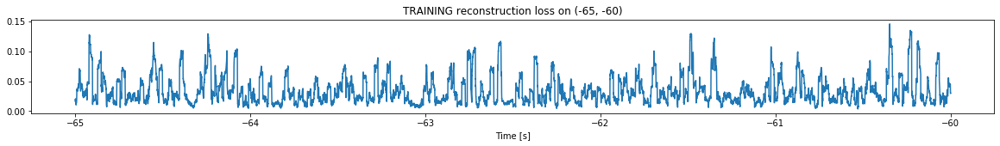

Finished training, median of the log(loss) is:  -1.5519322036029344
Triggering for section:  (-60, -55)
Using this median for triggering: -1.6418817349457444


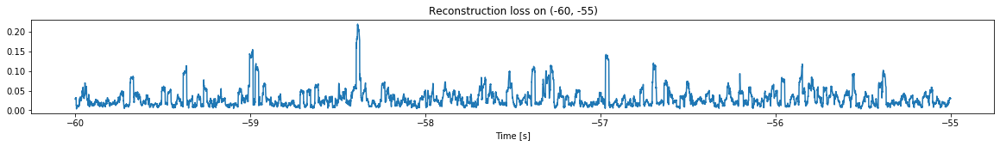

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


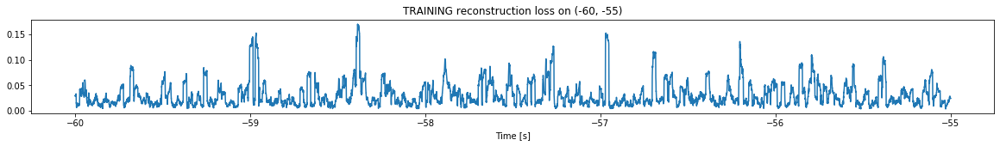

Finished training, median of the log(loss) is:  -1.614989191991516
Triggering for section:  (-55, -50)
Using this median for triggering: -1.5519322036029344


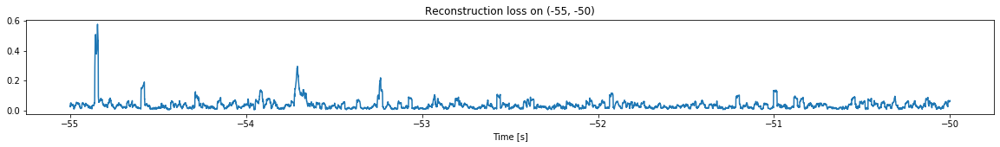

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


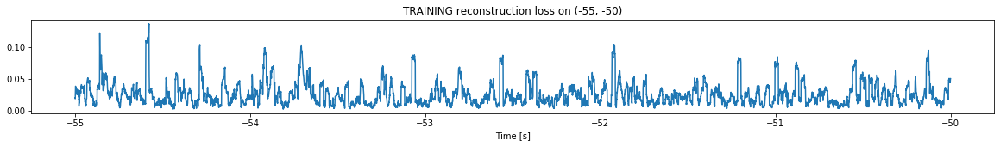

Finished training, median of the log(loss) is:  -1.6513558683877023
Triggering for section:  (-50, -45)
Using this median for triggering: -1.614989191991516


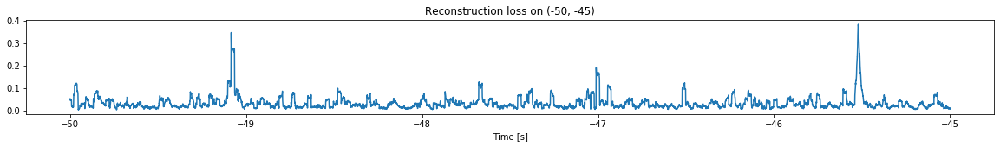

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


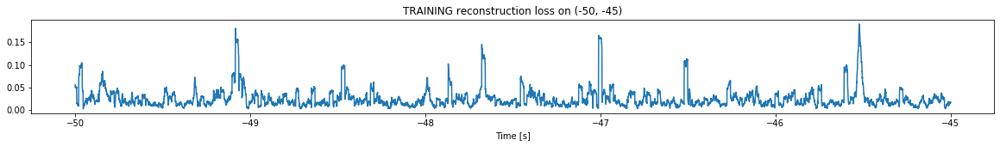

Finished training, median of the log(loss) is:  -1.7024696398847254
Triggering for section:  (-45, -40)
Using this median for triggering: -1.6513558683877023


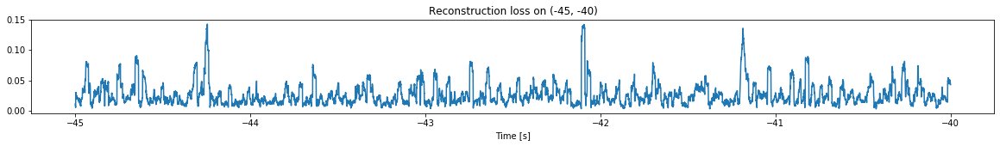

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


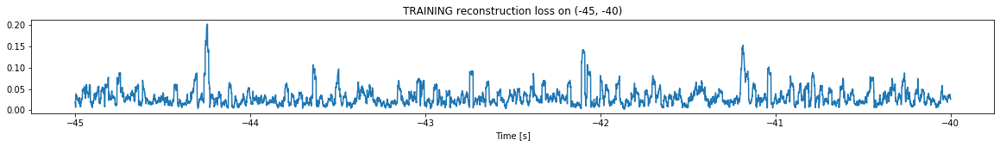

Finished training, median of the log(loss) is:  -1.5812704744560224
Triggering for section:  (-40, -35)
Using this median for triggering: -1.7024696398847254


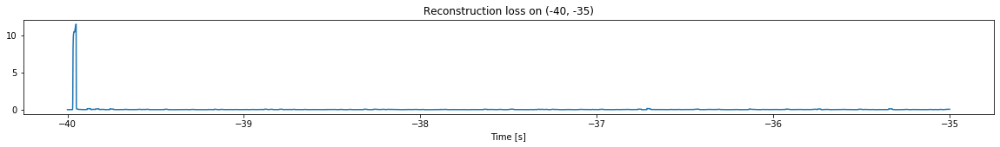

Other trigger time:  [-39.950897]
Their log loss values are:  [2.76506182]


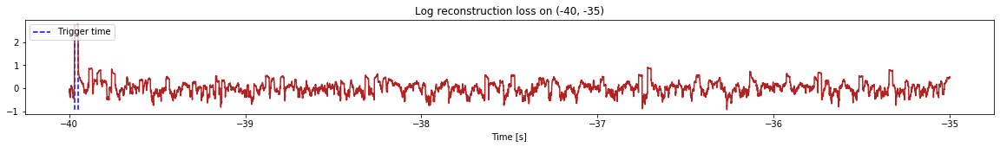

Triggered at:  [-39.950897]
<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


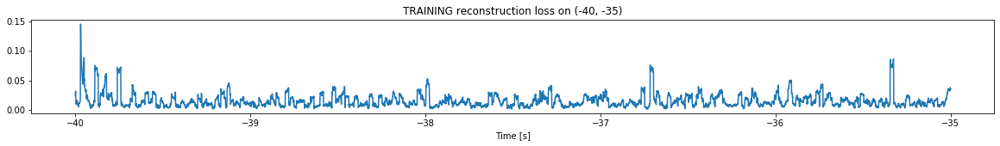

Finished training, median of the log(loss) is:  -1.8928014455830495
Triggering for section:  (-35, -30)
Using this median for triggering: -1.5812704744560224


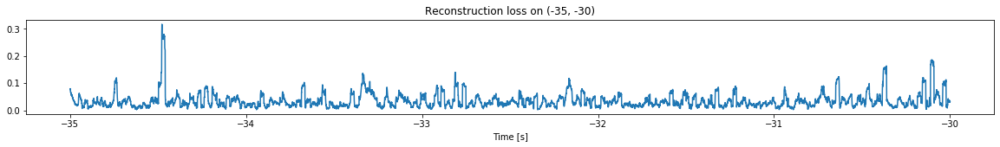

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


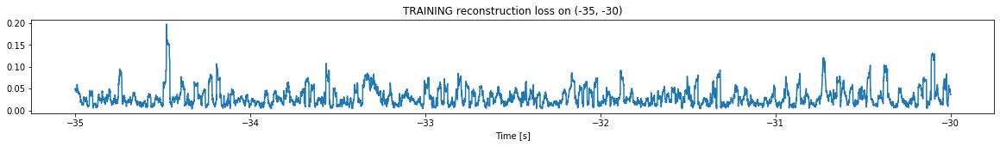

Finished training, median of the log(loss) is:  -1.595758958510582
Triggering for section:  (-30, -25)
Using this median for triggering: -1.8928014455830495


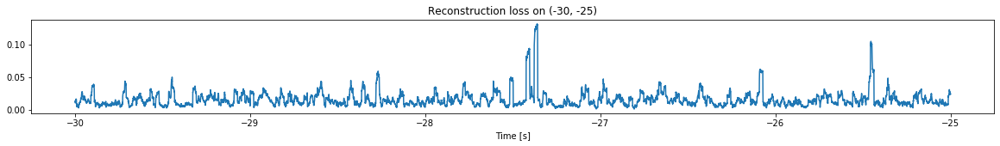

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


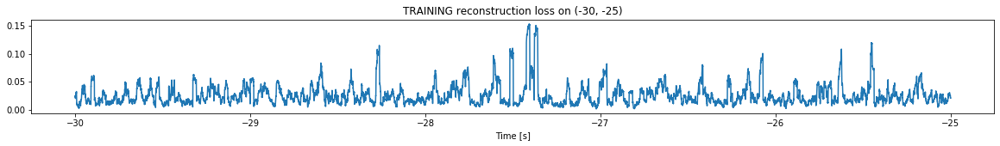

Finished training, median of the log(loss) is:  -1.6658680834517772
Triggering for section:  (-25, -20)
Using this median for triggering: -1.595758958510582


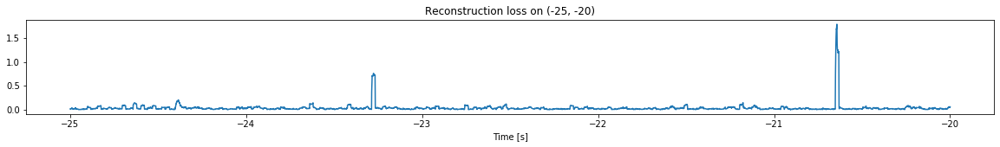

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


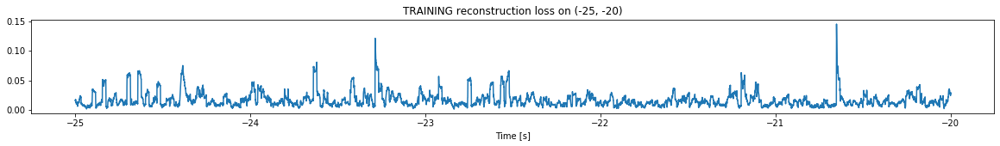

Finished training, median of the log(loss) is:  -1.8474937813152976
Triggering for section:  (-20, -15)
Using this median for triggering: -1.6658680834517772


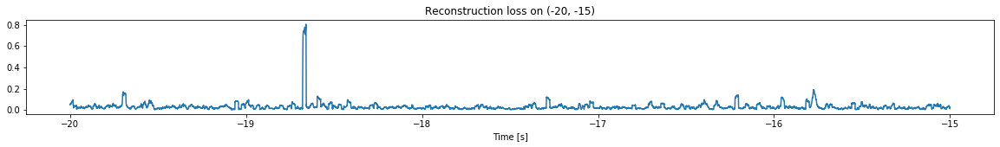

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


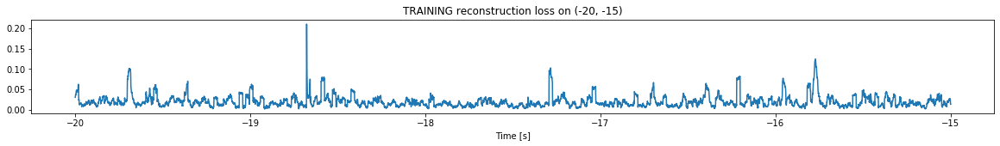

Finished training, median of the log(loss) is:  -1.762625025576641
Triggering for section:  (-15, -10)
Using this median for triggering: -1.8474937813152976


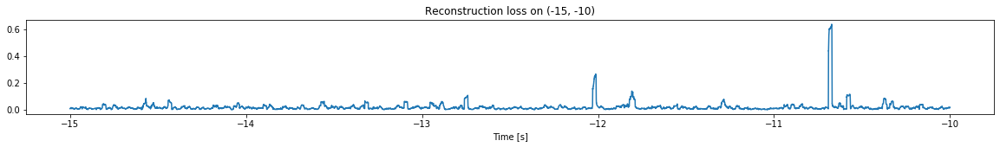

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


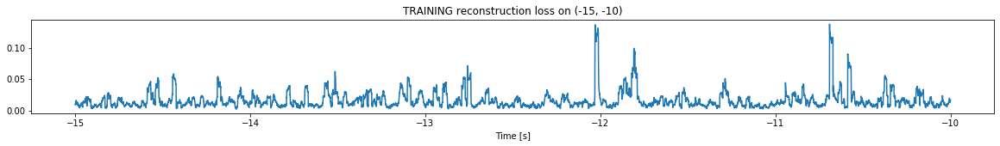

Finished training, median of the log(loss) is:  -1.8869425007445004
Triggering for section:  (-10, -5)
Using this median for triggering: -1.762625025576641


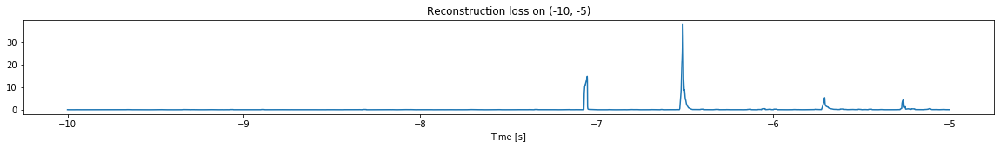

Other trigger time:  [-7.0541997 -6.5119996]
Their log loss values are:  [2.93171412 3.34158253]


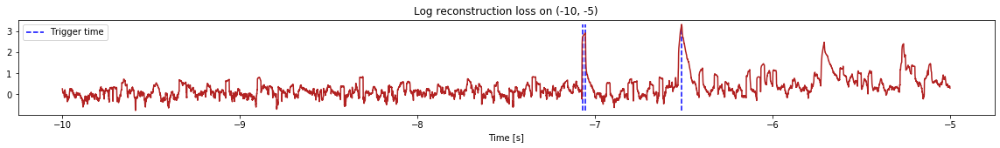

Triggered at:  [-7.0541997, -6.5119996]
<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


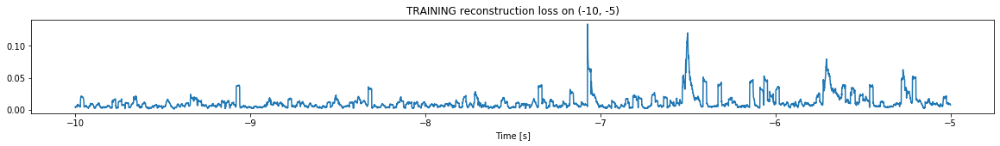

Finished training, median of the log(loss) is:  -2.0777153814427267
Triggering for section:  (-5, 0)
Using this median for triggering: -1.8869425007445004


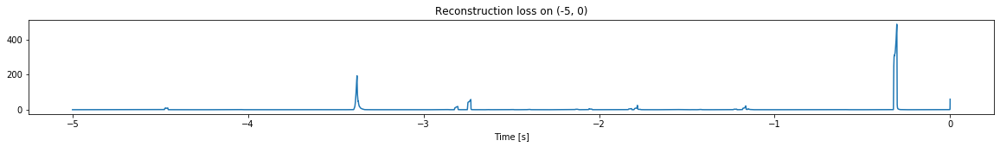

Other trigger time:  [-4.4707     -3.3790998  -2.731      -1.7816     -1.1640999  -0.30359998]
Their log loss values are:  [2.88141402 4.17428481 3.65409824 3.2856462  3.22098443 4.57526048]


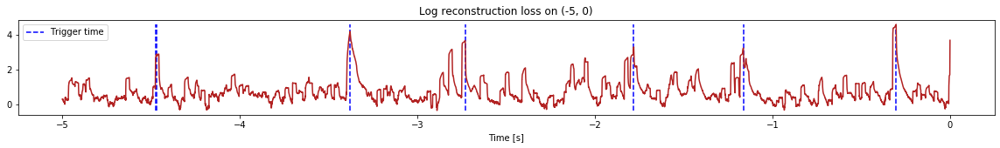

Triggered at:  [-4.4707, -3.3790998, -2.731, -1.7816, -1.1640999, -0.30359998]
<--------
Finished simulation, all the triggered times are:  [[-39.950897], [-7.0541997, -6.5119996], [-4.4707, -3.3790998, -2.731, -1.7816, -1.1640999, -0.30359998]]


In [11]:
simulation("./data/Ramp12d/", 5, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2117500, 12)
Flushing input history
Number of sections: 42
Entering sections:  (-210, -205)
-------->
Entering sections:  (-205, -200)
-------->
Training for section:  (None, -205)


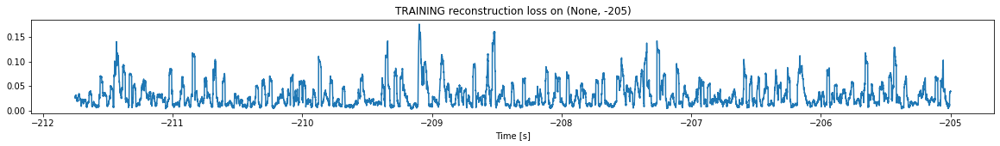

Finished training, median of the log(loss) is:  -1.6269077784104828
<--------
Entering sections:  (-200, -195)
-------->
Training for section:  (-205, -200)


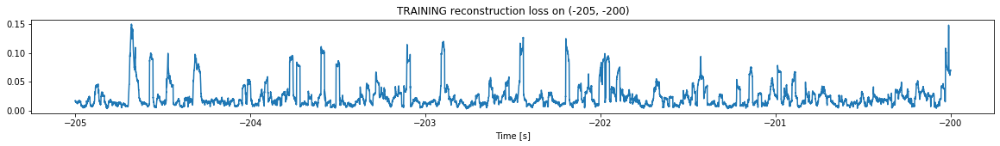

Finished training, median of the log(loss) is:  -1.7543922986936984
Triggering for section:  (-200, -195)
Using this median for triggering: -1.6269077784104828


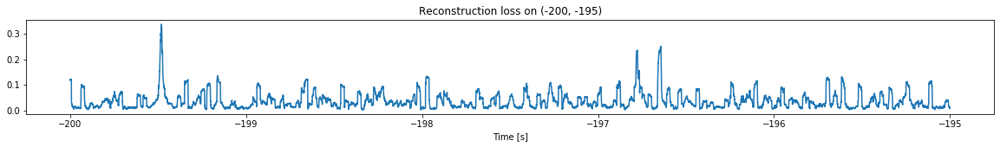

<--------
Entering sections:  (-195, -190)
-------->
Training for section:  (-200, -195)


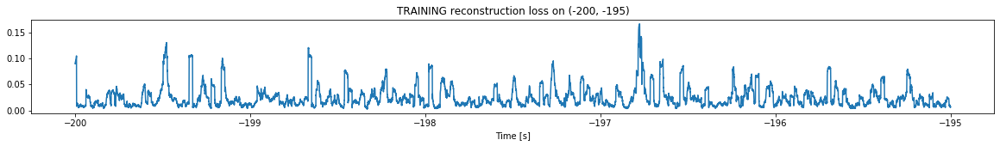

Finished training, median of the log(loss) is:  -1.7166090447621822
Triggering for section:  (-195, -190)
Using this median for triggering: -1.7543922986936984


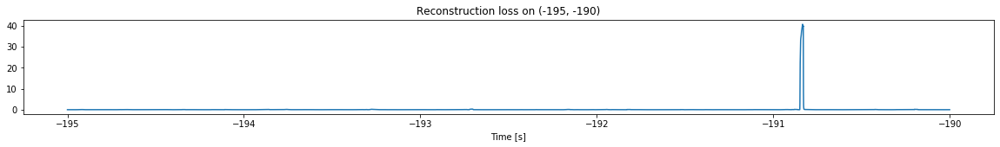

Other trigger time:  [-190.83348]
Their log loss values are:  [3.36554579]


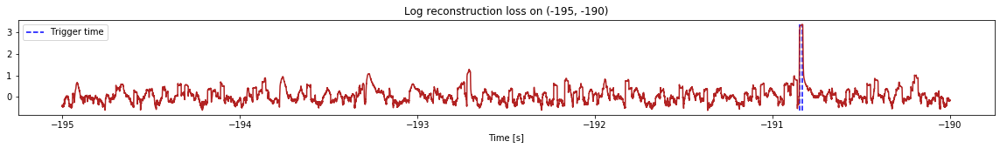

Triggered at:  [-190.83348]
<--------
Entering sections:  (-190, -185)
-------->
Training for section:  (-195, -190)


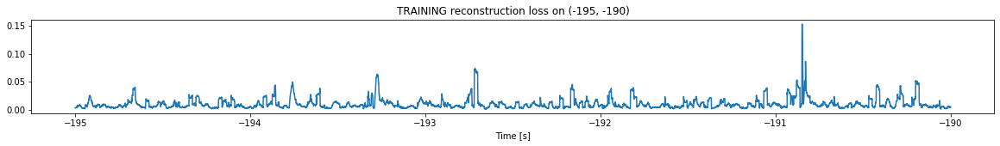

Finished training, median of the log(loss) is:  -2.1233041967777
Triggering for section:  (-190, -185)
Using this median for triggering: -1.7166090447621822


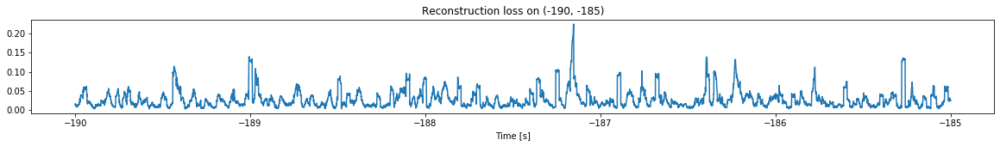

<--------
Entering sections:  (-185, -180)
-------->
Training for section:  (-190, -185)


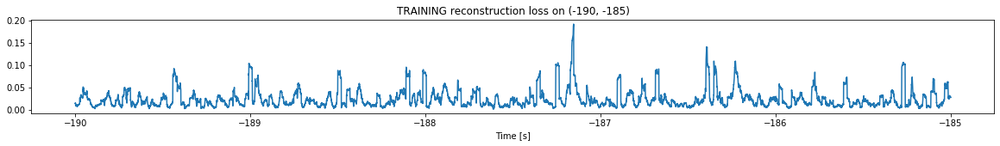

Finished training, median of the log(loss) is:  -1.735111103975377
Triggering for section:  (-185, -180)
Using this median for triggering: -2.1233041967777


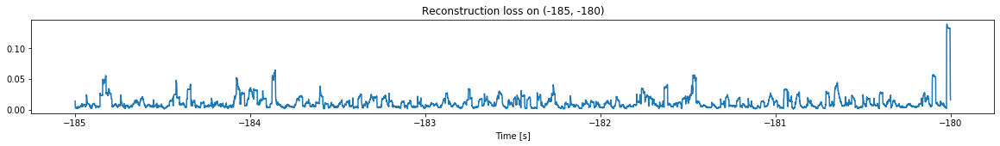

<--------
Entering sections:  (-180, -175)
-------->
Training for section:  (-185, -180)


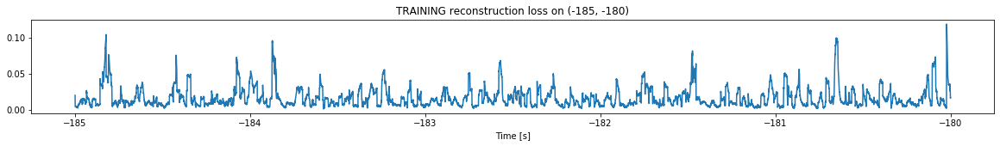

Finished training, median of the log(loss) is:  -1.8814760027855555
Triggering for section:  (-180, -175)
Using this median for triggering: -1.735111103975377


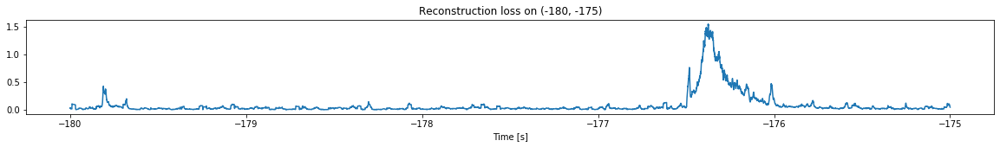

<--------
Entering sections:  (-175, -170)
-------->
Training for section:  (-180, -175)


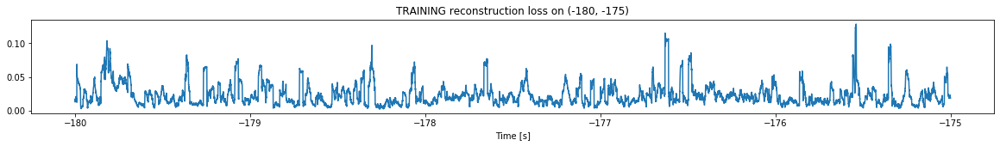

Finished training, median of the log(loss) is:  -1.7111872004808428
Triggering for section:  (-175, -170)
Using this median for triggering: -1.8814760027855555


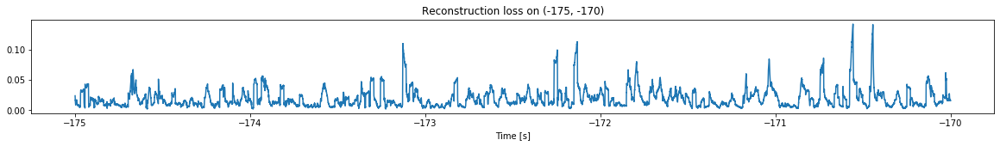

<--------
Entering sections:  (-170, -165)
-------->
Training for section:  (-175, -170)


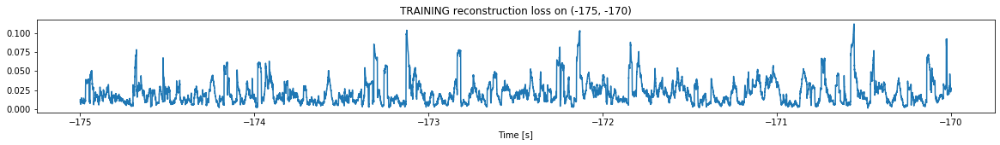

Finished training, median of the log(loss) is:  -1.751858415116066
Triggering for section:  (-170, -165)
Using this median for triggering: -1.7111872004808428


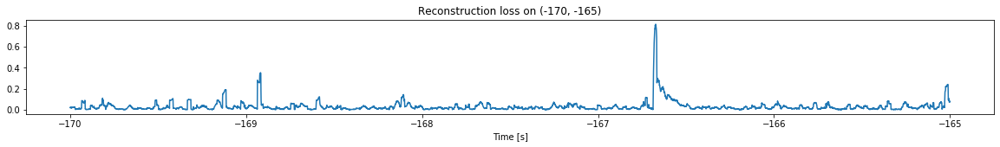

<--------
Entering sections:  (-165, -160)
-------->
Training for section:  (-170, -165)


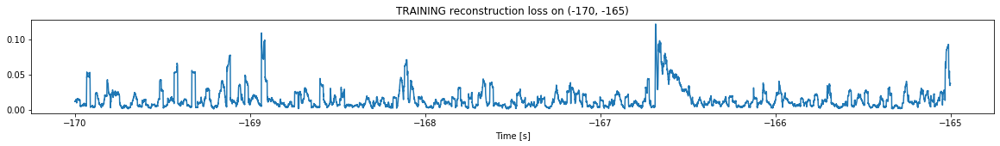

Finished training, median of the log(loss) is:  -1.963054851923011
Triggering for section:  (-165, -160)
Using this median for triggering: -1.751858415116066


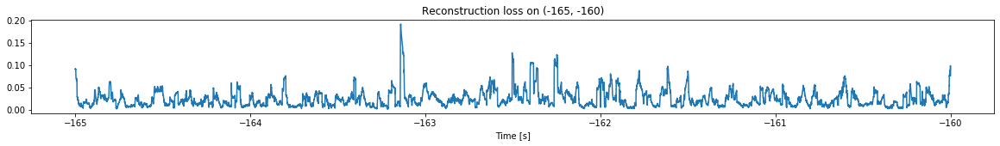

<--------
Entering sections:  (-160, -155)
-------->
Training for section:  (-165, -160)


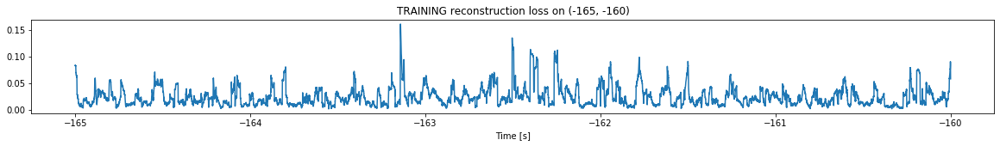

Finished training, median of the log(loss) is:  -1.688833767721459
Triggering for section:  (-160, -155)
Using this median for triggering: -1.963054851923011


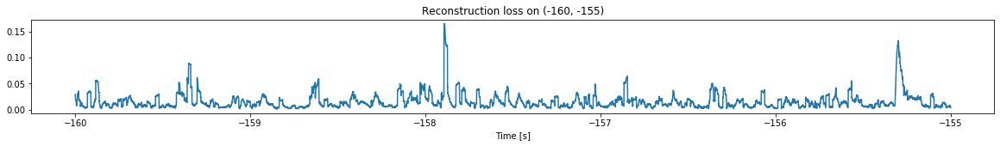

<--------
Entering sections:  (-155, -150)
-------->
Training for section:  (-160, -155)


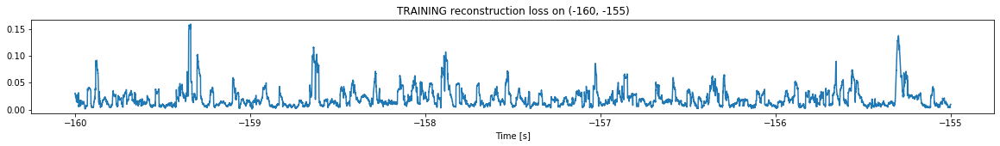

Finished training, median of the log(loss) is:  -1.8011373928414005
Triggering for section:  (-155, -150)
Using this median for triggering: -1.688833767721459


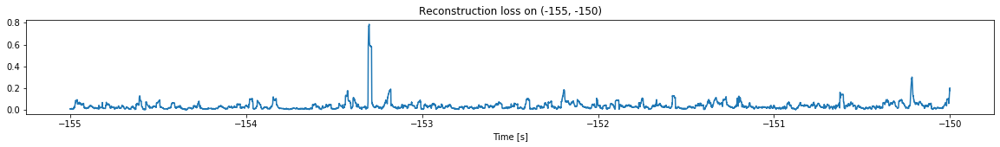

<--------
Entering sections:  (-150, -145)
-------->
Training for section:  (-155, -150)


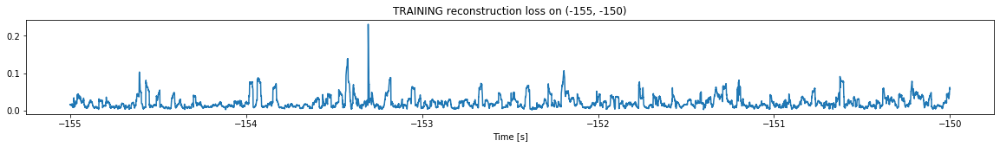

Finished training, median of the log(loss) is:  -1.780549963041205
Triggering for section:  (-150, -145)
Using this median for triggering: -1.8011373928414005


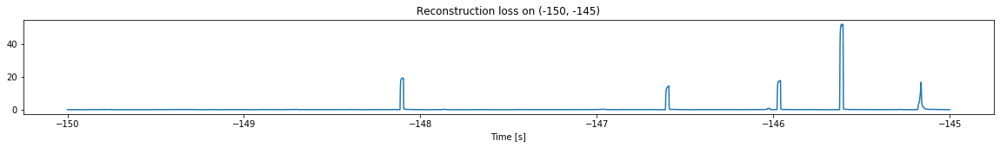

Other trigger time:  [-148.10269 -146.59138 -145.61339]
Their log loss values are:  [3.0892621  2.96242353 3.51908426]


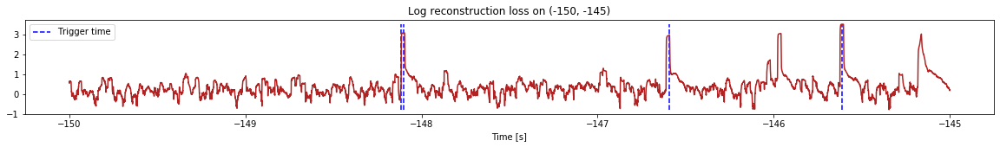

Triggered at:  [-148.10269, -146.59138, -145.61339]
<--------
Entering sections:  (-145, -140)
-------->
Training for section:  (-150, -145)


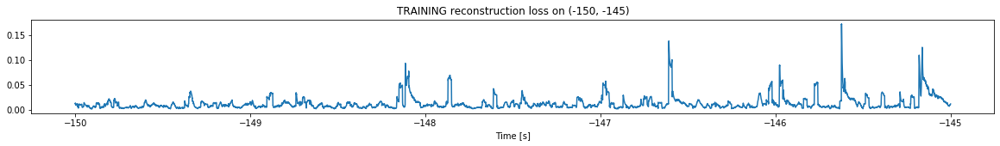

Finished training, median of the log(loss) is:  -2.0622276355587648
Triggering for section:  (-145, -140)
Using this median for triggering: -1.780549963041205


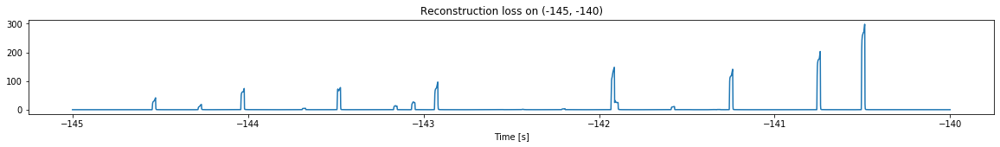

Other trigger time:  [-144.52678 -144.02179 -143.47359 -142.9188  -141.91309 -141.23909
 -140.48679]
Their log loss values are:  [3.39867993 3.64977103 3.6687817  3.76560538 3.95086494 3.93035545
 4.25504624]


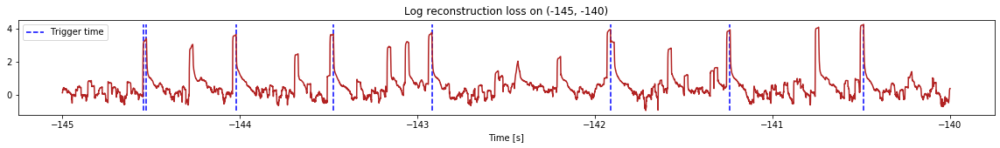

Triggered at:  [-144.52678, -144.02179, -143.47359, -142.9188, -141.91309, -141.23909, -140.48679]
<--------
Entering sections:  (-140, -135)
-------->
Training for section:  (-145, -140)


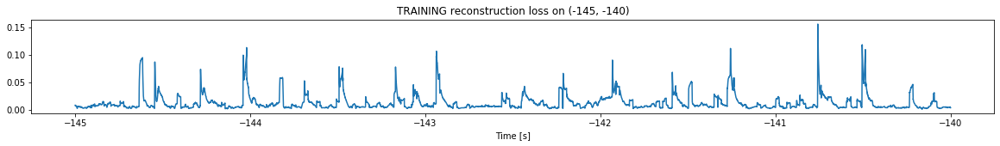

Finished training, median of the log(loss) is:  -2.1031721428092043
Triggering for section:  (-140, -135)
Using this median for triggering: -2.0622276355587648


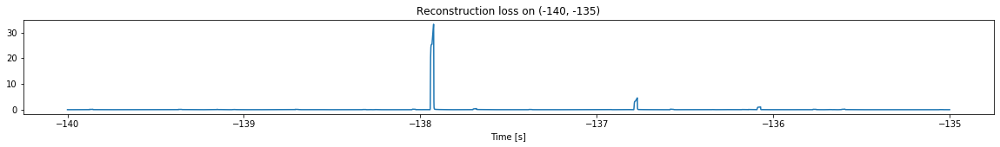

Other trigger time:  [-137.92479 -136.77028]
Their log loss values are:  [3.58358266 2.72497308]


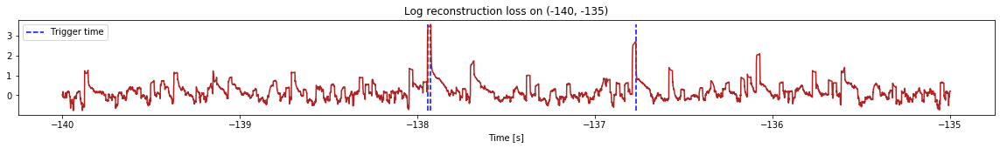

Triggered at:  [-137.92479, -136.77028]
<--------
Entering sections:  (-135, -130)
-------->
Training for section:  (-140, -135)


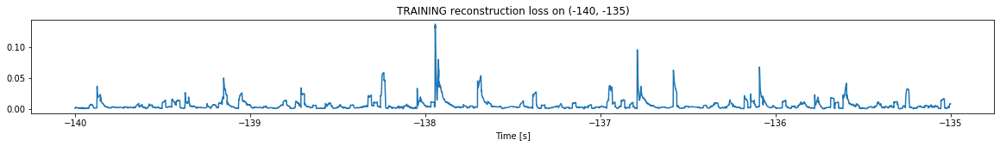

Finished training, median of the log(loss) is:  -2.387760638516924
Triggering for section:  (-135, -130)
Using this median for triggering: -2.1031721428092043


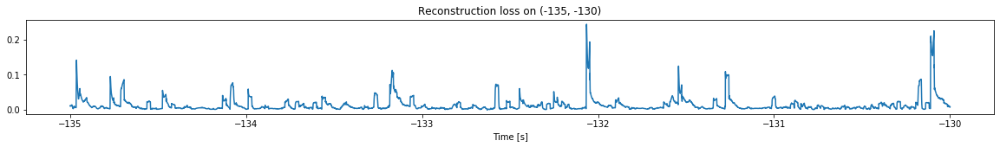

<--------
Entering sections:  (-130, -125)
-------->
Training for section:  (-135, -130)


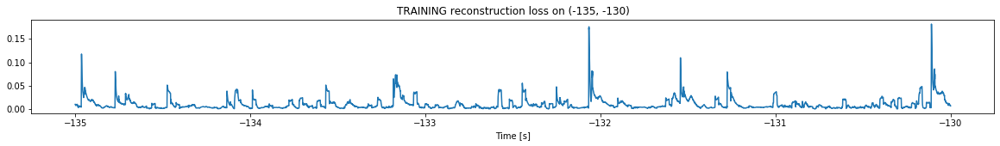

Finished training, median of the log(loss) is:  -2.1945972041417776
Triggering for section:  (-130, -125)
Using this median for triggering: -2.387760638516924


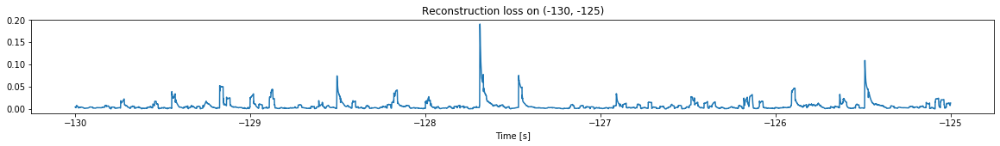

<--------
Entering sections:  (-125, -120)
-------->
Training for section:  (-130, -125)


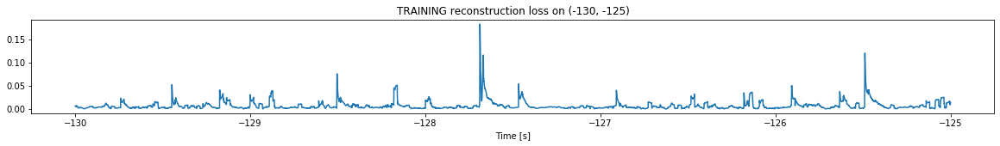

Finished training, median of the log(loss) is:  -2.3039661733977823
Triggering for section:  (-125, -120)
Using this median for triggering: -2.1945972041417776


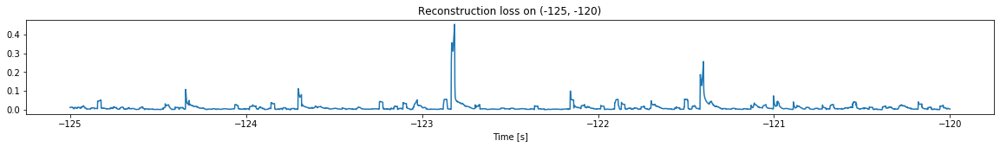

<--------
Entering sections:  (-120, -115)
-------->
Training for section:  (-125, -120)


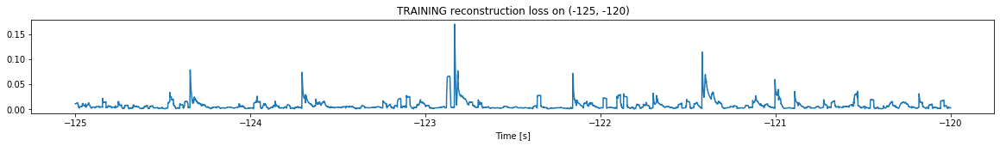

Finished training, median of the log(loss) is:  -2.2934887186328146
Triggering for section:  (-120, -115)
Using this median for triggering: -2.3039661733977823


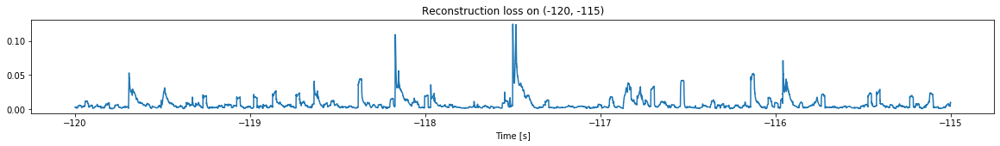

<--------
Entering sections:  (-115, -110)
-------->
Training for section:  (-120, -115)


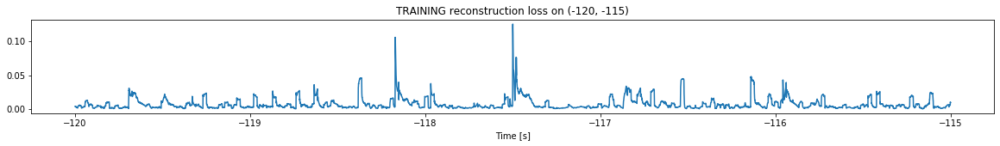

Finished training, median of the log(loss) is:  -2.3055281827908782
Triggering for section:  (-115, -110)
Using this median for triggering: -2.2934887186328146


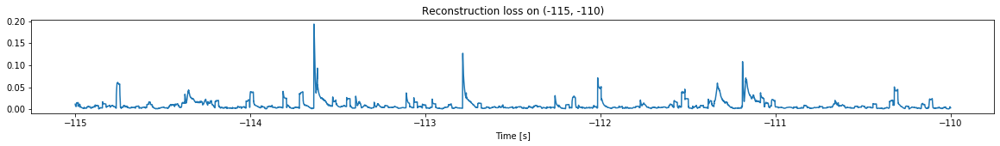

<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)


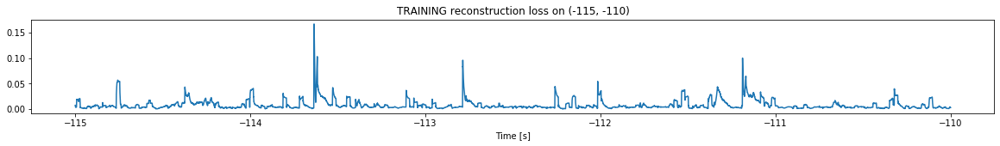

Finished training, median of the log(loss) is:  -2.297367524528267
Triggering for section:  (-110, -105)
Using this median for triggering: -2.3055281827908782


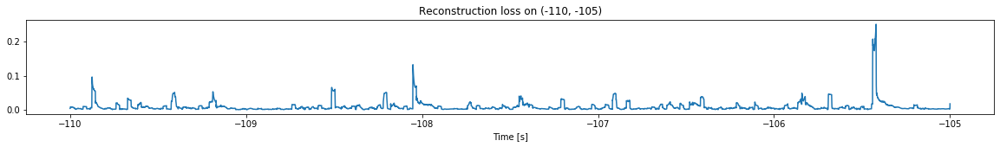

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)


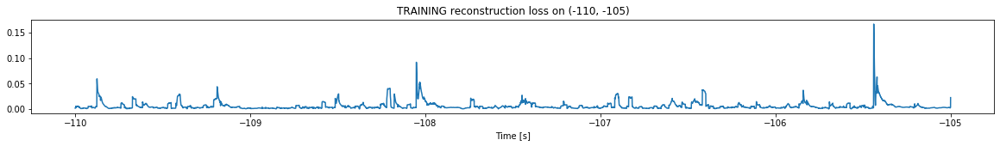

Finished training, median of the log(loss) is:  -2.411731441274836
Triggering for section:  (-105, -100)
Using this median for triggering: -2.297367524528267


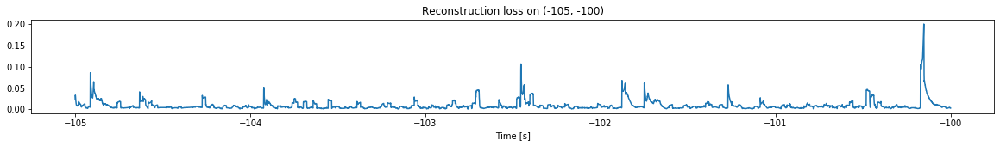

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)


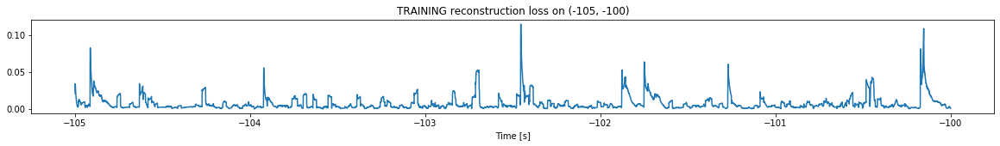

Finished training, median of the log(loss) is:  -2.328424662621663
Triggering for section:  (-100, -95)
Using this median for triggering: -2.411731441274836


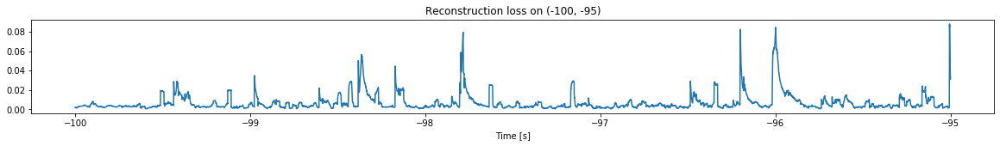

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)


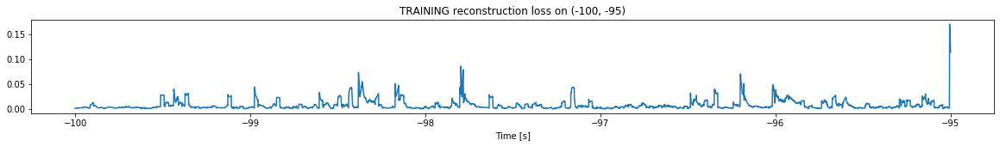

Finished training, median of the log(loss) is:  -2.319275033334822
Triggering for section:  (-95, -90)
Using this median for triggering: -2.328424662621663


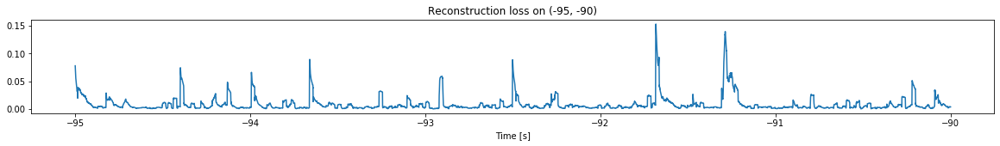

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)


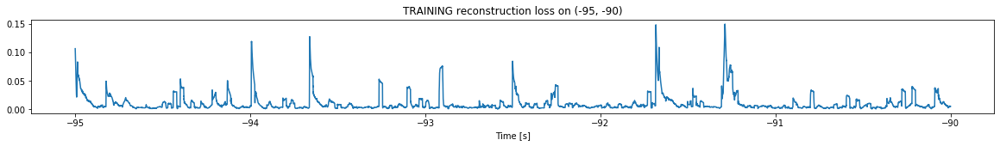

Finished training, median of the log(loss) is:  -2.2406893235100847
Triggering for section:  (-90, -85)
Using this median for triggering: -2.319275033334822


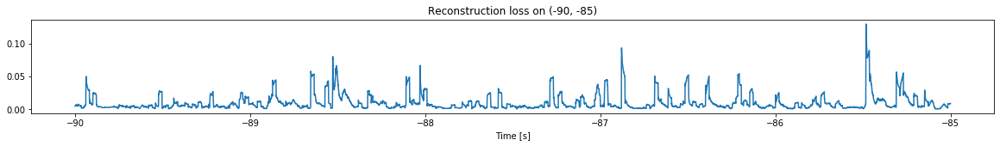

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)


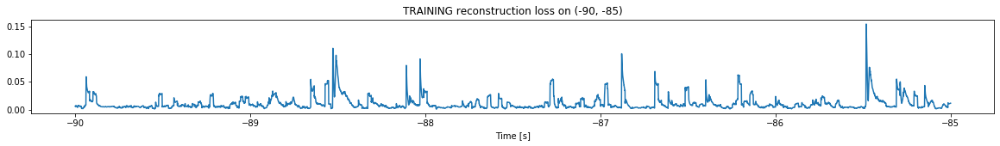

Finished training, median of the log(loss) is:  -2.1695561084987744
Triggering for section:  (-85, -80)
Using this median for triggering: -2.2406893235100847


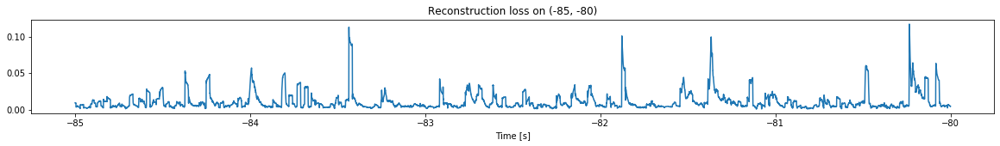

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


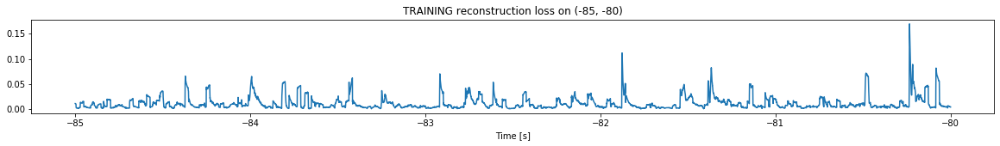

Finished training, median of the log(loss) is:  -2.108542785827503
Triggering for section:  (-80, -75)
Using this median for triggering: -2.1695561084987744


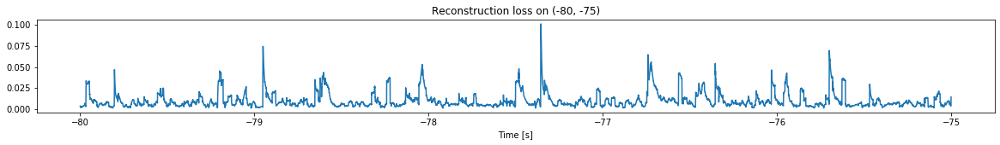

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


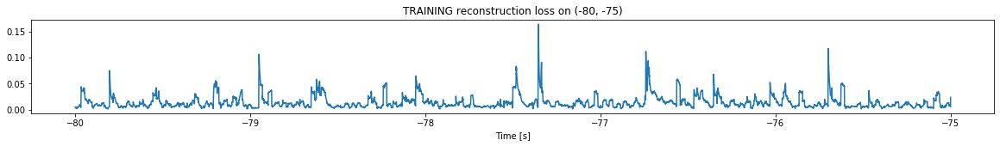

Finished training, median of the log(loss) is:  -1.9827300283668565
Triggering for section:  (-75, -70)
Using this median for triggering: -2.108542785827503


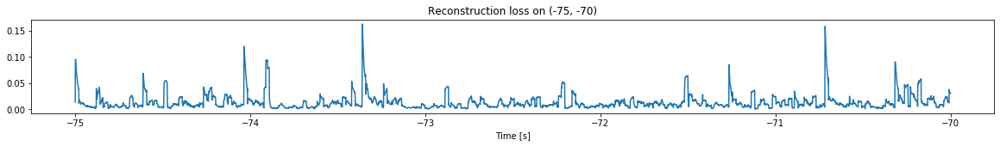

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


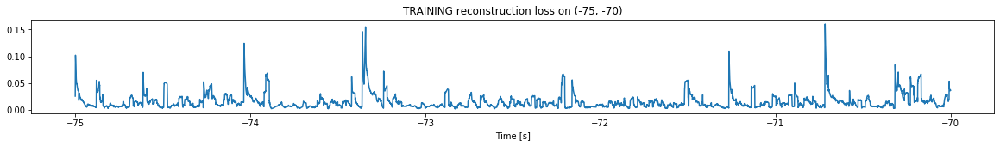

Finished training, median of the log(loss) is:  -1.9533262575108672
Triggering for section:  (-70, -65)
Using this median for triggering: -1.9827300283668565


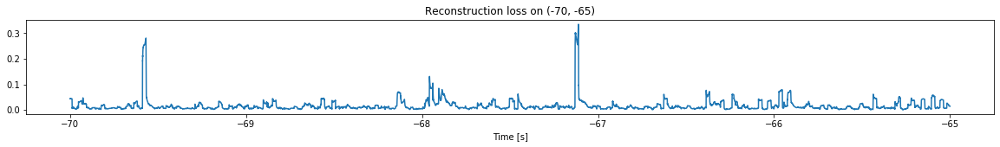

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


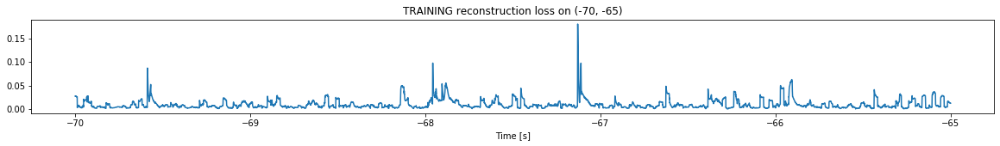

Finished training, median of the log(loss) is:  -2.1327950168395198
Triggering for section:  (-65, -60)
Using this median for triggering: -1.9533262575108672


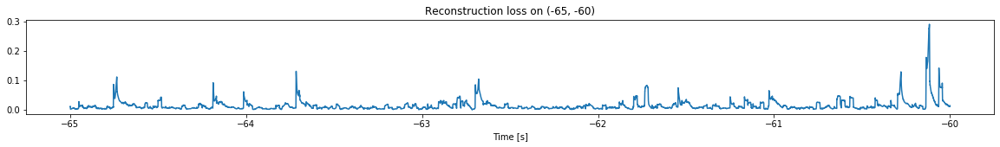

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


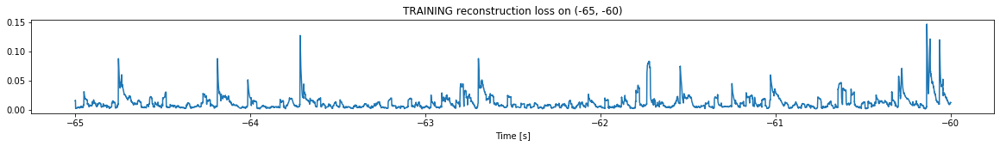

Finished training, median of the log(loss) is:  -2.090708965951841
Triggering for section:  (-60, -55)
Using this median for triggering: -2.1327950168395198


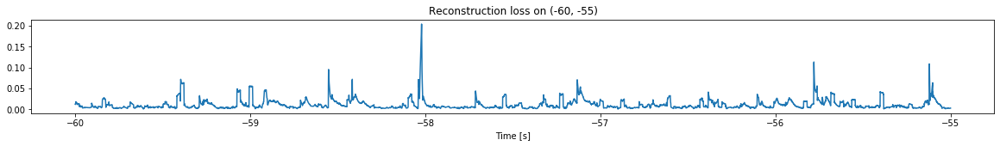

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


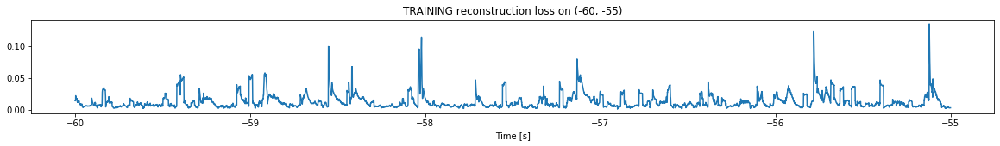

Finished training, median of the log(loss) is:  -2.0535504693817987
Triggering for section:  (-55, -50)
Using this median for triggering: -2.090708965951841


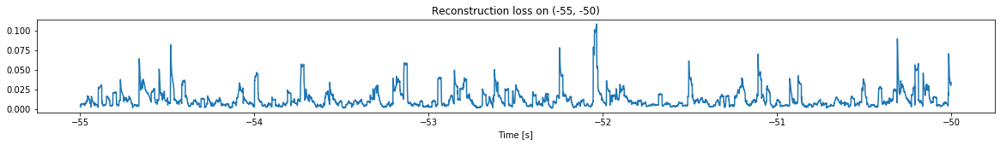

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


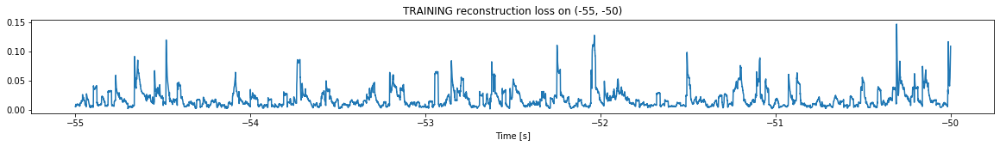

Finished training, median of the log(loss) is:  -1.8677282784221116
Triggering for section:  (-50, -45)
Using this median for triggering: -2.0535504693817987


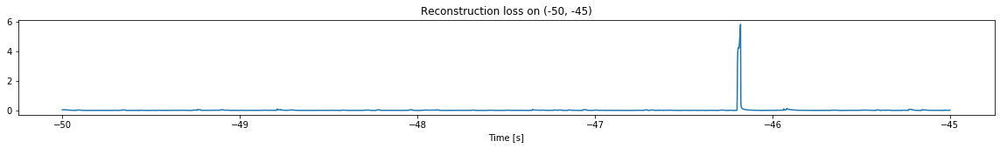

Other trigger time:  [-46.17999]
Their log loss values are:  [2.81651522]


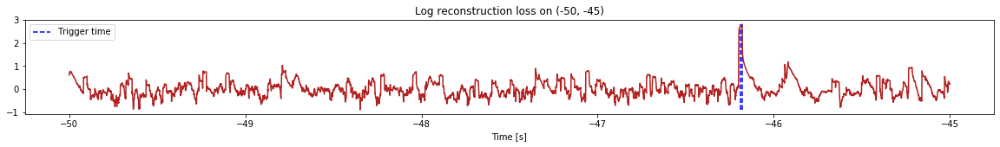

Triggered at:  [-46.17999]
<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


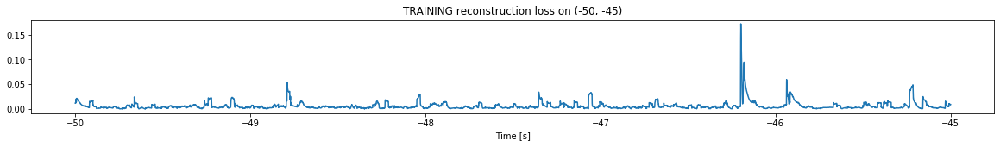

Finished training, median of the log(loss) is:  -2.3729820885901116
Triggering for section:  (-45, -40)
Using this median for triggering: -1.8677282784221116


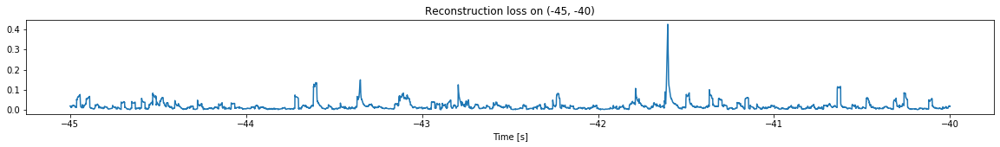

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


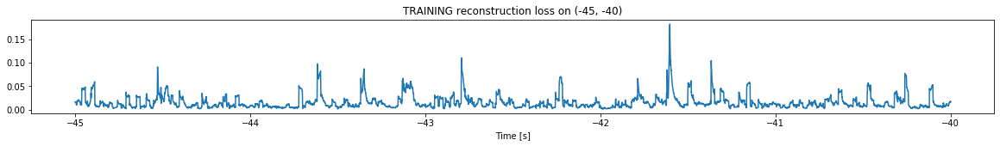

Finished training, median of the log(loss) is:  -1.9403610486930758
Triggering for section:  (-40, -35)
Using this median for triggering: -2.3729820885901116


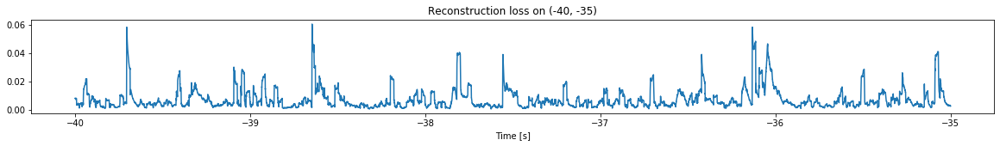

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


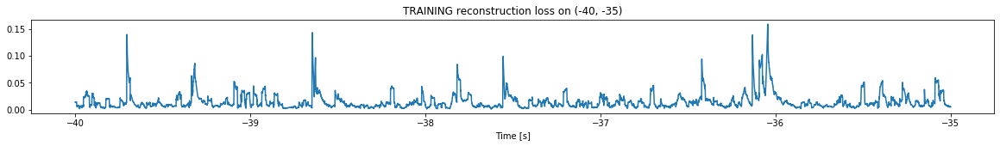

Finished training, median of the log(loss) is:  -1.980326172731778
Triggering for section:  (-35, -30)
Using this median for triggering: -1.9403610486930758


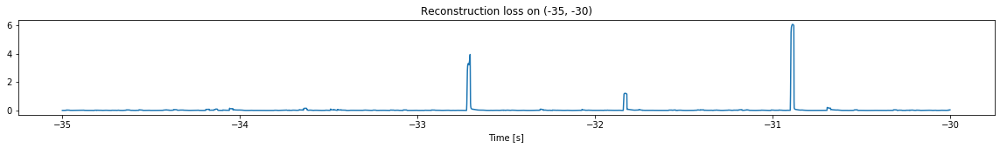

Other trigger time:  [-30.88539]
Their log loss values are:  [2.7233894]


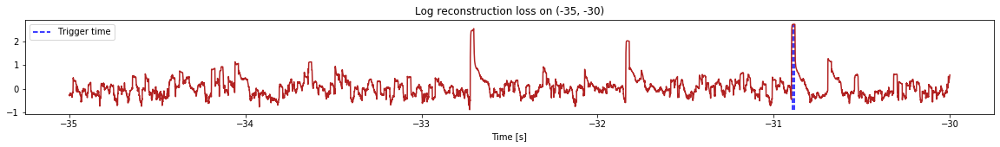

Triggered at:  [-30.88539]
<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


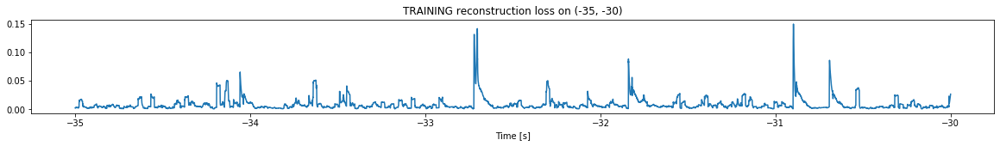

Finished training, median of the log(loss) is:  -2.2465594258495334
Triggering for section:  (-30, -25)
Using this median for triggering: -1.980326172731778


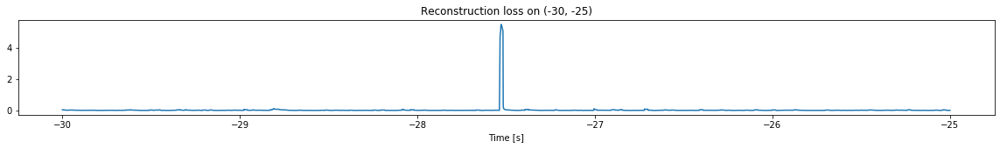

Other trigger time:  [-27.52789]
Their log loss values are:  [2.72064177]


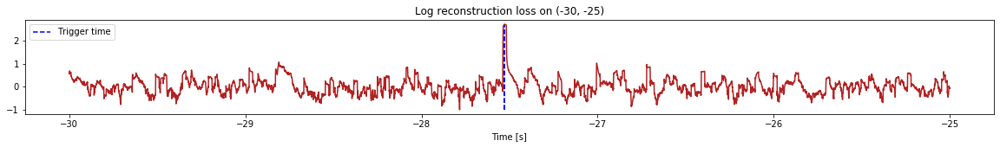

Triggered at:  [-27.52789]
<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


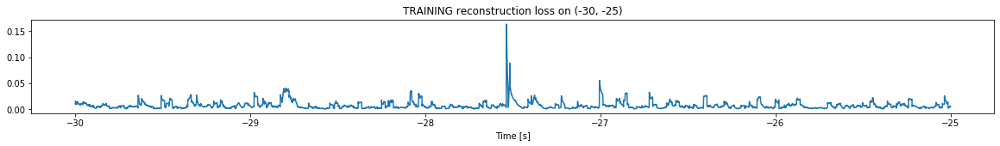

Finished training, median of the log(loss) is:  -2.246211712942782
Triggering for section:  (-25, -20)
Using this median for triggering: -2.2465594258495334


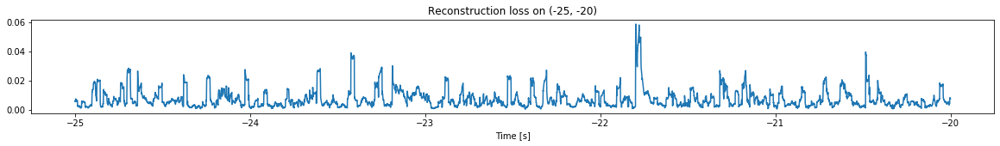

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


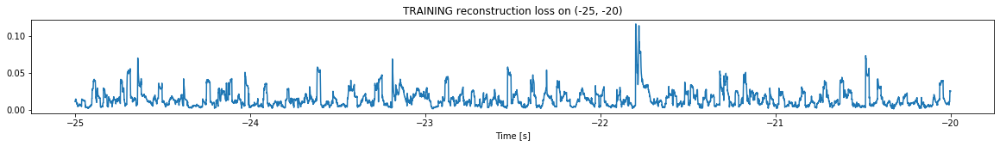

Finished training, median of the log(loss) is:  -1.9194956372889507
Triggering for section:  (-20, -15)
Using this median for triggering: -2.246211712942782


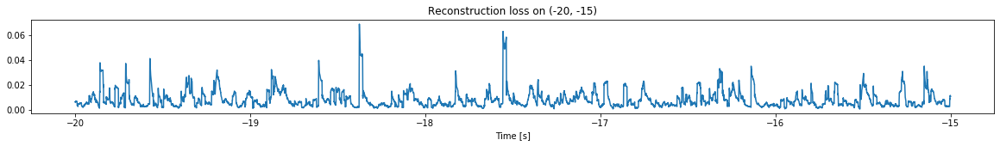

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


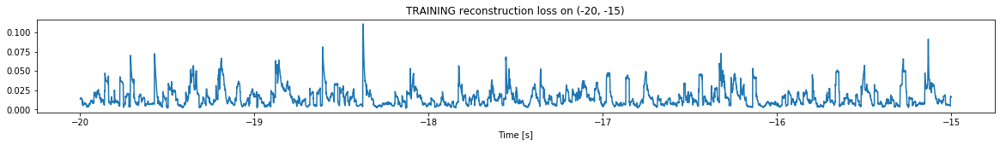

Finished training, median of the log(loss) is:  -1.916544010311536
Triggering for section:  (-15, -10)
Using this median for triggering: -1.9194956372889507


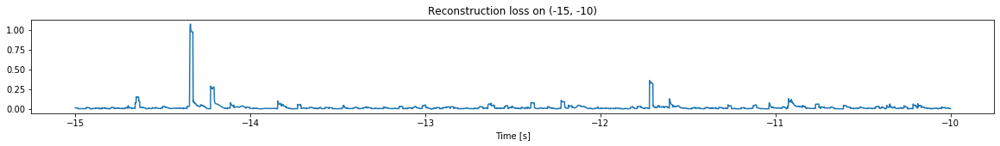

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


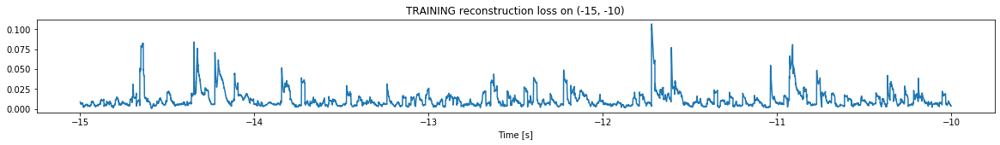

Finished training, median of the log(loss) is:  -2.091187176749121
Triggering for section:  (-10, -5)
Using this median for triggering: -1.916544010311536


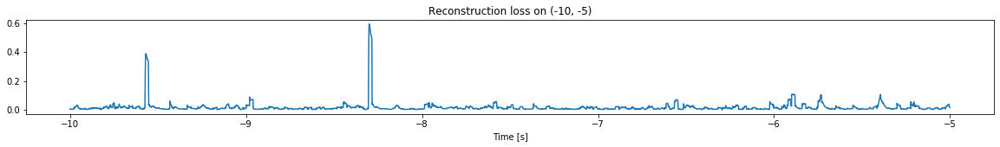

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


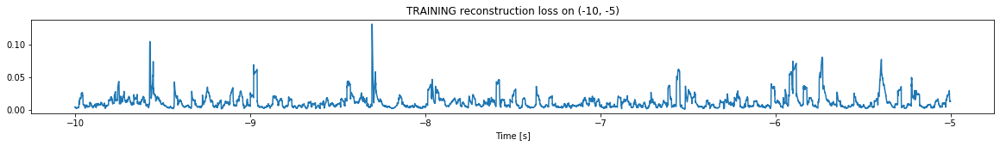

Finished training, median of the log(loss) is:  -2.056030096903217
Triggering for section:  (-5, 0)
Using this median for triggering: -2.091187176749121


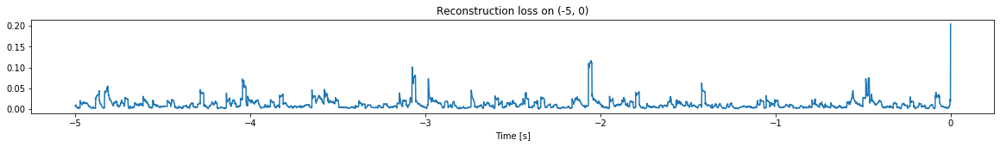

<--------
Finished simulation, all the triggered times are:  [[-190.83348], [-148.10269, -146.59138, -145.61339], [-144.52678, -144.02179, -143.47359, -142.9188, -141.91309, -141.23909, -140.48679], [-137.92479, -136.77028], [-46.17999], [-30.88539], [-27.52789]]


In [12]:
simulation("./data/Ramp20/", 5, (-212,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1197500, 12)
Flushing input history
Number of sections: 24
Entering sections:  (-120, -115)
-------->
Entering sections:  (-115, -110)
-------->
Training for section:  (None, -115)


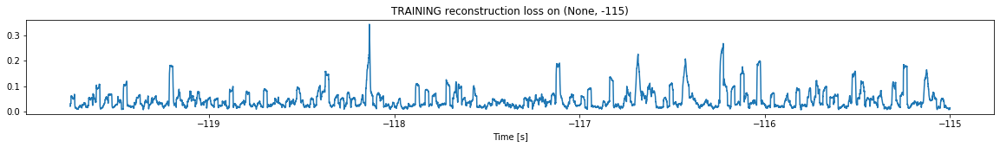

Finished training, median of the log(loss) is:  -1.452974470038873
<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)


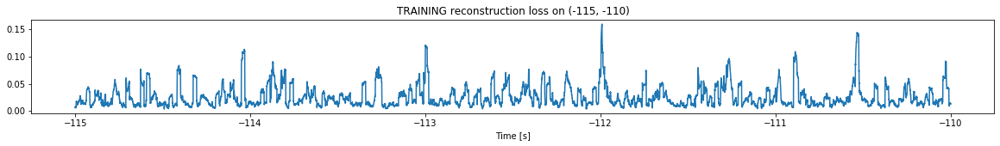

Finished training, median of the log(loss) is:  -1.694955273288858
Triggering for section:  (-110, -105)
Using this median for triggering: -1.452974470038873


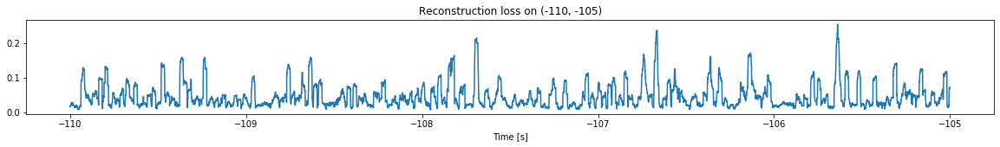

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)


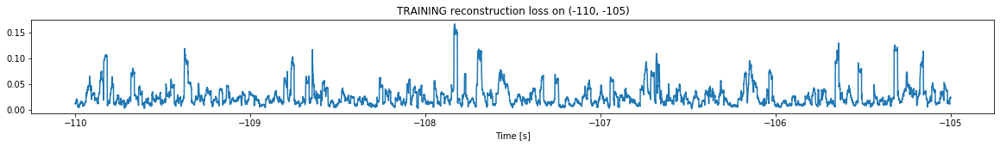

Finished training, median of the log(loss) is:  -1.6726969299628824
Triggering for section:  (-105, -100)
Using this median for triggering: -1.694955273288858


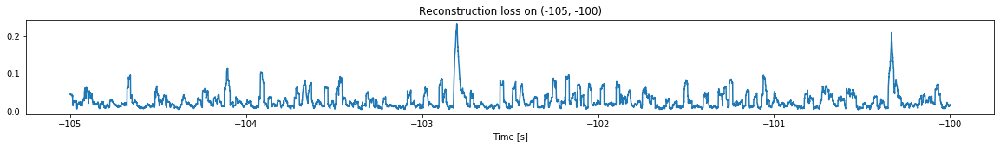

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)


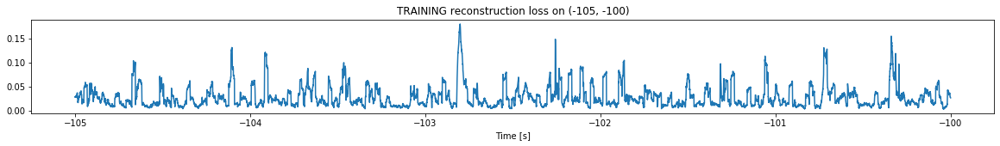

Finished training, median of the log(loss) is:  -1.6540302521088748
Triggering for section:  (-100, -95)
Using this median for triggering: -1.6726969299628824


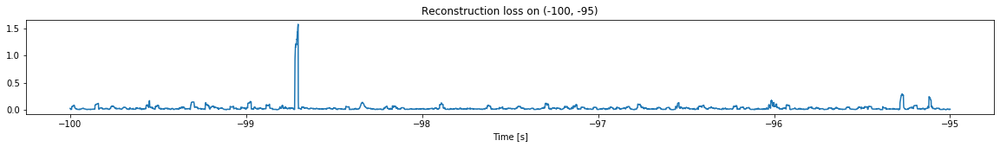

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)


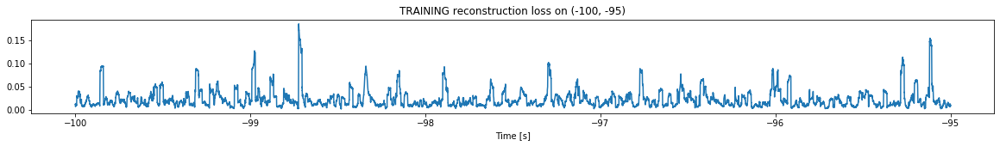

Finished training, median of the log(loss) is:  -1.7419115421770854
Triggering for section:  (-95, -90)
Using this median for triggering: -1.6540302521088748


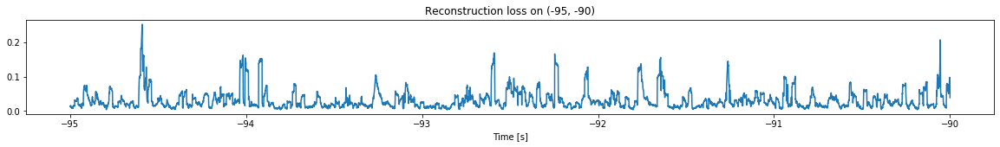

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)


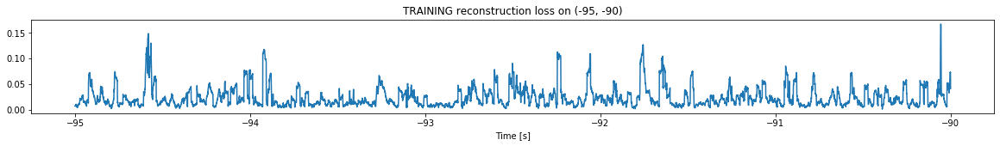

Finished training, median of the log(loss) is:  -1.7295090522550216
Triggering for section:  (-90, -85)
Using this median for triggering: -1.7419115421770854


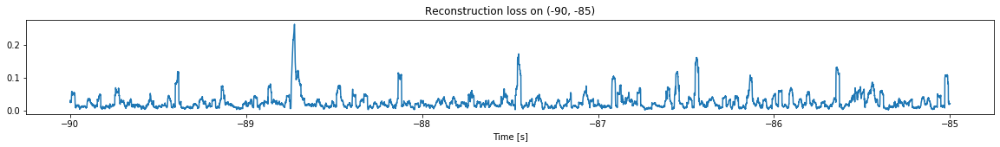

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)


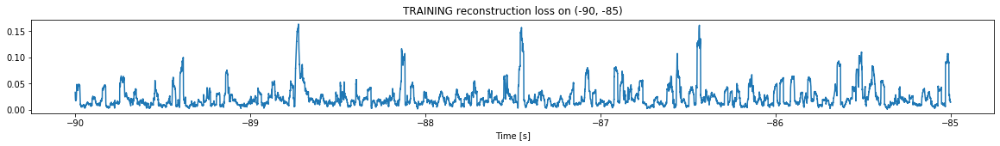

Finished training, median of the log(loss) is:  -1.75463569855602
Triggering for section:  (-85, -80)
Using this median for triggering: -1.7295090522550216


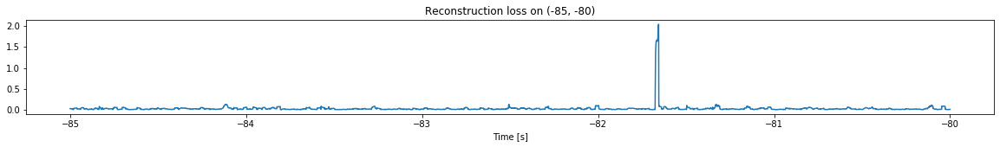

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


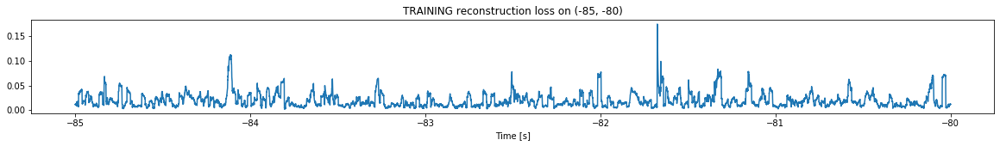

Finished training, median of the log(loss) is:  -1.8087879690100217
Triggering for section:  (-80, -75)
Using this median for triggering: -1.75463569855602


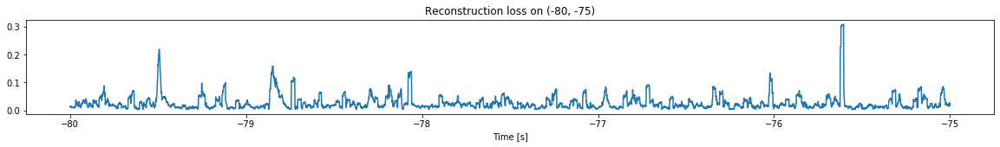

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


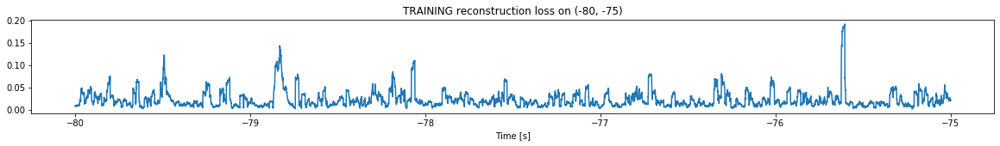

Finished training, median of the log(loss) is:  -1.7602558048673322
Triggering for section:  (-75, -70)
Using this median for triggering: -1.8087879690100217


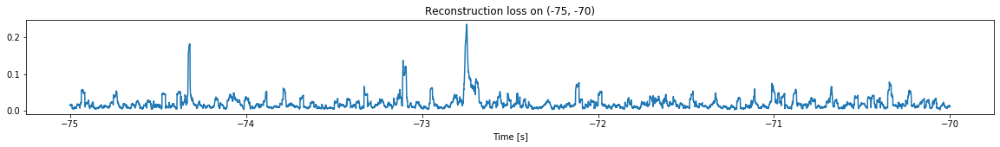

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


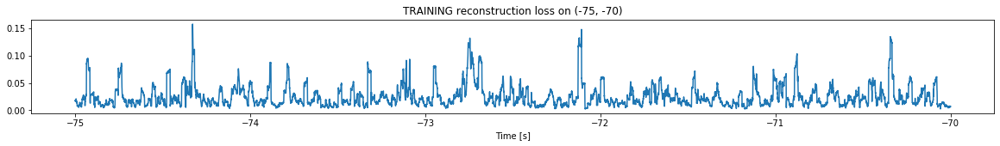

Finished training, median of the log(loss) is:  -1.7130585457898109
Triggering for section:  (-70, -65)
Using this median for triggering: -1.7602558048673322


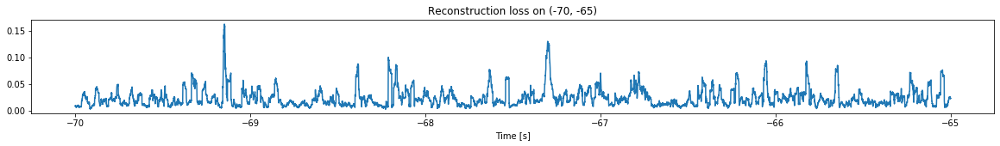

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


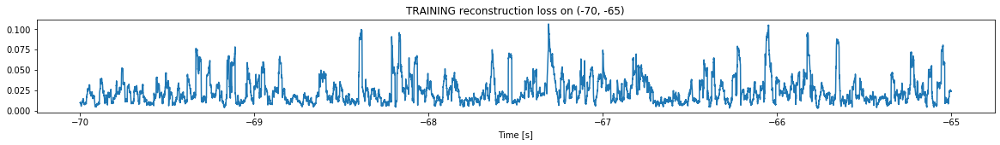

Finished training, median of the log(loss) is:  -1.7007427306306526
Triggering for section:  (-65, -60)
Using this median for triggering: -1.7130585457898109


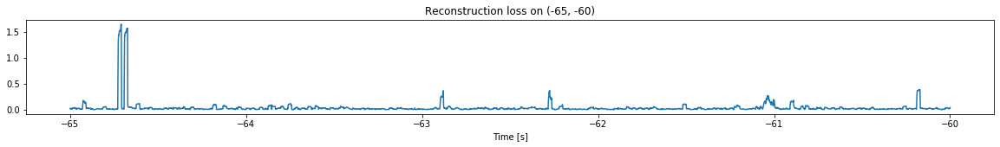

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


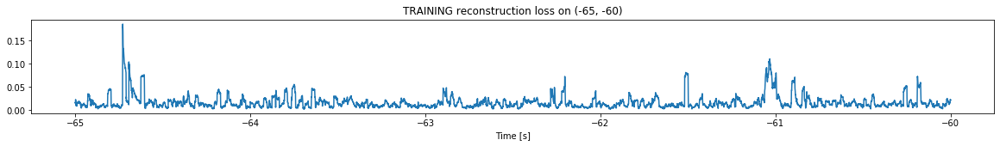

Finished training, median of the log(loss) is:  -1.879921733693483
Triggering for section:  (-60, -55)
Using this median for triggering: -1.7007427306306526


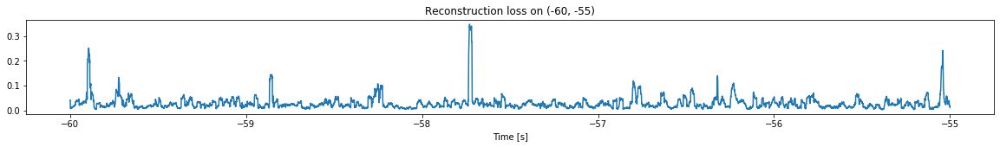

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


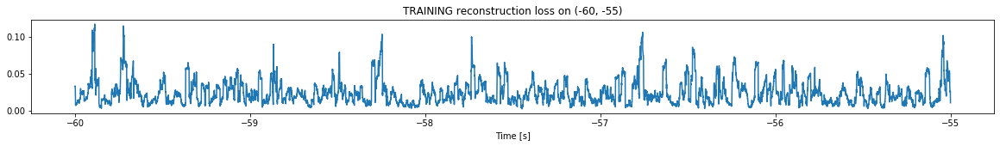

Finished training, median of the log(loss) is:  -1.6833728939646257
Triggering for section:  (-55, -50)
Using this median for triggering: -1.879921733693483


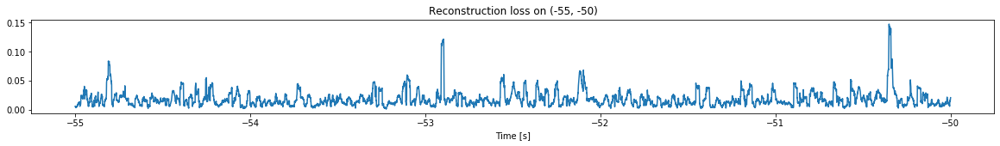

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


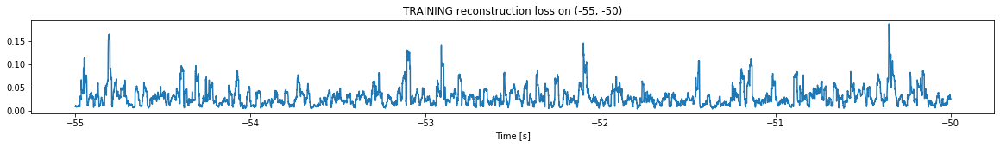

Finished training, median of the log(loss) is:  -1.6071621325872973
Triggering for section:  (-50, -45)
Using this median for triggering: -1.6833728939646257


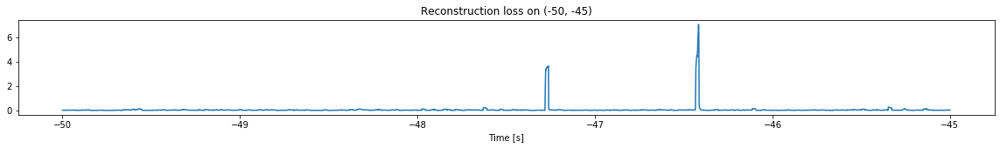

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


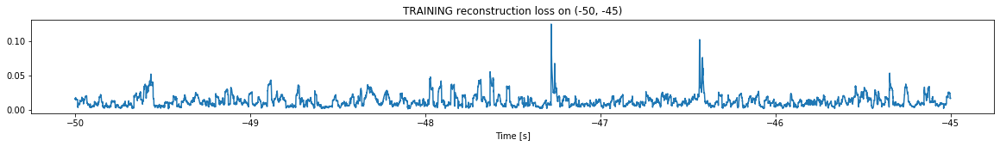

Finished training, median of the log(loss) is:  -1.9791081874947594
Triggering for section:  (-45, -40)
Using this median for triggering: -1.6071621325872973


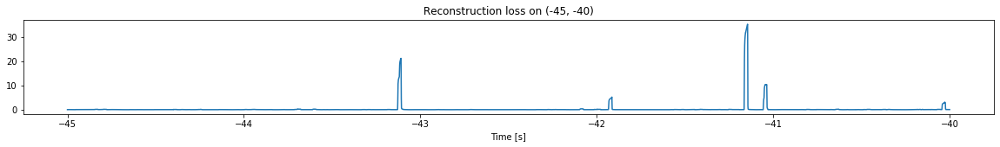

Other trigger time:  [-43.109898 -41.1455  ]
Their log loss values are:  [2.93194473 3.15353524]


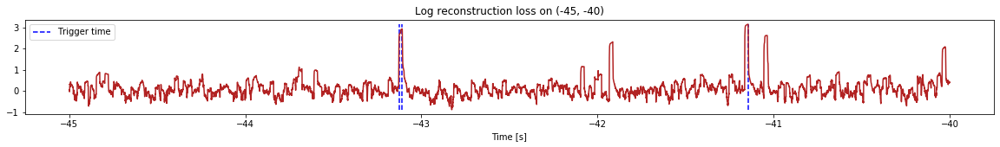

Triggered at:  [-43.109898, -41.1455]
<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


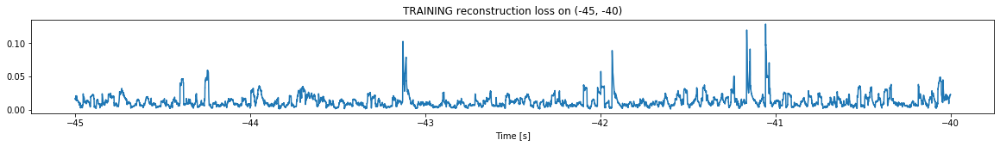

Finished training, median of the log(loss) is:  -1.9813936170775512
Triggering for section:  (-40, -35)
Using this median for triggering: -1.9791081874947594


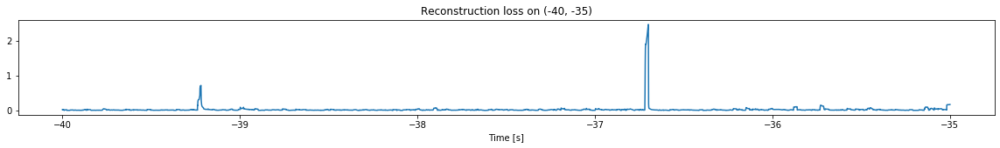

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


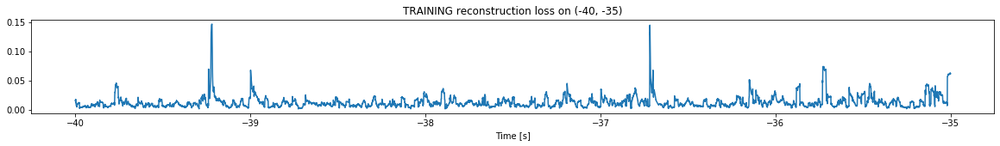

Finished training, median of the log(loss) is:  -1.9903742785946497
Triggering for section:  (-35, -30)
Using this median for triggering: -1.9813936170775512


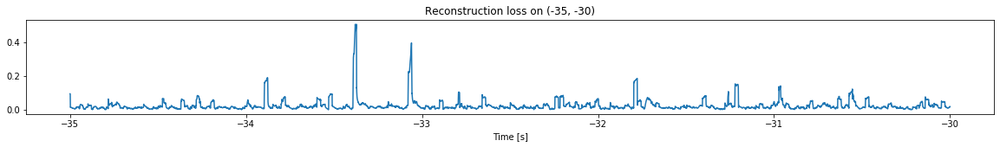

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


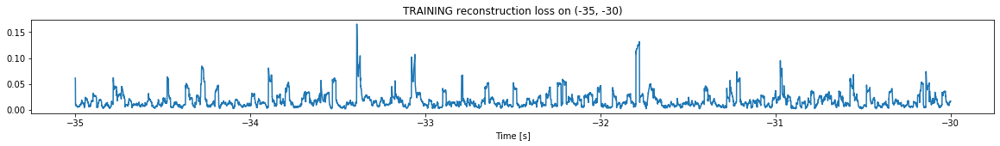

Finished training, median of the log(loss) is:  -1.8512844335883503
Triggering for section:  (-30, -25)
Using this median for triggering: -1.9903742785946497


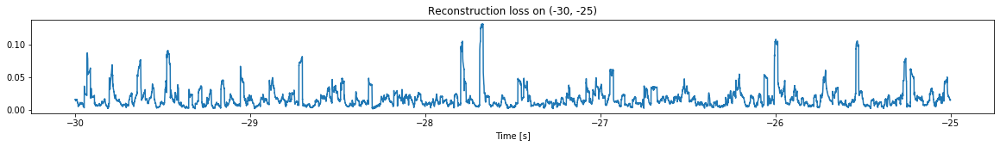

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


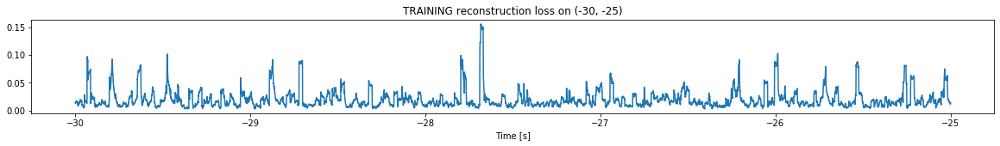

Finished training, median of the log(loss) is:  -1.810996545403579
Triggering for section:  (-25, -20)
Using this median for triggering: -1.8512844335883503


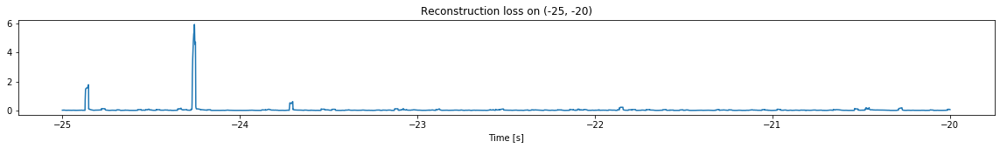

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


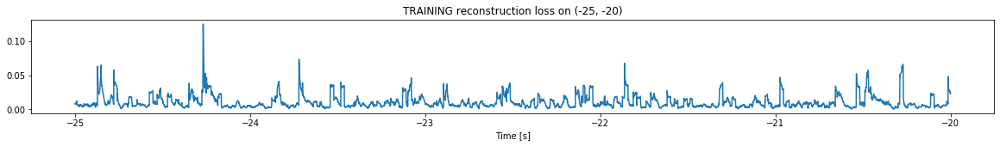

Finished training, median of the log(loss) is:  -2.113054074840806
Triggering for section:  (-20, -15)
Using this median for triggering: -1.810996545403579


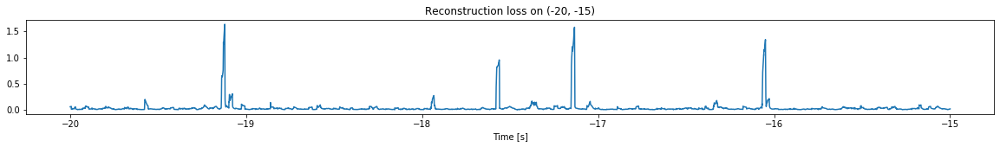

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


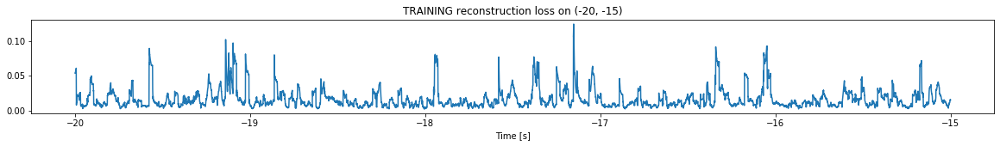

Finished training, median of the log(loss) is:  -1.9113570300903389
Triggering for section:  (-15, -10)
Using this median for triggering: -2.113054074840806


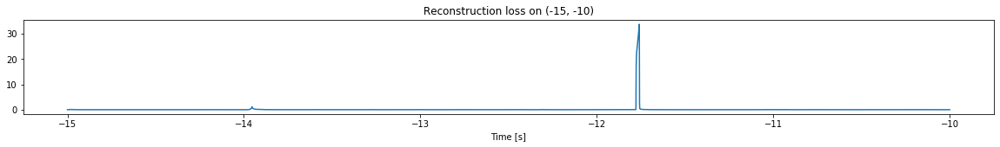

Other trigger time:  [-11.759]
Their log loss values are:  [3.64201746]


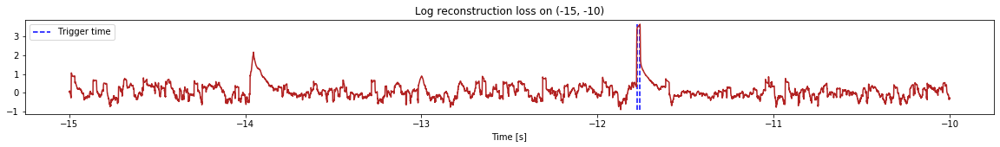

Triggered at:  [-11.759]
<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


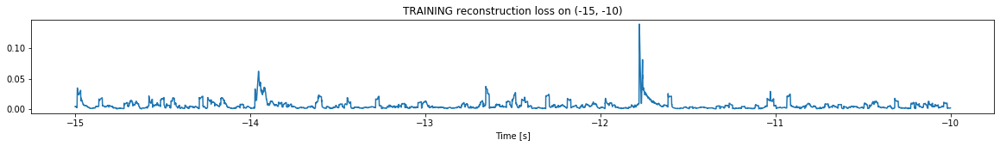

Finished training, median of the log(loss) is:  -2.3676783069356095
Triggering for section:  (-10, -5)
Using this median for triggering: -1.9113570300903389


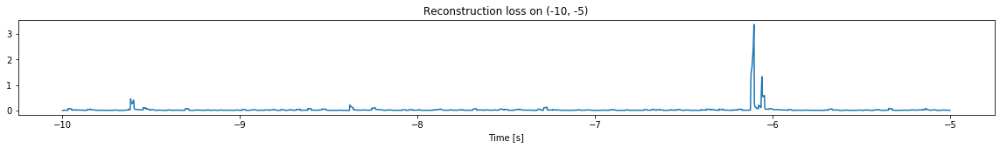

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


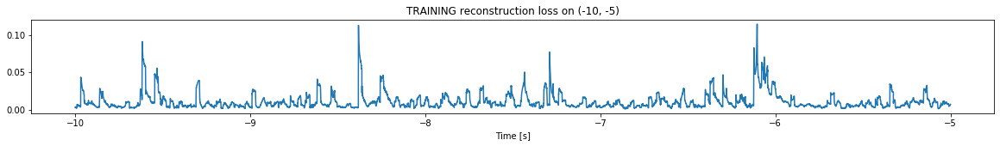

Finished training, median of the log(loss) is:  -2.119697876422343
Triggering for section:  (-5, 0)
Using this median for triggering: -2.3676783069356095


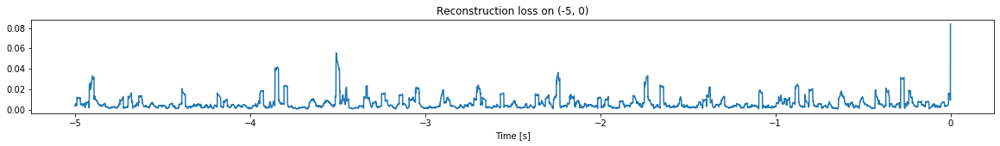

<--------
Finished simulation, all the triggered times are:  [[-43.109898, -41.1455], [-11.759]]


In [13]:
simulation("./data/Ramp21/", 5, (-120,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (797500, 12)
Flushing input history
Number of sections: 16
Entering sections:  (-80, -75)
-------->
Entering sections:  (-75, -70)
-------->
Training for section:  (None, -75)


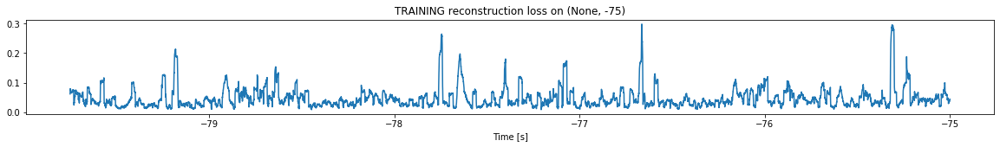

Finished training, median of the log(loss) is:  -1.420020601148495
<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


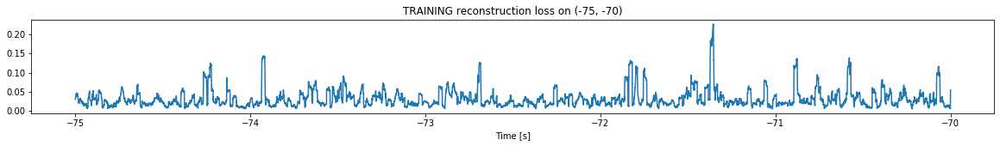

Finished training, median of the log(loss) is:  -1.5924260814778408
Triggering for section:  (-70, -65)
Using this median for triggering: -1.420020601148495


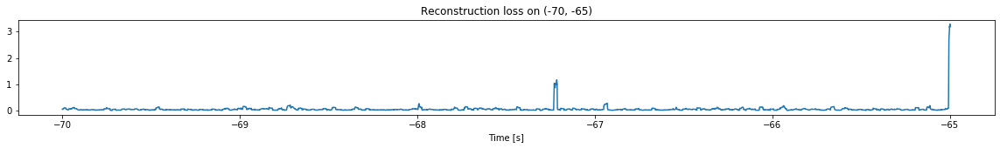

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


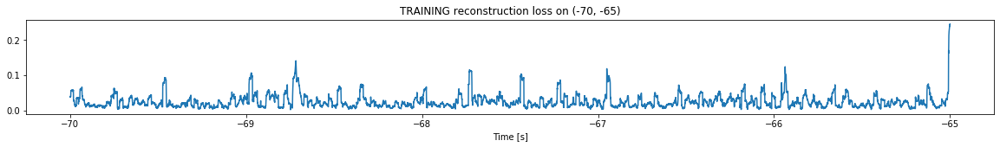

Finished training, median of the log(loss) is:  -1.6690523457745965
Triggering for section:  (-65, -60)
Using this median for triggering: -1.5924260814778408


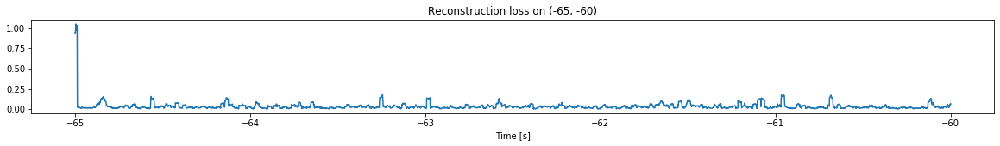

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


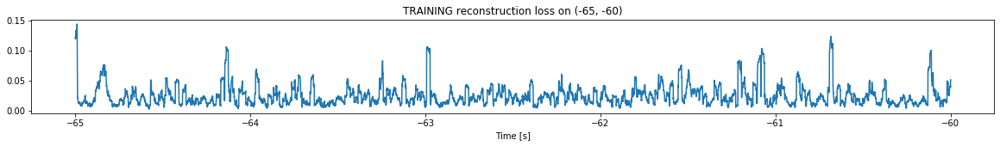

Finished training, median of the log(loss) is:  -1.6894031043232953
Triggering for section:  (-60, -55)
Using this median for triggering: -1.6690523457745965


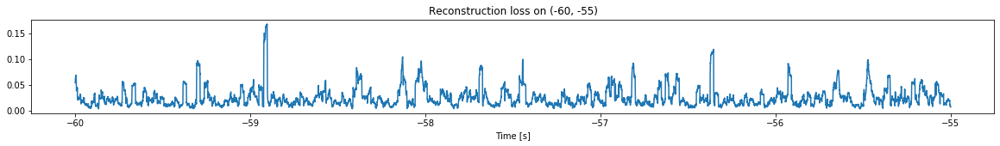

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


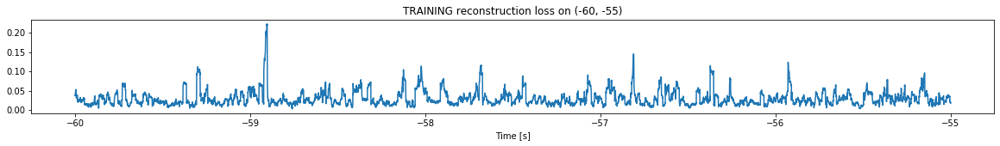

Finished training, median of the log(loss) is:  -1.5993656901196345
Triggering for section:  (-55, -50)
Using this median for triggering: -1.6894031043232953


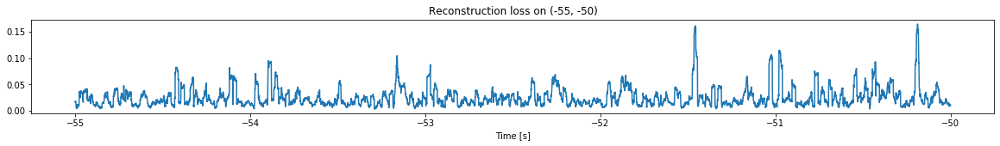

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


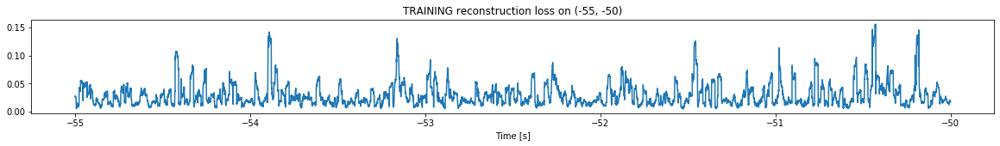

Finished training, median of the log(loss) is:  -1.625972224882606
Triggering for section:  (-50, -45)
Using this median for triggering: -1.5993656901196345


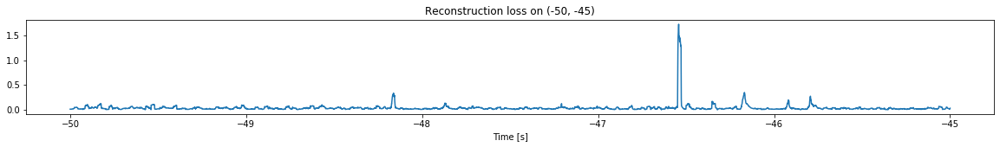

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


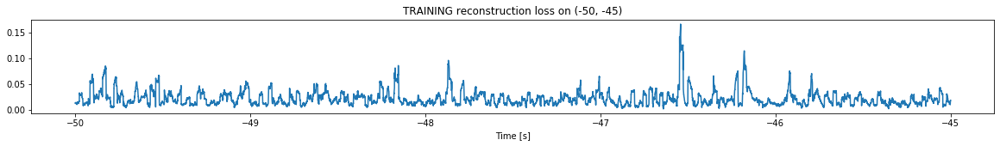

Finished training, median of the log(loss) is:  -1.7250648069312997
Triggering for section:  (-45, -40)
Using this median for triggering: -1.625972224882606


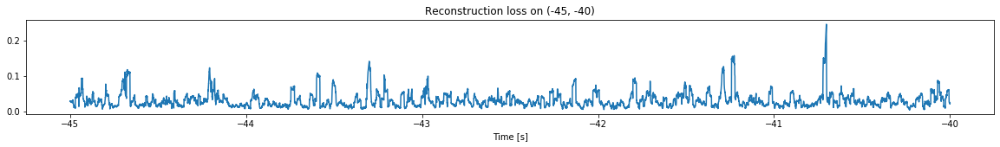

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


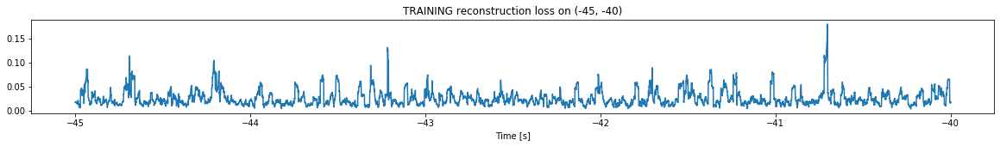

Finished training, median of the log(loss) is:  -1.6647424278587097
Triggering for section:  (-40, -35)
Using this median for triggering: -1.7250648069312997


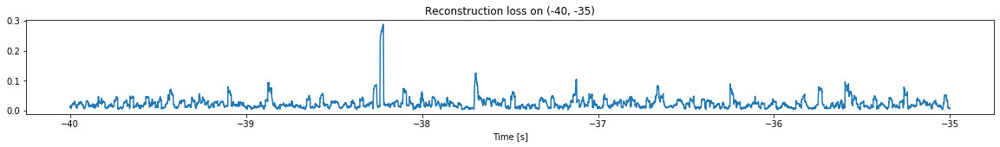

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


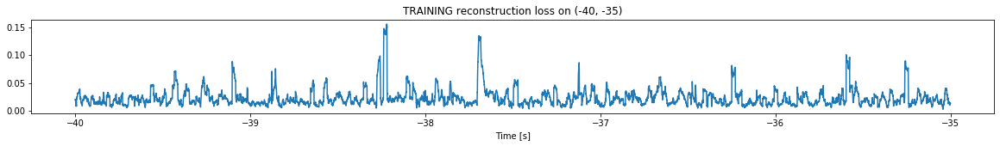

Finished training, median of the log(loss) is:  -1.7111870554518558
Triggering for section:  (-35, -30)
Using this median for triggering: -1.6647424278587097


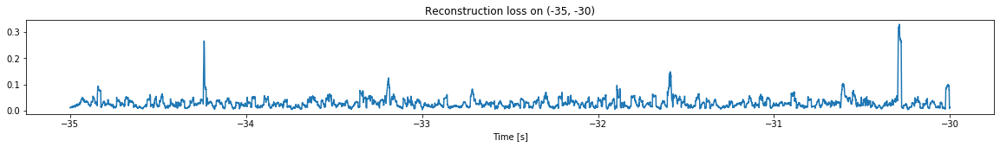

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


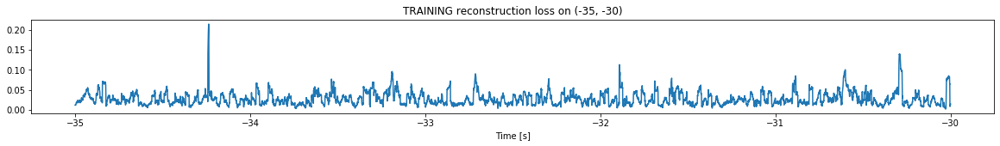

Finished training, median of the log(loss) is:  -1.6119556831894695
Triggering for section:  (-30, -25)
Using this median for triggering: -1.7111870554518558


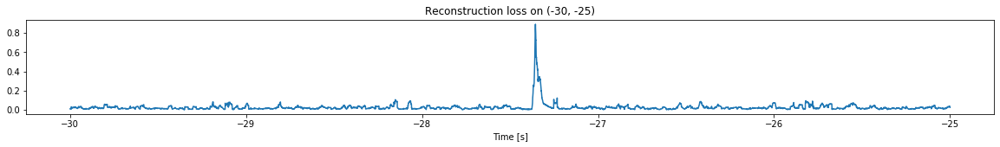

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


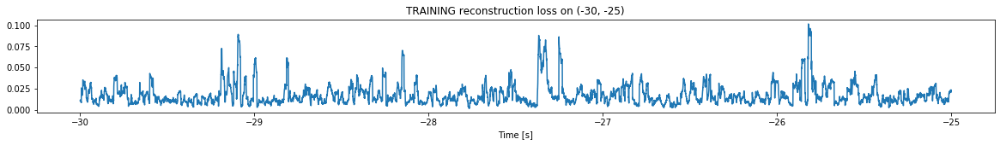

Finished training, median of the log(loss) is:  -1.847025932303687
Triggering for section:  (-25, -20)
Using this median for triggering: -1.6119556831894695


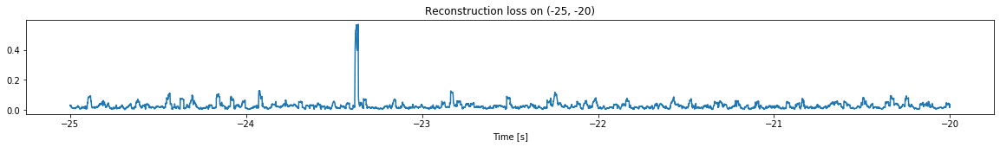

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


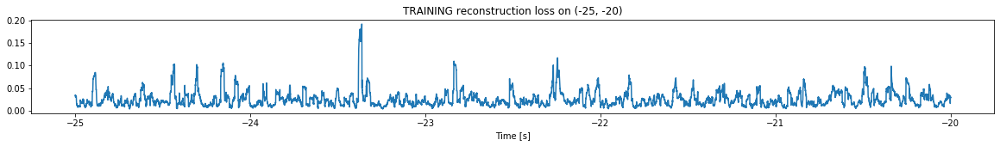

Finished training, median of the log(loss) is:  -1.6718949729258794
Triggering for section:  (-20, -15)
Using this median for triggering: -1.847025932303687


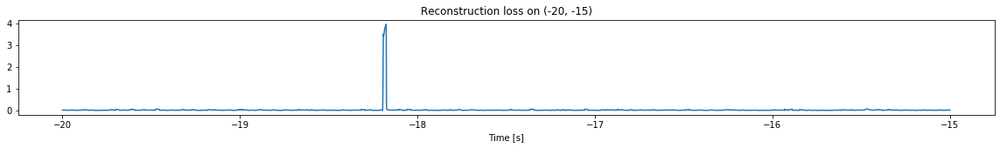

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


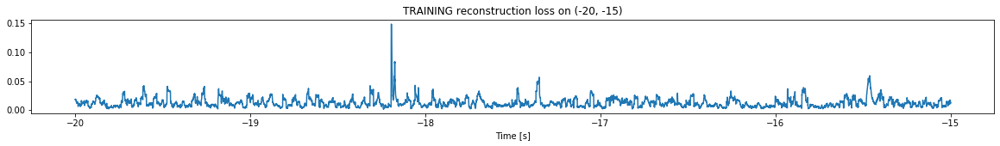

Finished training, median of the log(loss) is:  -1.9546062846829044
Triggering for section:  (-15, -10)
Using this median for triggering: -1.6718949729258794


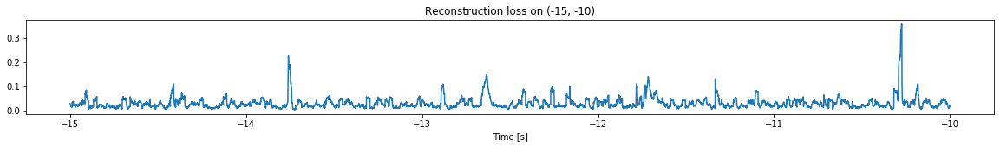

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


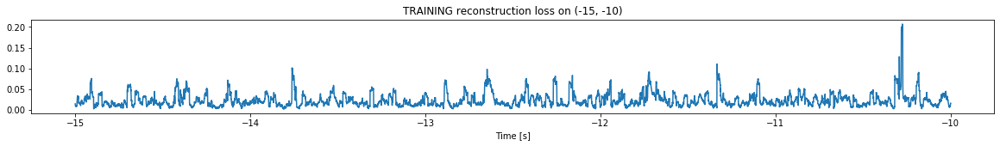

Finished training, median of the log(loss) is:  -1.7080419265003255
Triggering for section:  (-10, -5)
Using this median for triggering: -1.9546062846829044


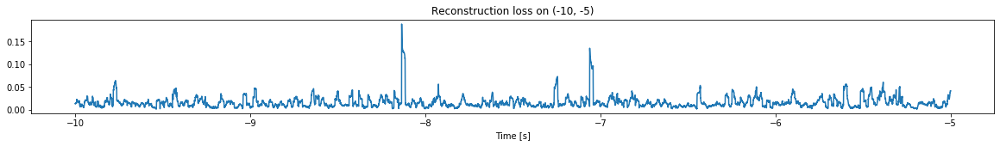

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


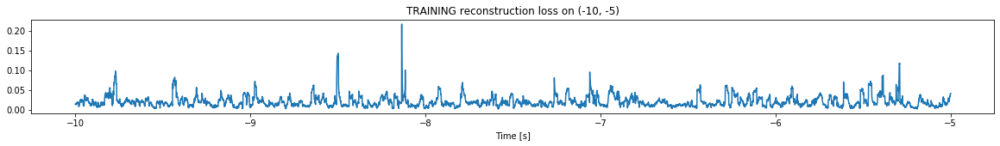

Finished training, median of the log(loss) is:  -1.7332595232879573
Triggering for section:  (-5, 0)
Using this median for triggering: -1.7080419265003255


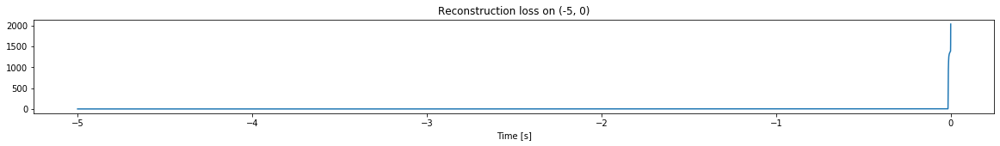

Other trigger time:  []
Their log loss values are:  []


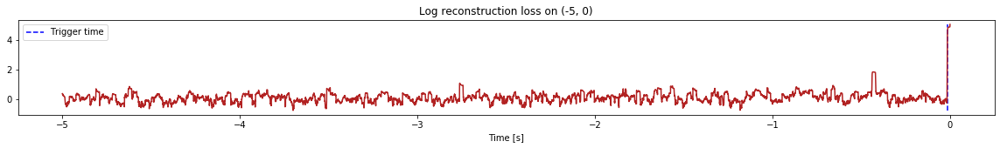

Triggered at:  []
<--------
Finished simulation, all the triggered times are:  [[]]


In [14]:
simulation("./data/Ramp22/", 5, (-80,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (497500, 12)
Flushing input history
Number of sections: 10
Entering sections:  (-50, -45)
-------->
Entering sections:  (-45, -40)
-------->
Training for section:  (None, -45)


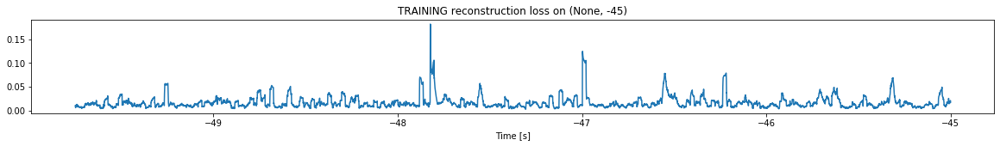

Finished training, median of the log(loss) is:  -1.8643315915642127
<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


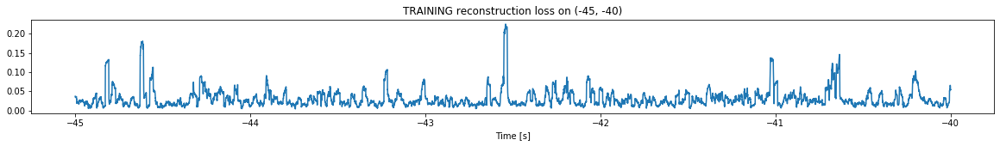

Finished training, median of the log(loss) is:  -1.6050800708820567
Triggering for section:  (-40, -35)
Using this median for triggering: -1.8643315915642127


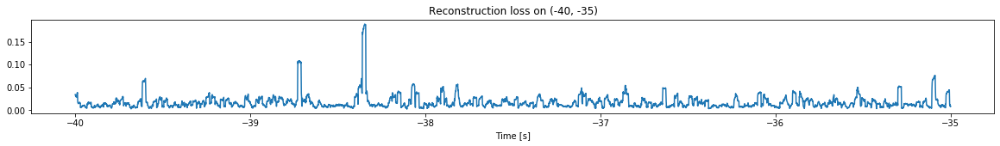

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


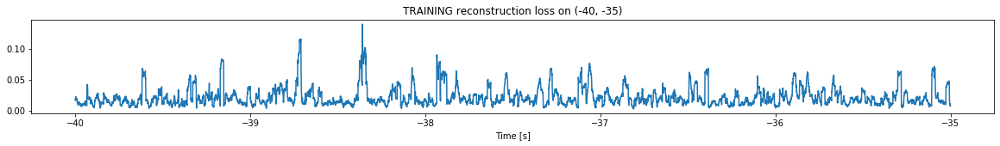

Finished training, median of the log(loss) is:  -1.7530408184440767
Triggering for section:  (-35, -30)
Using this median for triggering: -1.6050800708820567


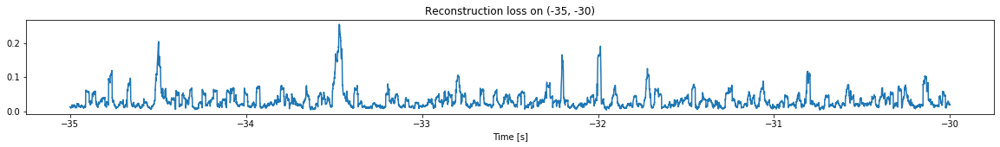

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


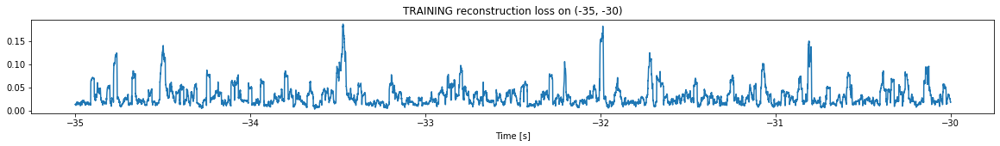

Finished training, median of the log(loss) is:  -1.6083357156600506
Triggering for section:  (-30, -25)
Using this median for triggering: -1.7530408184440767


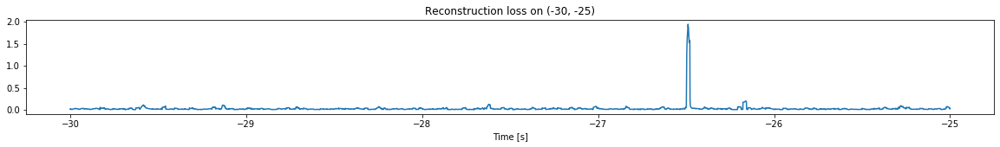

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


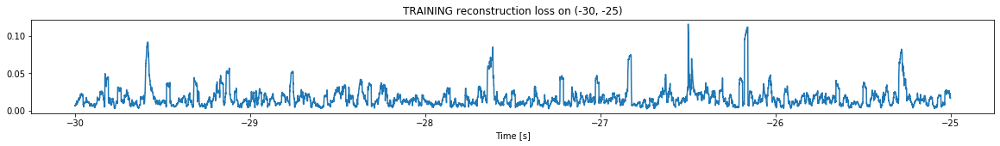

Finished training, median of the log(loss) is:  -1.86102140360989
Triggering for section:  (-25, -20)
Using this median for triggering: -1.6083357156600506


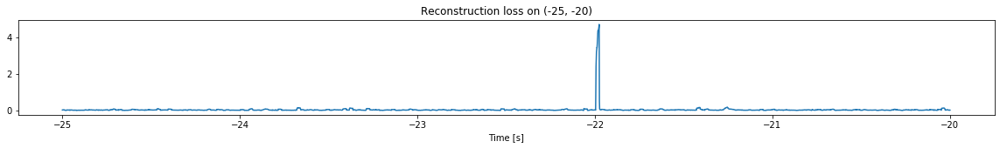

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


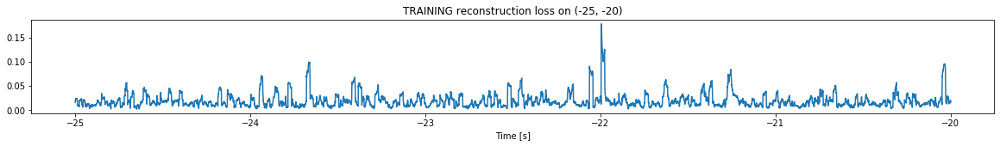

Finished training, median of the log(loss) is:  -1.7900750741364955
Triggering for section:  (-20, -15)
Using this median for triggering: -1.86102140360989


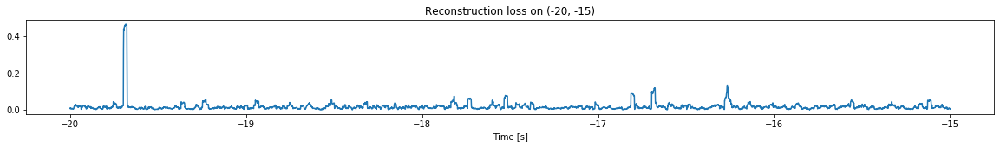

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


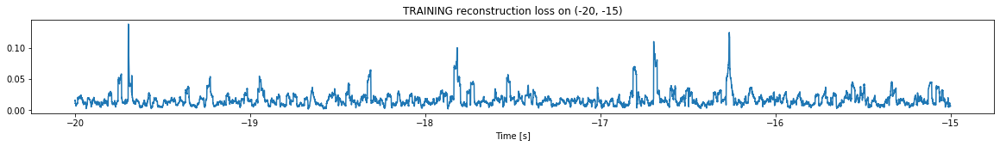

Finished training, median of the log(loss) is:  -1.8358234592637483
Triggering for section:  (-15, -10)
Using this median for triggering: -1.7900750741364955


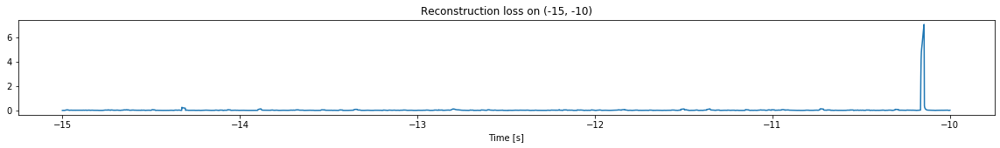

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


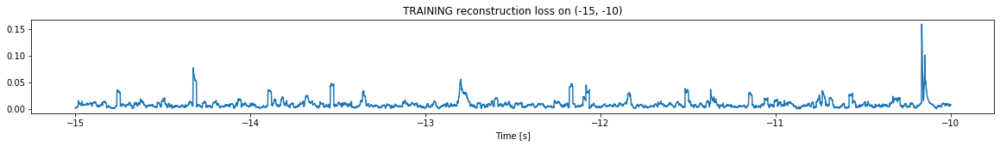

Finished training, median of the log(loss) is:  -2.112414539434127
Triggering for section:  (-10, -5)
Using this median for triggering: -1.8358234592637483


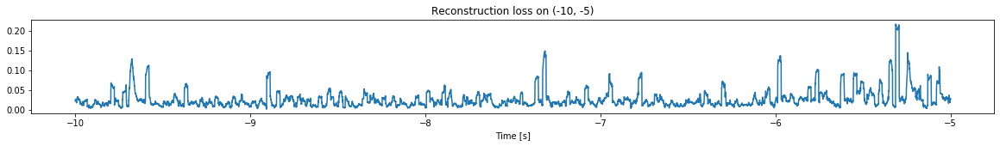

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


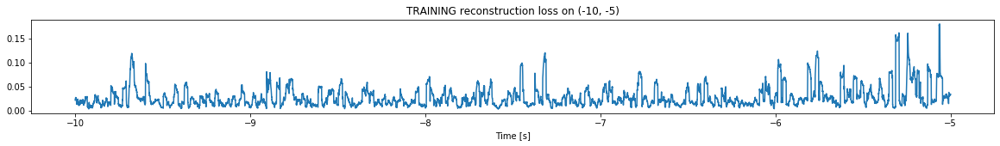

Finished training, median of the log(loss) is:  -1.6594912531292185
Triggering for section:  (-5, 0)
Using this median for triggering: -2.112414539434127


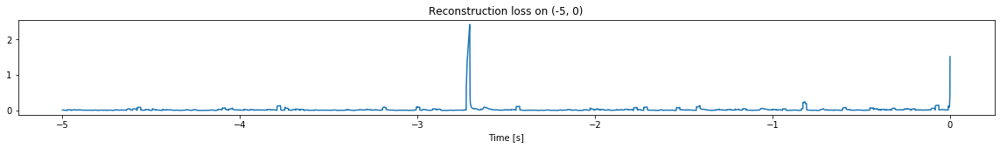

<--------
Finished simulation, all the triggered times are:  []


In [23]:
simulation("./data/Ramp23/", 5, (-50,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1097500, 12)
Flushing input history
Number of sections: 22
Entering sections:  (-110, -105)
-------->
Entering sections:  (-105, -100)
-------->
Training for section:  (None, -105)


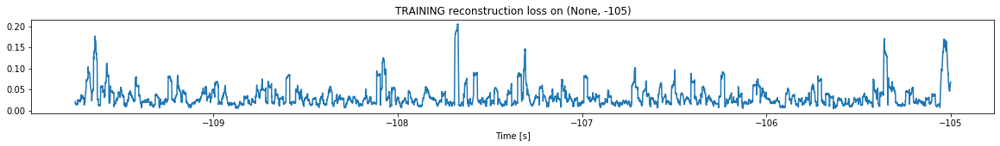

Finished training, median of the log(loss) is:  -1.5733650329925482
<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)


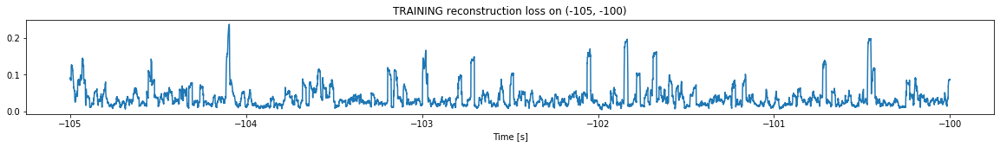

Finished training, median of the log(loss) is:  -1.5376424703325964
Triggering for section:  (-100, -95)
Using this median for triggering: -1.5733650329925482


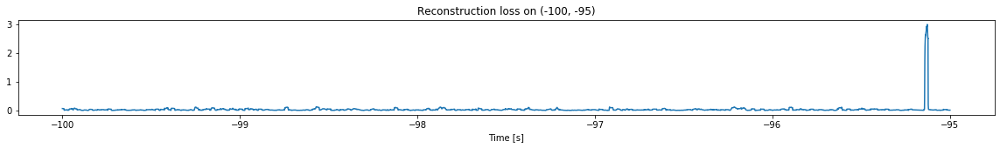

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)


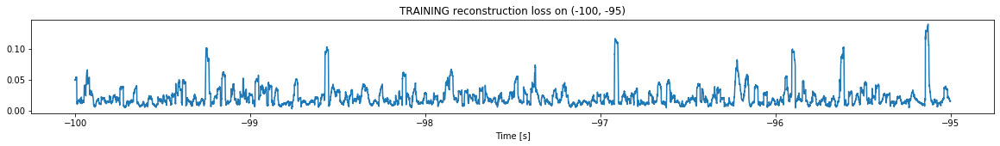

Finished training, median of the log(loss) is:  -1.7627438459081461
Triggering for section:  (-95, -90)
Using this median for triggering: -1.5376424703325964


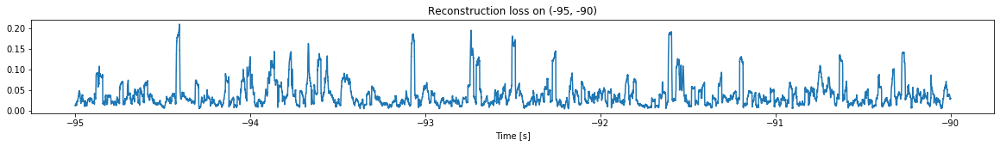

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)


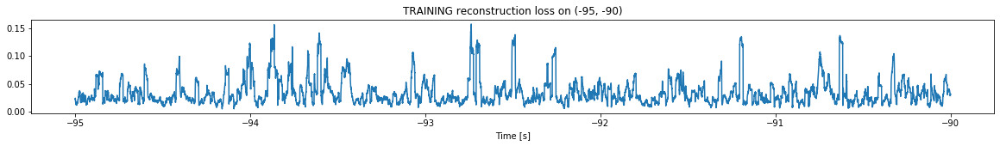

Finished training, median of the log(loss) is:  -1.5564286692723128
Triggering for section:  (-90, -85)
Using this median for triggering: -1.7627438459081461


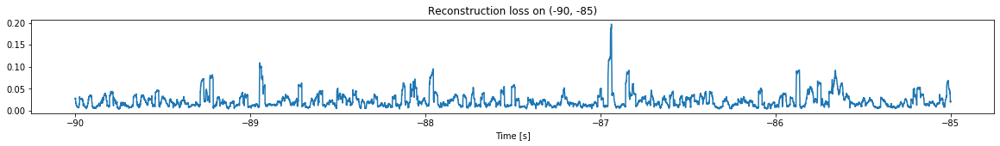

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)


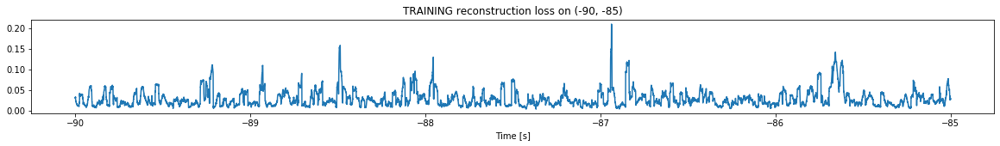

Finished training, median of the log(loss) is:  -1.6234174038333116
Triggering for section:  (-85, -80)
Using this median for triggering: -1.5564286692723128


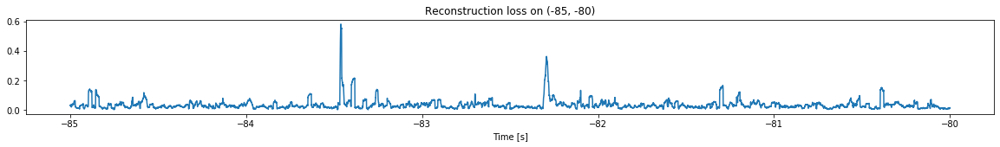

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


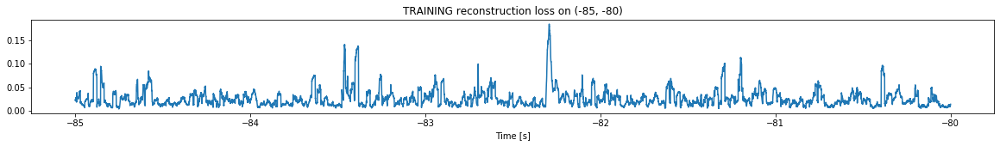

Finished training, median of the log(loss) is:  -1.6789841274199047
Triggering for section:  (-80, -75)
Using this median for triggering: -1.6234174038333116


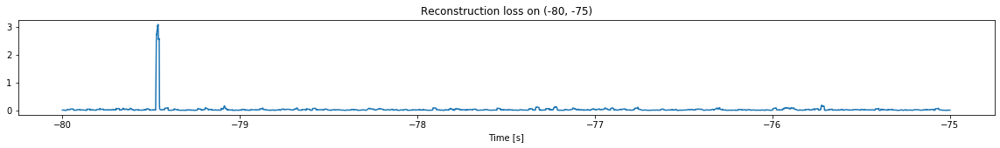

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


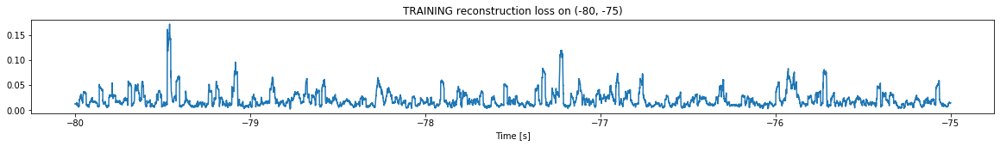

Finished training, median of the log(loss) is:  -1.7818563510132701
Triggering for section:  (-75, -70)
Using this median for triggering: -1.6789841274199047


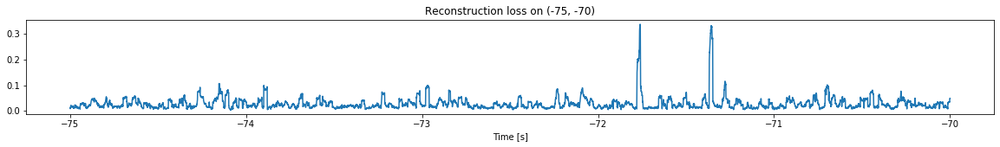

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


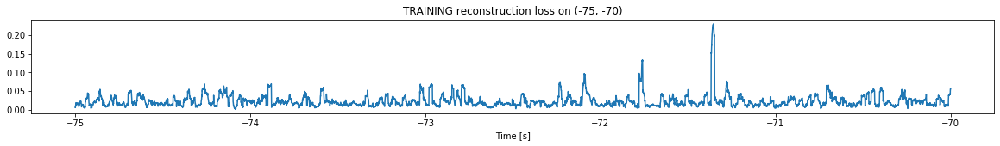

Finished training, median of the log(loss) is:  -1.7103719543235627
Triggering for section:  (-70, -65)
Using this median for triggering: -1.7818563510132701


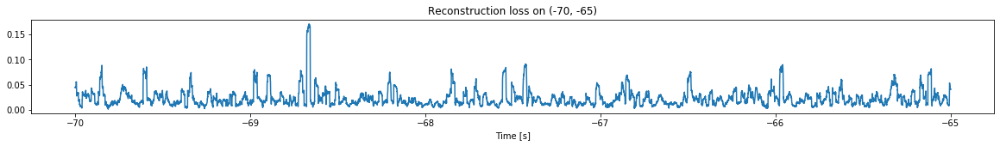

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


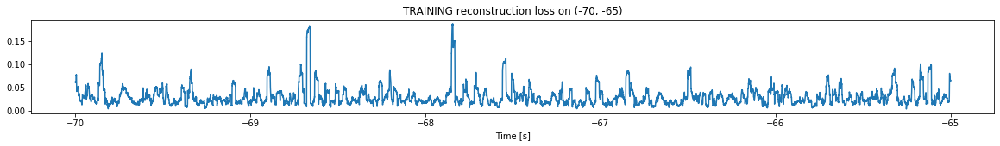

Finished training, median of the log(loss) is:  -1.6099103166816833
Triggering for section:  (-65, -60)
Using this median for triggering: -1.7103719543235627


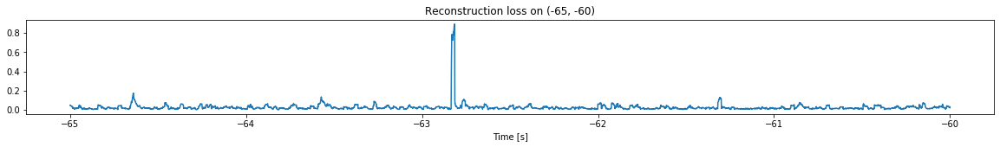

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


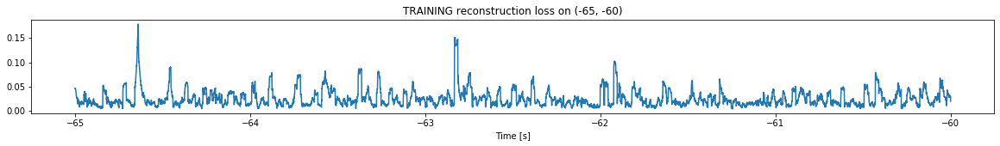

Finished training, median of the log(loss) is:  -1.6790859926290111
Triggering for section:  (-60, -55)
Using this median for triggering: -1.6099103166816833


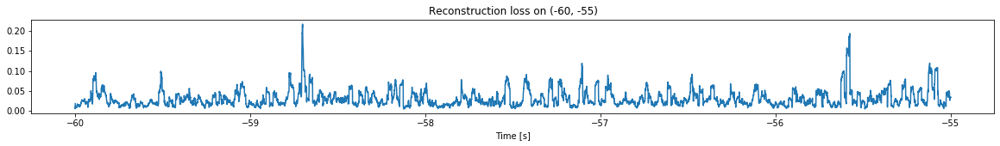

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


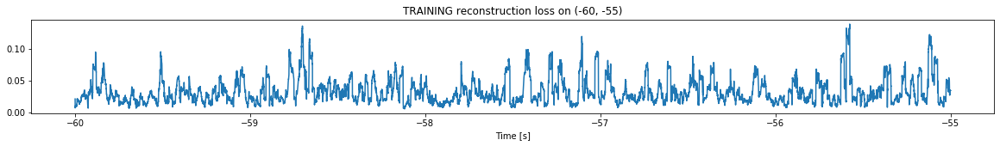

Finished training, median of the log(loss) is:  -1.5634112733171608
Triggering for section:  (-55, -50)
Using this median for triggering: -1.6790859926290111


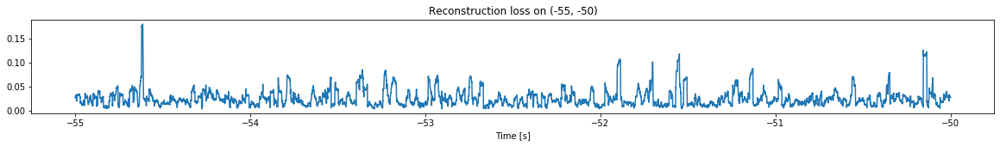

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


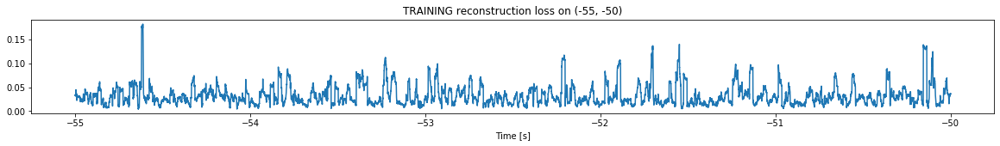

Finished training, median of the log(loss) is:  -1.5622444787603031
Triggering for section:  (-50, -45)
Using this median for triggering: -1.5634112733171608


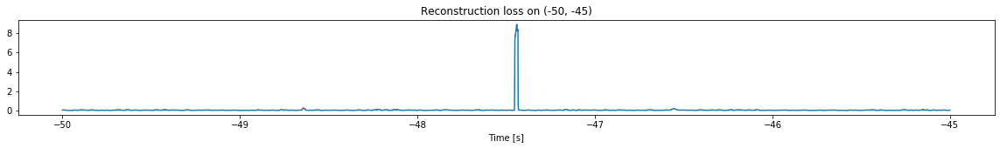

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


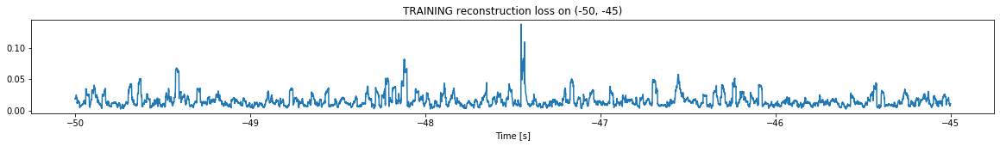

Finished training, median of the log(loss) is:  -1.8864238931383555
Triggering for section:  (-45, -40)
Using this median for triggering: -1.5622444787603031


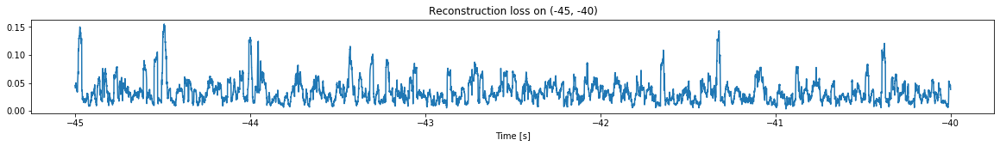

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


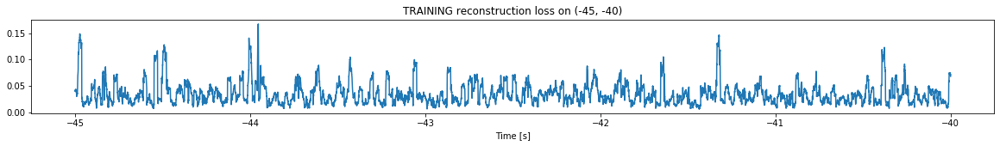

Finished training, median of the log(loss) is:  -1.5179671915373634
Triggering for section:  (-40, -35)
Using this median for triggering: -1.8864238931383555


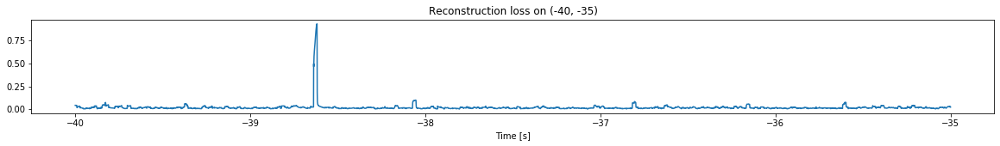

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


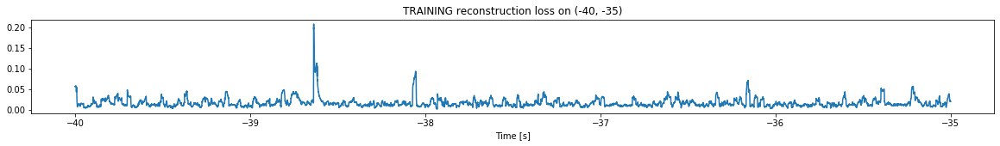

Finished training, median of the log(loss) is:  -1.8686287681449911
Triggering for section:  (-35, -30)
Using this median for triggering: -1.5179671915373634


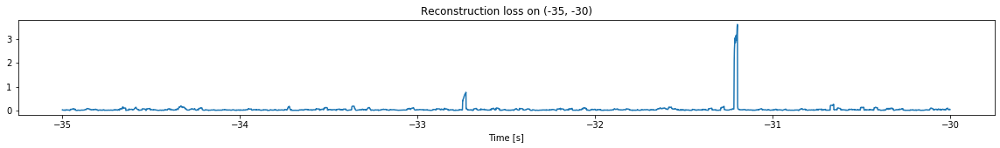

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


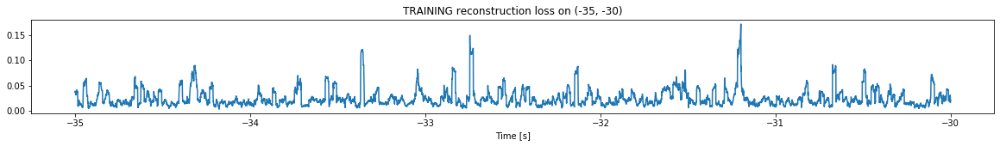

Finished training, median of the log(loss) is:  -1.7076744326536626
Triggering for section:  (-30, -25)
Using this median for triggering: -1.8686287681449911


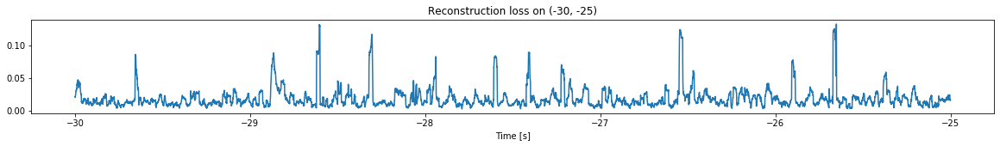

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


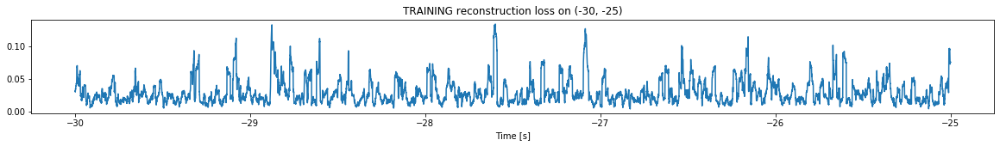

Finished training, median of the log(loss) is:  -1.6098161628324008
Triggering for section:  (-25, -20)
Using this median for triggering: -1.7076744326536626


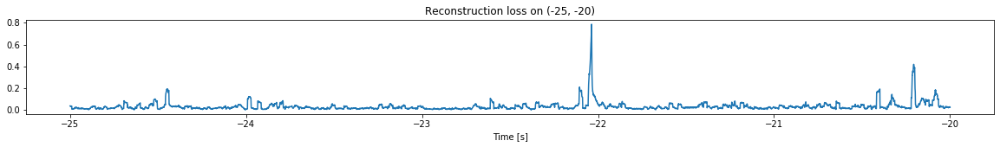

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


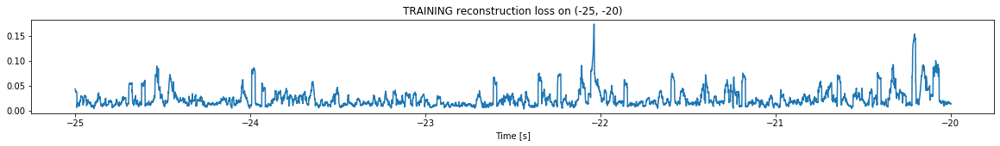

Finished training, median of the log(loss) is:  -1.7411475623562125
Triggering for section:  (-20, -15)
Using this median for triggering: -1.6098161628324008


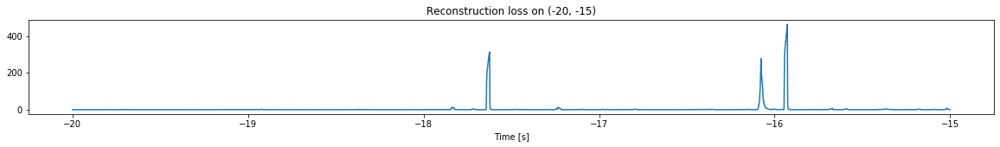

Other trigger time:  [-17.6234   -15.927199]
Their log loss values are:  [4.10733092 4.27662102]


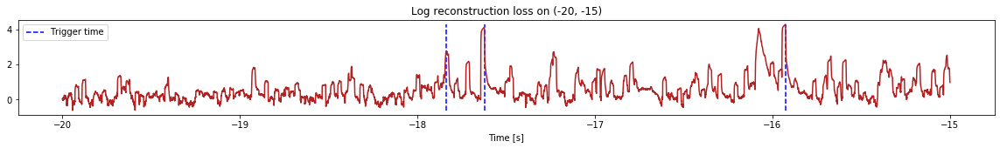

Triggered at:  [-17.6234, -15.927199]
<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


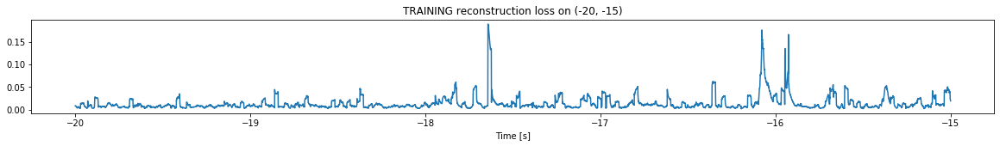

Finished training, median of the log(loss) is:  -2.014402058417218
Triggering for section:  (-15, -10)
Using this median for triggering: -1.7411475623562125


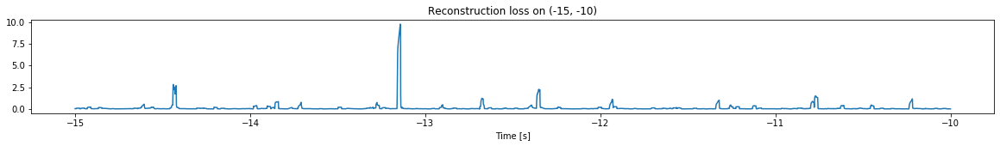

Other trigger time:  [-13.1426]
Their log loss values are:  [2.73097226]


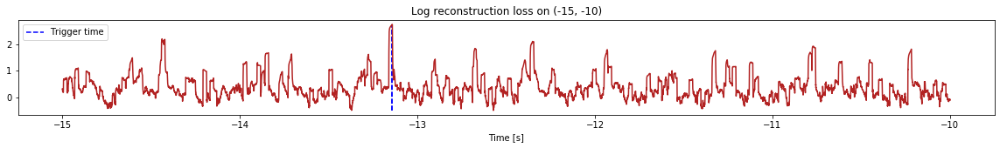

Triggered at:  [-13.1426]
<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


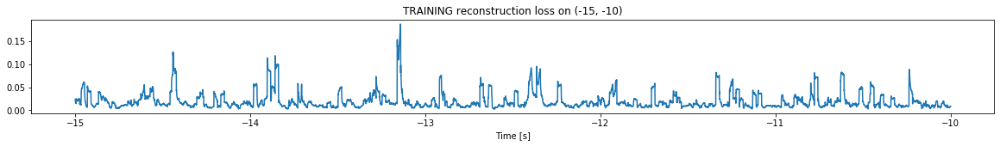

Finished training, median of the log(loss) is:  -1.8593633370240306
Triggering for section:  (-10, -5)
Using this median for triggering: -2.014402058417218


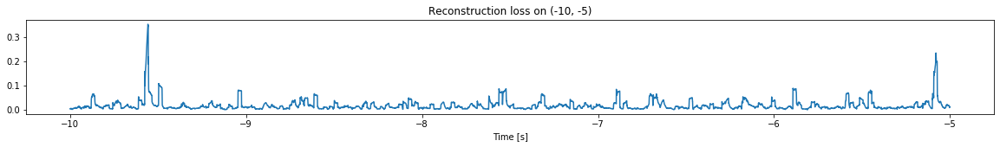

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


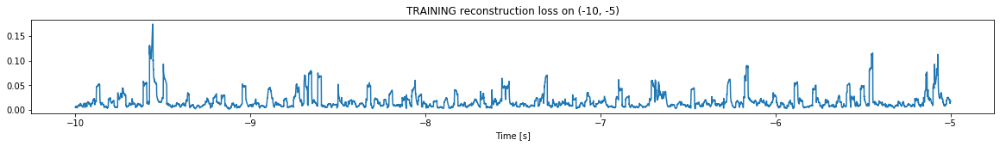

Finished training, median of the log(loss) is:  -1.9019683058943189
Triggering for section:  (-5, 0)
Using this median for triggering: -1.8593633370240306


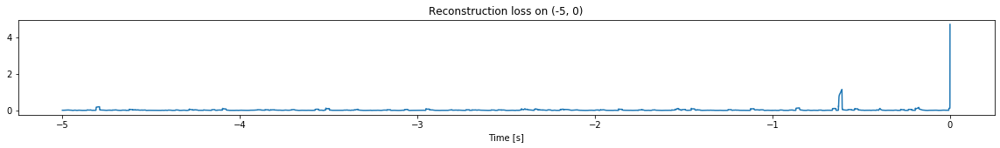

<--------
Finished simulation, all the triggered times are:  [[-17.6234, -15.927199], [-13.1426]]


In [15]:
simulation("./data/Ramp24/", 5, (-110,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (997500, 12)
Flushing input history
Number of sections: 20
Entering sections:  (-100, -95)
-------->
Entering sections:  (-95, -90)
-------->
Training for section:  (None, -95)


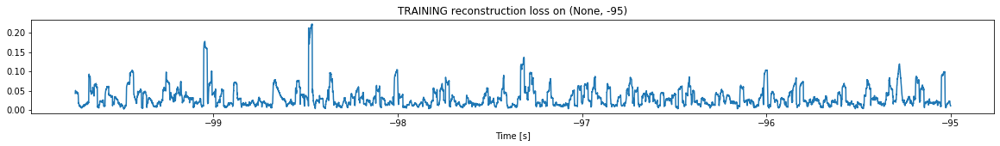

Finished training, median of the log(loss) is:  -1.6108479510653502
<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)


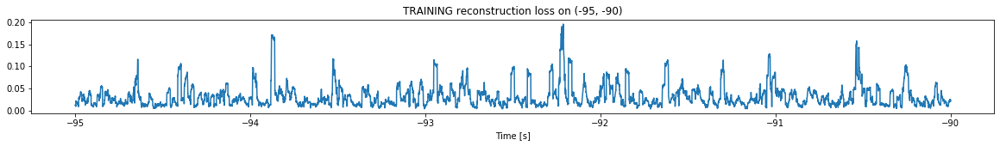

Finished training, median of the log(loss) is:  -1.588473673683136
Triggering for section:  (-90, -85)
Using this median for triggering: -1.6108479510653502


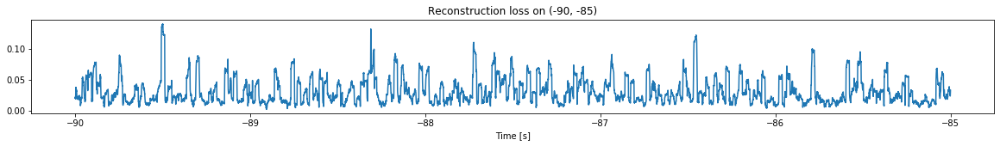

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)


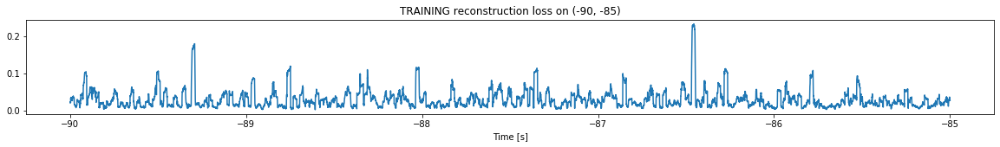

Finished training, median of the log(loss) is:  -1.6238424960414566
Triggering for section:  (-85, -80)
Using this median for triggering: -1.588473673683136


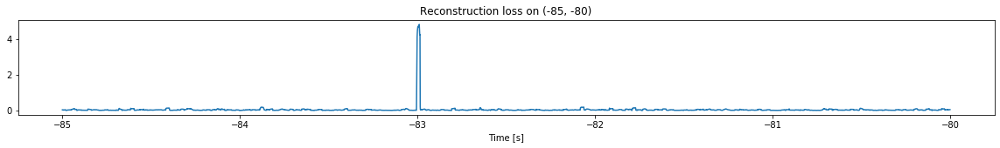

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


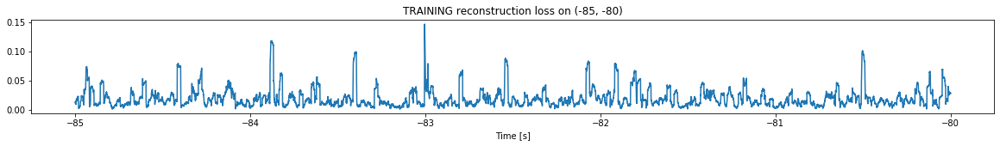

Finished training, median of the log(loss) is:  -1.7870433692599041
Triggering for section:  (-80, -75)
Using this median for triggering: -1.6238424960414566


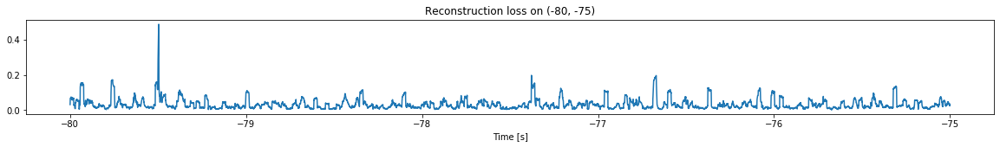

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


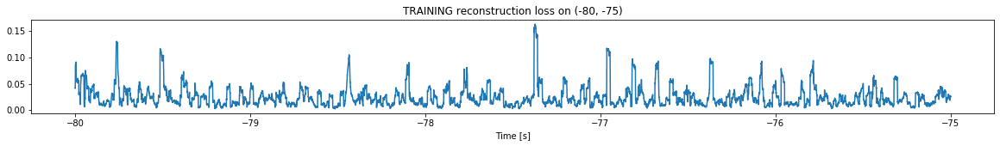

Finished training, median of the log(loss) is:  -1.6986798510915202
Triggering for section:  (-75, -70)
Using this median for triggering: -1.7870433692599041


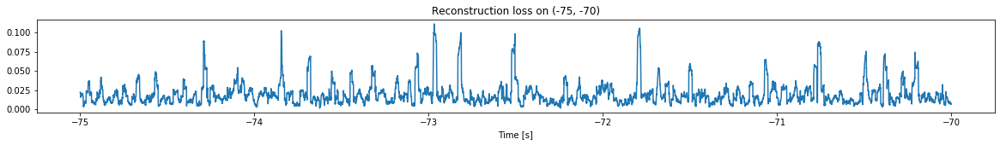

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


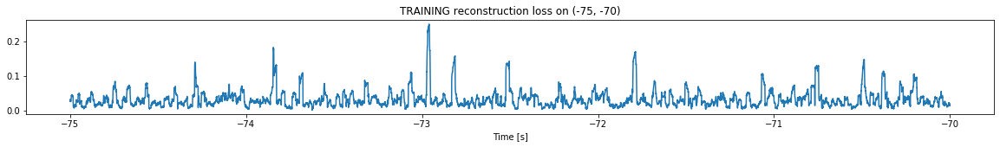

Finished training, median of the log(loss) is:  -1.5620081932476615
Triggering for section:  (-70, -65)
Using this median for triggering: -1.6986798510915202


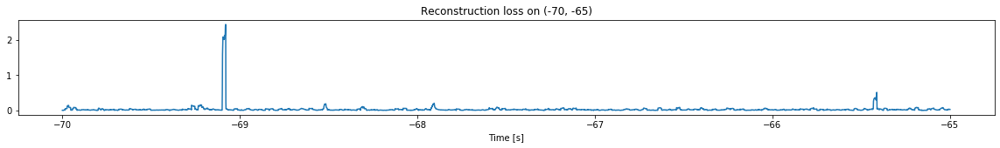

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


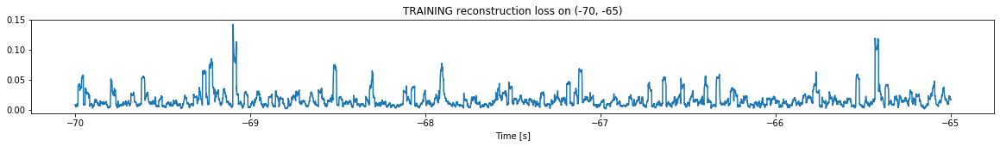

Finished training, median of the log(loss) is:  -1.8783432499513582
Triggering for section:  (-65, -60)
Using this median for triggering: -1.5620081932476615


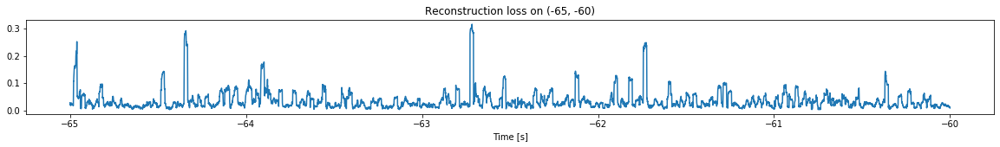

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


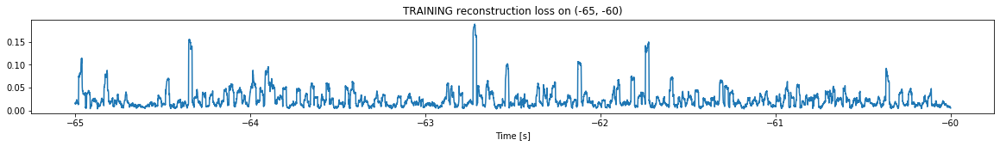

Finished training, median of the log(loss) is:  -1.732605353410206
Triggering for section:  (-60, -55)
Using this median for triggering: -1.8783432499513582


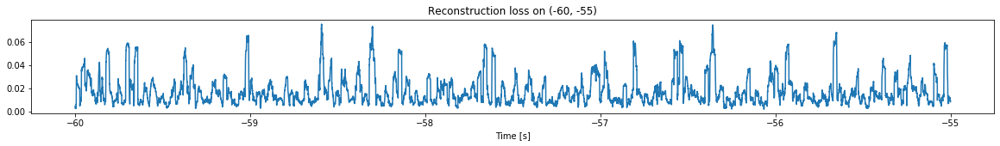

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


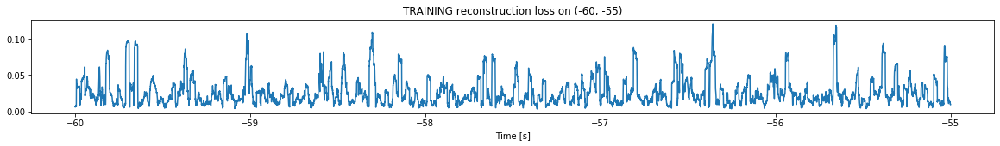

Finished training, median of the log(loss) is:  -1.678549708862349
Triggering for section:  (-55, -50)
Using this median for triggering: -1.732605353410206


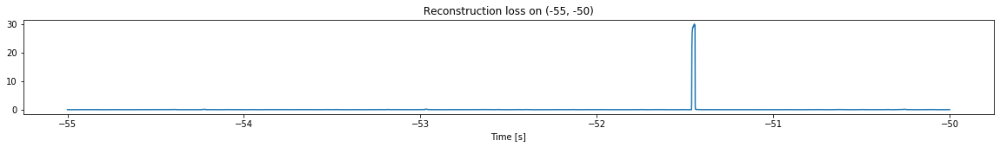

Other trigger time:  [-51.4463]
Their log loss values are:  [3.21003929]


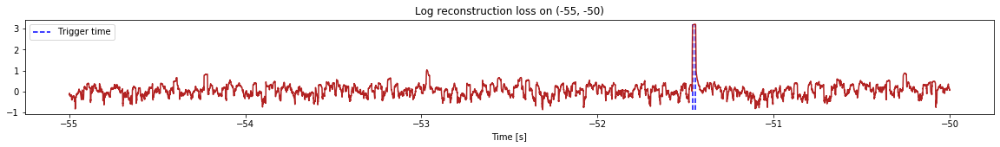

Triggered at:  [-51.4463]
<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


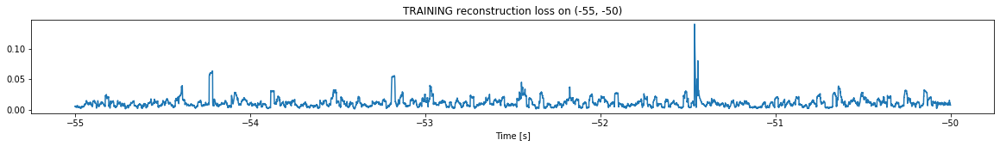

Finished training, median of the log(loss) is:  -2.0129040074944213
Triggering for section:  (-50, -45)
Using this median for triggering: -1.678549708862349


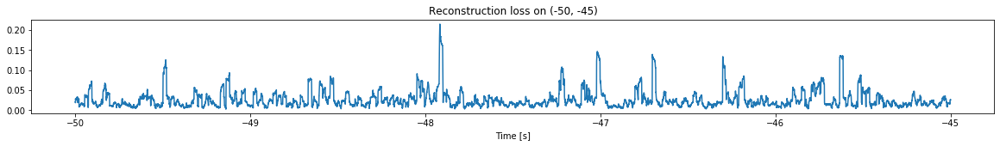

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


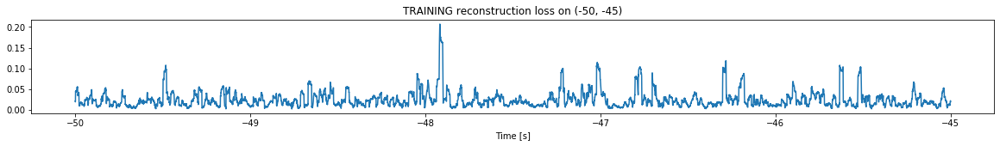

Finished training, median of the log(loss) is:  -1.6940396810875993
Triggering for section:  (-45, -40)
Using this median for triggering: -2.0129040074944213


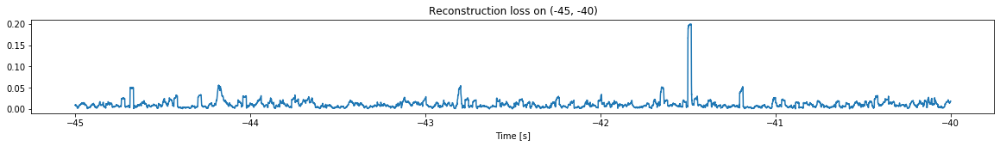

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


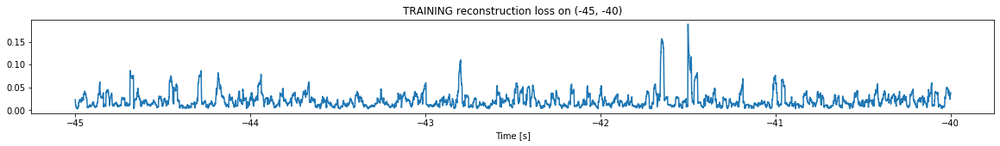

Finished training, median of the log(loss) is:  -1.7619389533081216
Triggering for section:  (-40, -35)
Using this median for triggering: -1.6940396810875993


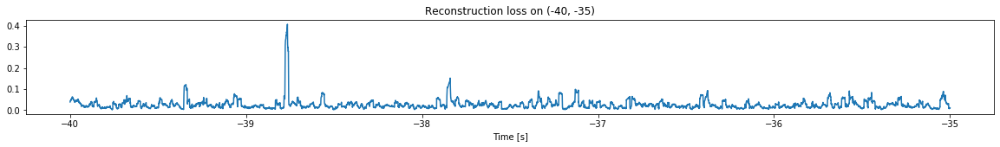

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


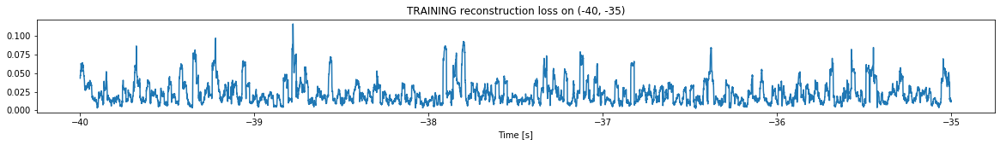

Finished training, median of the log(loss) is:  -1.7139823759339823
Triggering for section:  (-35, -30)
Using this median for triggering: -1.7619389533081216


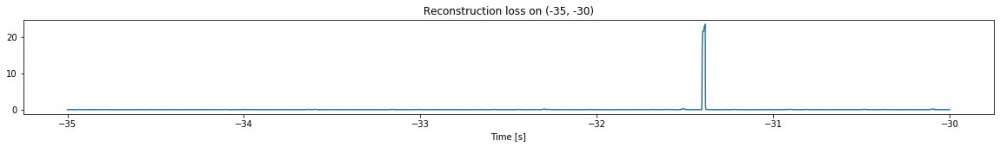

Other trigger time:  [-31.3849]
Their log loss values are:  [3.13616277]


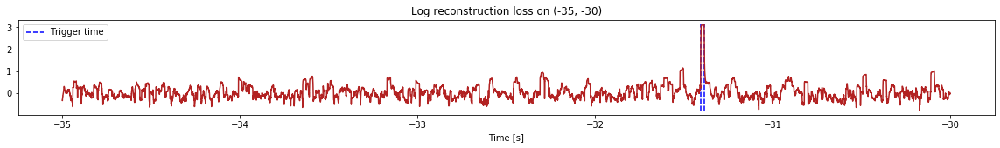

Triggered at:  [-31.3849]
<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


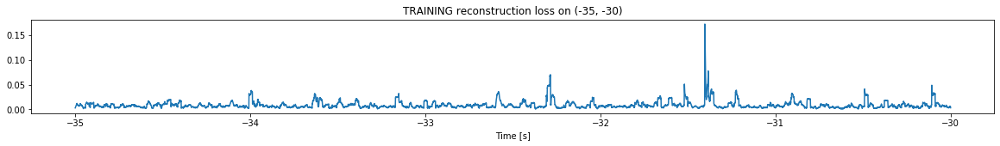

Finished training, median of the log(loss) is:  -2.160457539238892
Triggering for section:  (-30, -25)
Using this median for triggering: -1.7139823759339823


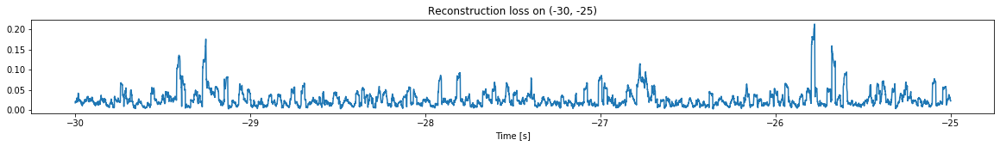

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


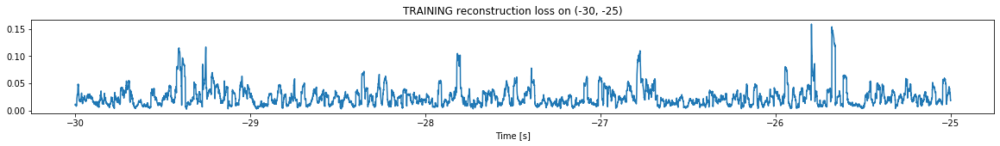

Finished training, median of the log(loss) is:  -1.6820032329793033
Triggering for section:  (-25, -20)
Using this median for triggering: -2.160457539238892


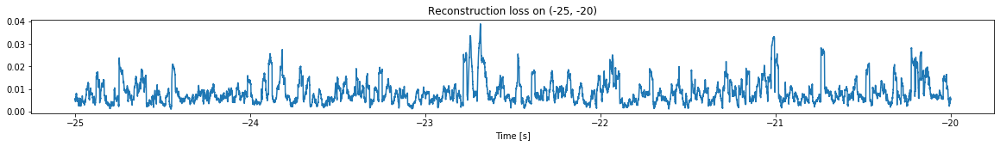

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


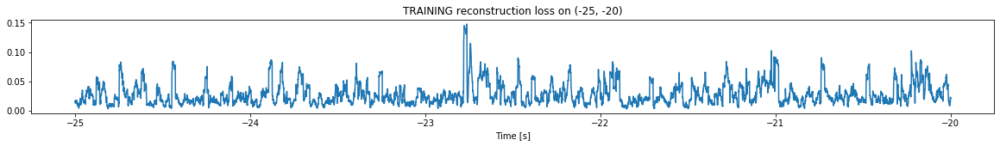

Finished training, median of the log(loss) is:  -1.6286162700076674
Triggering for section:  (-20, -15)
Using this median for triggering: -1.6820032329793033


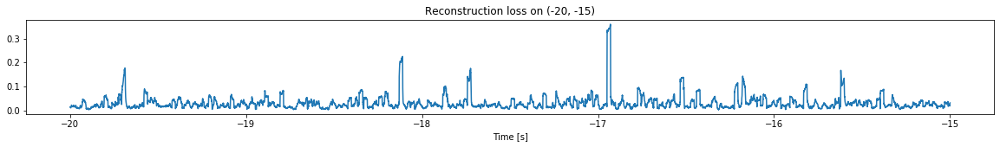

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


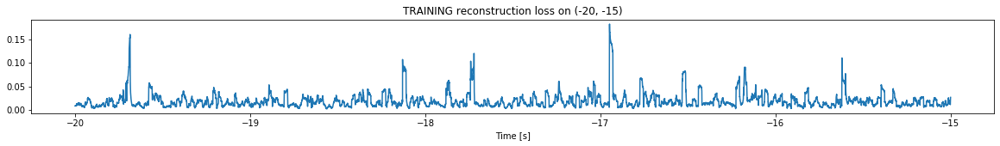

Finished training, median of the log(loss) is:  -1.8075912503352407
Triggering for section:  (-15, -10)
Using this median for triggering: -1.6286162700076674


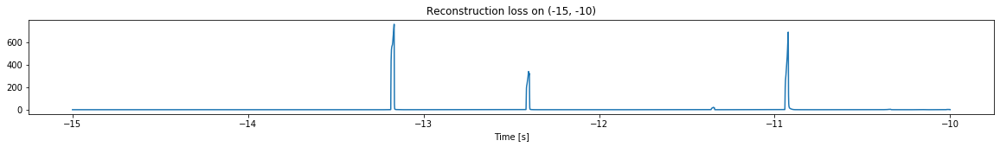

Other trigger time:  [-13.1676   -12.4017   -10.922299]
Their log loss values are:  [4.50966588 4.1599379  4.46770254]


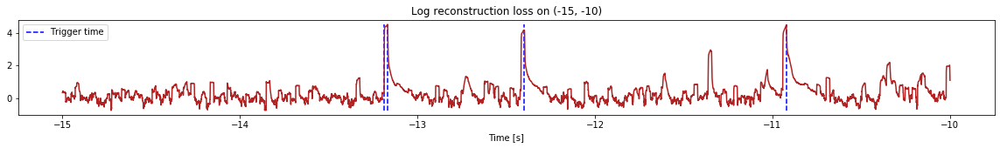

Triggered at:  [-13.1676, -12.4017, -10.922299]
<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


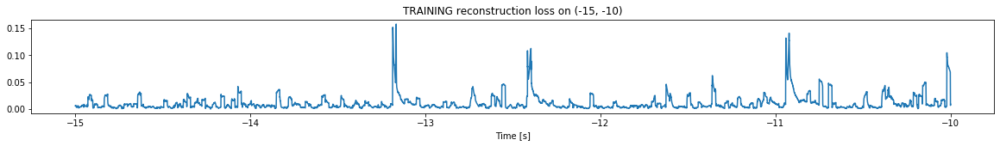

Finished training, median of the log(loss) is:  -2.1715429477919033
Triggering for section:  (-10, -5)
Using this median for triggering: -1.8075912503352407


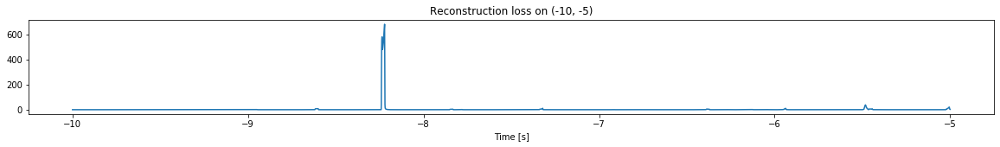

Other trigger time:  [-8.2217    -7.3210998 -5.4825   ]
Their log loss values are:  [4.64184999 2.85709303 3.39294086]


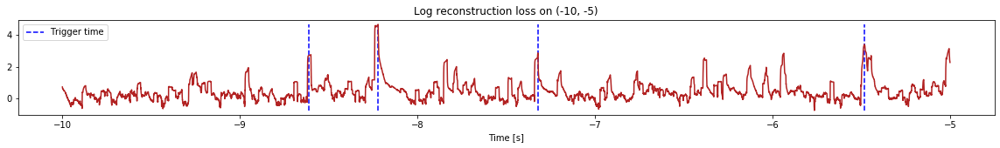

Triggered at:  [-8.2217, -7.3210998, -5.4825]
<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


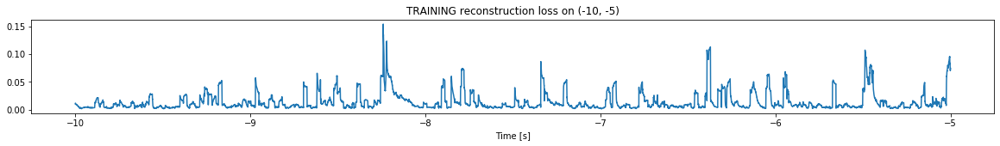

Finished training, median of the log(loss) is:  -2.0782635821919055
Triggering for section:  (-5, 0)
Using this median for triggering: -2.1715429477919033


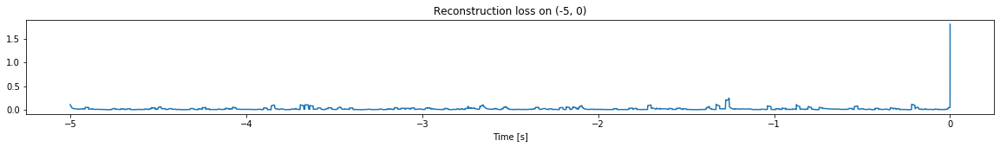

<--------
Finished simulation, all the triggered times are:  [[-51.4463], [-31.3849], [-13.1676, -12.4017, -10.922299], [-8.2217, -7.3210998, -5.4825]]


In [16]:
simulation("./data/Ramp25/", 5, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1097500, 12)
Flushing input history
Number of sections: 22
Entering sections:  (-110, -105)
-------->
Entering sections:  (-105, -100)
-------->
Training for section:  (None, -105)


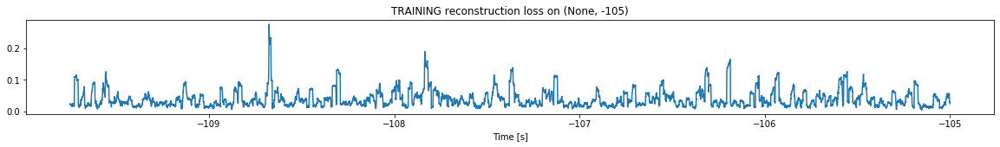

Finished training, median of the log(loss) is:  -1.4888008960443768
<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)


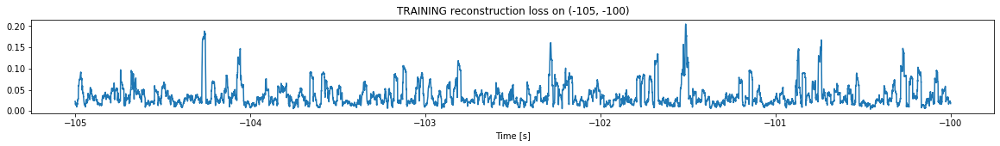

Finished training, median of the log(loss) is:  -1.537863190667128
Triggering for section:  (-100, -95)
Using this median for triggering: -1.4888008960443768


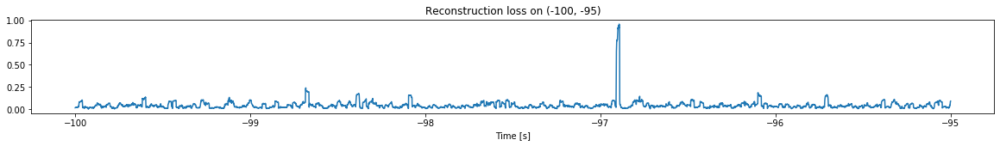

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)


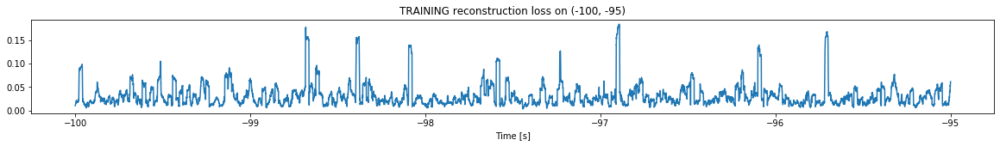

Finished training, median of the log(loss) is:  -1.5904569023872166
Triggering for section:  (-95, -90)
Using this median for triggering: -1.537863190667128


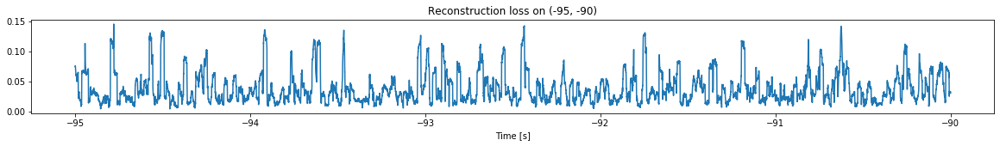

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)


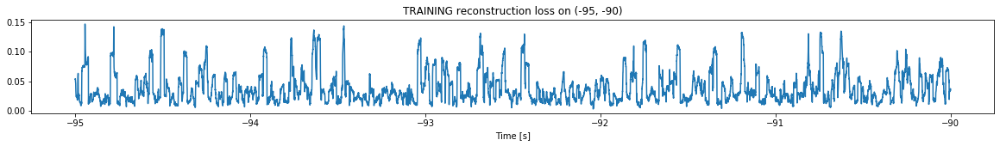

Finished training, median of the log(loss) is:  -1.5108770789905597
Triggering for section:  (-90, -85)
Using this median for triggering: -1.5904569023872166


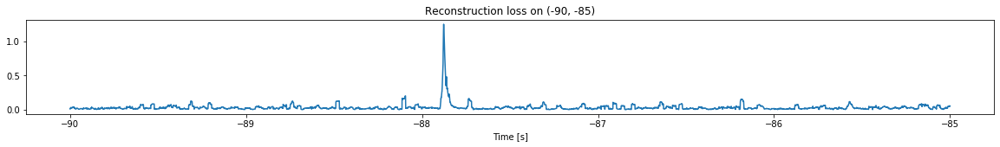

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)


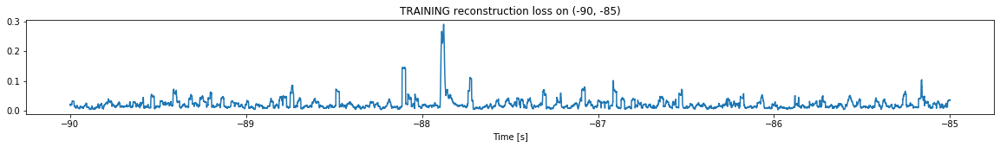

Finished training, median of the log(loss) is:  -1.7830674975162917
Triggering for section:  (-85, -80)
Using this median for triggering: -1.5108770789905597


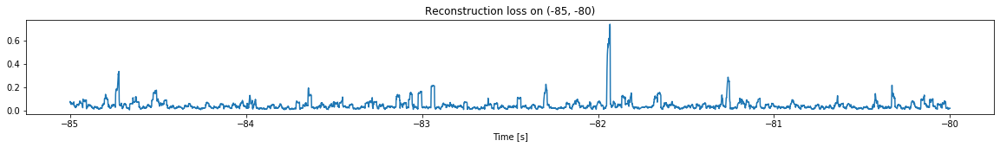

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


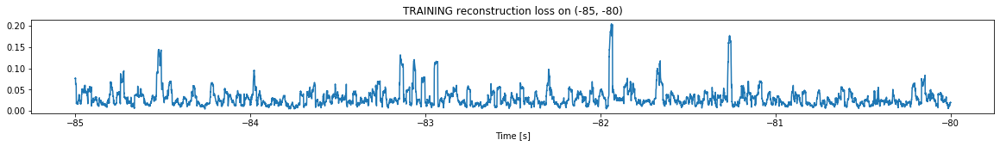

Finished training, median of the log(loss) is:  -1.596403701418796
Triggering for section:  (-80, -75)
Using this median for triggering: -1.7830674975162917


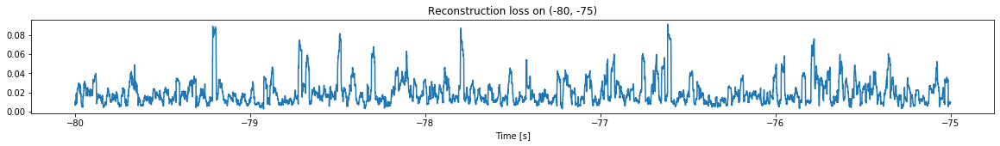

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


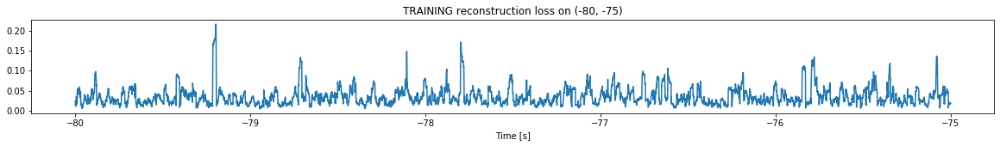

Finished training, median of the log(loss) is:  -1.517322618828603
Triggering for section:  (-75, -70)
Using this median for triggering: -1.596403701418796


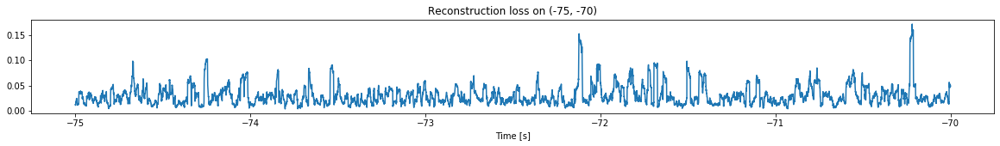

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


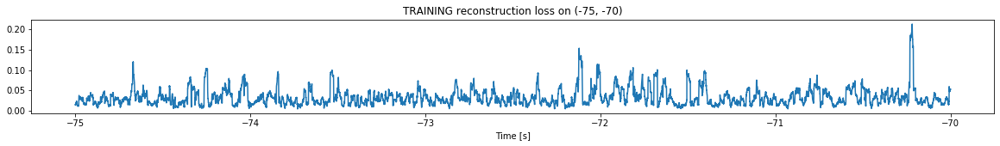

Finished training, median of the log(loss) is:  -1.5462332546662303
Triggering for section:  (-70, -65)
Using this median for triggering: -1.517322618828603


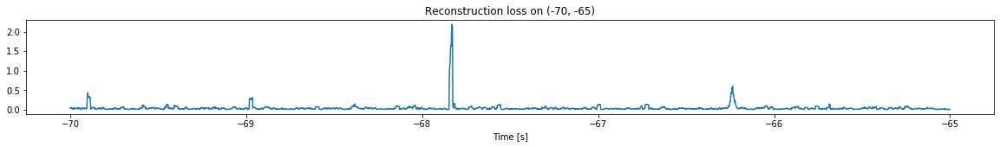

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


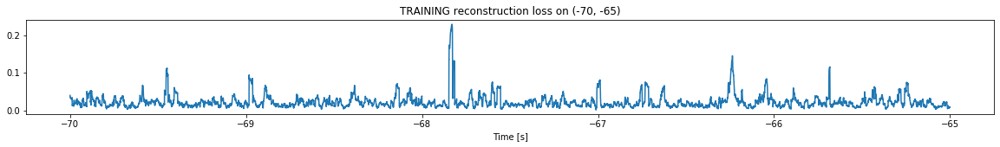

Finished training, median of the log(loss) is:  -1.732565270453213
Triggering for section:  (-65, -60)
Using this median for triggering: -1.5462332546662303


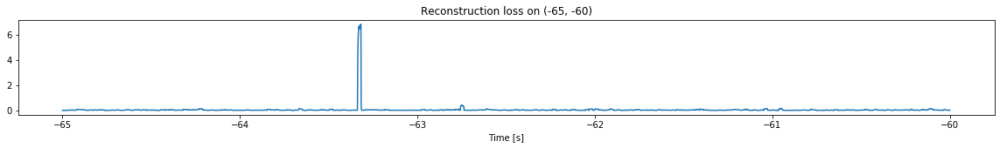

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


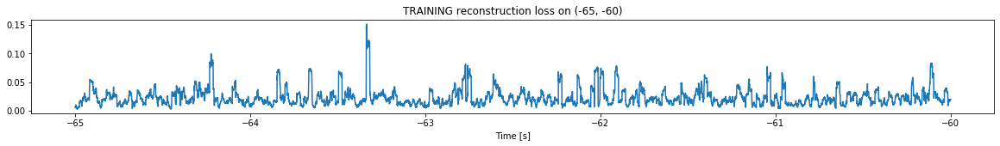

Finished training, median of the log(loss) is:  -1.7013224173451573
Triggering for section:  (-60, -55)
Using this median for triggering: -1.732565270453213


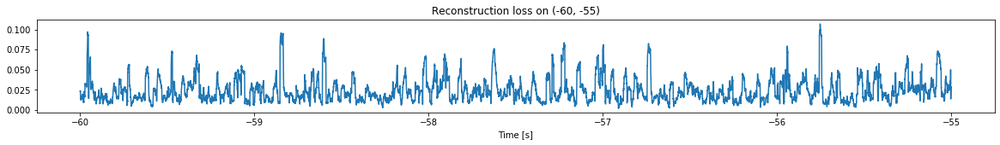

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


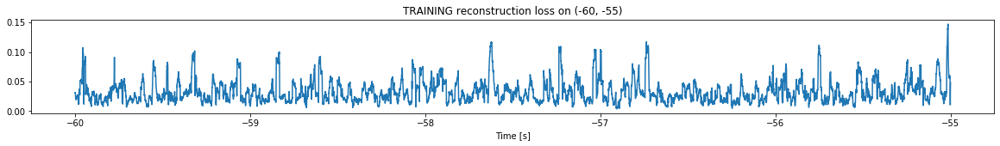

Finished training, median of the log(loss) is:  -1.5460110623003216
Triggering for section:  (-55, -50)
Using this median for triggering: -1.7013224173451573


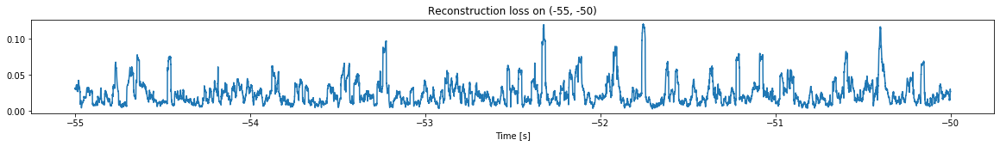

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


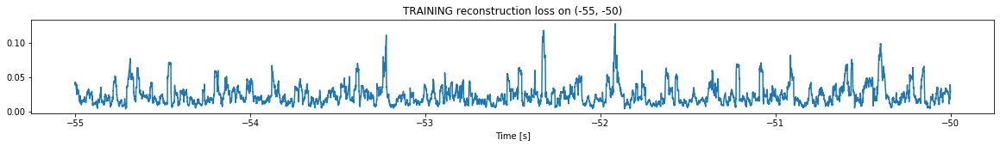

Finished training, median of the log(loss) is:  -1.6951667673429802
Triggering for section:  (-50, -45)
Using this median for triggering: -1.5460110623003216


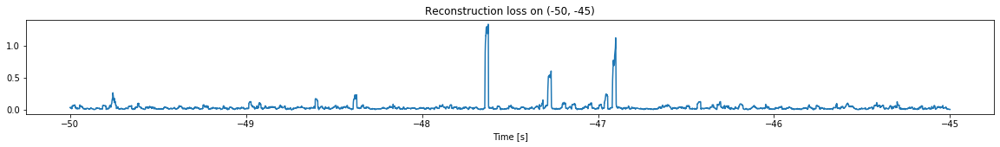

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


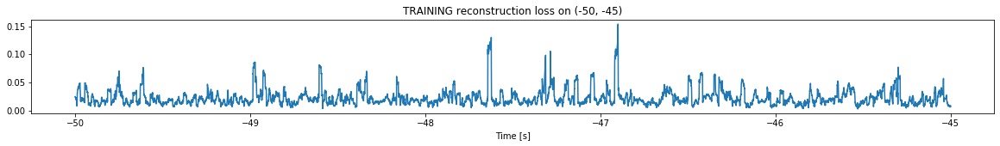

Finished training, median of the log(loss) is:  -1.7281233987214062
Triggering for section:  (-45, -40)
Using this median for triggering: -1.6951667673429802


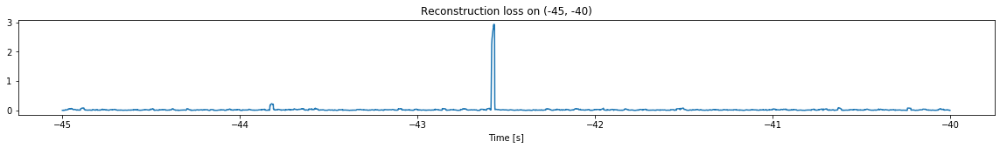

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


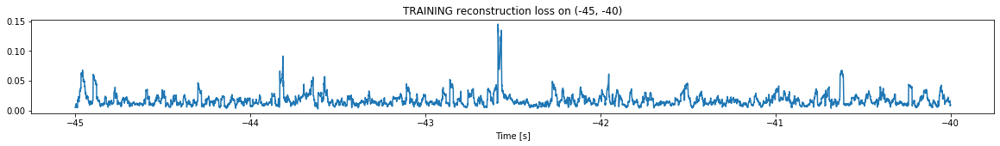

Finished training, median of the log(loss) is:  -1.8198882752034509
Triggering for section:  (-40, -35)
Using this median for triggering: -1.7281233987214062


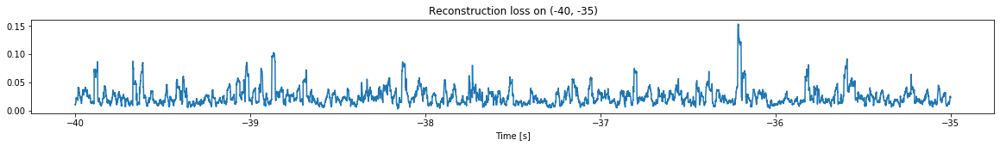

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


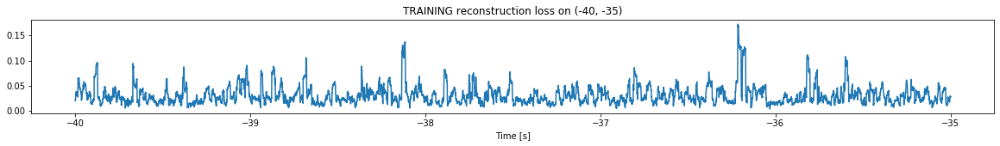

Finished training, median of the log(loss) is:  -1.5860908312961932
Triggering for section:  (-35, -30)
Using this median for triggering: -1.8198882752034509


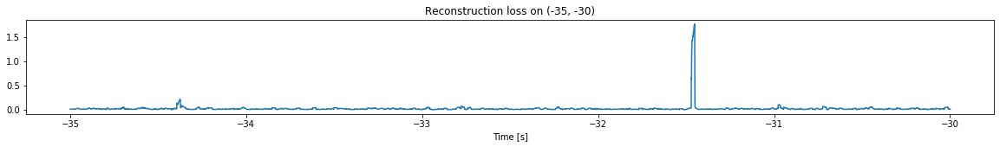

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


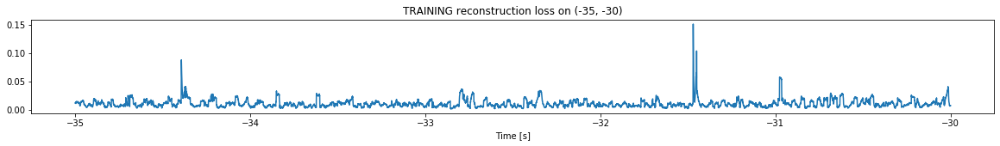

Finished training, median of the log(loss) is:  -1.9892264072039192
Triggering for section:  (-30, -25)
Using this median for triggering: -1.5860908312961932


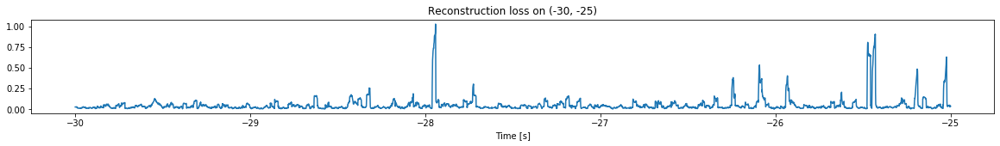

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


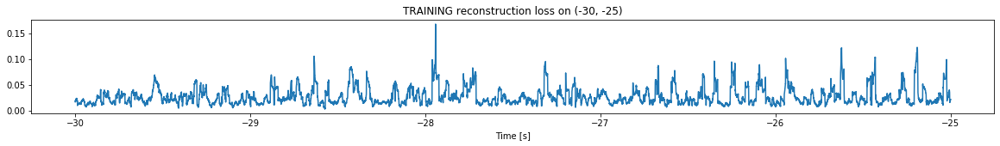

Finished training, median of the log(loss) is:  -1.6538331521552299
Triggering for section:  (-25, -20)
Using this median for triggering: -1.9892264072039192


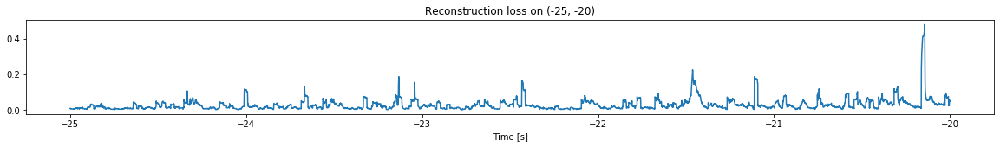

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


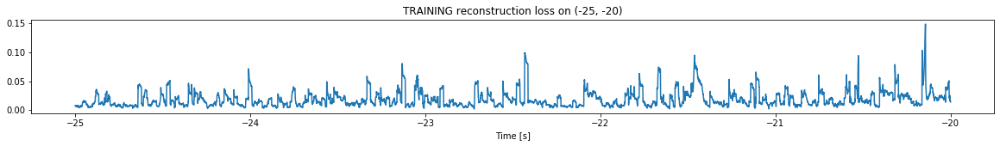

Finished training, median of the log(loss) is:  -1.8371049095691045
Triggering for section:  (-20, -15)
Using this median for triggering: -1.6538331521552299


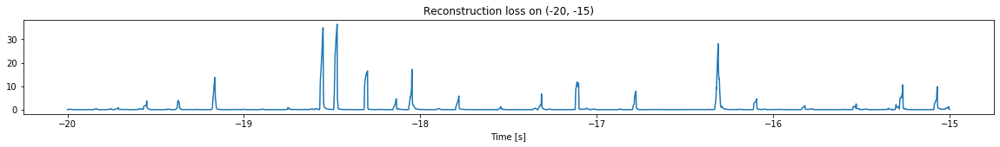

Other trigger time:  [-19.1645 -18.4714 -17.112  -16.3121]
Their log loss values are:  [2.79226798 3.21528655 2.72705214 3.10271186]


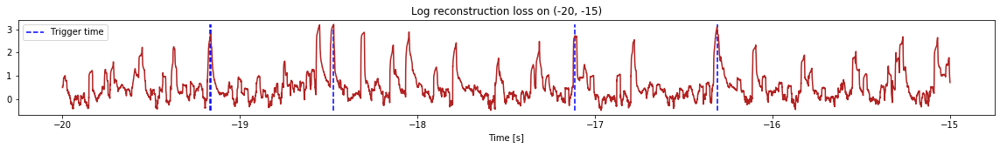

Triggered at:  [-19.1645, -18.4714, -17.112, -16.3121]
<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


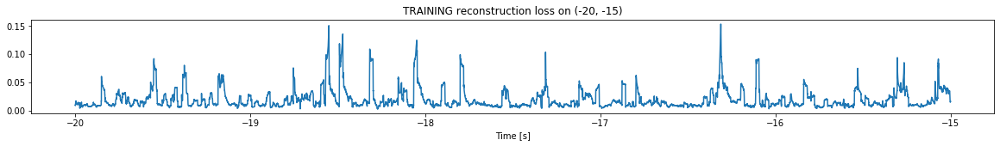

Finished training, median of the log(loss) is:  -1.8578694627757346
Triggering for section:  (-15, -10)
Using this median for triggering: -1.8371049095691045


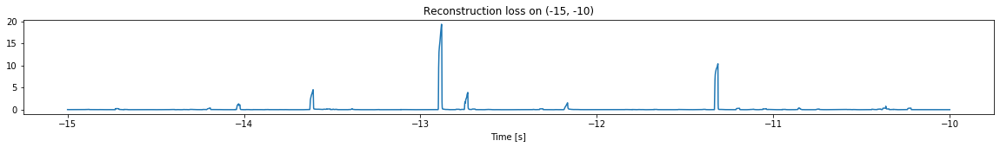

Other trigger time:  [-12.8805 -11.3139]
Their log loss values are:  [3.1243729  2.85478379]


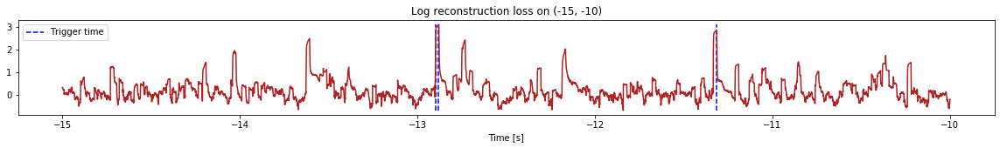

Triggered at:  [-12.8805, -11.3139]
<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


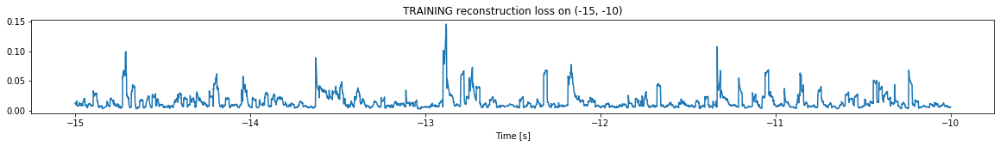

Finished training, median of the log(loss) is:  -2.000972990733575
Triggering for section:  (-10, -5)
Using this median for triggering: -1.8578694627757346


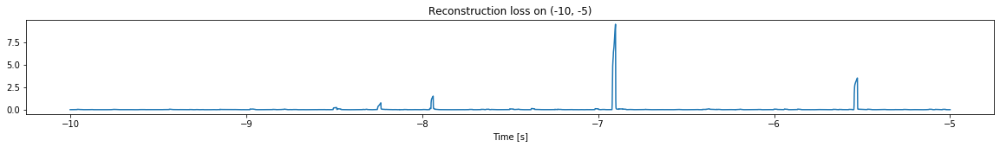

Other trigger time:  [-6.9013]
Their log loss values are:  [2.83501267]


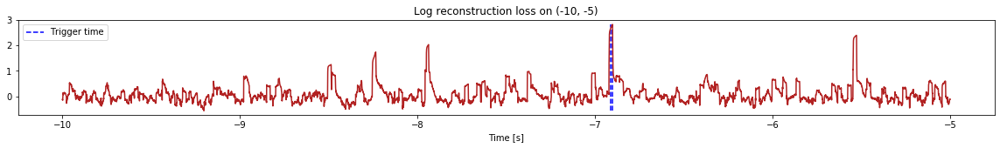

Triggered at:  [-6.9013]
<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


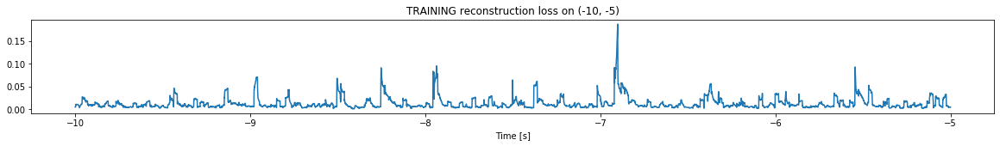

Finished training, median of the log(loss) is:  -2.038785992795799
Triggering for section:  (-5, 0)
Using this median for triggering: -2.000972990733575


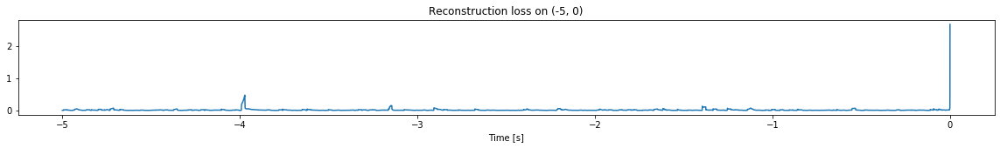

<--------
Finished simulation, all the triggered times are:  [[-19.1645, -18.4714, -17.112, -16.3121], [-12.8805, -11.3139], [-6.9013]]


In [17]:
simulation("./data/Ramp26/", 5, (-110,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (697500, 12)
Flushing input history
Number of sections: 14
Entering sections:  (-70, -65)
-------->
Entering sections:  (-65, -60)
-------->
Training for section:  (None, -65)


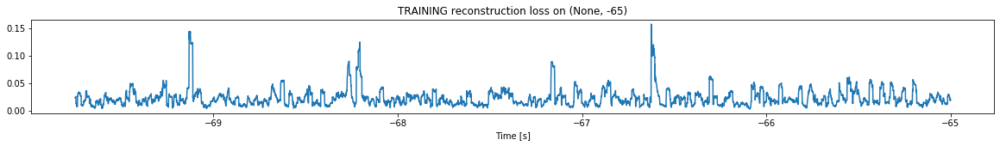

Finished training, median of the log(loss) is:  -1.7167637783087382
<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


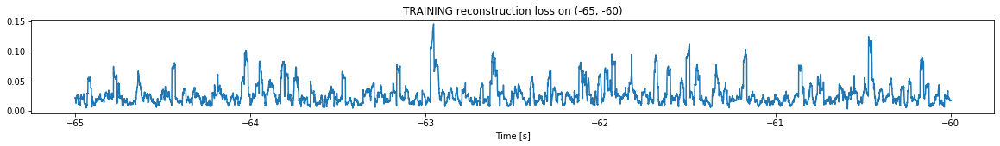

Finished training, median of the log(loss) is:  -1.6360516024649439
Triggering for section:  (-60, -55)
Using this median for triggering: -1.7167637783087382


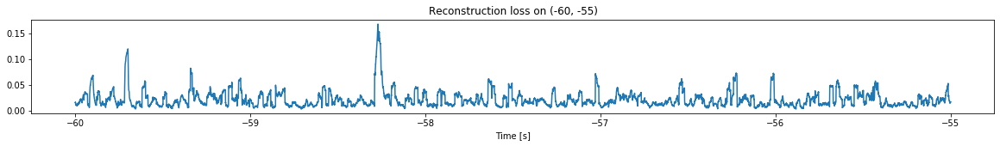

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


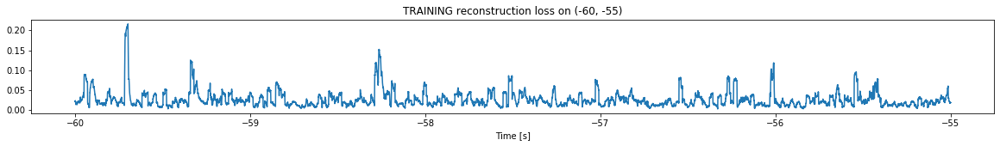

Finished training, median of the log(loss) is:  -1.6613990504131493
Triggering for section:  (-55, -50)
Using this median for triggering: -1.6360516024649439


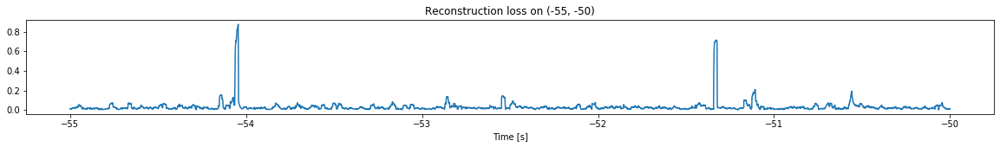

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


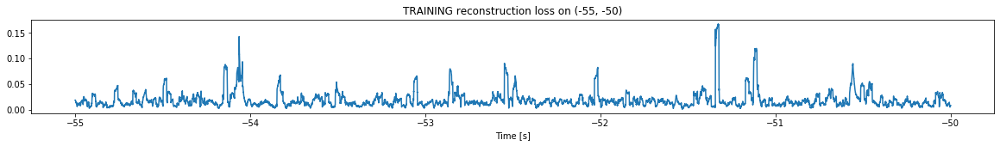

Finished training, median of the log(loss) is:  -1.801704482840266
Triggering for section:  (-50, -45)
Using this median for triggering: -1.6613990504131493


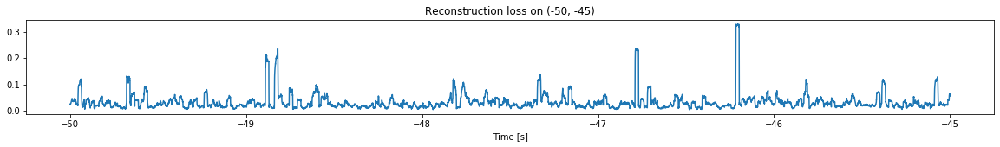

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


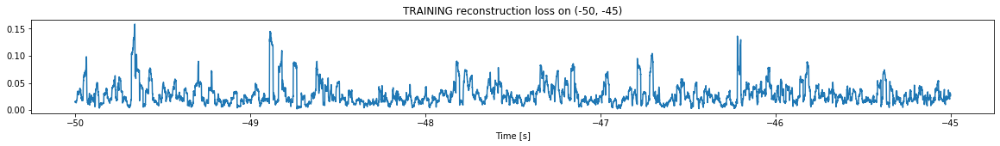

Finished training, median of the log(loss) is:  -1.6295988231884007
Triggering for section:  (-45, -40)
Using this median for triggering: -1.801704482840266


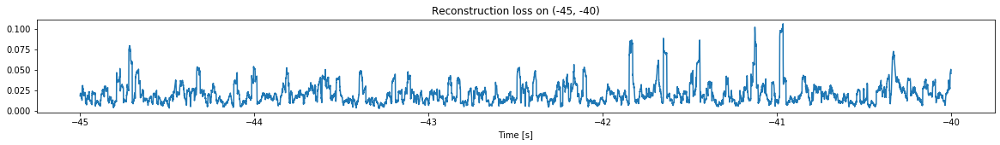

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


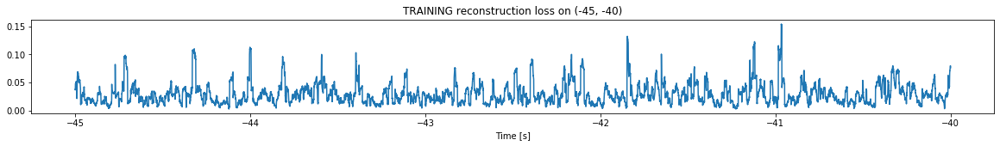

Finished training, median of the log(loss) is:  -1.5859400203343847
Triggering for section:  (-40, -35)
Using this median for triggering: -1.6295988231884007


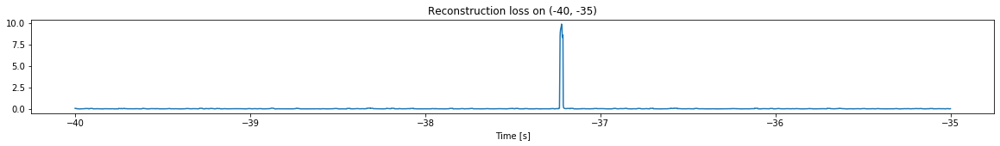

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


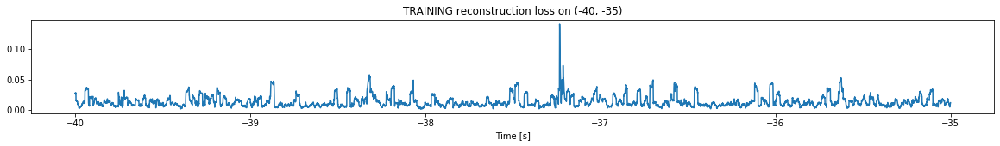

Finished training, median of the log(loss) is:  -1.954476507559414
Triggering for section:  (-35, -30)
Using this median for triggering: -1.5859400203343847


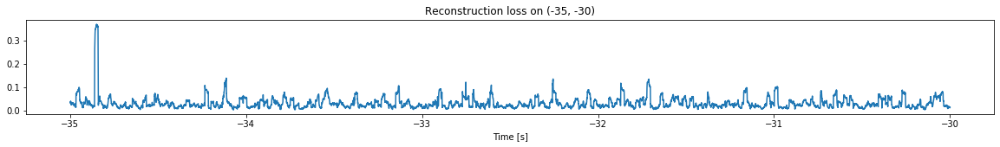

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


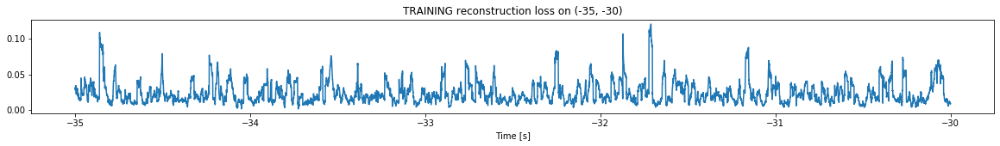

Finished training, median of the log(loss) is:  -1.703190016685986
Triggering for section:  (-30, -25)
Using this median for triggering: -1.954476507559414


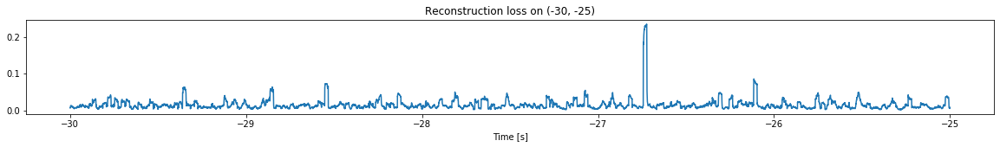

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


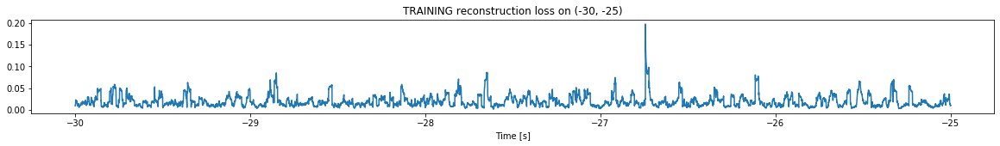

Finished training, median of the log(loss) is:  -1.7858784373885792
Triggering for section:  (-25, -20)
Using this median for triggering: -1.703190016685986


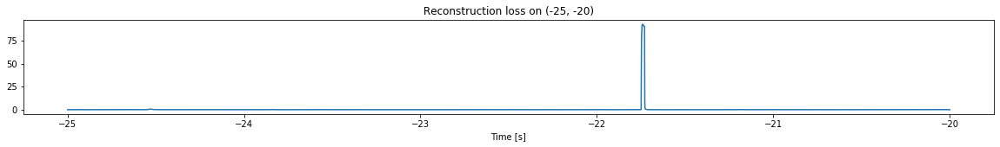

Other trigger time:  [-21.7405]
Their log loss values are:  [3.67254934]


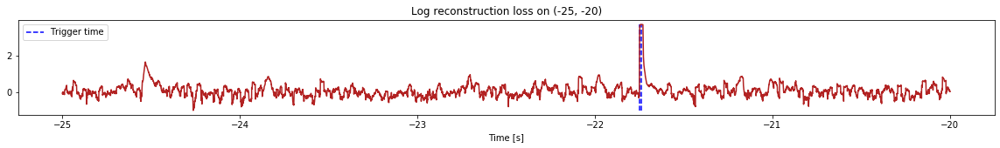

Triggered at:  [-21.7405]
<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


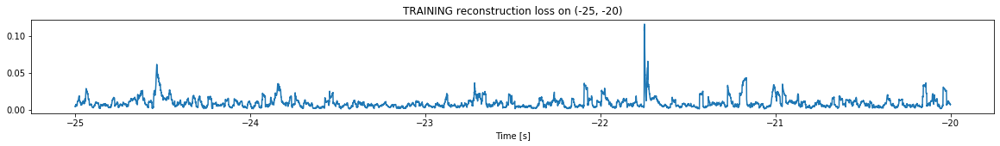

Finished training, median of the log(loss) is:  -2.145918483256203
Triggering for section:  (-20, -15)
Using this median for triggering: -1.7858784373885792


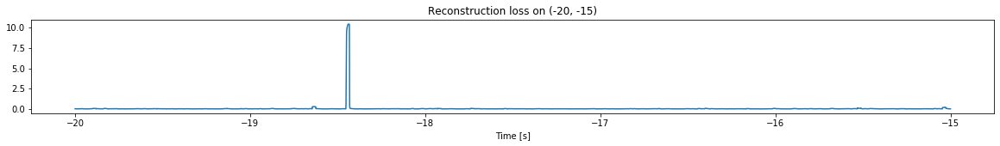

Other trigger time:  [-18.4396]
Their log loss values are:  [2.80461458]


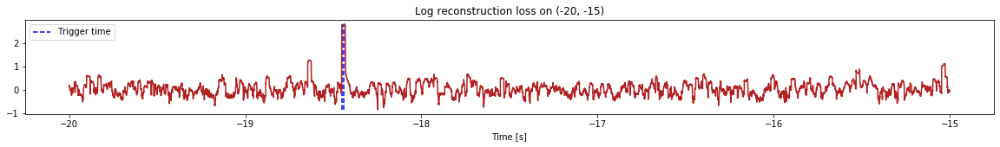

Triggered at:  [-18.4396]
<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


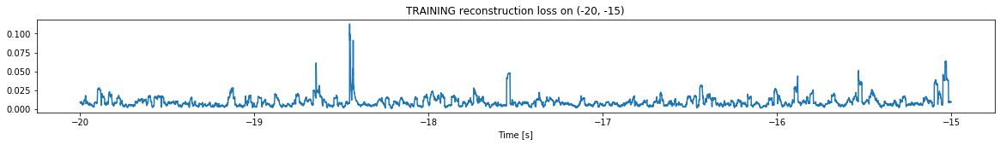

Finished training, median of the log(loss) is:  -2.1183588949737766
Triggering for section:  (-15, -10)
Using this median for triggering: -2.145918483256203


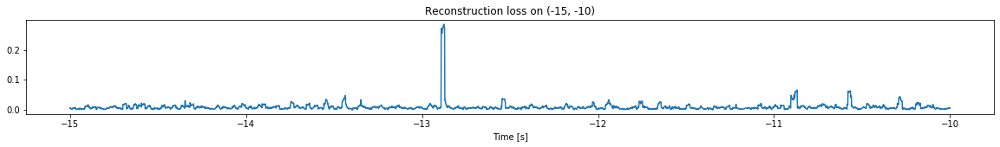

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


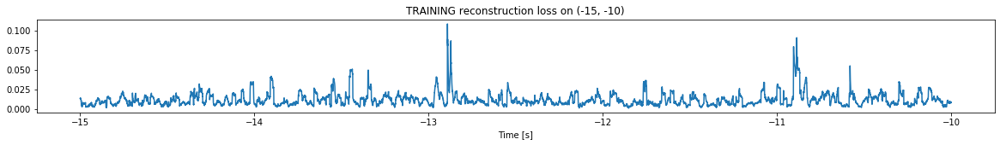

Finished training, median of the log(loss) is:  -2.002151592143437
Triggering for section:  (-10, -5)
Using this median for triggering: -2.1183588949737766


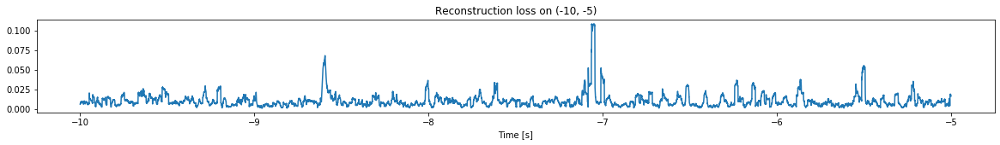

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


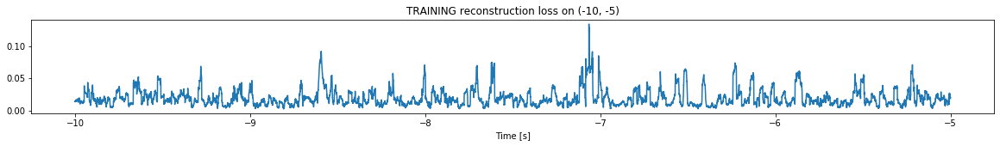

Finished training, median of the log(loss) is:  -1.788259090865011
Triggering for section:  (-5, 0)
Using this median for triggering: -2.002151592143437


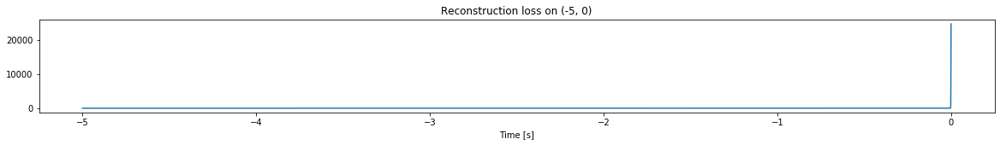

Other trigger time:  []
Their log loss values are:  []


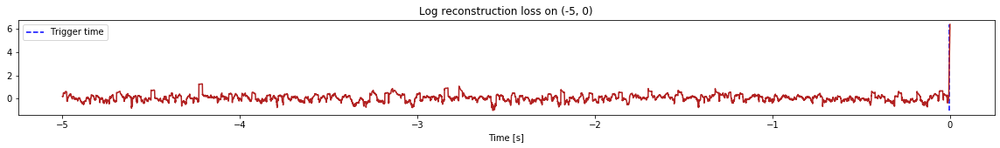

Triggered at:  []
<--------
Finished simulation, all the triggered times are:  [[-21.7405], [-18.4396], []]


In [18]:
simulation("./data/Ramp27/", 5, (-70,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (597500, 12)
Flushing input history
Number of sections: 12
Entering sections:  (-60, -55)
-------->
Entering sections:  (-55, -50)
-------->
Training for section:  (None, -55)


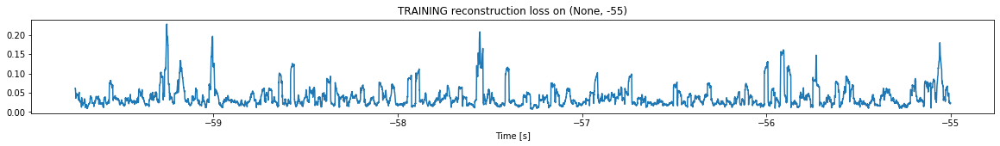

Finished training, median of the log(loss) is:  -1.508984413828565
<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


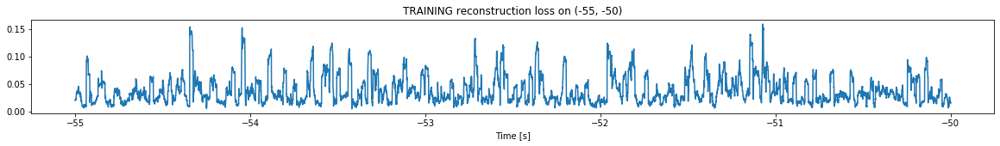

Finished training, median of the log(loss) is:  -1.5023200301331432
Triggering for section:  (-50, -45)
Using this median for triggering: -1.508984413828565


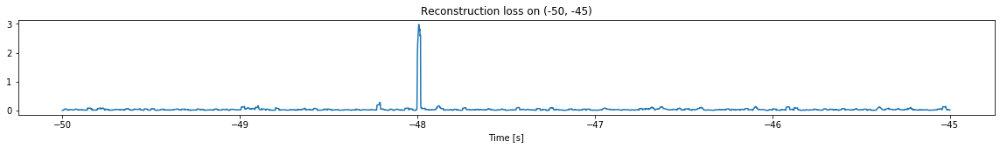

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


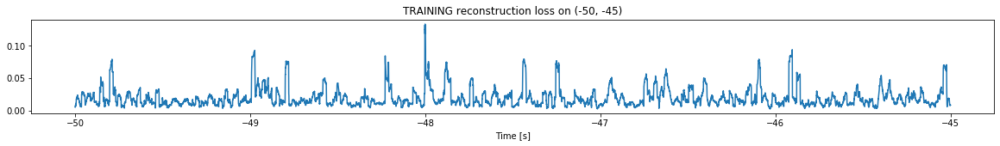

Finished training, median of the log(loss) is:  -1.8093024748168745
Triggering for section:  (-45, -40)
Using this median for triggering: -1.5023200301331432


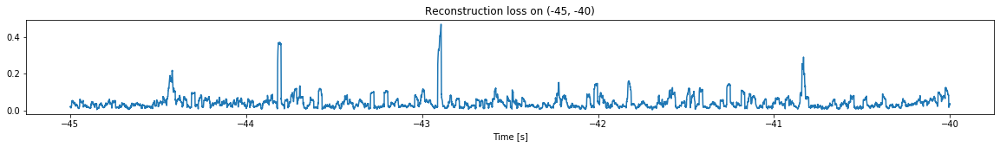

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


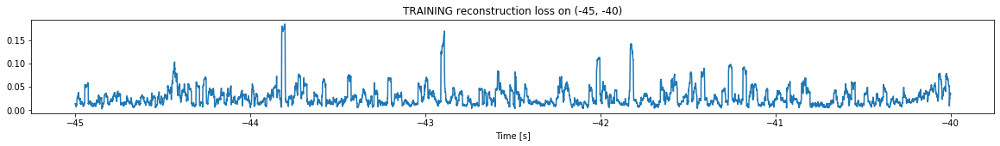

Finished training, median of the log(loss) is:  -1.639973513654378
Triggering for section:  (-40, -35)
Using this median for triggering: -1.8093024748168745


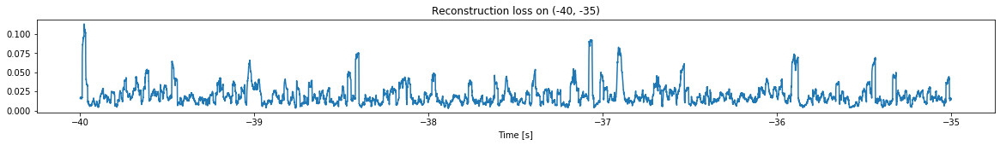

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


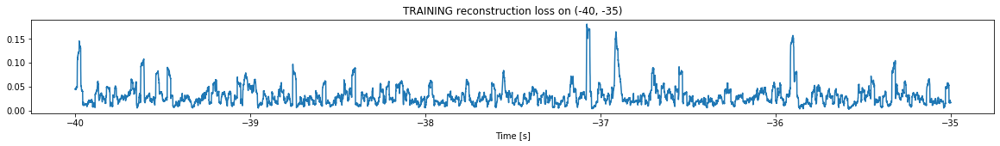

Finished training, median of the log(loss) is:  -1.5725712958281968
Triggering for section:  (-35, -30)
Using this median for triggering: -1.639973513654378


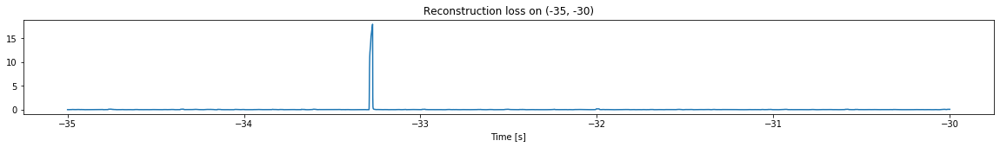

Other trigger time:  [-33.271297]
Their log loss values are:  [2.89487345]


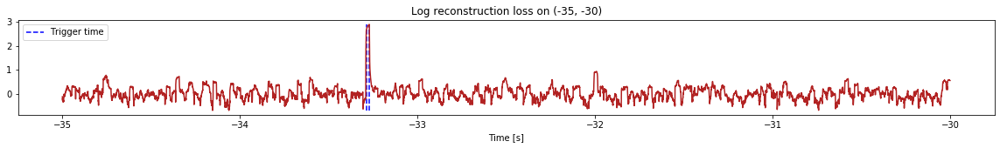

Triggered at:  [-33.271297]
<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


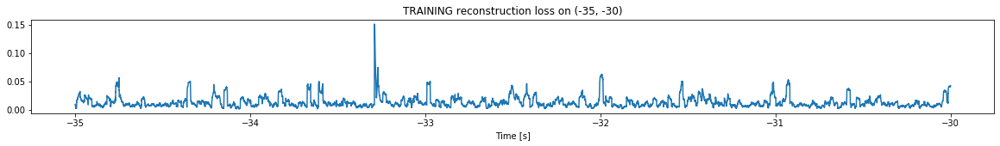

Finished training, median of the log(loss) is:  -1.957365747824789
Triggering for section:  (-30, -25)
Using this median for triggering: -1.5725712958281968


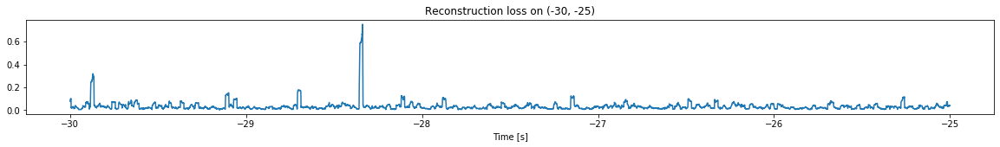

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


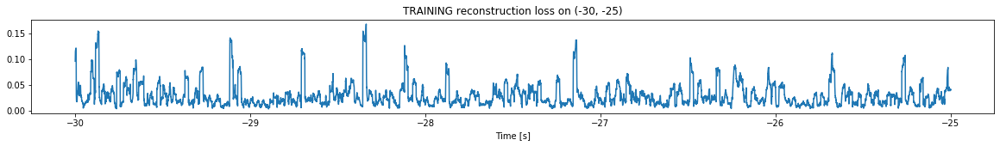

Finished training, median of the log(loss) is:  -1.6299364357596609
Triggering for section:  (-25, -20)
Using this median for triggering: -1.957365747824789


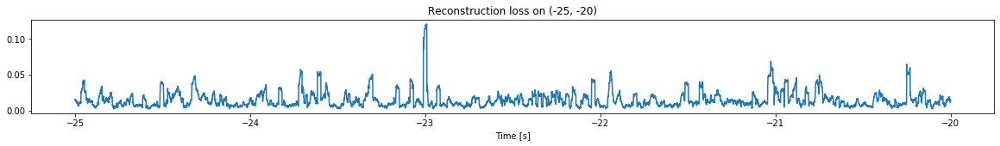

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


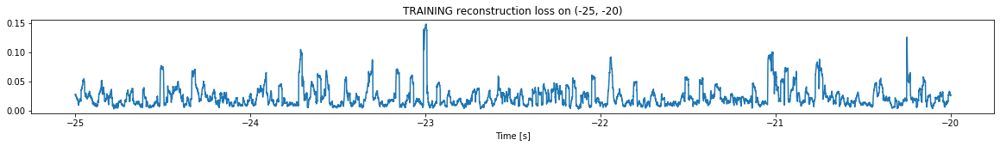

Finished training, median of the log(loss) is:  -1.7290481299311198
Triggering for section:  (-20, -15)
Using this median for triggering: -1.6299364357596609


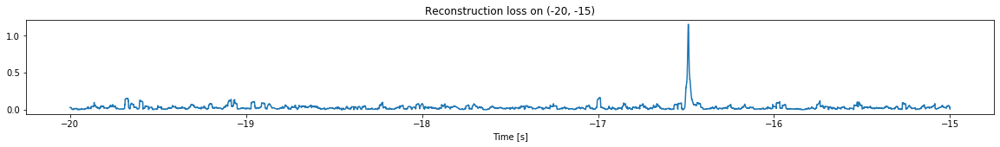

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


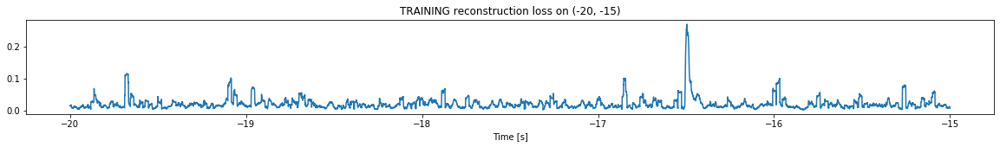

Finished training, median of the log(loss) is:  -1.7606507892084944
Triggering for section:  (-15, -10)
Using this median for triggering: -1.7290481299311198


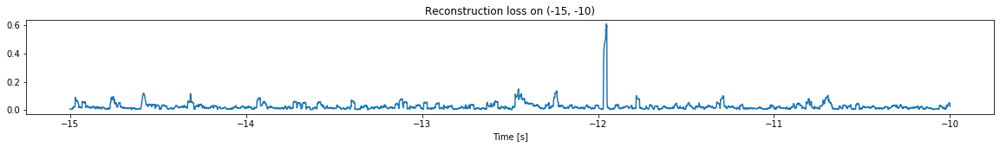

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


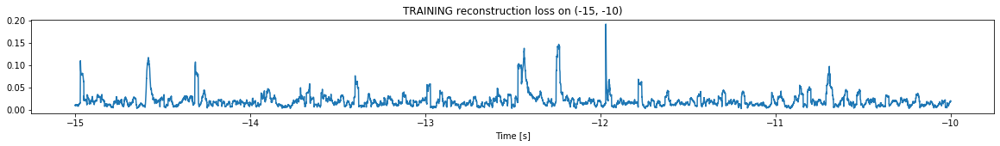

Finished training, median of the log(loss) is:  -1.7763601994523013
Triggering for section:  (-10, -5)
Using this median for triggering: -1.7606507892084944


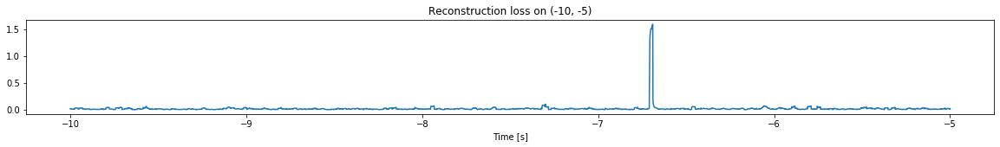

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


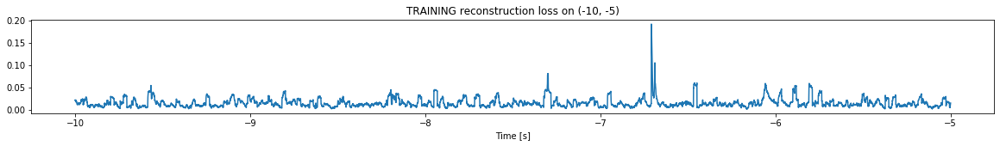

Finished training, median of the log(loss) is:  -1.8851408441104114
Triggering for section:  (-5, 0)
Using this median for triggering: -1.7763601994523013


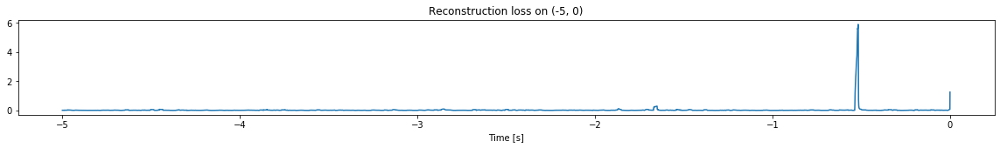

<--------
Finished simulation, all the triggered times are:  [[-33.271297]]


In [19]:
simulation("./data/Ramp28/", 5, (-60,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (997500, 12)
Flushing input history
Number of sections: 20
Entering sections:  (-100, -95)
-------->
Entering sections:  (-95, -90)
-------->
Training for section:  (None, -95)


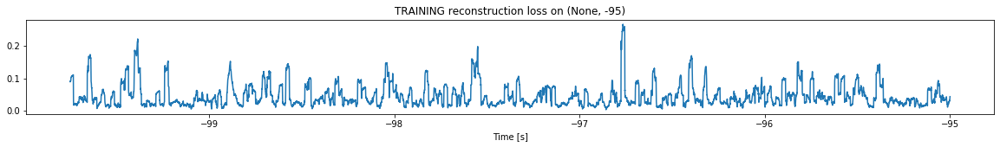

Finished training, median of the log(loss) is:  -1.4551732351226585
<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)


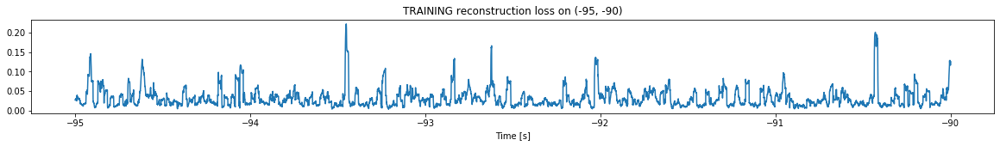

Finished training, median of the log(loss) is:  -1.5885652127104857
Triggering for section:  (-90, -85)
Using this median for triggering: -1.4551732351226585


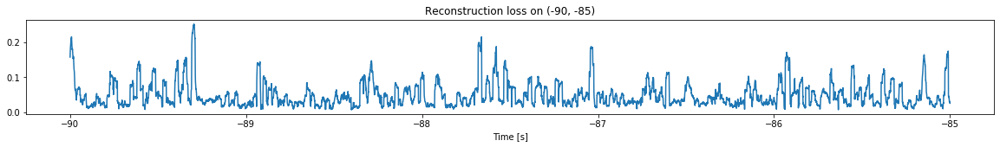

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)


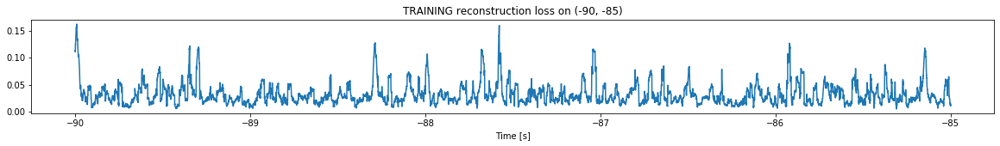

Finished training, median of the log(loss) is:  -1.5694992818658169
Triggering for section:  (-85, -80)
Using this median for triggering: -1.5885652127104857


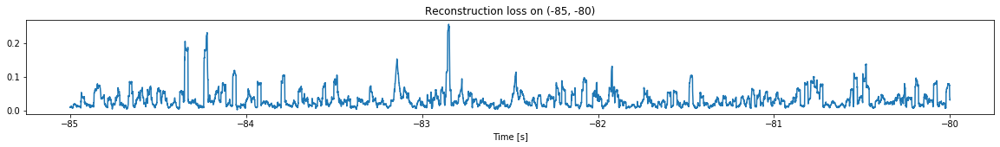

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


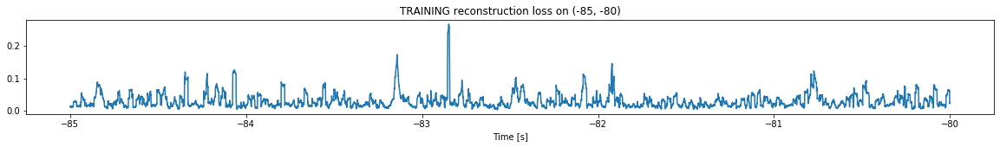

Finished training, median of the log(loss) is:  -1.6150579270283703
Triggering for section:  (-80, -75)
Using this median for triggering: -1.5694992818658169


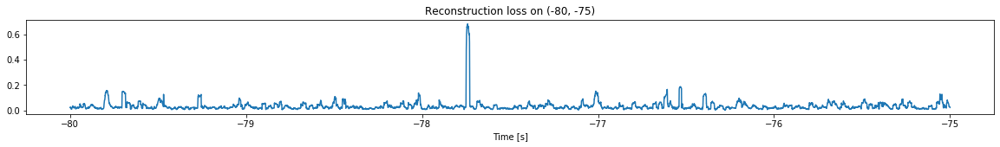

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


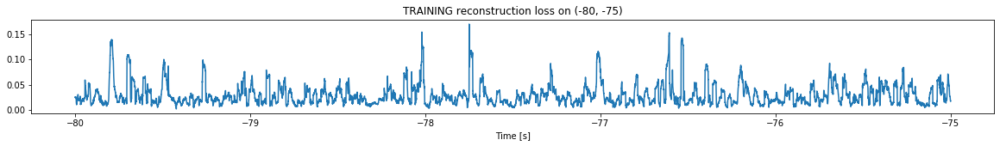

Finished training, median of the log(loss) is:  -1.6213514625355663
Triggering for section:  (-75, -70)
Using this median for triggering: -1.6150579270283703


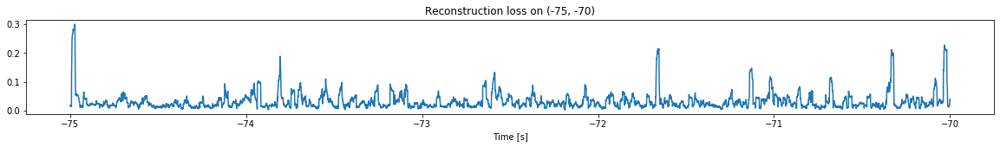

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


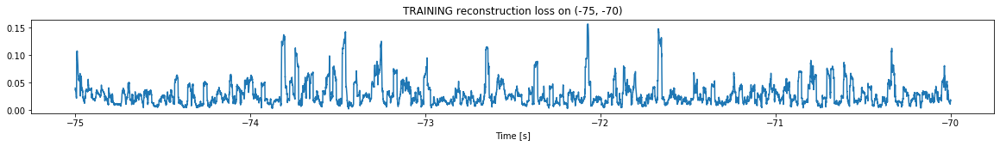

Finished training, median of the log(loss) is:  -1.6304417701057412
Triggering for section:  (-70, -65)
Using this median for triggering: -1.6213514625355663


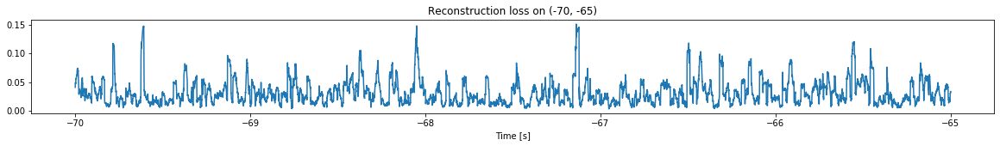

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


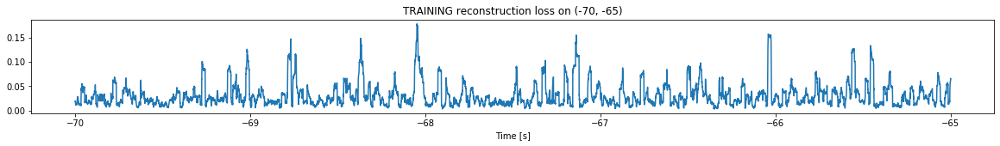

Finished training, median of the log(loss) is:  -1.6119509043063225
Triggering for section:  (-65, -60)
Using this median for triggering: -1.6304417701057412


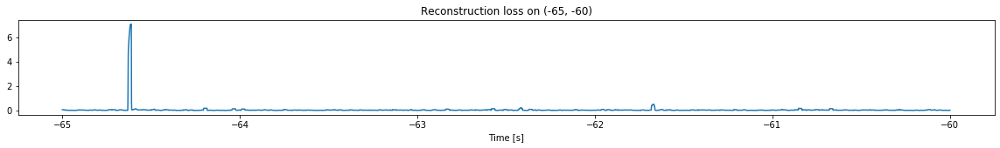

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


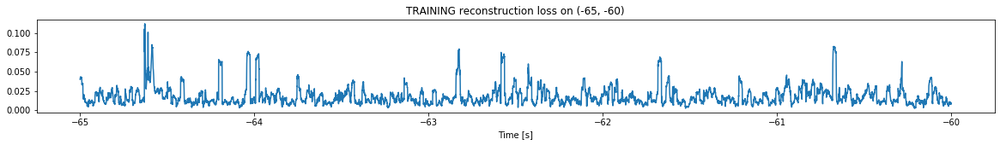

Finished training, median of the log(loss) is:  -1.835169118977094
Triggering for section:  (-60, -55)
Using this median for triggering: -1.6119509043063225


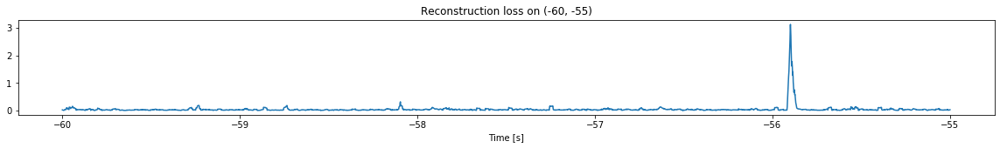

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


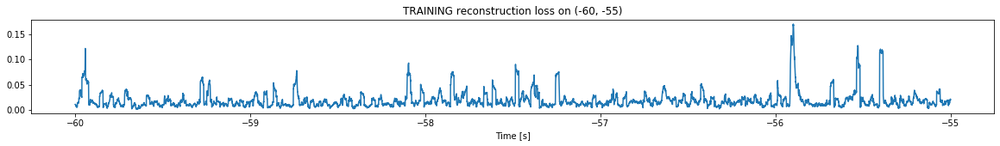

Finished training, median of the log(loss) is:  -1.8294681045550805
Triggering for section:  (-55, -50)
Using this median for triggering: -1.835169118977094


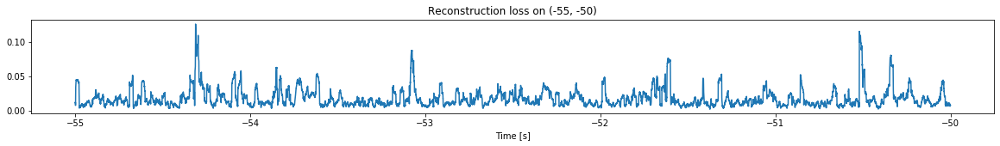

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


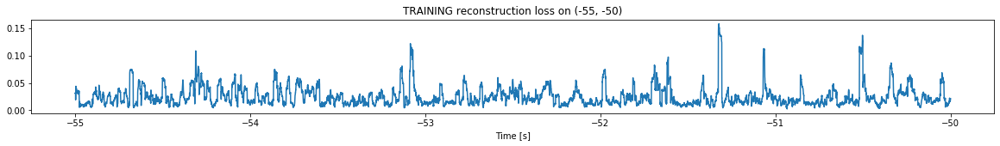

Finished training, median of the log(loss) is:  -1.6955840324456952
Triggering for section:  (-50, -45)
Using this median for triggering: -1.8294681045550805


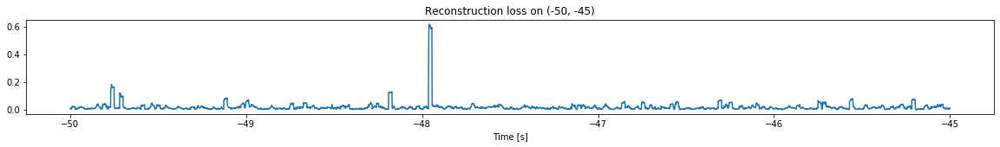

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


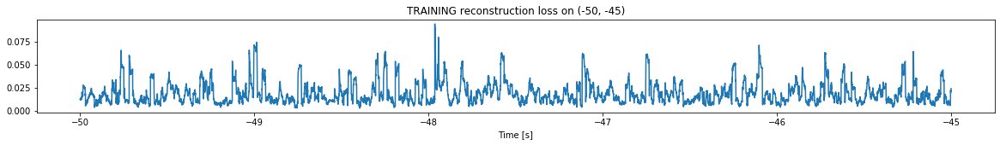

Finished training, median of the log(loss) is:  -1.8087577368205943
Triggering for section:  (-45, -40)
Using this median for triggering: -1.6955840324456952


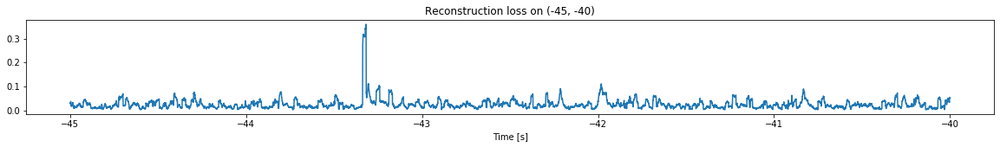

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


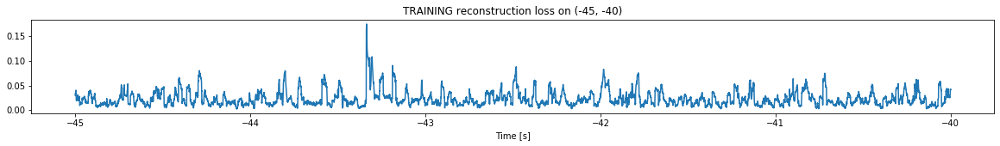

Finished training, median of the log(loss) is:  -1.7138865695927428
Triggering for section:  (-40, -35)
Using this median for triggering: -1.8087577368205943


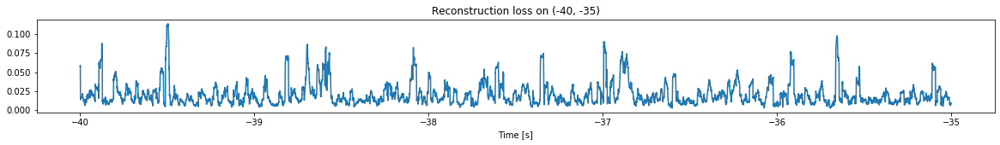

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


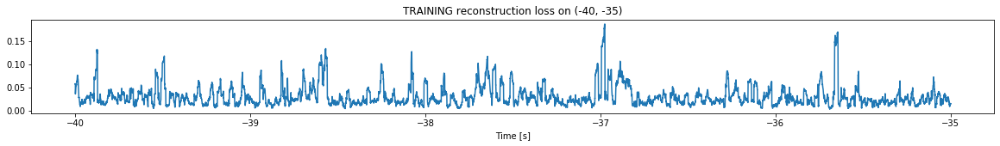

Finished training, median of the log(loss) is:  -1.6027389046487555
Triggering for section:  (-35, -30)
Using this median for triggering: -1.7138865695927428


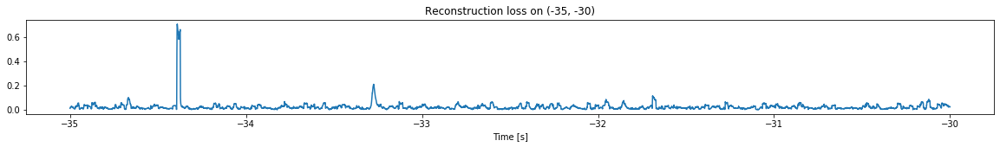

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


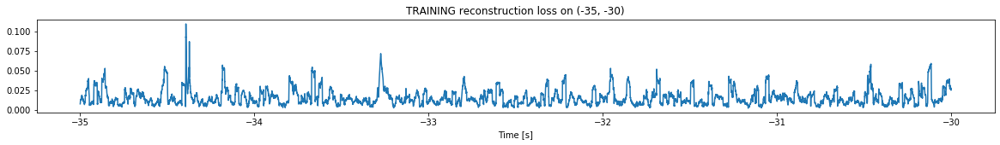

Finished training, median of the log(loss) is:  -1.879140352632327
Triggering for section:  (-30, -25)
Using this median for triggering: -1.6027389046487555


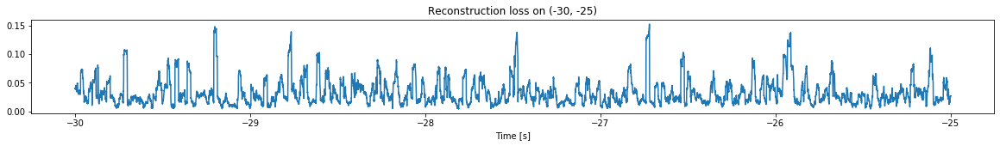

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


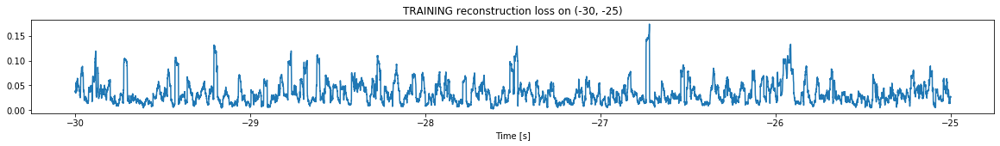

Finished training, median of the log(loss) is:  -1.533012357766213
Triggering for section:  (-25, -20)
Using this median for triggering: -1.879140352632327


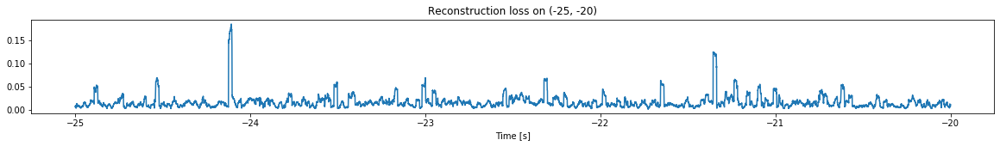

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


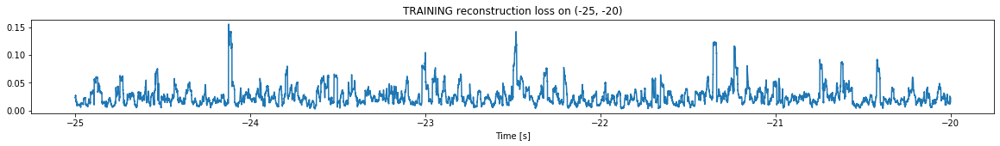

Finished training, median of the log(loss) is:  -1.6592400848275033
Triggering for section:  (-20, -15)
Using this median for triggering: -1.533012357766213


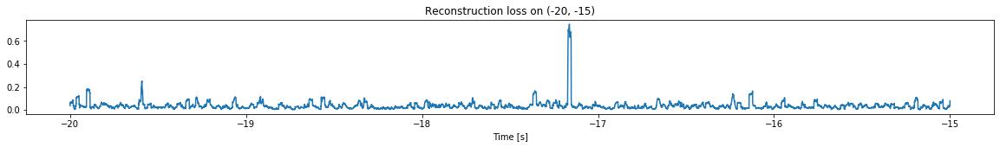

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


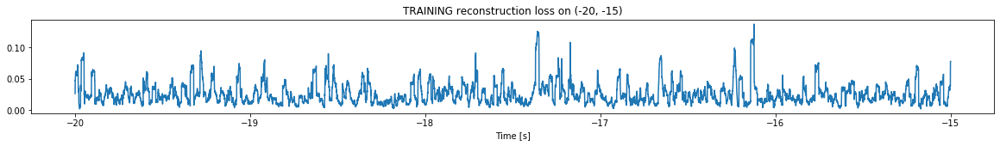

Finished training, median of the log(loss) is:  -1.6581021142577903
Triggering for section:  (-15, -10)
Using this median for triggering: -1.6592400848275033


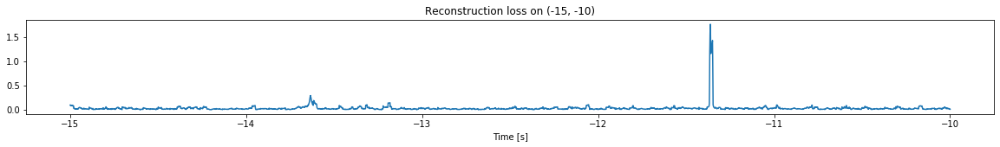

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


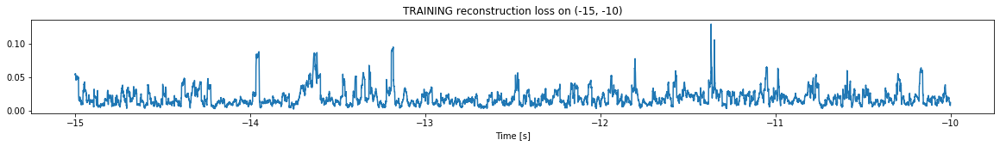

Finished training, median of the log(loss) is:  -1.7990080968828281
Triggering for section:  (-10, -5)
Using this median for triggering: -1.6581021142577903


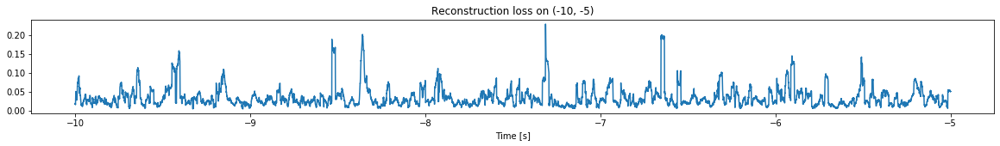

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


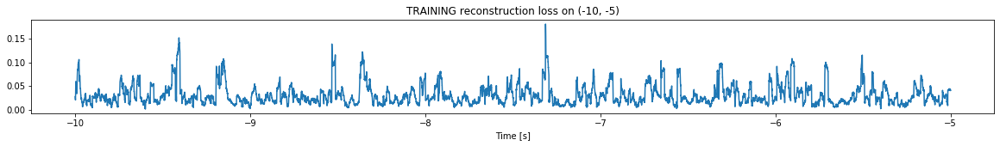

Finished training, median of the log(loss) is:  -1.589538377656039
Triggering for section:  (-5, 0)
Using this median for triggering: -1.7990080968828281


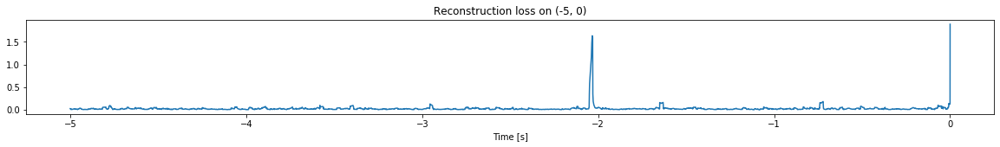

<--------
Finished simulation, all the triggered times are:  []


In [20]:
simulation("./data/Ramp29/", 5, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1197500, 12)
Flushing input history
Number of sections: 24
Entering sections:  (-120, -115)
-------->
Entering sections:  (-115, -110)
-------->
Training for section:  (None, -115)


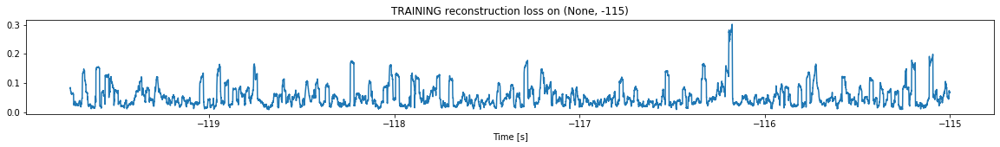

Finished training, median of the log(loss) is:  -1.3610525870492354
<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)


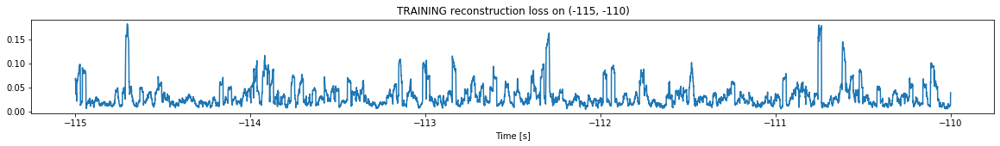

Finished training, median of the log(loss) is:  -1.593560882470723
Triggering for section:  (-110, -105)
Using this median for triggering: -1.3610525870492354


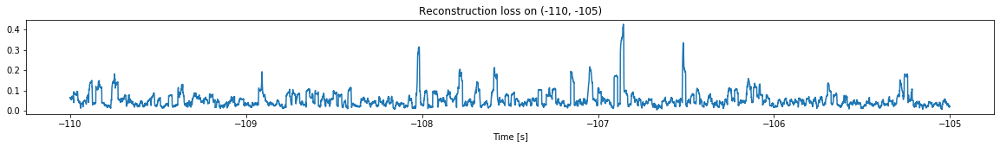

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)


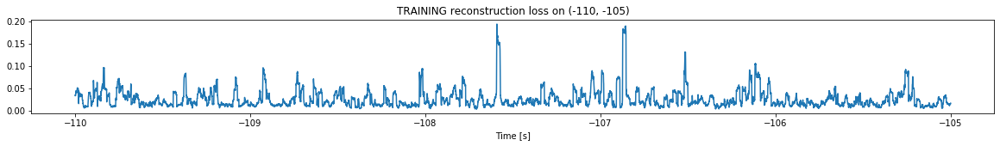

Finished training, median of the log(loss) is:  -1.7124935842207964
Triggering for section:  (-105, -100)
Using this median for triggering: -1.593560882470723


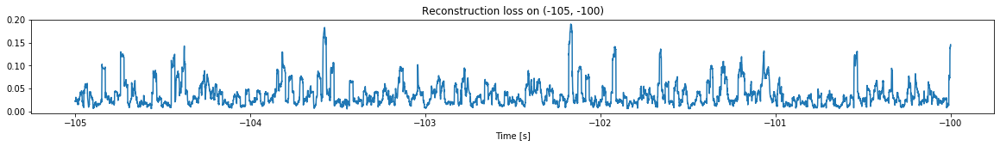

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)


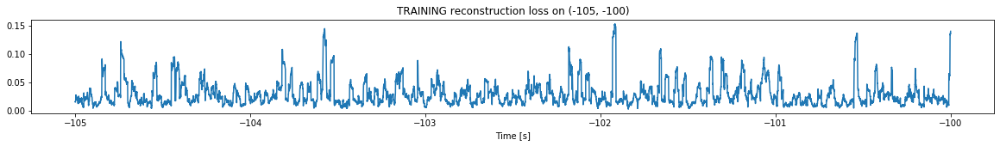

Finished training, median of the log(loss) is:  -1.6283367129406336
Triggering for section:  (-100, -95)
Using this median for triggering: -1.7124935842207964


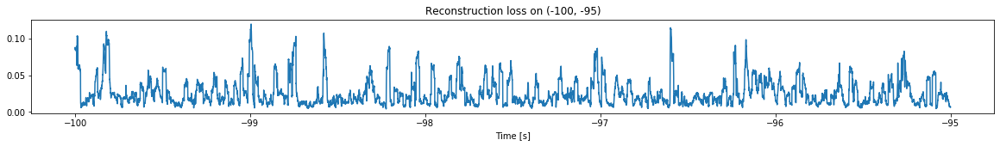

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)


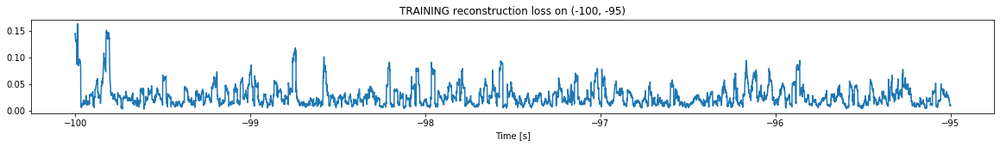

Finished training, median of the log(loss) is:  -1.6375370054426506
Triggering for section:  (-95, -90)
Using this median for triggering: -1.6283367129406336


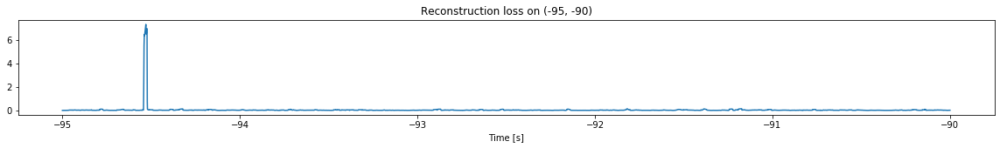

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)


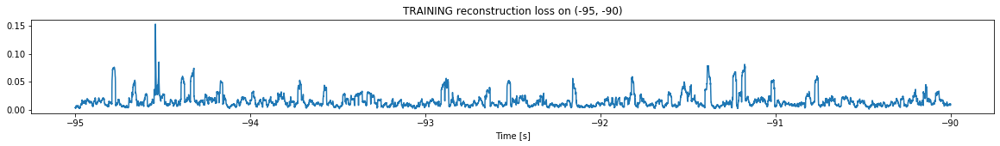

Finished training, median of the log(loss) is:  -1.910179996059977
Triggering for section:  (-90, -85)
Using this median for triggering: -1.6375370054426506


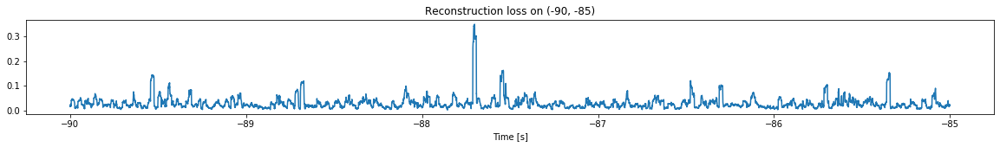

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)


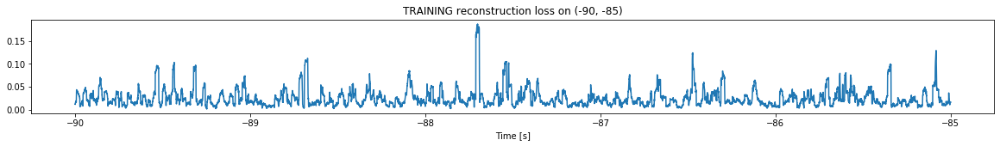

Finished training, median of the log(loss) is:  -1.6847457145104778
Triggering for section:  (-85, -80)
Using this median for triggering: -1.910179996059977


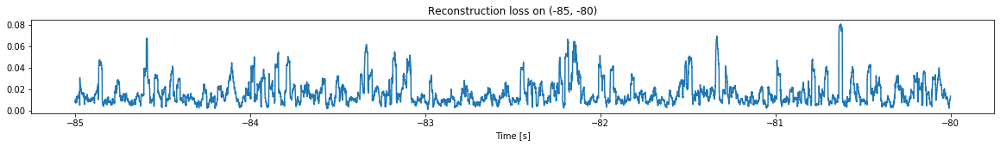

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


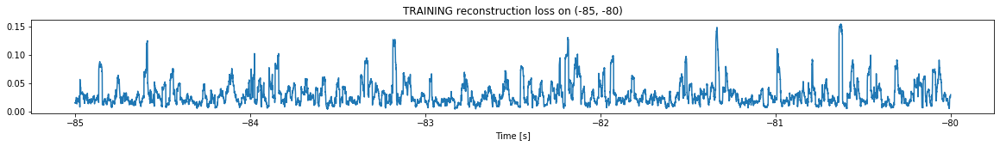

Finished training, median of the log(loss) is:  -1.6158042511230897
Triggering for section:  (-80, -75)
Using this median for triggering: -1.6847457145104778


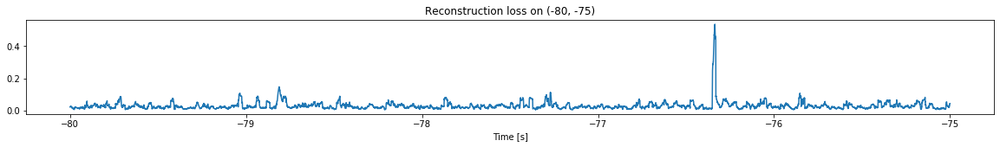

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


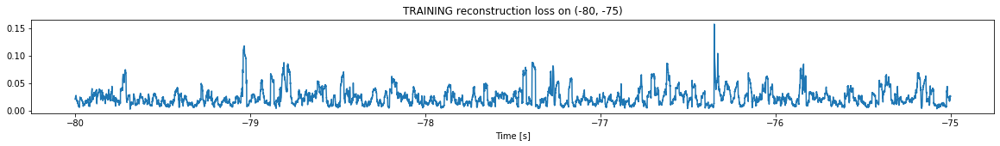

Finished training, median of the log(loss) is:  -1.6884758921383605
Triggering for section:  (-75, -70)
Using this median for triggering: -1.6158042511230897


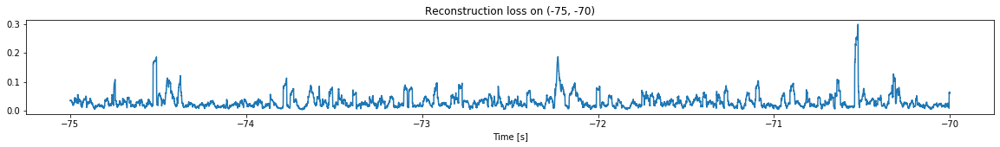

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


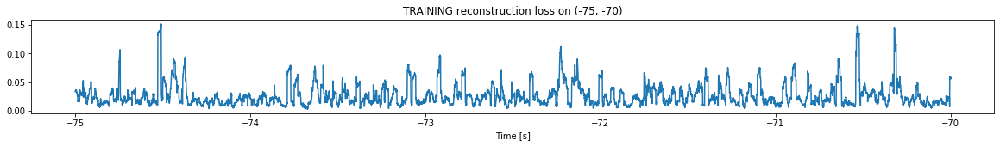

Finished training, median of the log(loss) is:  -1.6734470312894658
Triggering for section:  (-70, -65)
Using this median for triggering: -1.6884758921383605


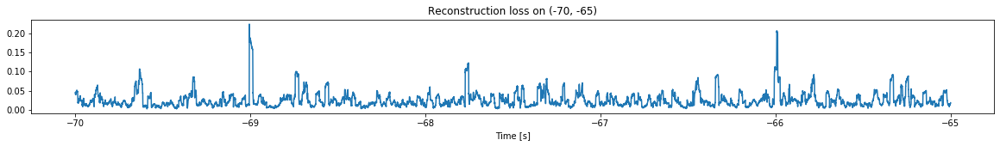

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


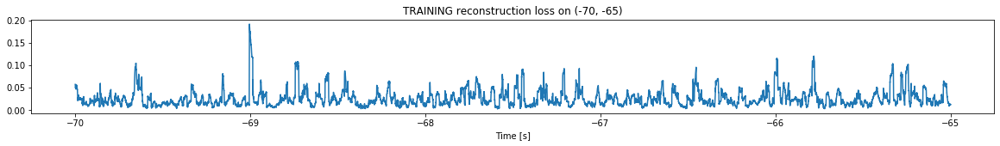

Finished training, median of the log(loss) is:  -1.6706328220959086
Triggering for section:  (-65, -60)
Using this median for triggering: -1.6734470312894658


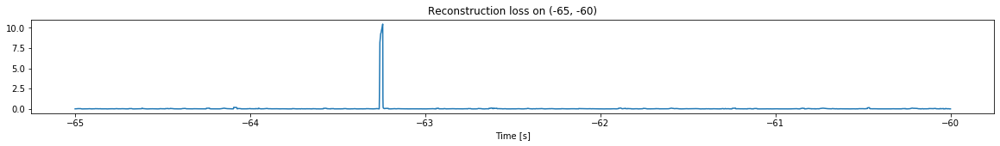

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


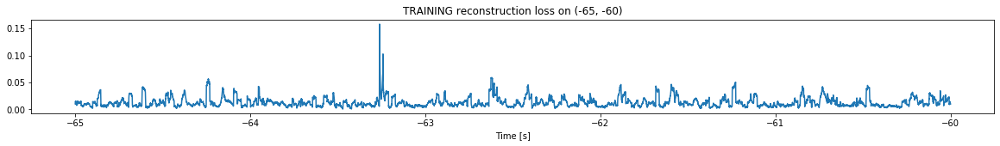

Finished training, median of the log(loss) is:  -1.971245471850045
Triggering for section:  (-60, -55)
Using this median for triggering: -1.6706328220959086


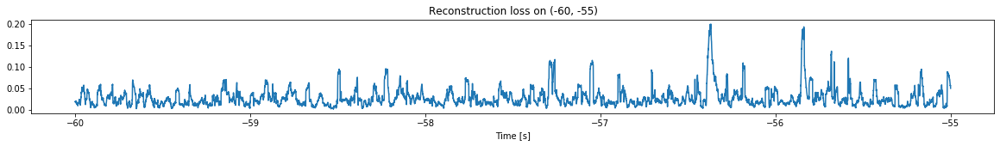

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


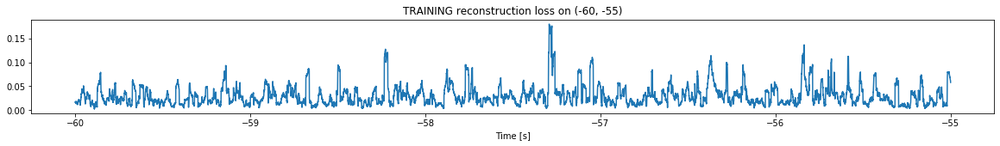

Finished training, median of the log(loss) is:  -1.5969719779472946
Triggering for section:  (-55, -50)
Using this median for triggering: -1.971245471850045


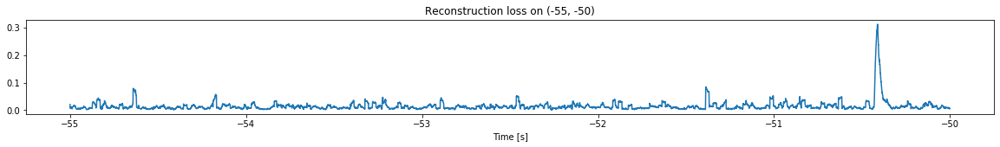

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


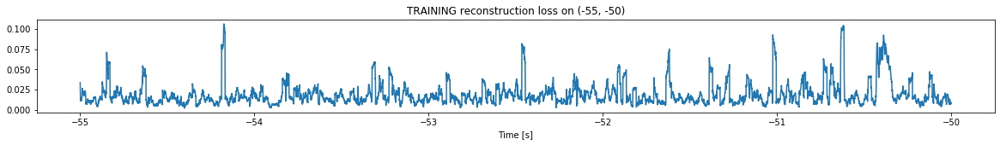

Finished training, median of the log(loss) is:  -1.8105354379821916
Triggering for section:  (-50, -45)
Using this median for triggering: -1.5969719779472946


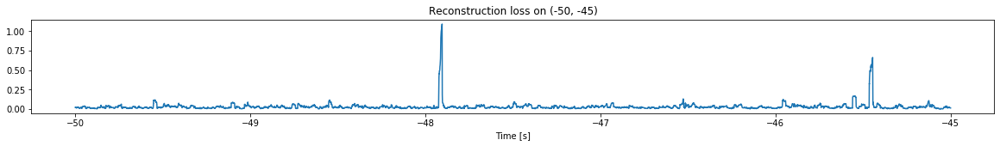

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


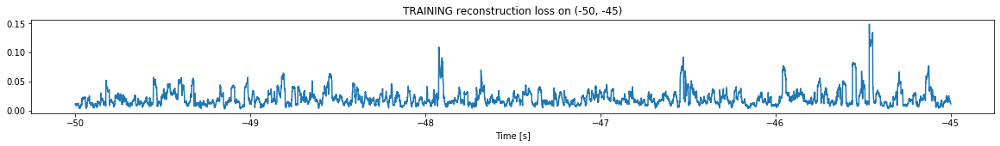

Finished training, median of the log(loss) is:  -1.7565654186167292
Triggering for section:  (-45, -40)
Using this median for triggering: -1.8105354379821916


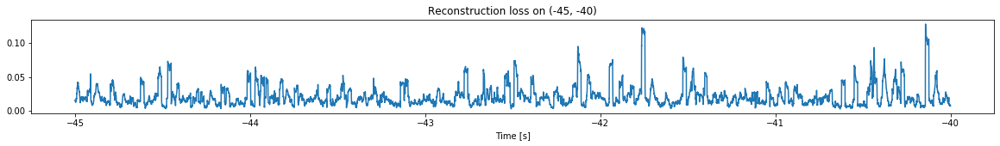

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


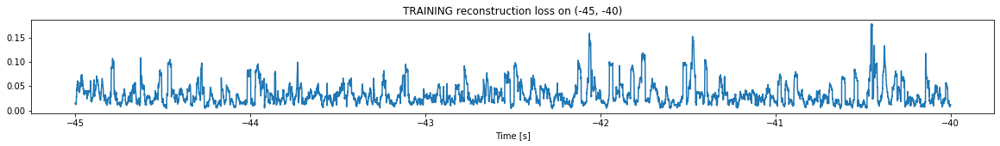

Finished training, median of the log(loss) is:  -1.5639815832366217
Triggering for section:  (-40, -35)
Using this median for triggering: -1.7565654186167292


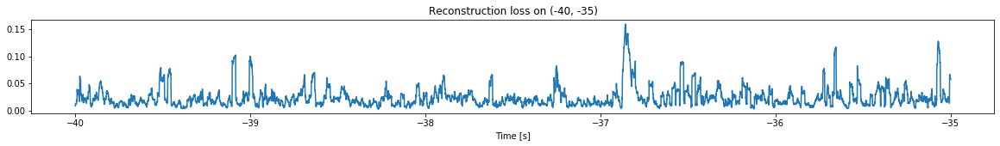

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


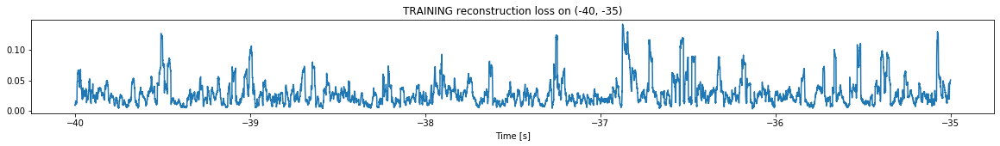

Finished training, median of the log(loss) is:  -1.6133990565639662
Triggering for section:  (-35, -30)
Using this median for triggering: -1.5639815832366217


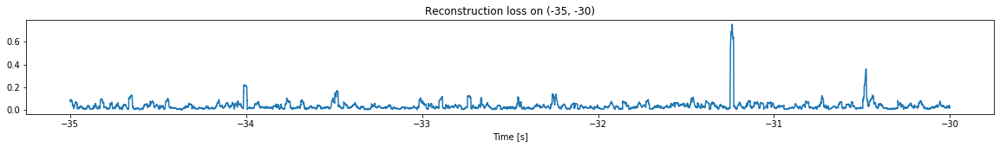

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


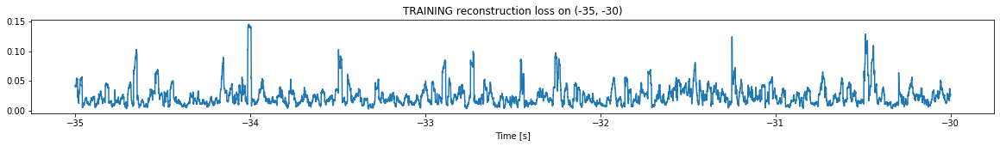

Finished training, median of the log(loss) is:  -1.7009585360046078
Triggering for section:  (-30, -25)
Using this median for triggering: -1.6133990565639662


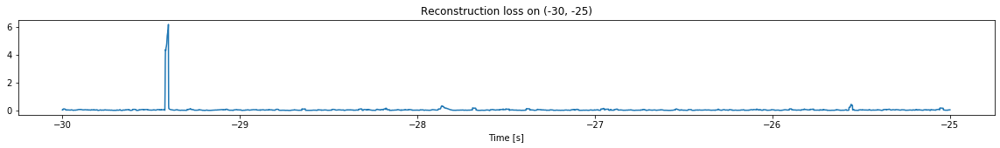

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


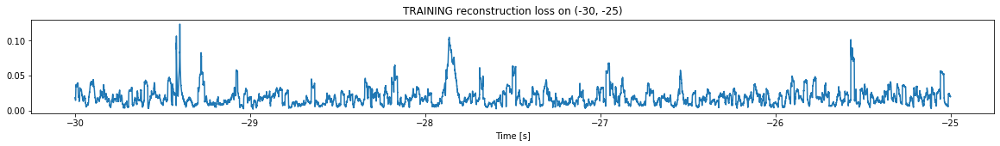

Finished training, median of the log(loss) is:  -1.7694530696914303
Triggering for section:  (-25, -20)
Using this median for triggering: -1.7009585360046078


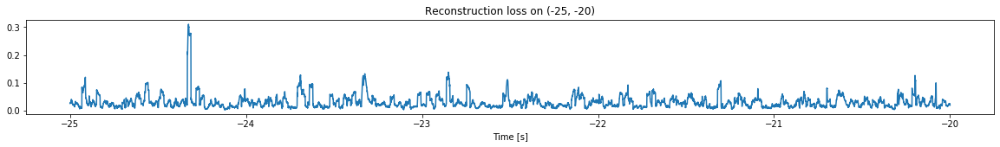

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


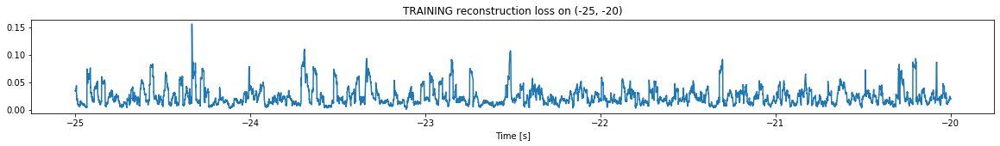

Finished training, median of the log(loss) is:  -1.694711853124974
Triggering for section:  (-20, -15)
Using this median for triggering: -1.7694530696914303


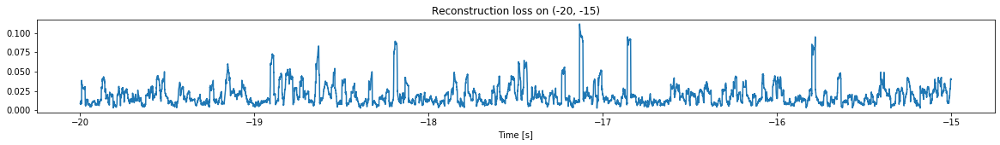

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


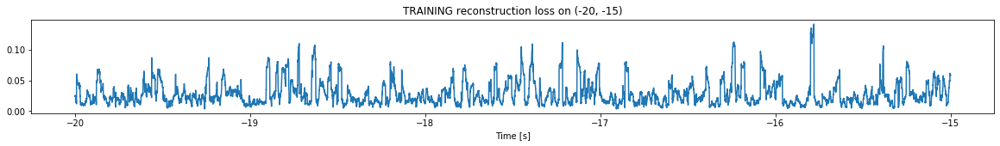

Finished training, median of the log(loss) is:  -1.6342903860220122
Triggering for section:  (-15, -10)
Using this median for triggering: -1.694711853124974


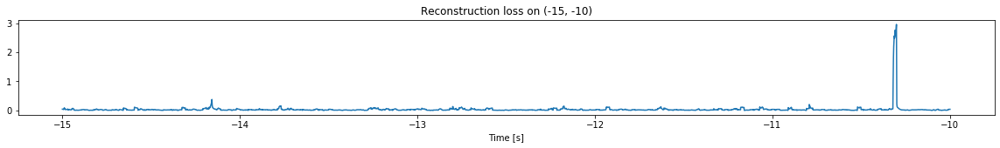

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


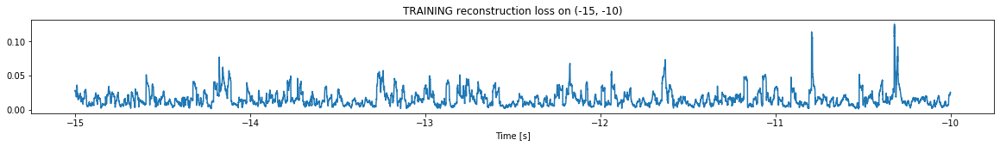

Finished training, median of the log(loss) is:  -1.8659150457873257
Triggering for section:  (-10, -5)
Using this median for triggering: -1.6342903860220122


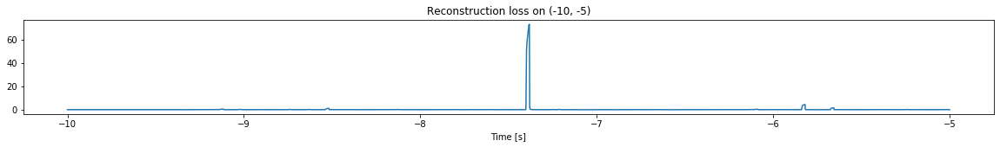

Other trigger time:  [-7.3820996]
Their log loss values are:  [3.49895825]


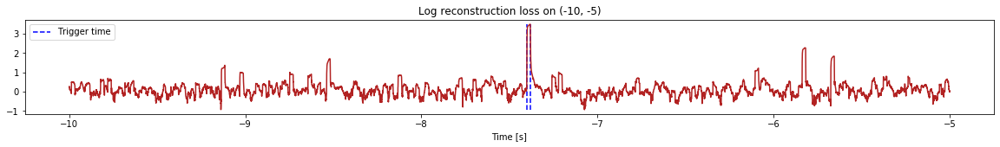

Triggered at:  [-7.3820996]
<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


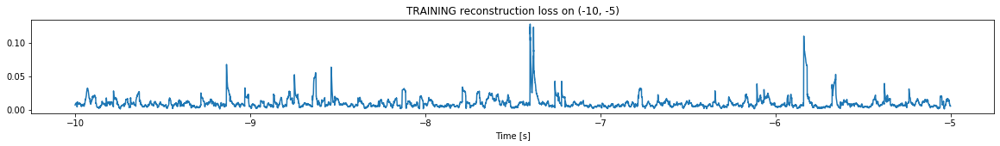

Finished training, median of the log(loss) is:  -2.0764871868942714
Triggering for section:  (-5, 0)
Using this median for triggering: -1.8659150457873257


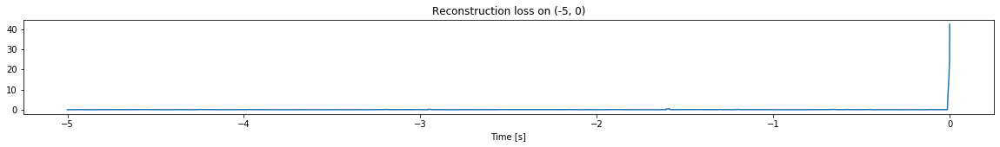

Other trigger time:  []
Their log loss values are:  []


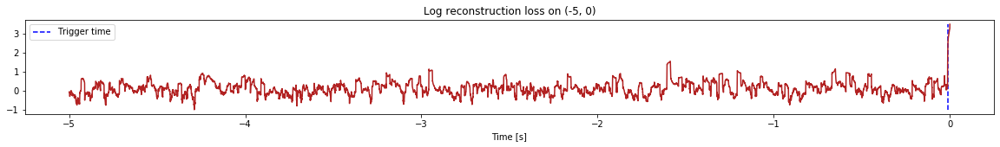

Triggered at:  []
<--------
Finished simulation, all the triggered times are:  [[-7.3820996], []]


In [21]:
simulation("./data/Ramp30/", 5, (-120,0))

## 2.7 theshold; 10 seconds sections

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (897500, 12)
Flushing input history
Number of sections: 9
Entering sections:  (-90, -80)
-------->
Entering sections:  (-80, -70)
-------->
Training for section:  (None, -80)


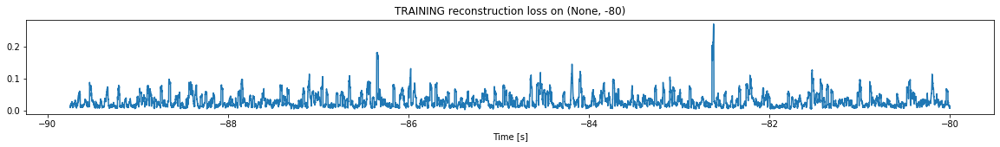

Finished training, median of the log(loss) is:  -1.6488525656058304
<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


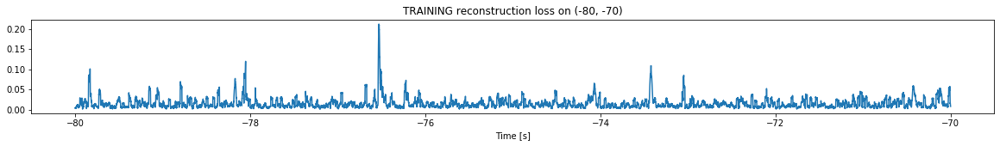

Finished training, median of the log(loss) is:  -1.9026041217976606
Triggering for section:  (-70, -60)
Using this median for triggering: -1.6488525656058304


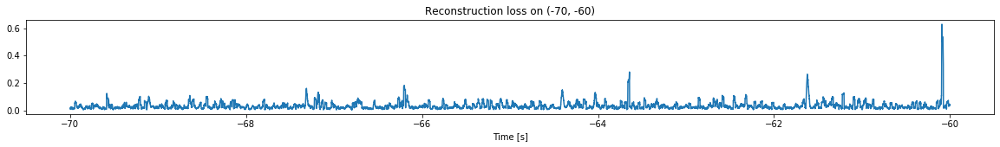

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


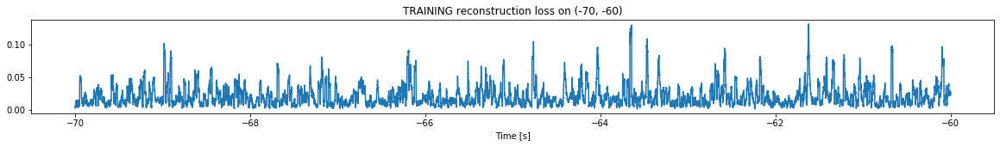

Finished training, median of the log(loss) is:  -1.7725838734530979
Triggering for section:  (-60, -50)
Using this median for triggering: -1.9026041217976606


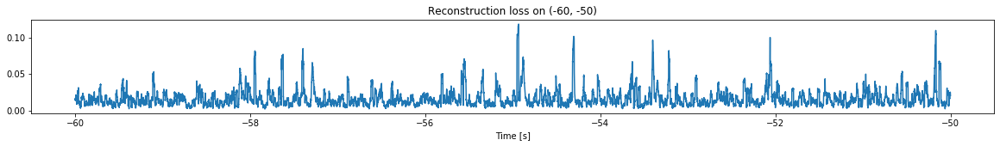

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


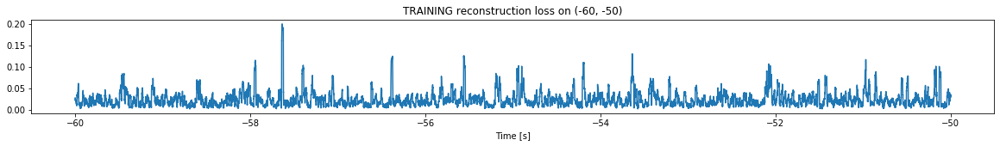

Finished training, median of the log(loss) is:  -1.713849991669429
Triggering for section:  (-50, -40)
Using this median for triggering: -1.7725838734530979


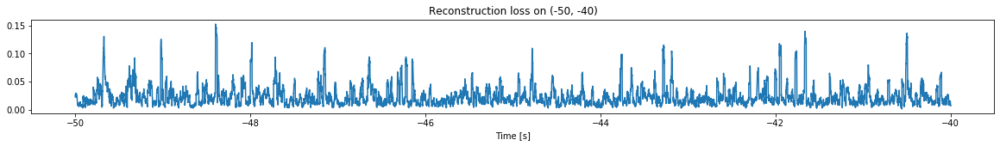

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


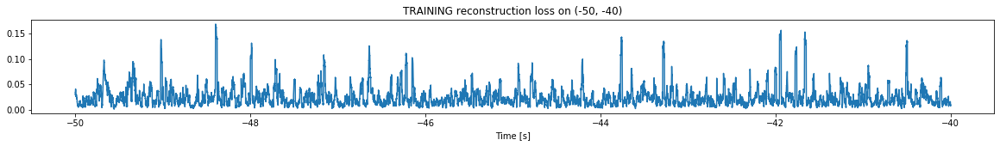

Finished training, median of the log(loss) is:  -1.699340940681045
Triggering for section:  (-40, -30)
Using this median for triggering: -1.713849991669429


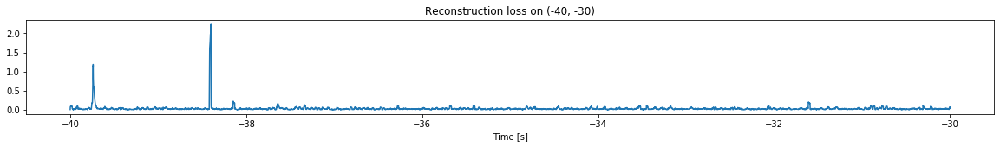

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


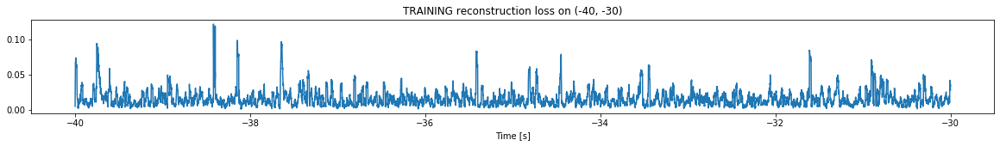

Finished training, median of the log(loss) is:  -1.8777176225464172
Triggering for section:  (-30, -20)
Using this median for triggering: -1.699340940681045


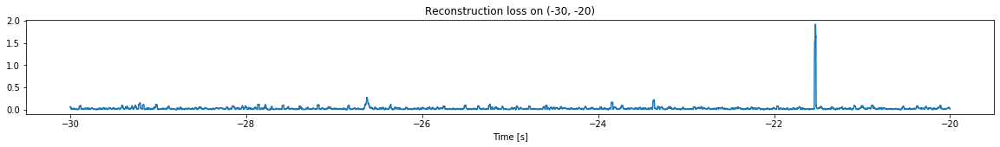

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


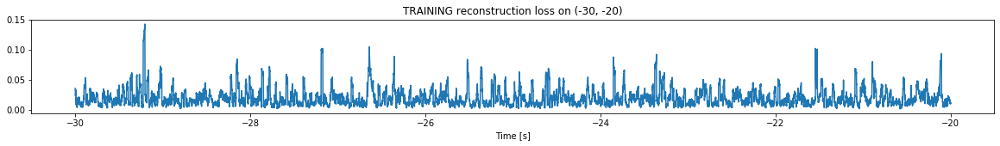

Finished training, median of the log(loss) is:  -1.7866065579550692
Triggering for section:  (-20, -10)
Using this median for triggering: -1.8777176225464172


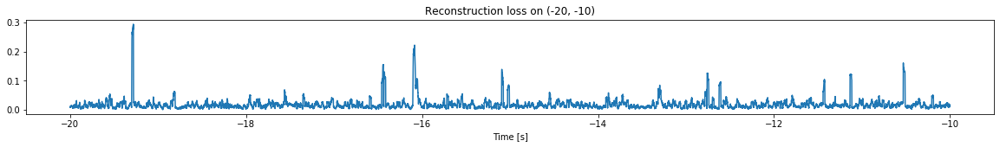

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


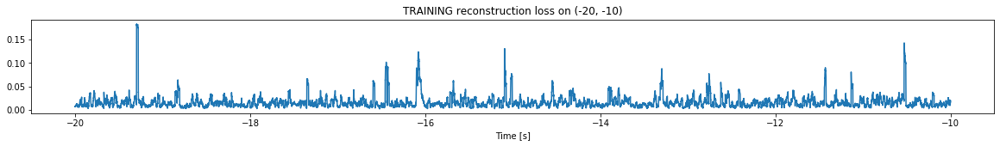

Finished training, median of the log(loss) is:  -1.8803769088848967
Triggering for section:  (-10, 0)
Using this median for triggering: -1.7866065579550692


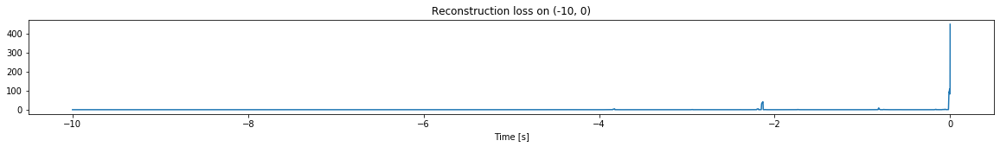

Other trigger time:  [-2.1325998 -0.8125    -0.006    ]
Their log loss values are:  [3.4072881  2.75270384 3.82378677]


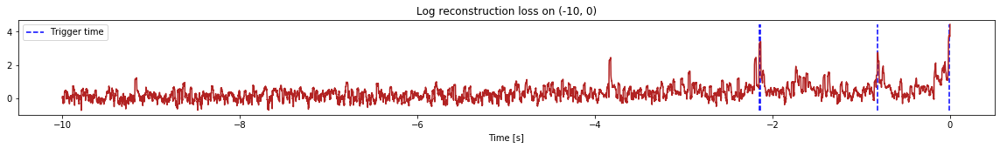

Triggered at:  [-2.1325998, -0.8125, -0.006]
<--------
Finished simulation, all the triggered times are:  [-2.1325998, -0.8125, -0.006]


In [3]:
simulation("./data/Ramp4/", 10, (-90,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (897500, 12)
Flushing input history
Number of sections: 9
Entering sections:  (-90, -80)
-------->
Entering sections:  (-80, -70)
-------->
Training for section:  (None, -80)


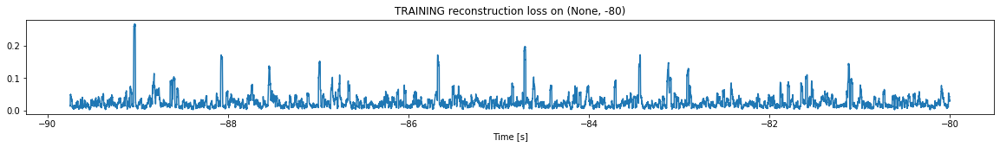

Finished training, median of the log(loss) is:  -1.6865402896725668
<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


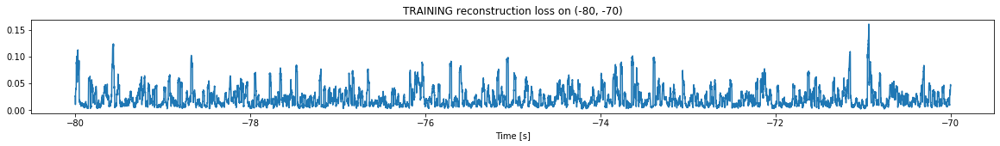

Finished training, median of the log(loss) is:  -1.74946927304028
Triggering for section:  (-70, -60)
Using this median for triggering: -1.6865402896725668


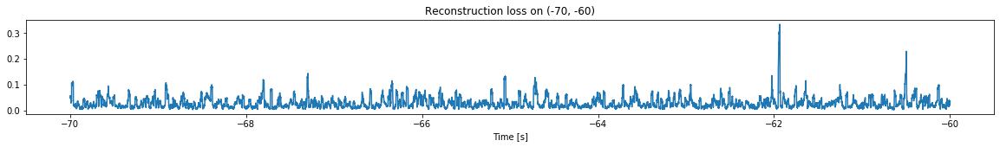

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


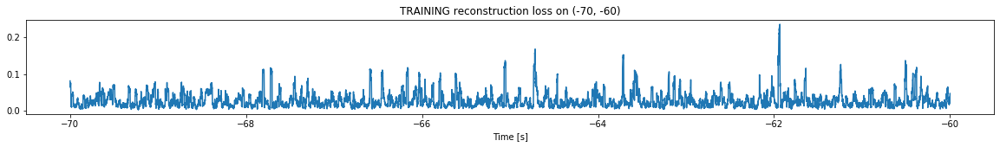

Finished training, median of the log(loss) is:  -1.6475687321826356
Triggering for section:  (-60, -50)
Using this median for triggering: -1.74946927304028


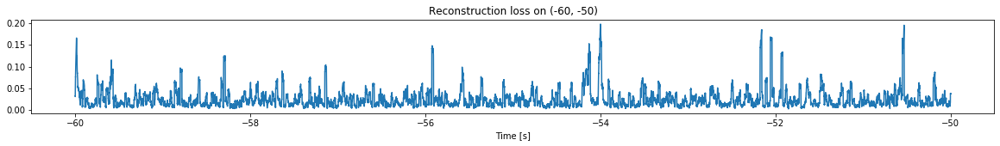

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


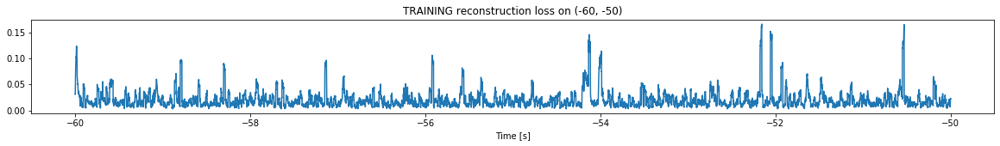

Finished training, median of the log(loss) is:  -1.795341491362666
Triggering for section:  (-50, -40)
Using this median for triggering: -1.6475687321826356


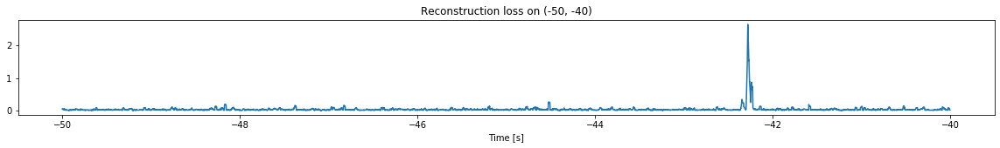

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


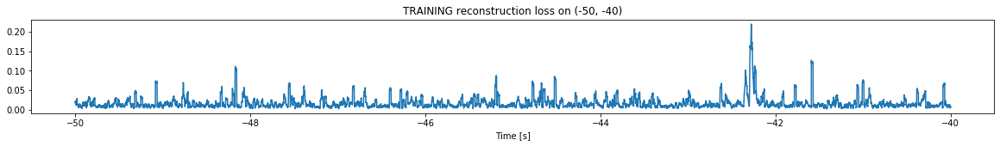

Finished training, median of the log(loss) is:  -1.897289805146698
Triggering for section:  (-40, -30)
Using this median for triggering: -1.795341491362666


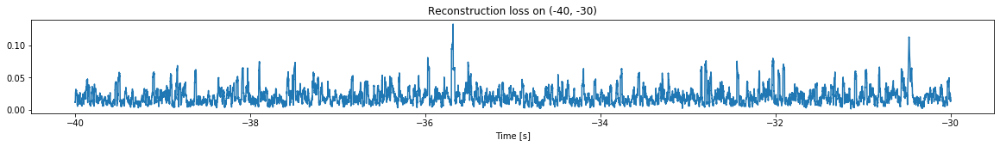

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


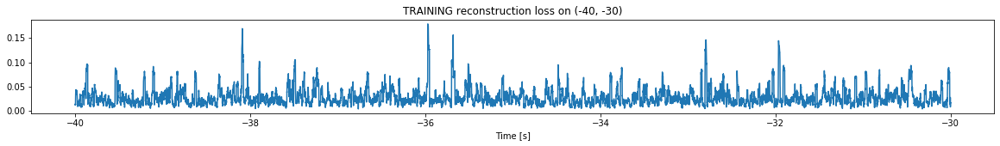

Finished training, median of the log(loss) is:  -1.6255682790438102
Triggering for section:  (-30, -20)
Using this median for triggering: -1.897289805146698


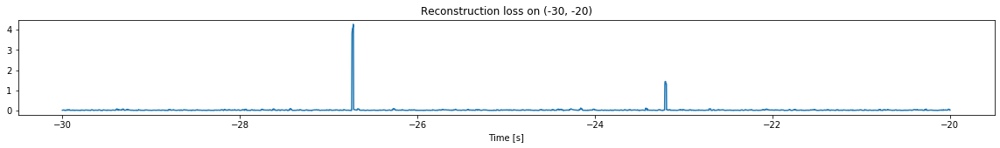

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


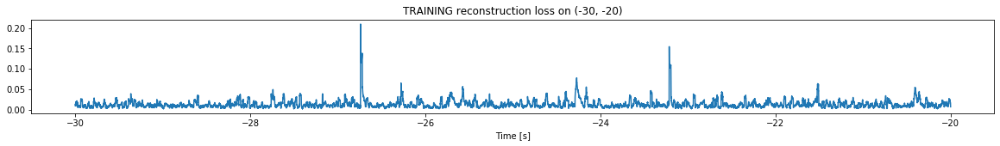

Finished training, median of the log(loss) is:  -1.9569223535502762
Triggering for section:  (-20, -10)
Using this median for triggering: -1.6255682790438102


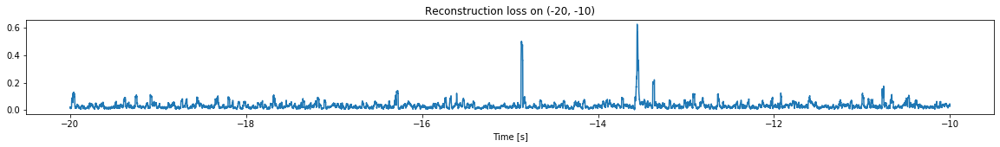

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


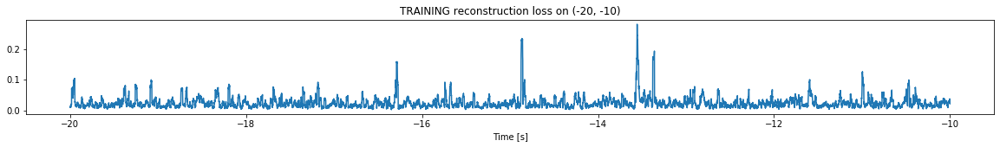

Finished training, median of the log(loss) is:  -1.6954815094434523
Triggering for section:  (-10, 0)
Using this median for triggering: -1.9569223535502762


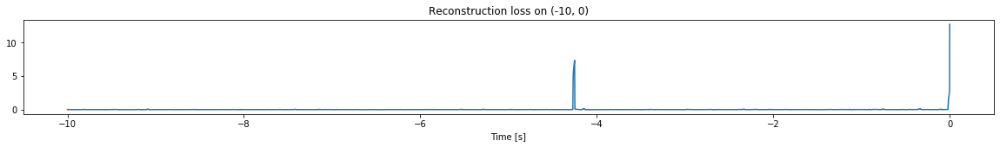

Other trigger time:  [-4.2511]
Their log loss values are:  [2.82423974]


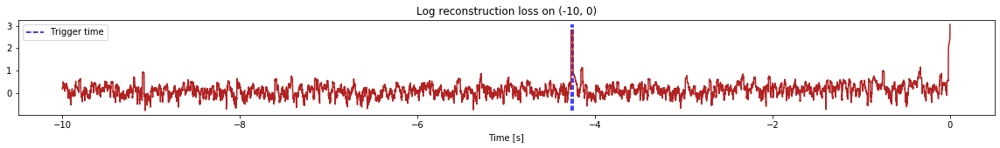

Triggered at:  [-4.2511]
<--------
Finished simulation, all the triggered times are:  [-4.2511]


In [4]:
simulation("./data/Ramp5/", 10, (-90,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (997500, 12)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


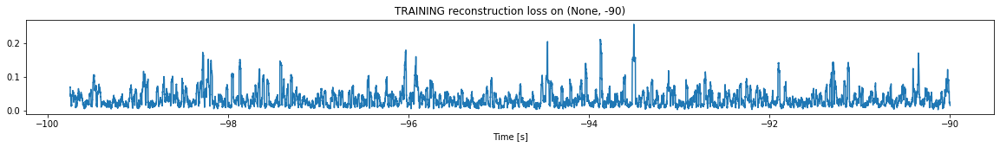

Finished training, median of the log(loss) is:  -1.5388237735277175
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


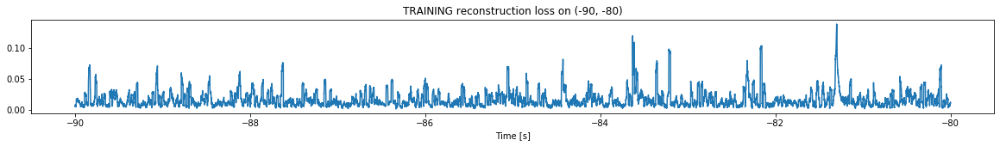

Finished training, median of the log(loss) is:  -1.8760345626540964
Triggering for section:  (-80, -70)
Using this median for triggering: -1.5388237735277175


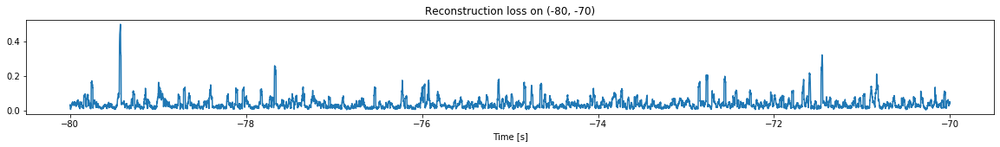

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


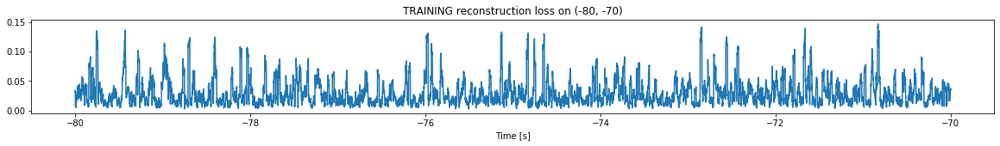

Finished training, median of the log(loss) is:  -1.6315458680135744
Triggering for section:  (-70, -60)
Using this median for triggering: -1.8760345626540964


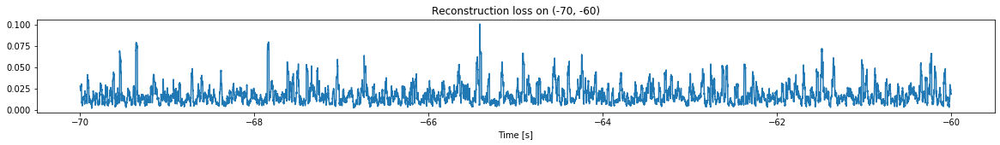

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


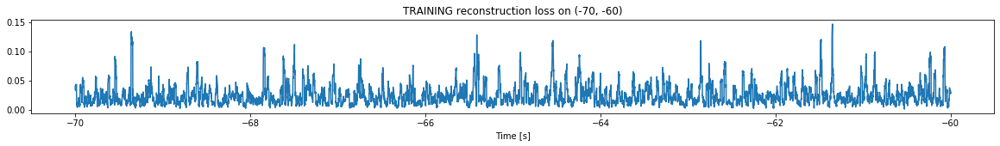

Finished training, median of the log(loss) is:  -1.6759242197730049
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6315458680135744


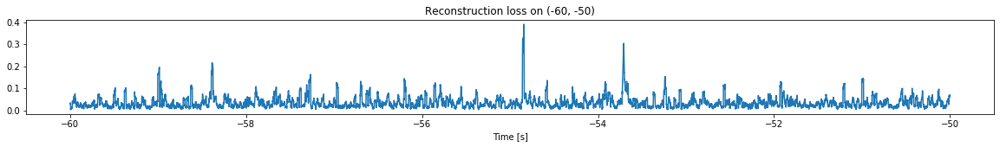

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


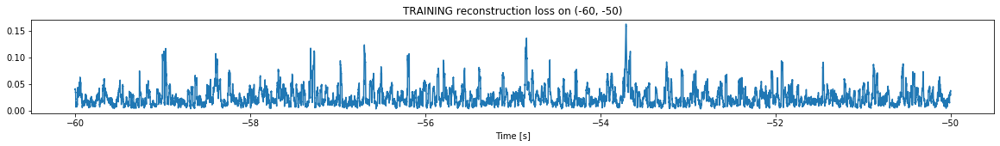

Finished training, median of the log(loss) is:  -1.6875879359779042
Triggering for section:  (-50, -40)
Using this median for triggering: -1.6759242197730049


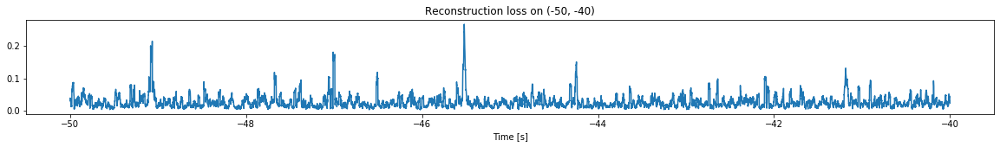

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


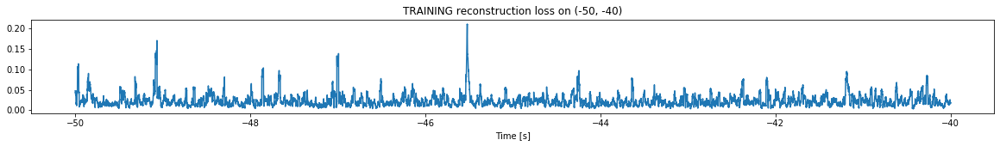

Finished training, median of the log(loss) is:  -1.7043988686944003
Triggering for section:  (-40, -30)
Using this median for triggering: -1.6875879359779042


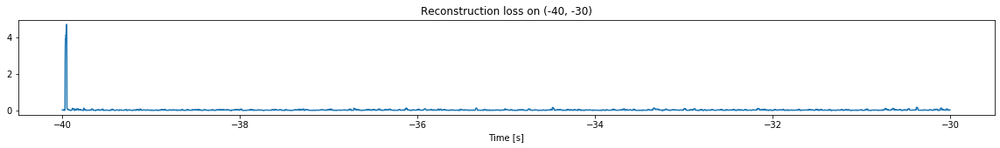

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


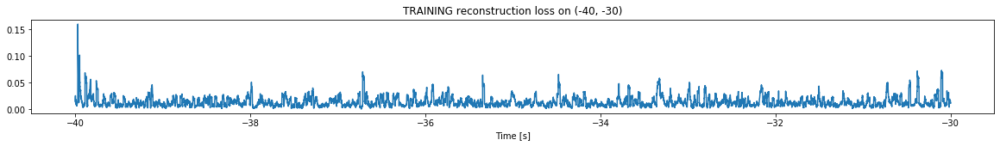

Finished training, median of the log(loss) is:  -1.936627201922318
Triggering for section:  (-30, -20)
Using this median for triggering: -1.7043988686944003


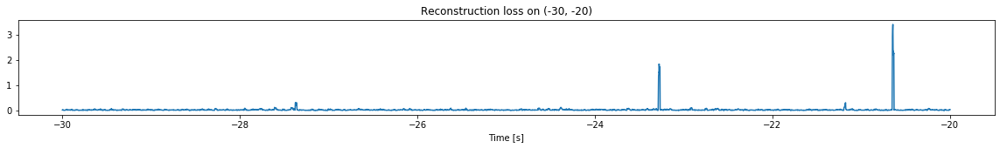

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


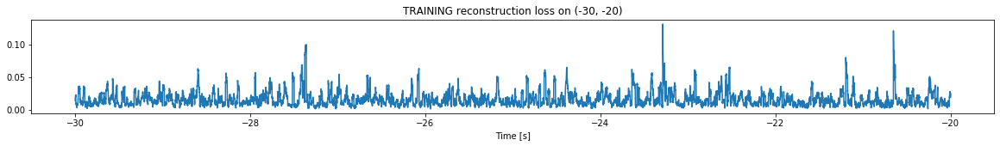

Finished training, median of the log(loss) is:  -1.8545870588069993
Triggering for section:  (-20, -10)
Using this median for triggering: -1.936627201922318


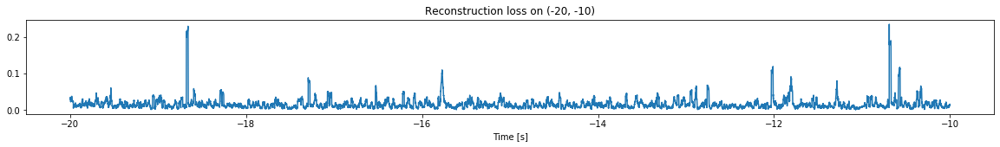

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


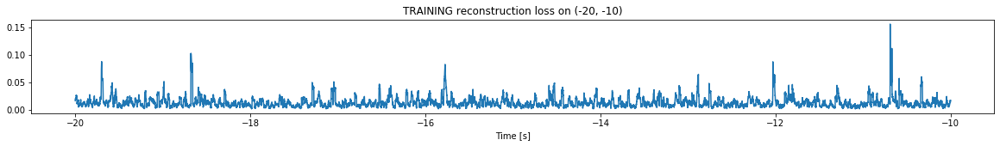

Finished training, median of the log(loss) is:  -1.956083380603935
Triggering for section:  (-10, 0)
Using this median for triggering: -1.8545870588069993


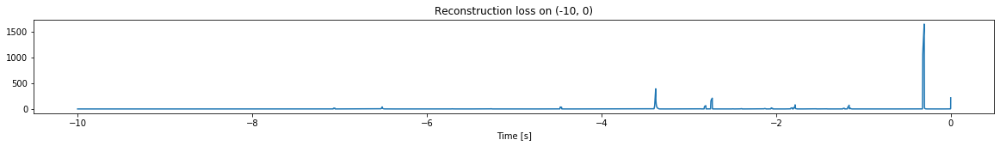

Other trigger time:  [-7.0541997 -6.5119996 -4.4707    -3.3790998 -2.731     -1.7816
 -1.1640999 -0.3037   ]
Their log loss values are:  [3.09866432 3.44632054 3.44451621 4.44872649 4.17791828 3.7648379
 3.71914969 5.07310914]


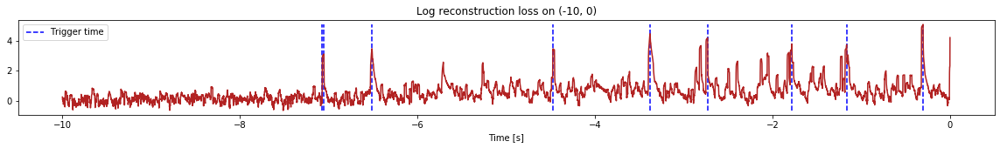

Triggered at:  [-7.0541997, -6.5119996, -4.4707, -3.3790998, -2.731, -1.7816, -1.1640999, -0.3037]
<--------
Finished simulation, all the triggered times are:  [-7.0541997, -6.5119996, -4.4707, -3.3790998, -2.731, -1.7816, -1.1640999, -0.3037]


In [5]:
simulation("./data/Ramp12d/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2117500, 12)
Flushing input history
Number of sections: 21
Entering sections:  (-210, -200)
-------->
Entering sections:  (-200, -190)
-------->
Training for section:  (None, -200)


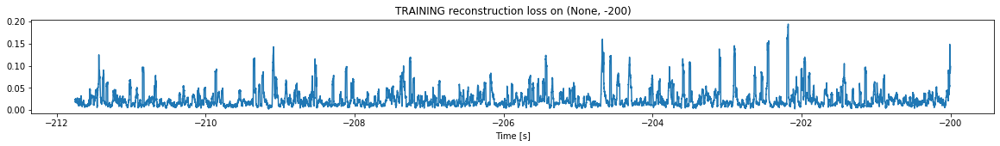

Finished training, median of the log(loss) is:  -1.7316693408450445
<--------
Entering sections:  (-190, -180)
-------->
Training for section:  (-200, -190)


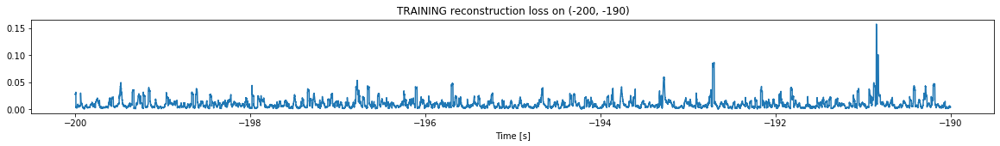

Finished training, median of the log(loss) is:  -2.1072105832624
Triggering for section:  (-190, -180)
Using this median for triggering: -1.7316693408450445


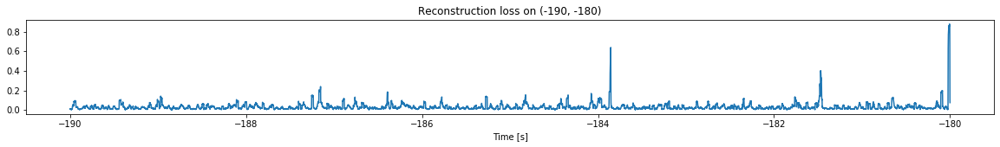

<--------
Entering sections:  (-180, -170)
-------->
Training for section:  (-190, -180)


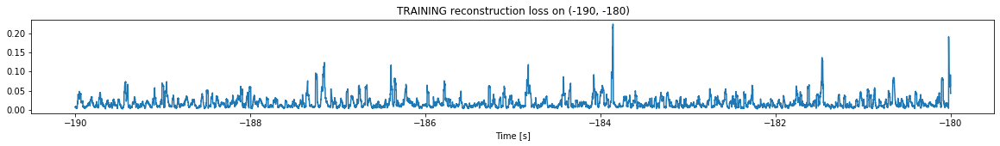

Finished training, median of the log(loss) is:  -1.8602969780609837
Triggering for section:  (-180, -170)
Using this median for triggering: -2.1072105832624


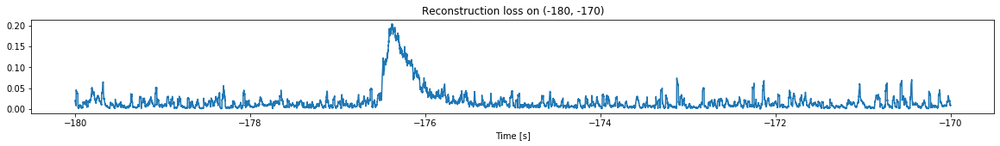

<--------
Entering sections:  (-170, -160)
-------->
Training for section:  (-180, -170)


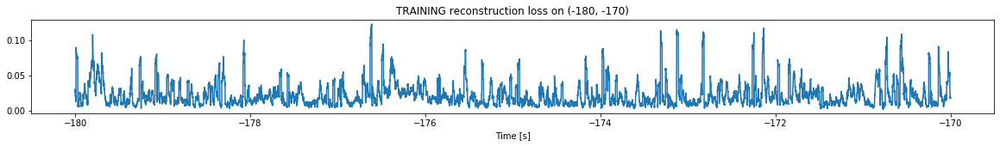

Finished training, median of the log(loss) is:  -1.7451522412897673
Triggering for section:  (-170, -160)
Using this median for triggering: -1.8602969780609837


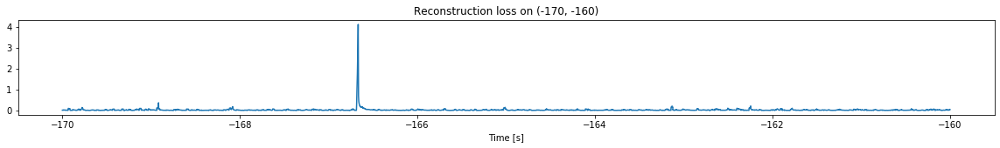

<--------
Entering sections:  (-160, -150)
-------->
Training for section:  (-170, -160)


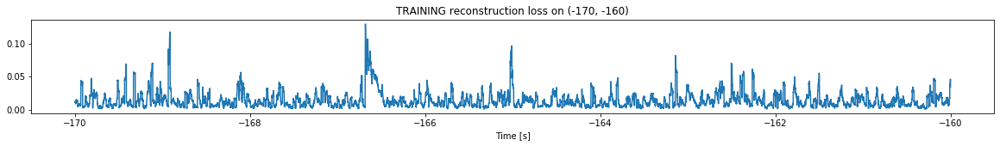

Finished training, median of the log(loss) is:  -1.9517204053554604
Triggering for section:  (-160, -150)
Using this median for triggering: -1.7451522412897673


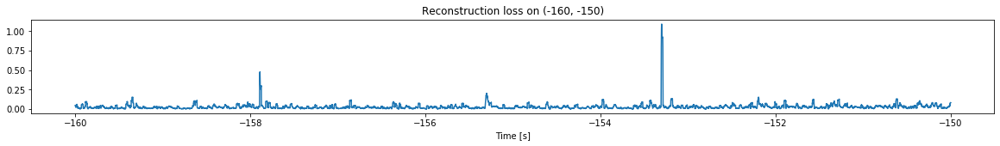

<--------
Entering sections:  (-150, -140)
-------->
Training for section:  (-160, -150)


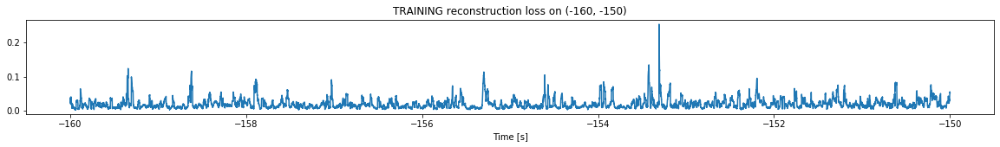

Finished training, median of the log(loss) is:  -1.812838587180309
Triggering for section:  (-150, -140)
Using this median for triggering: -1.9517204053554604


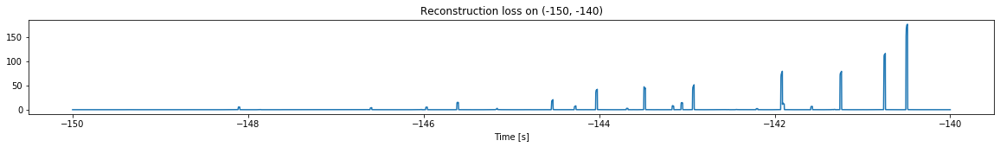

Other trigger time:  [-145.61339 -144.52678 -144.02179 -143.48839 -142.9188  -141.91309
 -141.23909 -140.48679]
Their log loss values are:  [3.13377632 3.2673836  3.57530095 3.62599632 3.66246584 3.85048608
 3.84982106 4.19746235]


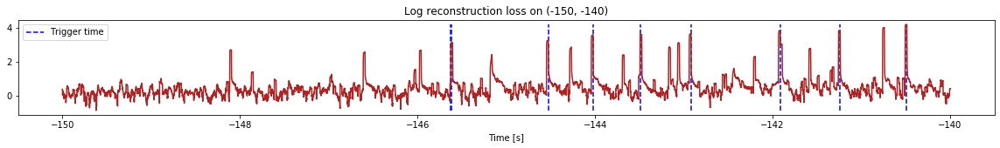

Triggered at:  [-145.61339, -144.52678, -144.02179, -143.48839, -142.9188, -141.91309, -141.23909, -140.48679]
<--------
Entering sections:  (-140, -130)
-------->
Training for section:  (-150, -140)


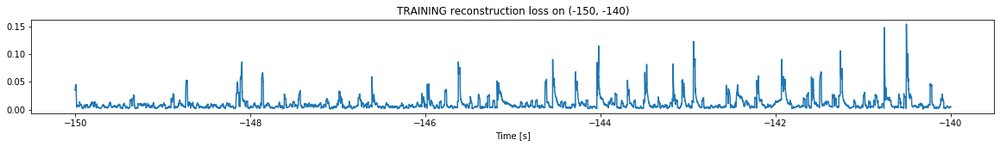

Finished training, median of the log(loss) is:  -2.1616059442326696
Triggering for section:  (-140, -130)
Using this median for triggering: -1.812838587180309


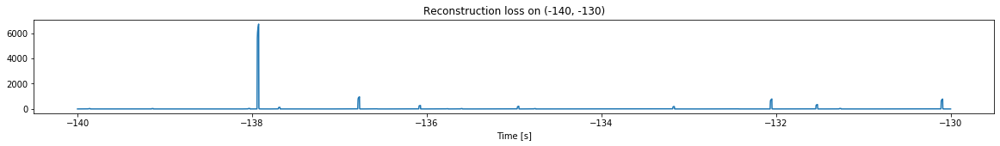

Other trigger time:  [-139.85579 -139.14519 -137.92479 -136.77028 -136.0718  -134.94579
 -133.17009 -132.0474  -131.52489 -130.09099]
Their log loss values are:  [3.31977274 3.29617394 5.64077099 4.79665913 4.25384515 4.1453031
 4.10771794 4.71364402 4.35774166 4.70738185]


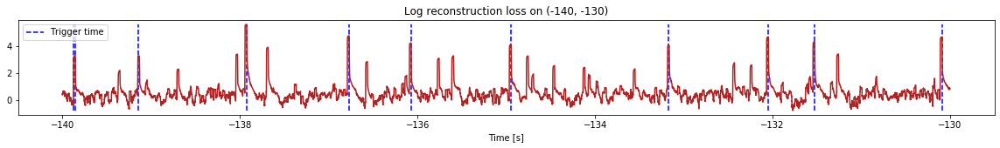

Triggered at:  [-139.85579, -139.14519, -137.92479, -136.77028, -136.0718, -134.94579, -133.17009, -132.0474, -131.52489, -130.09099]
<--------
Entering sections:  (-130, -120)
-------->
Training for section:  (-140, -130)


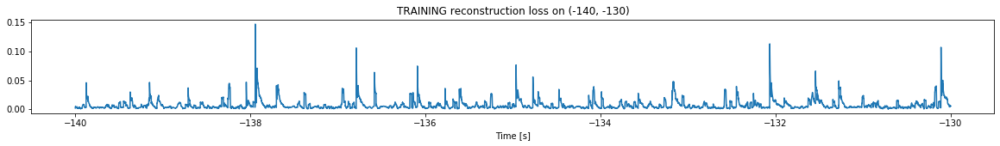

Finished training, median of the log(loss) is:  -2.3508253401509753
Triggering for section:  (-130, -120)
Using this median for triggering: -2.1616059442326696


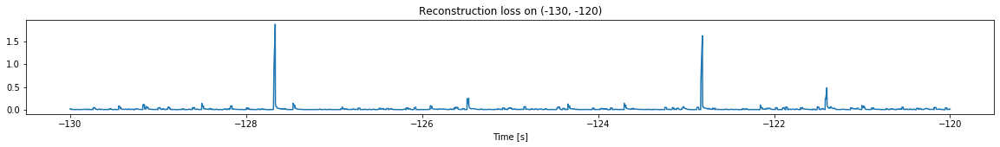

<--------
Entering sections:  (-120, -110)
-------->
Training for section:  (-130, -120)


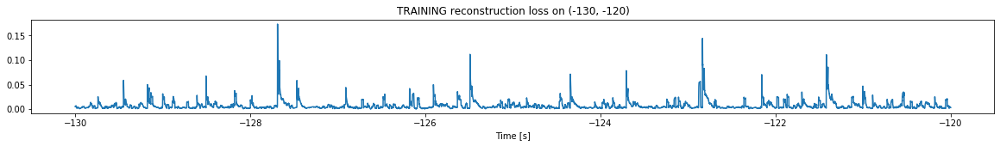

Finished training, median of the log(loss) is:  -2.3160697723103
Triggering for section:  (-120, -110)
Using this median for triggering: -2.3508253401509753


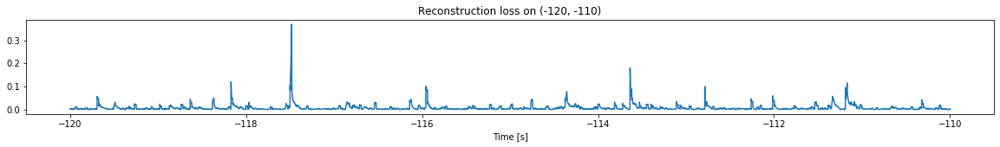

<--------
Entering sections:  (-110, -100)
-------->
Training for section:  (-120, -110)


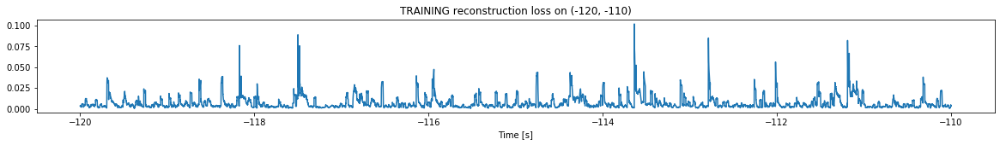

Finished training, median of the log(loss) is:  -2.364609633709124
Triggering for section:  (-110, -100)
Using this median for triggering: -2.3160697723103


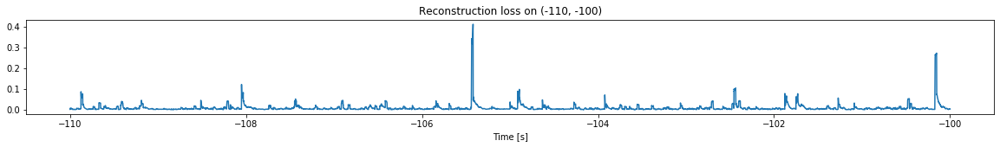

<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


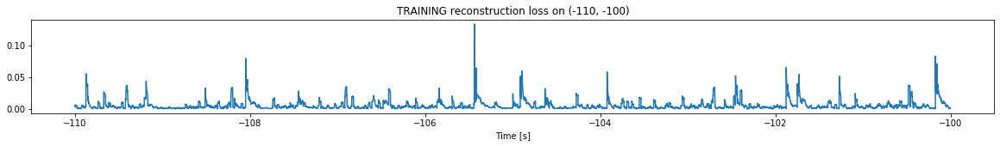

Finished training, median of the log(loss) is:  -2.4117955903577917
Triggering for section:  (-100, -90)
Using this median for triggering: -2.364609633709124


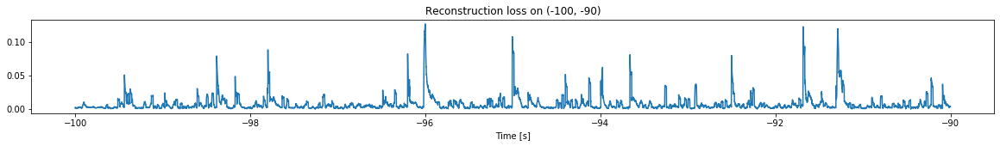

<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


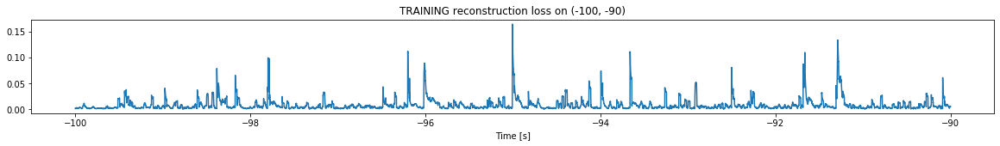

Finished training, median of the log(loss) is:  -2.2877964680638128
Triggering for section:  (-90, -80)
Using this median for triggering: -2.4117955903577917


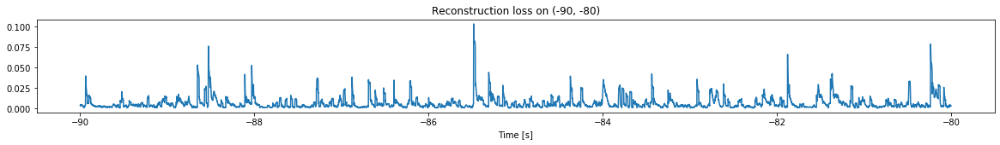

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


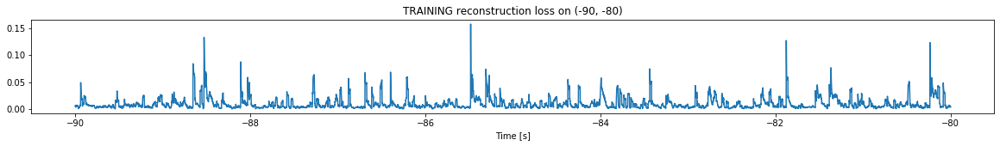

Finished training, median of the log(loss) is:  -2.1549140330765004
Triggering for section:  (-80, -70)
Using this median for triggering: -2.2877964680638128


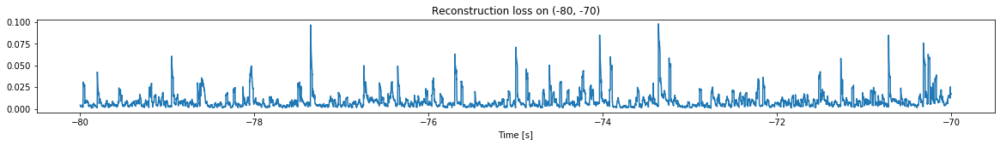

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


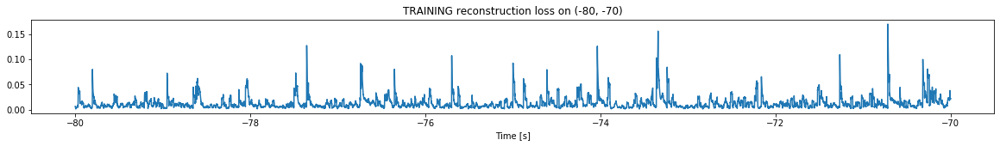

Finished training, median of the log(loss) is:  -2.018999750078048
Triggering for section:  (-70, -60)
Using this median for triggering: -2.1549140330765004


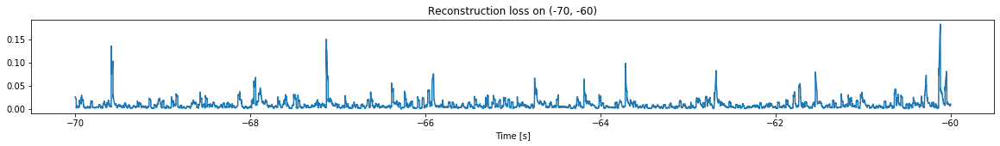

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


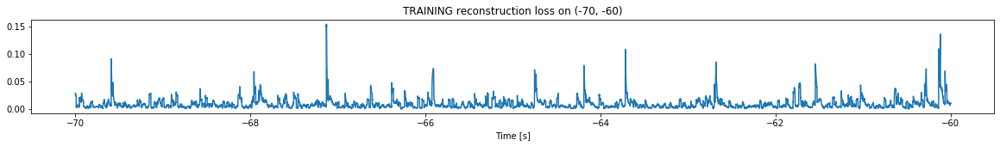

Finished training, median of the log(loss) is:  -2.136892042046903
Triggering for section:  (-60, -50)
Using this median for triggering: -2.018999750078048


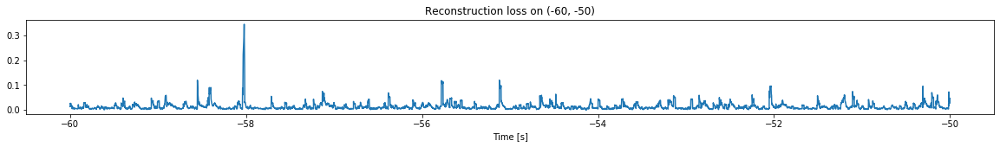

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


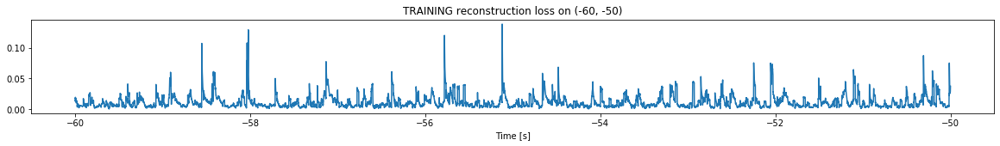

Finished training, median of the log(loss) is:  -2.059461690752333
Triggering for section:  (-50, -40)
Using this median for triggering: -2.136892042046903


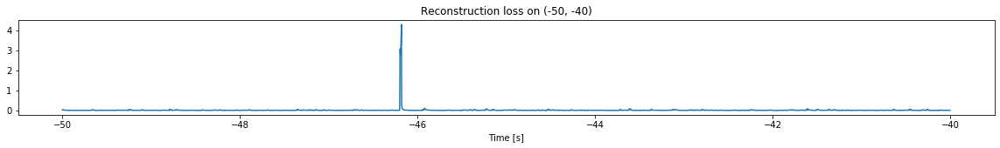

Other trigger time:  [-46.17999]
Their log loss values are:  [2.77067569]


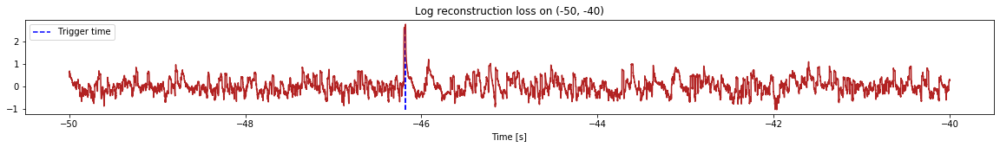

Triggered at:  [-46.17999]
<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


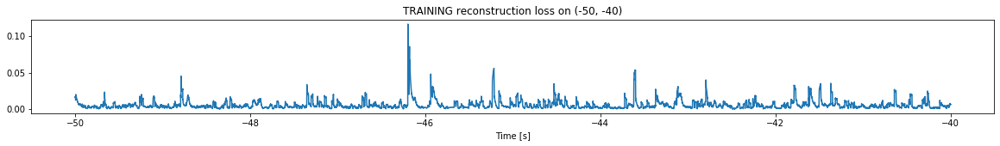

Finished training, median of the log(loss) is:  -2.3545828567075433
Triggering for section:  (-40, -30)
Using this median for triggering: -2.059461690752333


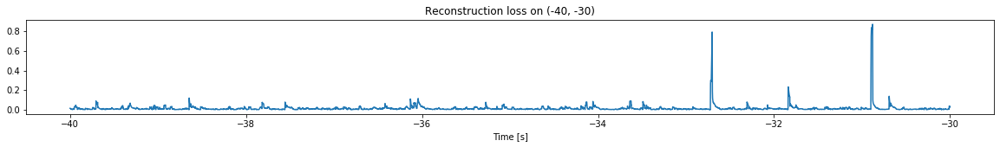

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


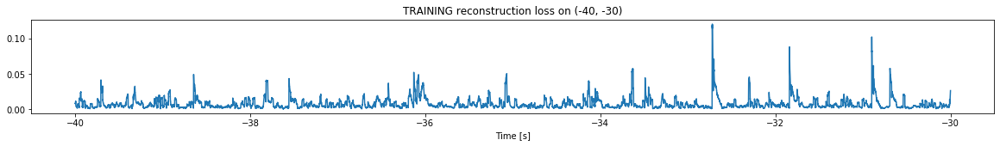

Finished training, median of the log(loss) is:  -2.246273137316594
Triggering for section:  (-30, -20)
Using this median for triggering: -2.3545828567075433


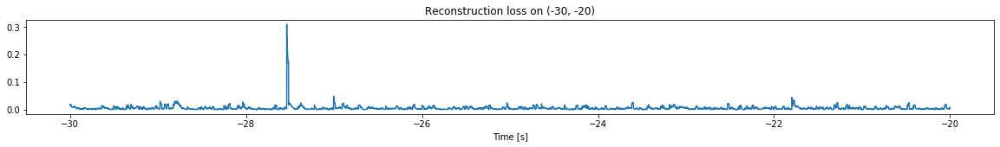

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


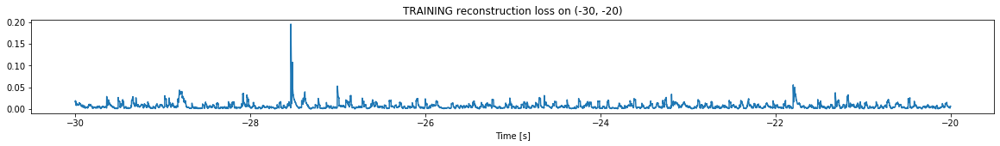

Finished training, median of the log(loss) is:  -2.2599140457448823
Triggering for section:  (-20, -10)
Using this median for triggering: -2.246273137316594


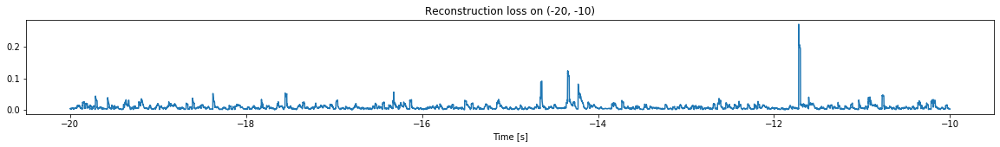

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


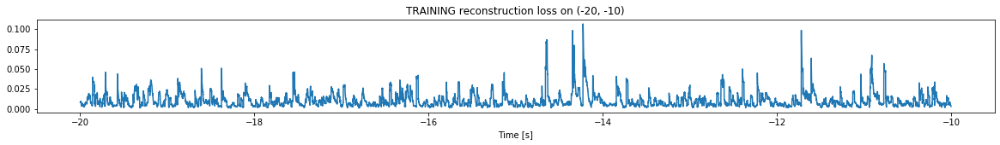

Finished training, median of the log(loss) is:  -2.1163183047531176
Triggering for section:  (-10, 0)
Using this median for triggering: -2.2599140457448823


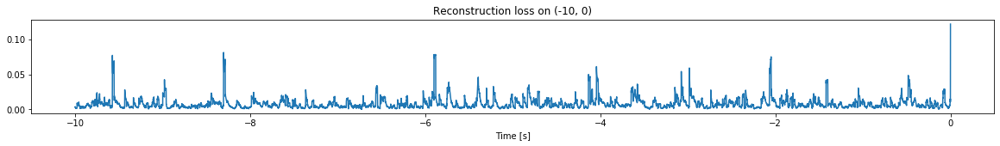

<--------
Finished simulation, all the triggered times are:  [-145.61339, -144.52678, -144.02179, -143.48839, -142.9188, -141.91309, -141.23909, -140.48679, -139.85579, -139.14519, -137.92479, -136.77028, -136.0718, -134.94579, -133.17009, -132.0474, -131.52489, -130.09099, -46.17999]


In [6]:
simulation("./data/Ramp20/", 10, (-212,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1197500, 12)
Flushing input history
Number of sections: 12
Entering sections:  (-120, -110)
-------->
Entering sections:  (-110, -100)
-------->
Training for section:  (None, -110)


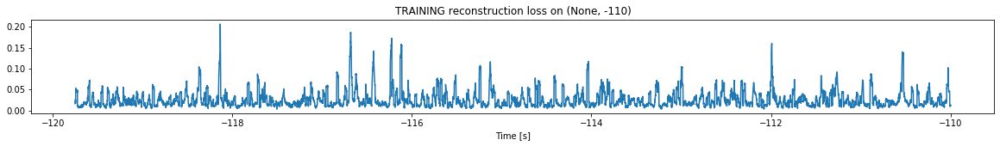

Finished training, median of the log(loss) is:  -1.7024602751227753
<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


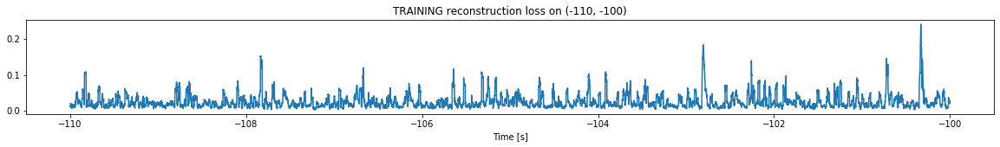

Finished training, median of the log(loss) is:  -1.6865777463384137
Triggering for section:  (-100, -90)
Using this median for triggering: -1.7024602751227753


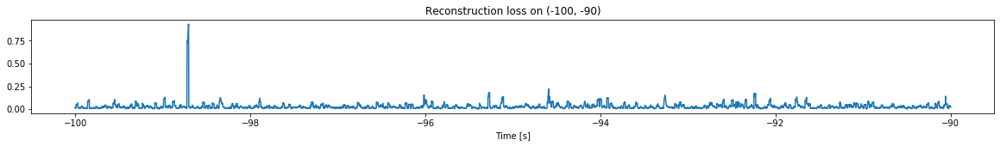

<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


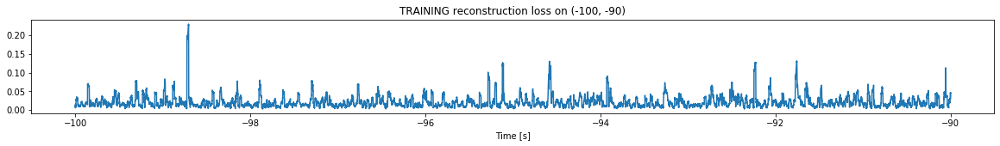

Finished training, median of the log(loss) is:  -1.7654774134143154
Triggering for section:  (-90, -80)
Using this median for triggering: -1.6865777463384137


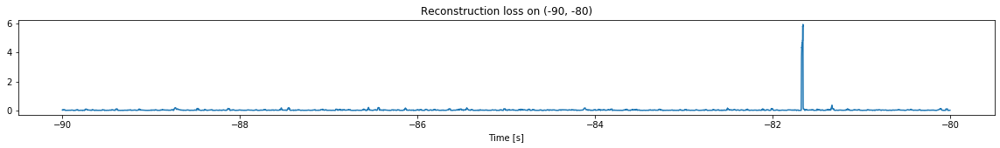

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


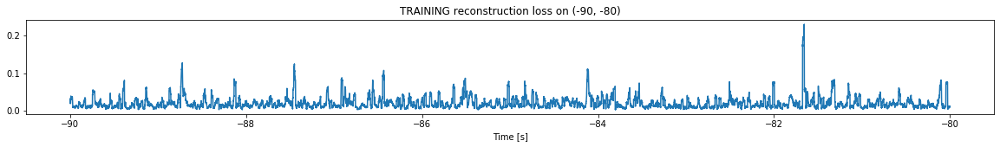

Finished training, median of the log(loss) is:  -1.8050228247204443
Triggering for section:  (-80, -70)
Using this median for triggering: -1.7654774134143154


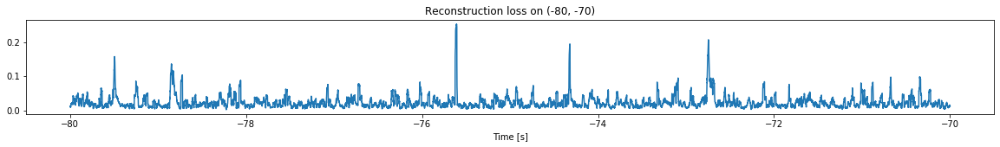

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


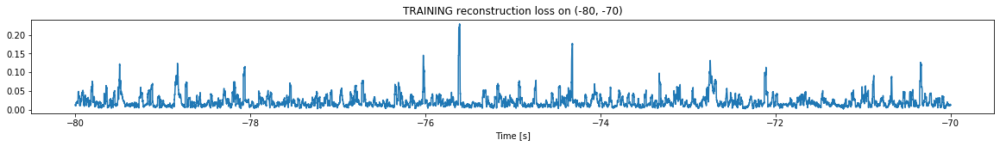

Finished training, median of the log(loss) is:  -1.7487499548102745
Triggering for section:  (-70, -60)
Using this median for triggering: -1.8050228247204443


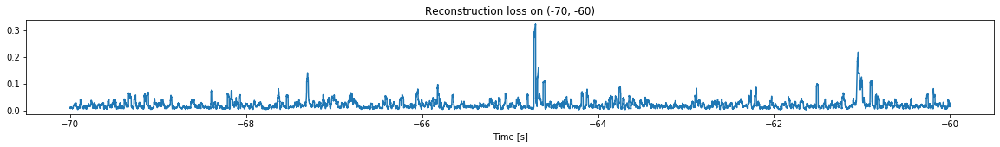

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


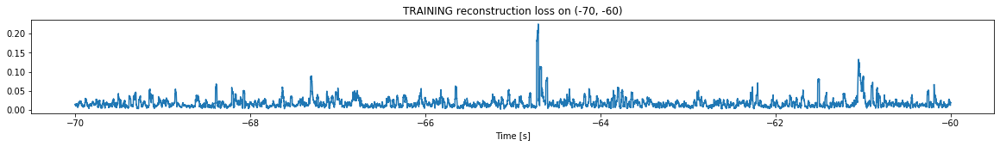

Finished training, median of the log(loss) is:  -1.83716973706636
Triggering for section:  (-60, -50)
Using this median for triggering: -1.7487499548102745


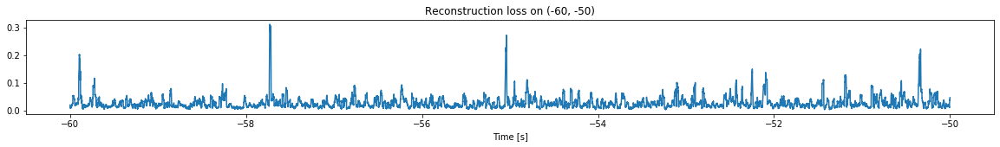

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


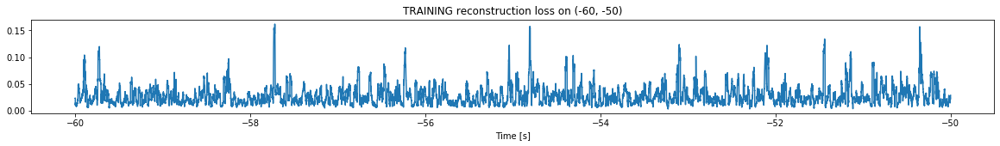

Finished training, median of the log(loss) is:  -1.6232027228916945
Triggering for section:  (-50, -40)
Using this median for triggering: -1.83716973706636


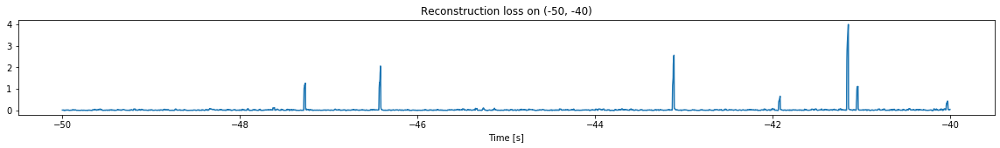

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


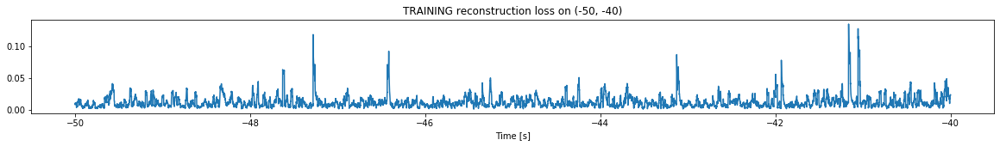

Finished training, median of the log(loss) is:  -1.9843832171234643
Triggering for section:  (-40, -30)
Using this median for triggering: -1.6232027228916945


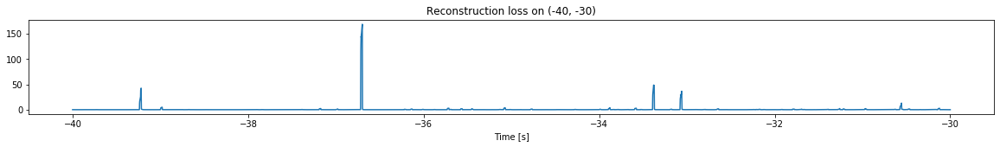

Other trigger time:  [-39.2193   -36.6991   -33.379498 -30.5548  ]
Their log loss values are:  [3.25381075 3.85193676 3.31184186 2.74078062]


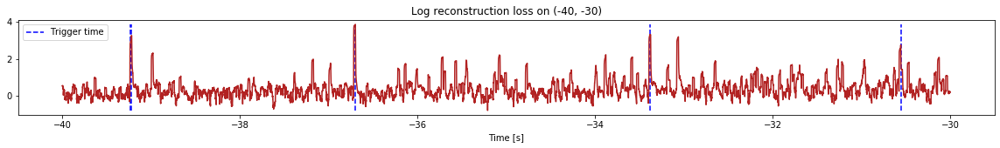

Triggered at:  [-39.2193, -36.6991, -33.379498, -30.5548]
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


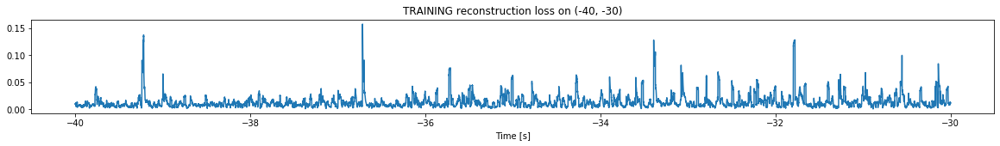

Finished training, median of the log(loss) is:  -1.9784541196555367
Triggering for section:  (-30, -20)
Using this median for triggering: -1.9843832171234643


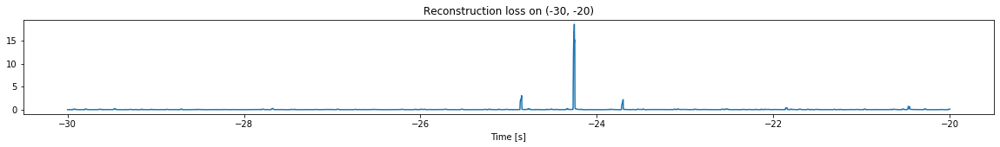

Other trigger time:  [-24.255999]
Their log loss values are:  [3.25300001]


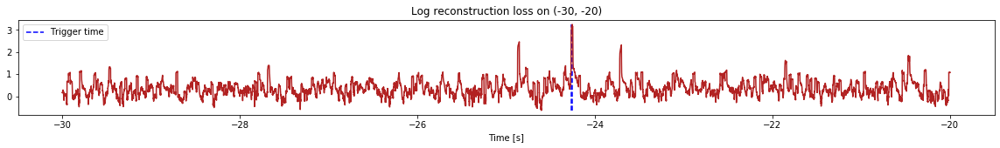

Triggered at:  [-24.255999]
<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


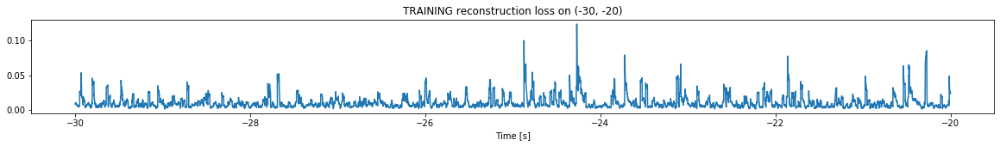

Finished training, median of the log(loss) is:  -2.108283694615139
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9784541196555367


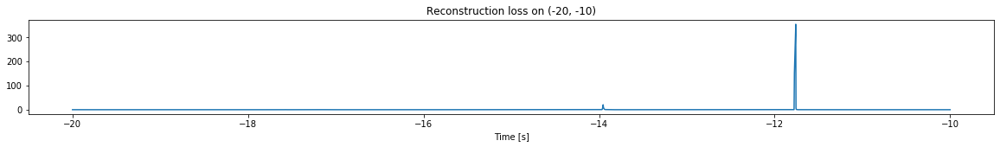

Other trigger time:  [-13.9534 -11.759 ]
Their log loss values are:  [3.29172923 4.52899422]


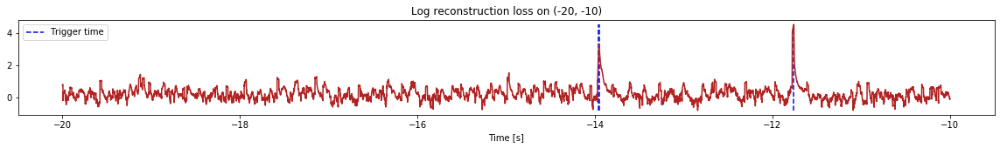

Triggered at:  [-13.9534, -11.759]
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


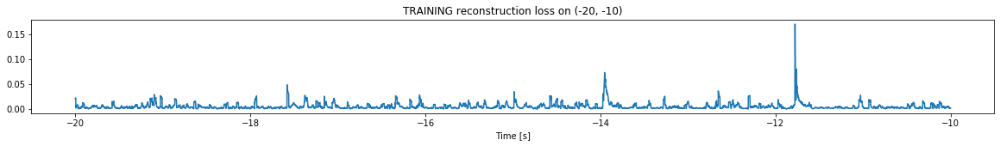

Finished training, median of the log(loss) is:  -2.4288934109143705
Triggering for section:  (-10, 0)
Using this median for triggering: -2.108283694615139


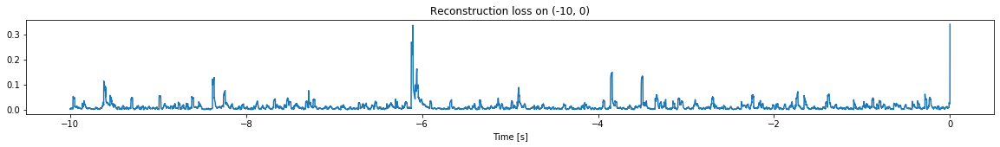

<--------
Finished simulation, all the triggered times are:  [-39.2193, -36.6991, -33.379498, -30.5548, -24.255999, -13.9534, -11.759]


In [7]:
simulation("./data/Ramp21/", 10, (-120,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (797500, 12)
Flushing input history
Number of sections: 8
Entering sections:  (-80, -70)
-------->
Entering sections:  (-70, -60)
-------->
Training for section:  (None, -70)


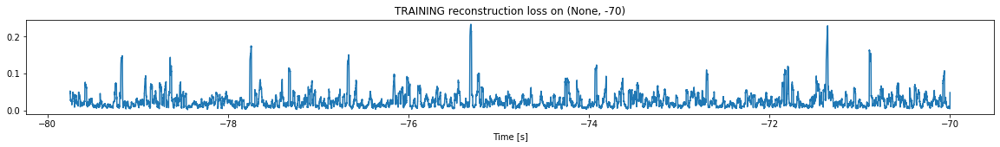

Finished training, median of the log(loss) is:  -1.6704505410498514
<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


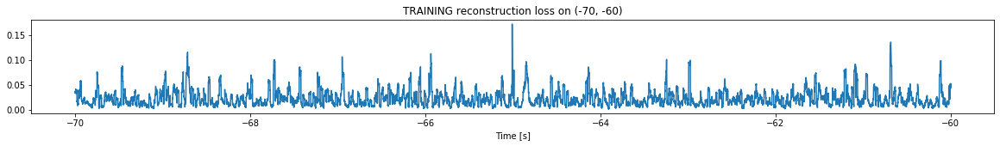

Finished training, median of the log(loss) is:  -1.706617433927937
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6704505410498514


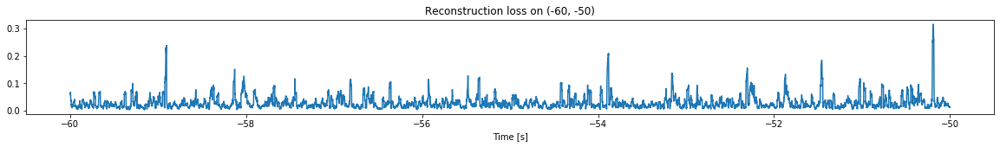

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


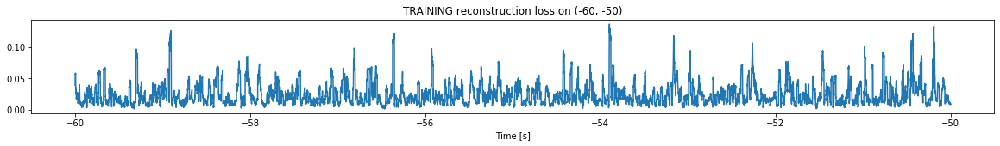

Finished training, median of the log(loss) is:  -1.6971160409667678
Triggering for section:  (-50, -40)
Using this median for triggering: -1.706617433927937


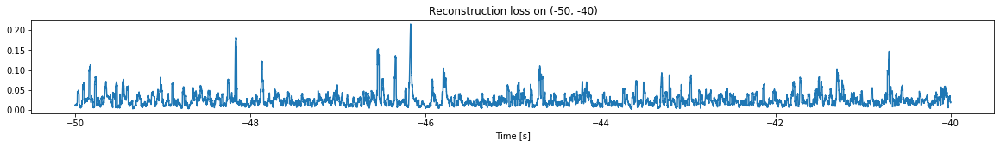

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


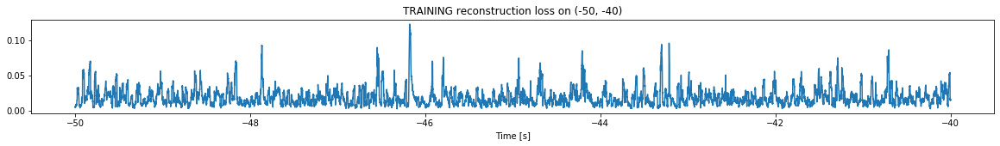

Finished training, median of the log(loss) is:  -1.7939487603011384
Triggering for section:  (-40, -30)
Using this median for triggering: -1.6971160409667678


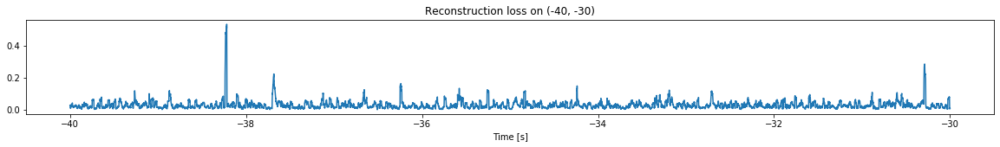

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


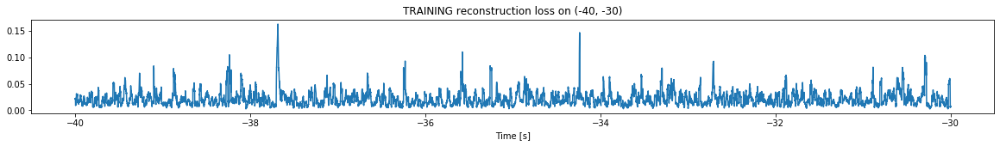

Finished training, median of the log(loss) is:  -1.7262459501127
Triggering for section:  (-30, -20)
Using this median for triggering: -1.7939487603011384


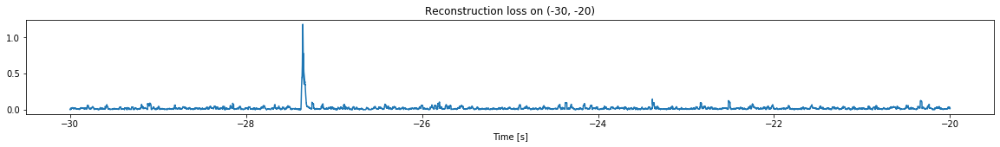

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


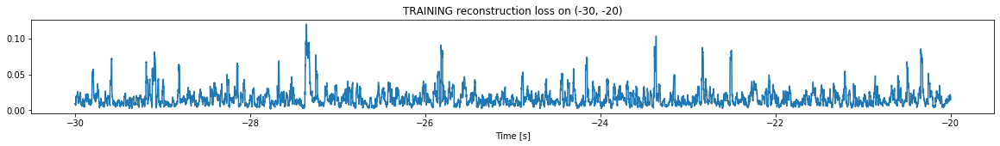

Finished training, median of the log(loss) is:  -1.8606969017715034
Triggering for section:  (-20, -10)
Using this median for triggering: -1.7262459501127


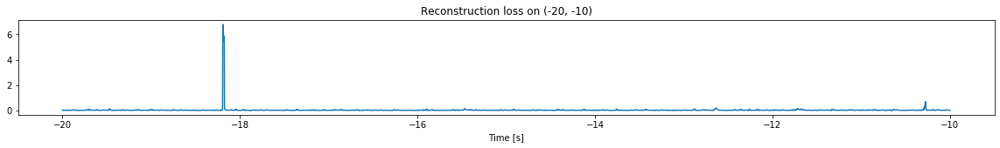

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


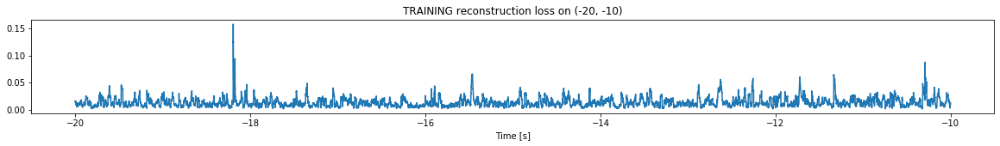

Finished training, median of the log(loss) is:  -1.9306706838254386
Triggering for section:  (-10, 0)
Using this median for triggering: -1.8606969017715034


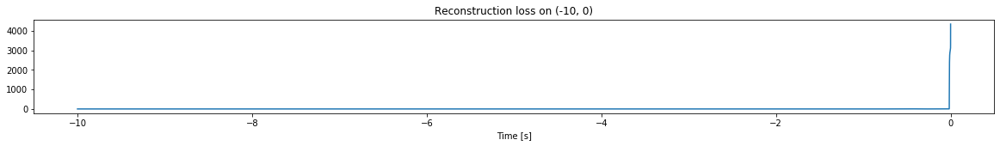

Other trigger time:  []
Their log loss values are:  []


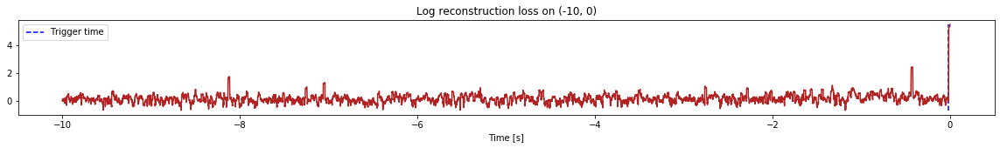

Triggered at:  []
<--------
Finished simulation, all the triggered times are:  []


In [8]:
simulation("./data/Ramp22/", 10, (-80,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (497500, 12)
Flushing input history
Number of sections: 5
Entering sections:  (-50, -40)
-------->
Entering sections:  (-40, -30)
-------->
Training for section:  (None, -40)


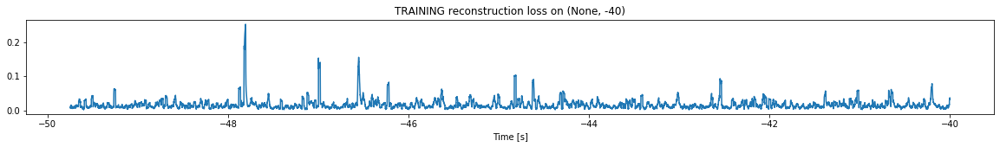

Finished training, median of the log(loss) is:  -1.852691573608876
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


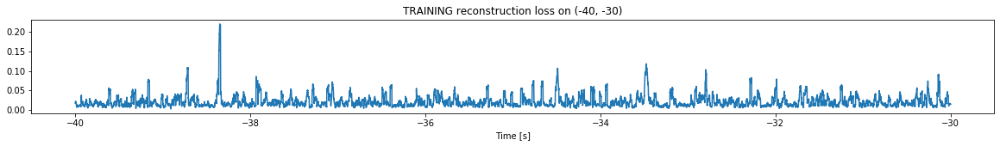

Finished training, median of the log(loss) is:  -1.7776933650528544
Triggering for section:  (-30, -20)
Using this median for triggering: -1.852691573608876


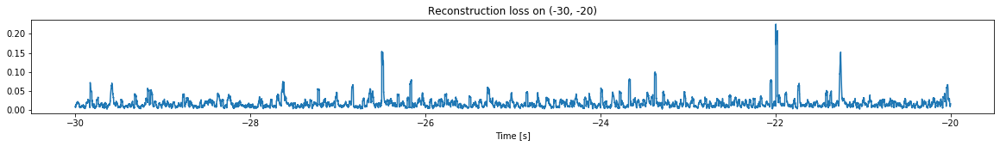

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


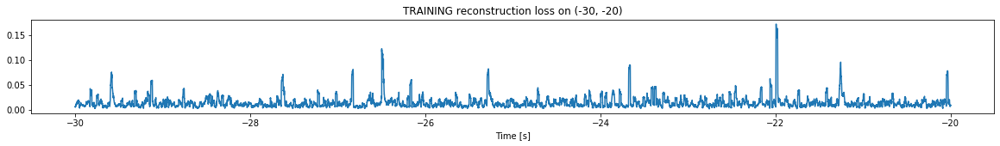

Finished training, median of the log(loss) is:  -1.9415220280149377
Triggering for section:  (-20, -10)
Using this median for triggering: -1.7776933650528544


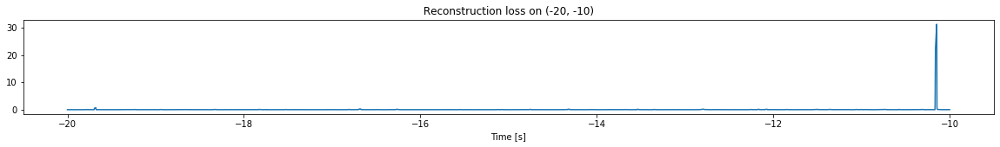

Other trigger time:  [-10.1461]
Their log loss values are:  [3.27394253]


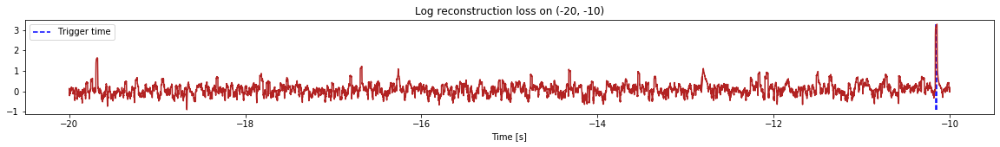

Triggered at:  [-10.1461]
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


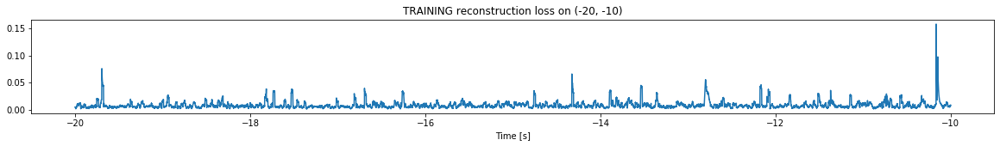

Finished training, median of the log(loss) is:  -2.1747964020536115
Triggering for section:  (-10, 0)
Using this median for triggering: -1.9415220280149377


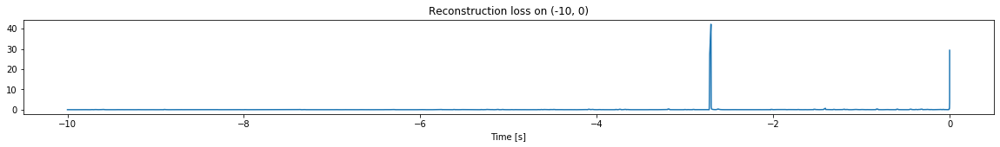

Other trigger time:  [-2.7054]
Their log loss values are:  [3.56759663]


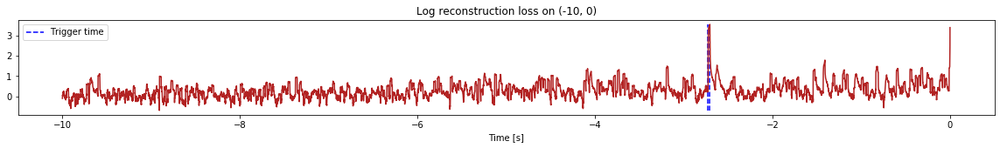

Triggered at:  [-2.7054]
<--------
Finished simulation, all the triggered times are:  [-10.1461, -2.7054]


In [9]:
simulation("./data/Ramp23/", 10, (-50,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1097500, 12)
Flushing input history
Number of sections: 11
Entering sections:  (-110, -100)
-------->
Entering sections:  (-100, -90)
-------->
Training for section:  (None, -100)


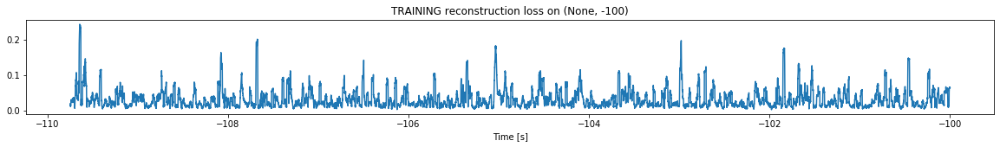

Finished training, median of the log(loss) is:  -1.5943528637181832
<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


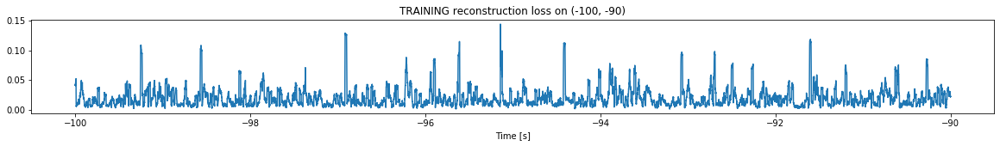

Finished training, median of the log(loss) is:  -1.8012333647712453
Triggering for section:  (-90, -80)
Using this median for triggering: -1.5943528637181832


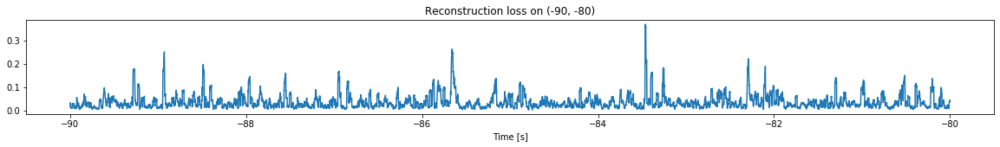

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


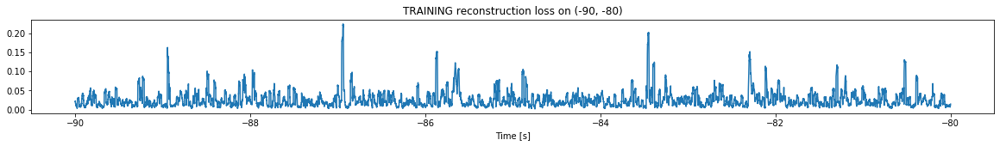

Finished training, median of the log(loss) is:  -1.6787540903876543
Triggering for section:  (-80, -70)
Using this median for triggering: -1.8012333647712453


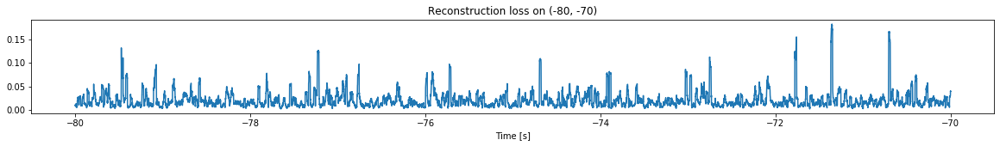

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


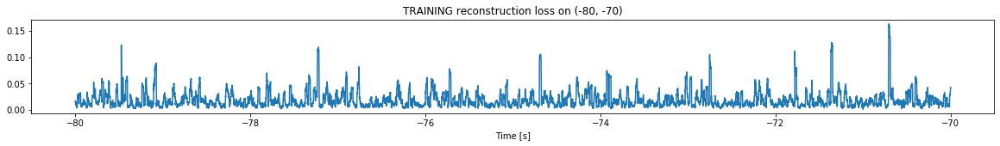

Finished training, median of the log(loss) is:  -1.8310773858609566
Triggering for section:  (-70, -60)
Using this median for triggering: -1.6787540903876543


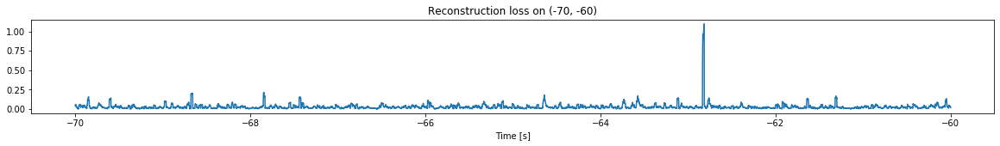

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


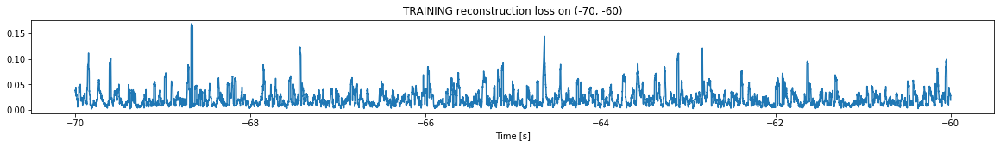

Finished training, median of the log(loss) is:  -1.7441636970489087
Triggering for section:  (-60, -50)
Using this median for triggering: -1.8310773858609566


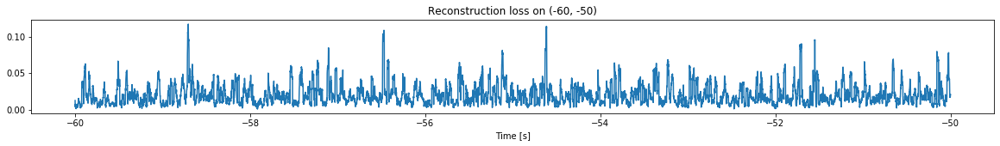

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


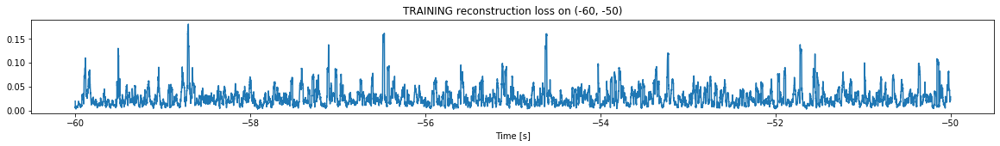

Finished training, median of the log(loss) is:  -1.6510225244015277
Triggering for section:  (-50, -40)
Using this median for triggering: -1.7441636970489087


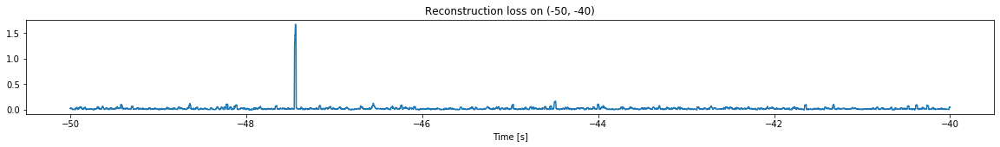

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


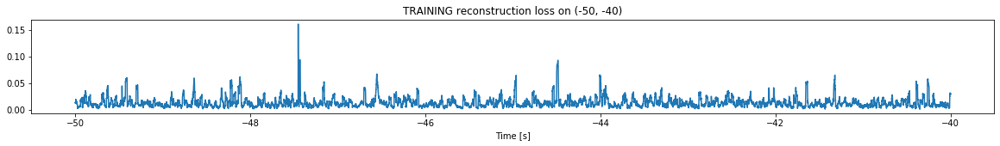

Finished training, median of the log(loss) is:  -1.9463587860531557
Triggering for section:  (-40, -30)
Using this median for triggering: -1.6510225244015277


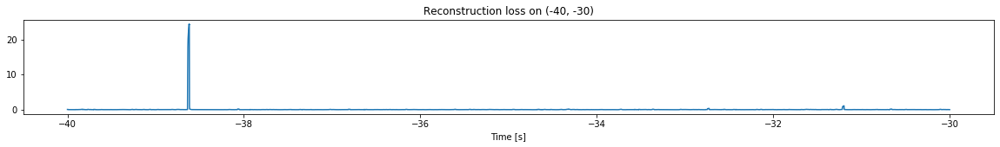

Other trigger time:  [-38.618797]
Their log loss values are:  [3.03818829]


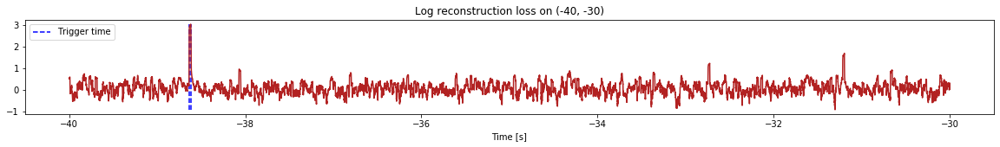

Triggered at:  [-38.618797]
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


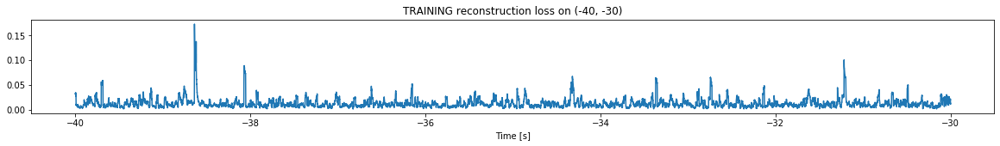

Finished training, median of the log(loss) is:  -1.971663078803323
Triggering for section:  (-30, -20)
Using this median for triggering: -1.9463587860531557


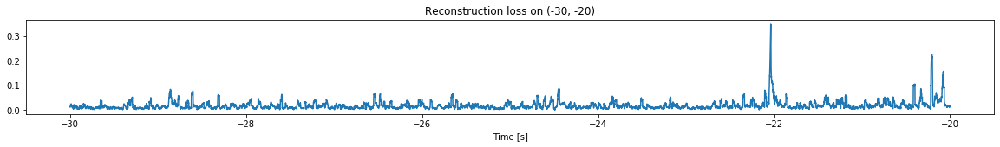

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


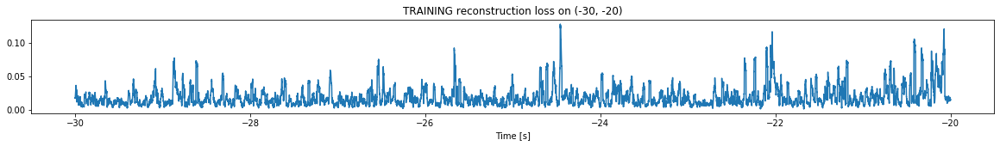

Finished training, median of the log(loss) is:  -1.8157758637798493
Triggering for section:  (-20, -10)
Using this median for triggering: -1.971663078803323


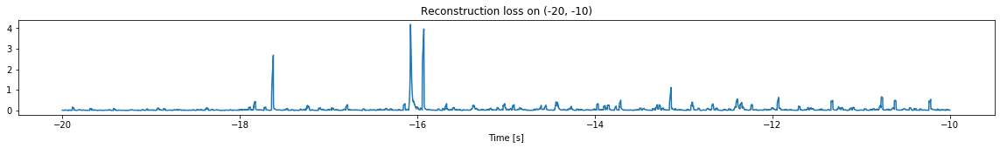

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


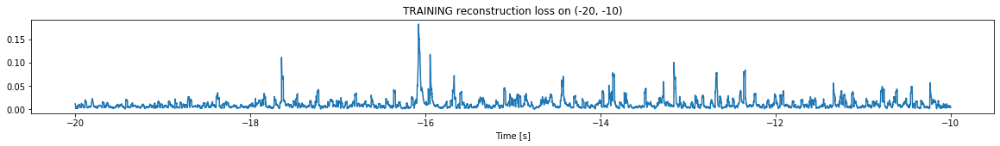

Finished training, median of the log(loss) is:  -2.075078085539928
Triggering for section:  (-10, 0)
Using this median for triggering: -1.8157758637798493


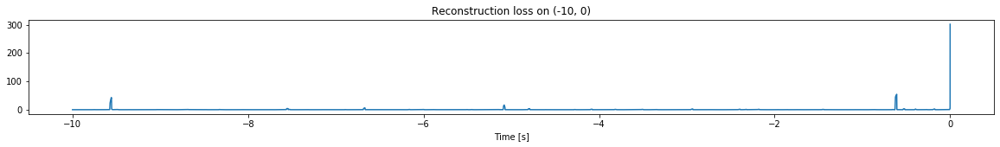

Other trigger time:  [-9.5574 -5.0804 -0.6089]
Their log loss values are:  [3.44995816 3.0326101  3.55159996]


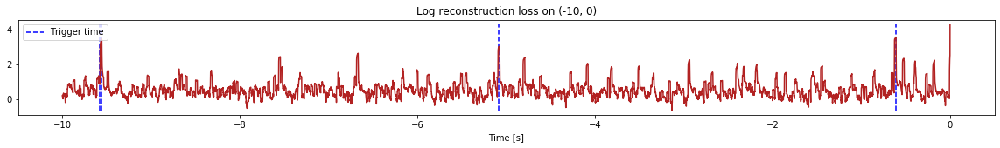

Triggered at:  [-9.5574, -5.0804, -0.6089]
<--------
Finished simulation, all the triggered times are:  [-38.618797, -9.5574, -5.0804, -0.6089]


In [10]:
simulation("./data/Ramp24/", 10, (-110,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (997500, 12)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


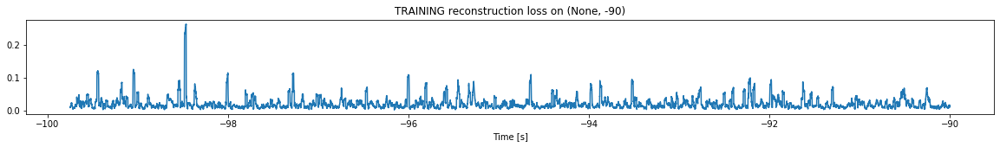

Finished training, median of the log(loss) is:  -1.7812656040711463
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


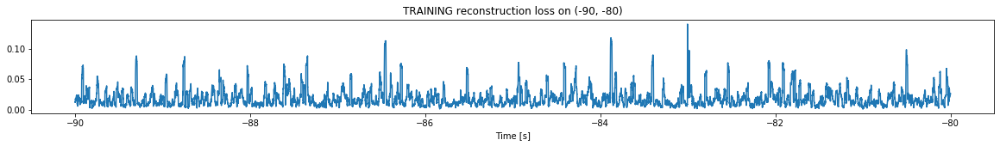

Finished training, median of the log(loss) is:  -1.8158217450435357
Triggering for section:  (-80, -70)
Using this median for triggering: -1.7812656040711463


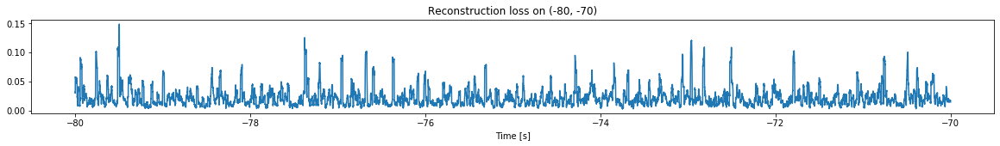

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


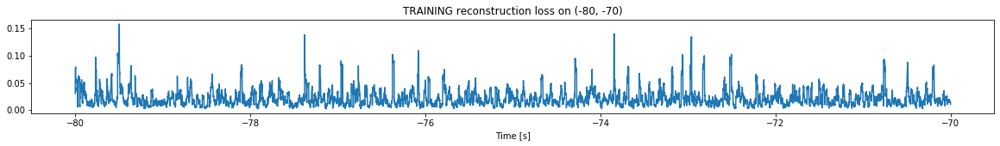

Finished training, median of the log(loss) is:  -1.7362818396197306
Triggering for section:  (-70, -60)
Using this median for triggering: -1.8158217450435357


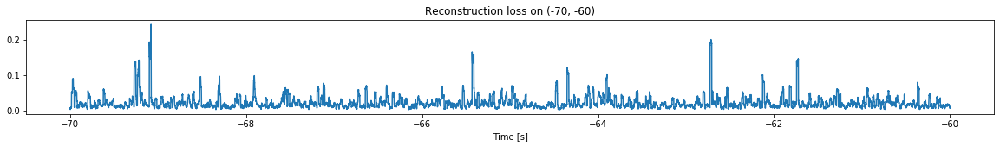

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


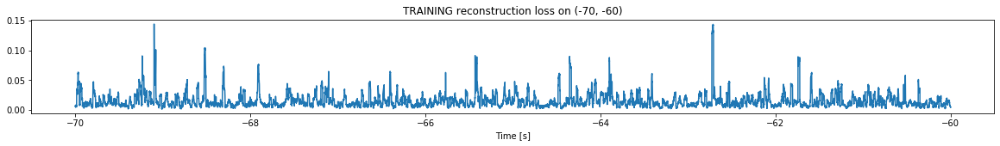

Finished training, median of the log(loss) is:  -1.9092223421245578
Triggering for section:  (-60, -50)
Using this median for triggering: -1.7362818396197306


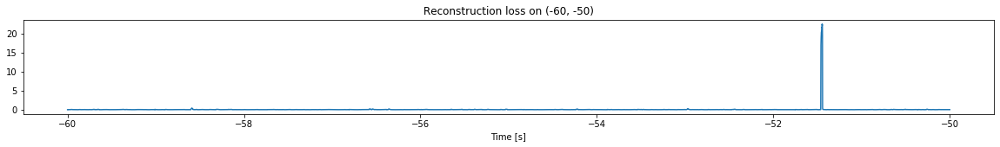

Other trigger time:  [-51.4463]
Their log loss values are:  [3.08746352]


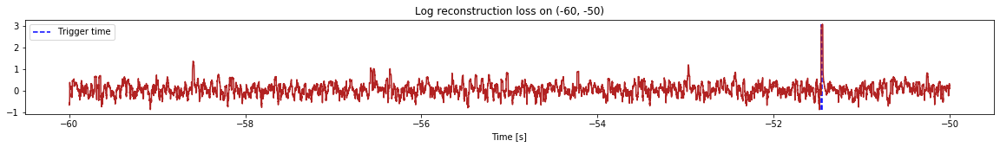

Triggered at:  [-51.4463]
<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


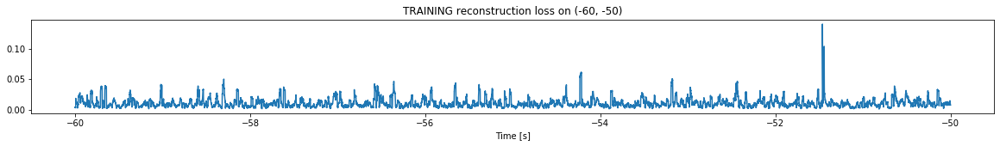

Finished training, median of the log(loss) is:  -2.0493632050753208
Triggering for section:  (-50, -40)
Using this median for triggering: -1.9092223421245578


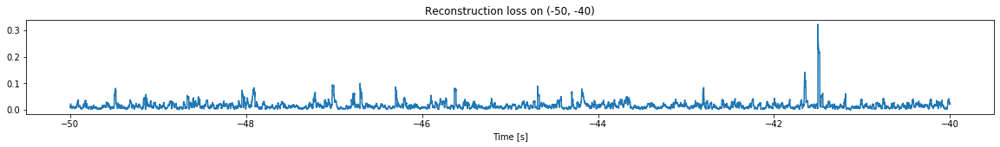

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


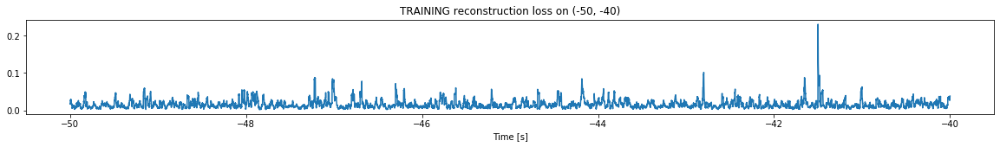

Finished training, median of the log(loss) is:  -1.8820343640493107
Triggering for section:  (-40, -30)
Using this median for triggering: -2.0493632050753208


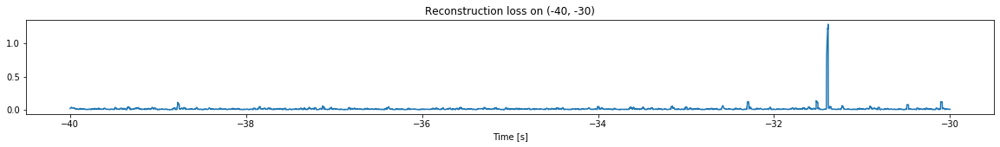

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


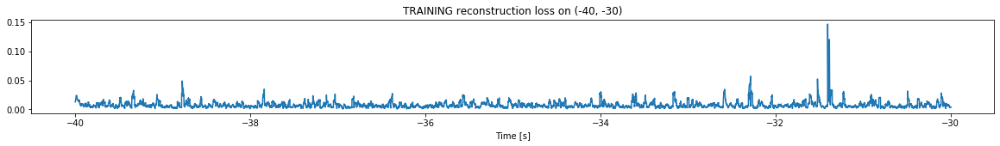

Finished training, median of the log(loss) is:  -2.1922031048784536
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8820343640493107


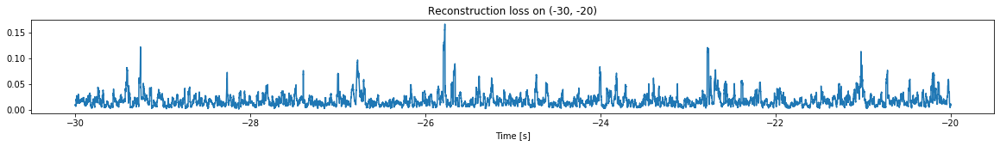

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


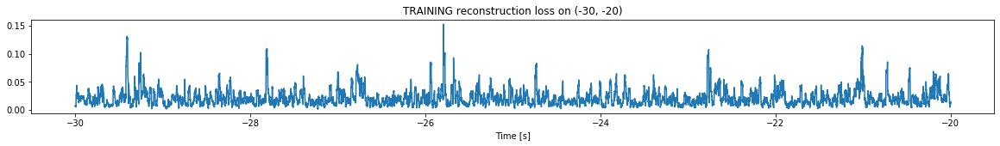

Finished training, median of the log(loss) is:  -1.7405250795739138
Triggering for section:  (-20, -10)
Using this median for triggering: -2.1922031048784536


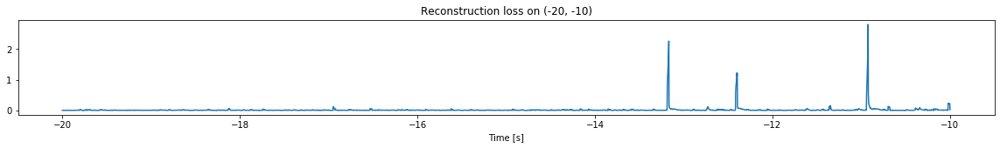

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


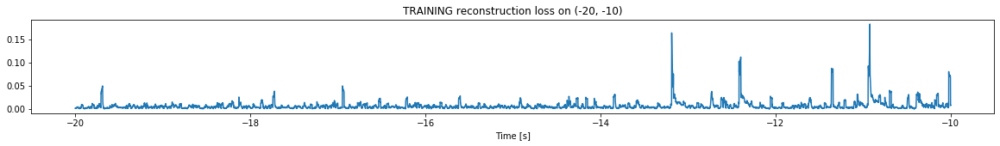

Finished training, median of the log(loss) is:  -2.289089491781415
Triggering for section:  (-10, 0)
Using this median for triggering: -1.7405250795739138


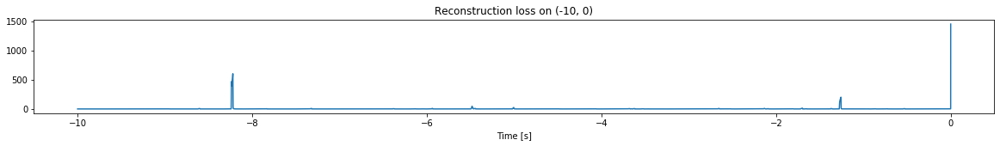

Other trigger time:  [-8.2217    -7.3210998 -5.4825    -2.6526    -2.1334    -1.2574999]
Their log loss values are:  [4.52138978 2.74445402 3.39541906 2.75993911 2.73375136 4.04367025]


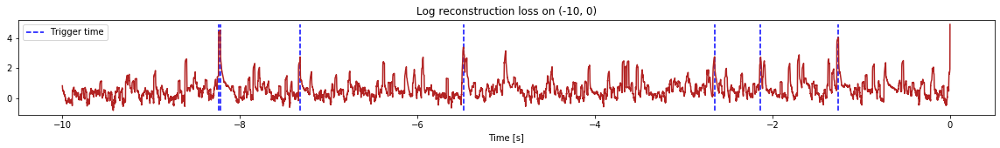

Triggered at:  [-8.2217, -7.3210998, -5.4825, -2.6526, -2.1334, -1.2574999]
<--------
Finished simulation, all the triggered times are:  [-51.4463, -8.2217, -7.3210998, -5.4825, -2.6526, -2.1334, -1.2574999]


In [11]:
simulation("./data/Ramp25/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1097500, 12)
Flushing input history
Number of sections: 11
Entering sections:  (-110, -100)
-------->
Entering sections:  (-100, -90)
-------->
Training for section:  (None, -100)


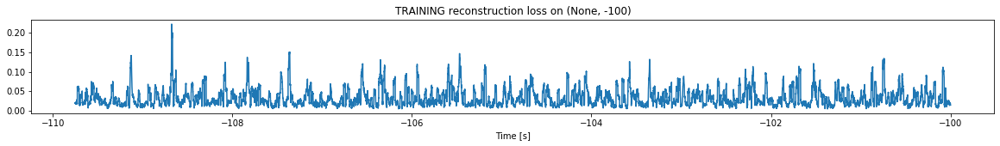

Finished training, median of the log(loss) is:  -1.554358139935939
<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


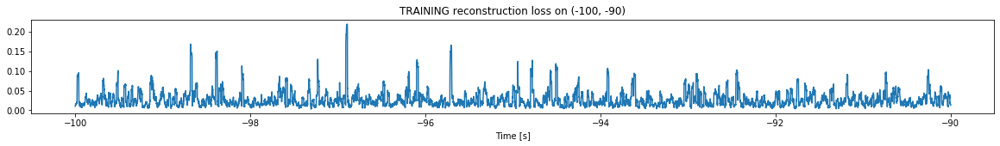

Finished training, median of the log(loss) is:  -1.6407267649483304
Triggering for section:  (-90, -80)
Using this median for triggering: -1.554358139935939


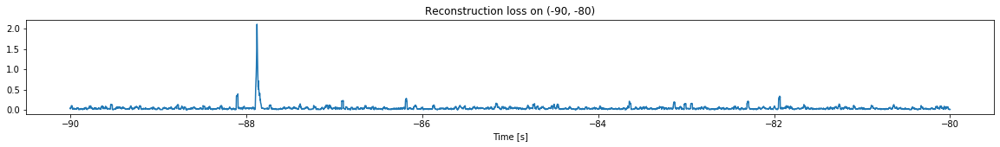

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


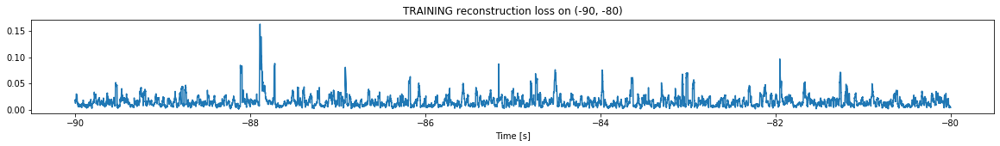

Finished training, median of the log(loss) is:  -1.877887422078996
Triggering for section:  (-80, -70)
Using this median for triggering: -1.6407267649483304


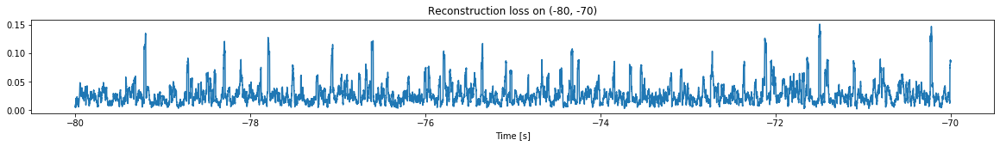

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


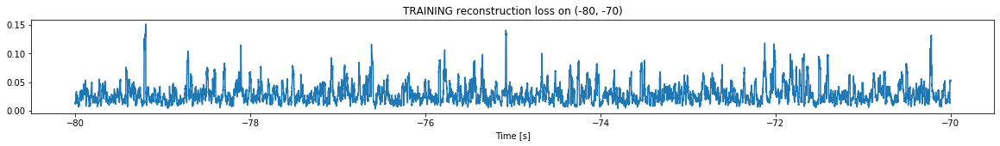

Finished training, median of the log(loss) is:  -1.5878803629540807
Triggering for section:  (-70, -60)
Using this median for triggering: -1.877887422078996


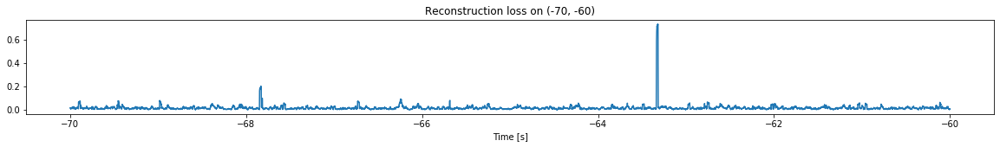

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


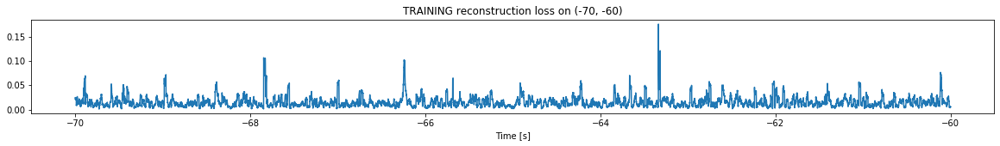

Finished training, median of the log(loss) is:  -1.8801659595882936
Triggering for section:  (-60, -50)
Using this median for triggering: -1.5878803629540807


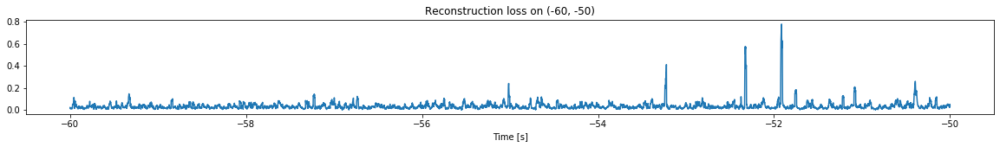

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


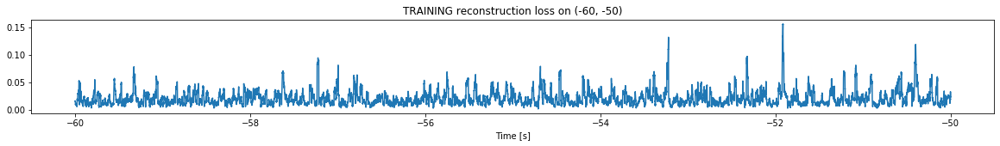

Finished training, median of the log(loss) is:  -1.737267342740144
Triggering for section:  (-50, -40)
Using this median for triggering: -1.8801659595882936


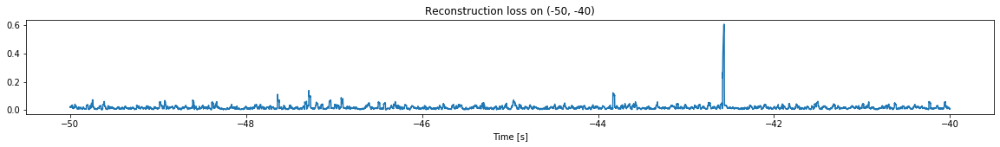

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


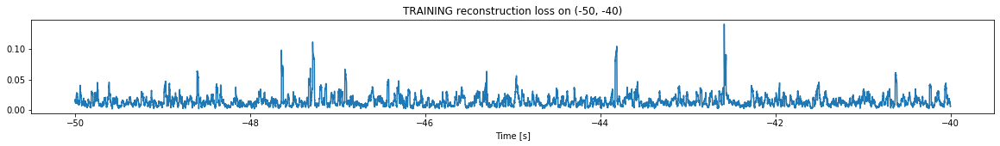

Finished training, median of the log(loss) is:  -1.9168758918956534
Triggering for section:  (-40, -30)
Using this median for triggering: -1.737267342740144


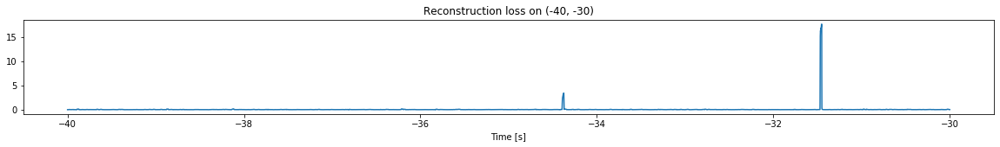

Other trigger time:  [-31.4516]
Their log loss values are:  [2.98479033]


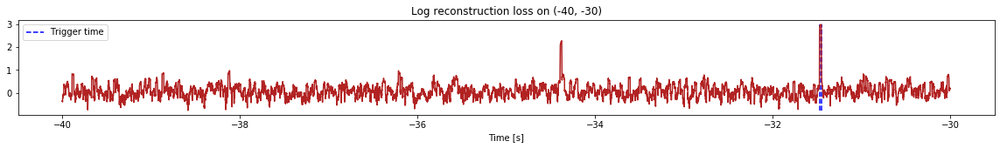

Triggered at:  [-31.4516]
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


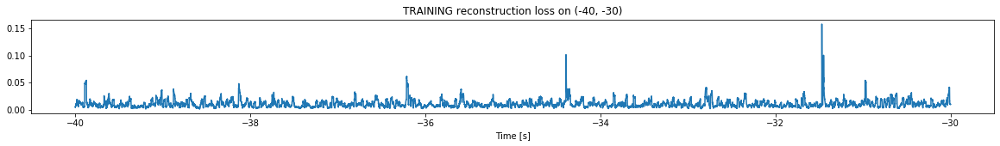

Finished training, median of the log(loss) is:  -2.0438464371748237
Triggering for section:  (-30, -20)
Using this median for triggering: -1.9168758918956534


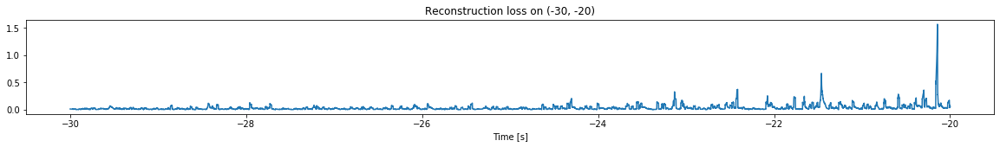

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


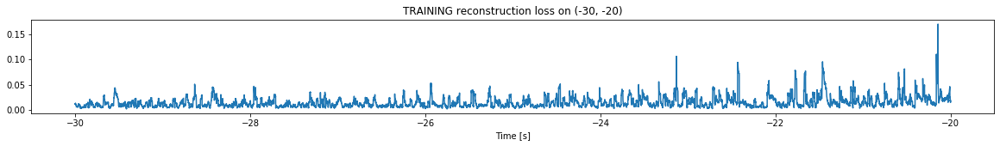

Finished training, median of the log(loss) is:  -1.9350421321342632
Triggering for section:  (-20, -10)
Using this median for triggering: -2.0438464371748237


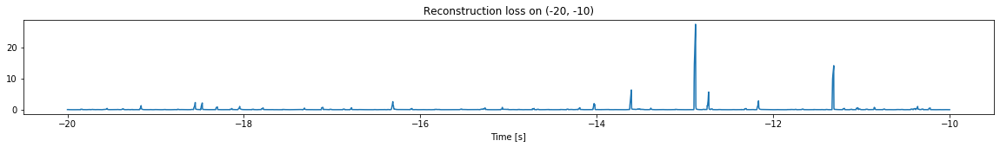

Other trigger time:  [-13.608  -12.8804 -11.3139]
Their log loss values are:  [2.84616285 3.48177607 3.19443612]


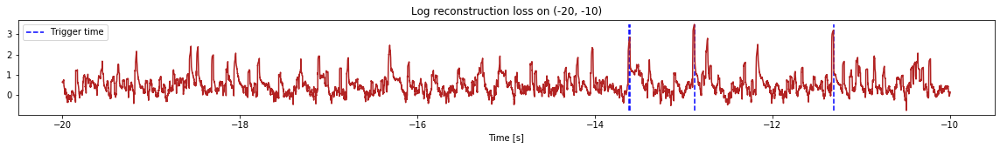

Triggered at:  [-13.608, -12.8804, -11.3139]
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


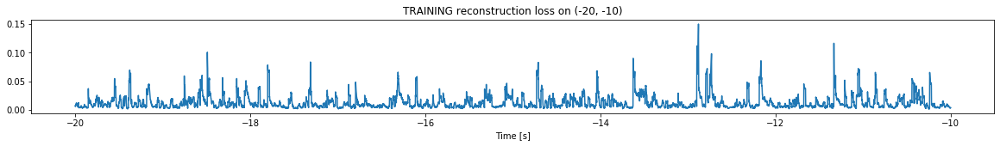

Finished training, median of the log(loss) is:  -2.0500576260595347
Triggering for section:  (-10, 0)
Using this median for triggering: -1.9350421321342632


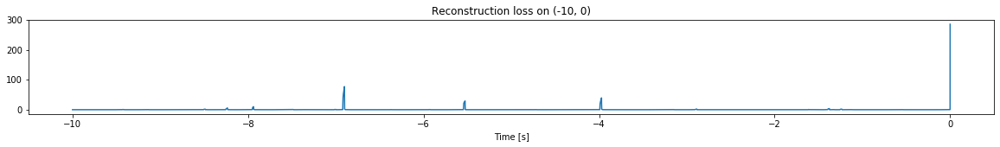

Other trigger time:  [-7.9374 -6.9013 -5.5269 -3.9722]
Their log loss values are:  [2.94149615 3.82460064 3.40074443 3.53257728]


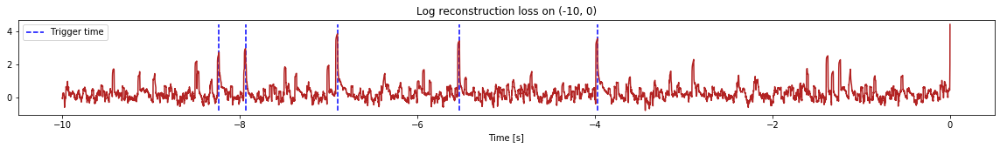

Triggered at:  [-7.9374, -6.9013, -5.5269, -3.9722]
<--------
Finished simulation, all the triggered times are:  [-31.4516, -13.608, -12.8804, -11.3139, -7.9374, -6.9013, -5.5269, -3.9722]


In [12]:
simulation("./data/Ramp26/", 10, (-110,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (697500, 12)
Flushing input history
Number of sections: 7
Entering sections:  (-70, -60)
-------->
Entering sections:  (-60, -50)
-------->
Training for section:  (None, -60)


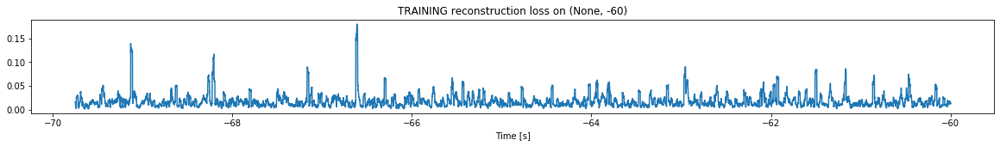

Finished training, median of the log(loss) is:  -1.8134889964239476
<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


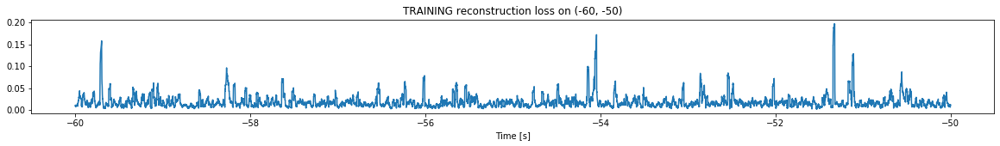

Finished training, median of the log(loss) is:  -1.8225500015997238
Triggering for section:  (-50, -40)
Using this median for triggering: -1.8134889964239476


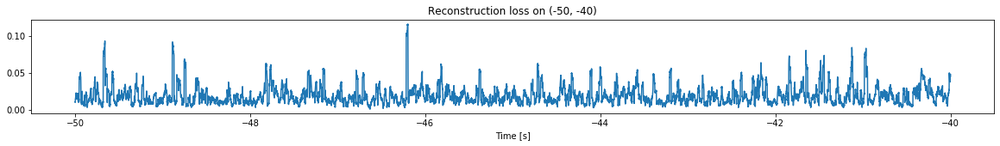

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


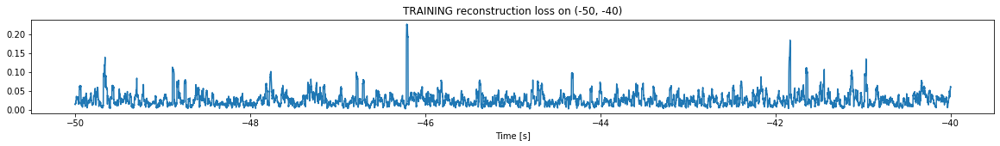

Finished training, median of the log(loss) is:  -1.6169840778645805
Triggering for section:  (-40, -30)
Using this median for triggering: -1.8225500015997238


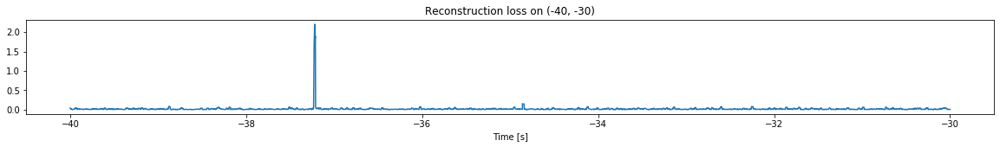

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


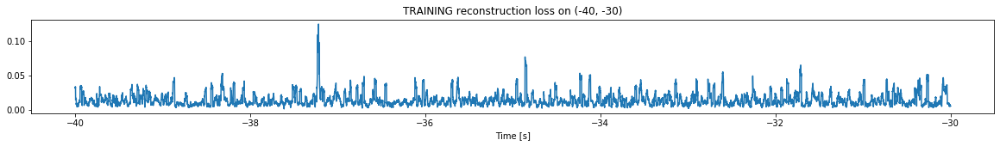

Finished training, median of the log(loss) is:  -1.9159854604578805
Triggering for section:  (-30, -20)
Using this median for triggering: -1.6169840778645805


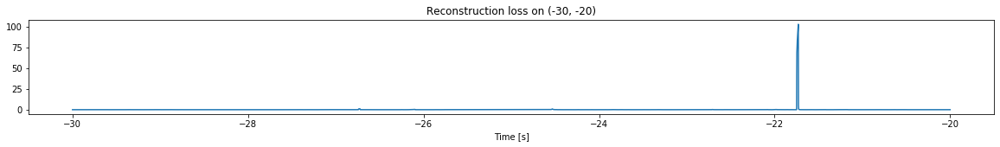

Other trigger time:  [-21.7299]
Their log loss values are:  [3.62995841]


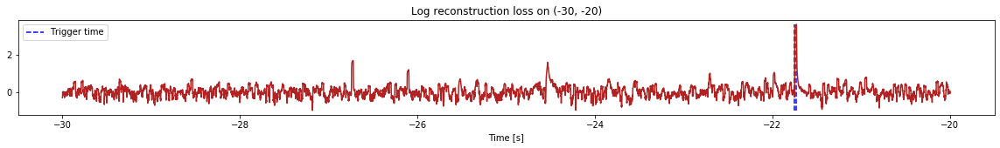

Triggered at:  [-21.7299]
<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


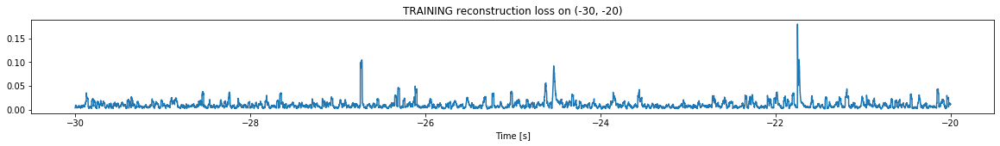

Finished training, median of the log(loss) is:  -2.0947639215469316
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9159854604578805


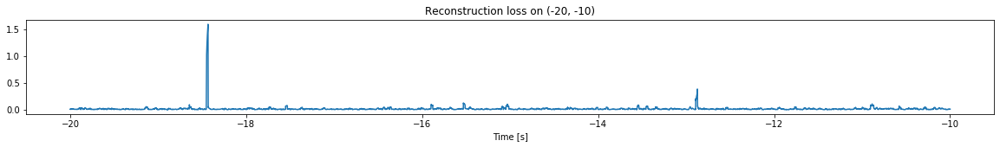

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


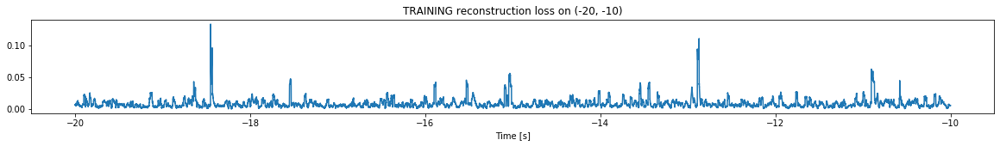

Finished training, median of the log(loss) is:  -2.13216784546472
Triggering for section:  (-10, 0)
Using this median for triggering: -2.0947639215469316


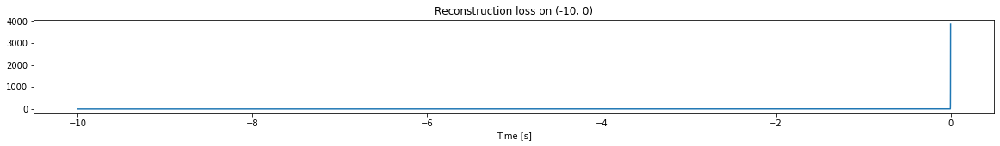

Other trigger time:  []
Their log loss values are:  []


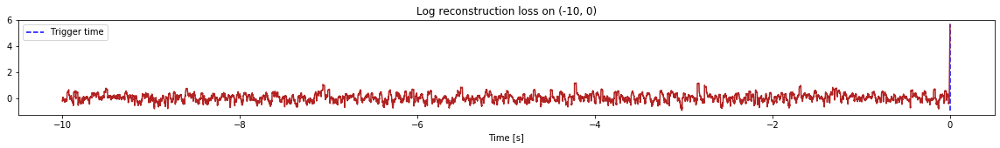

Triggered at:  []
<--------
Finished simulation, all the triggered times are:  [-21.7299]


In [13]:
simulation("./data/Ramp27/", 10, (-70,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (597500, 12)
Flushing input history
Number of sections: 6
Entering sections:  (-60, -50)
-------->
Entering sections:  (-50, -40)
-------->
Training for section:  (None, -50)


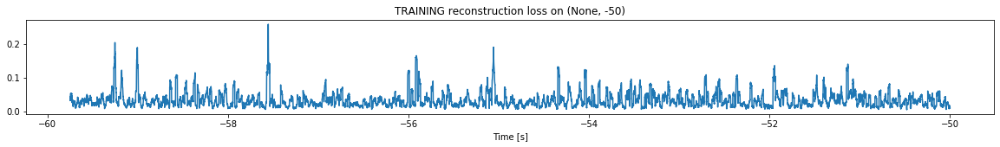

Finished training, median of the log(loss) is:  -1.546187277047185
<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


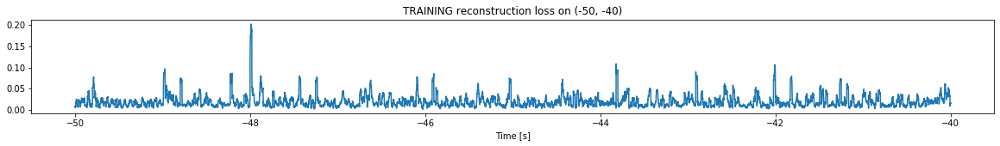

Finished training, median of the log(loss) is:  -1.790498014430181
Triggering for section:  (-40, -30)
Using this median for triggering: -1.546187277047185


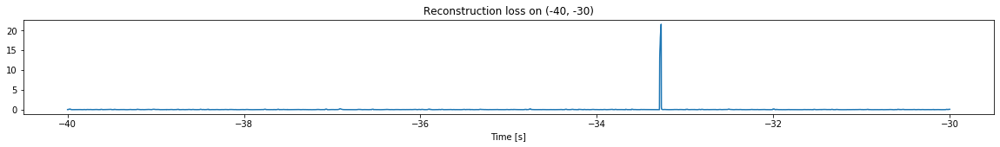

Other trigger time:  [-33.271297]
Their log loss values are:  [2.8810795]


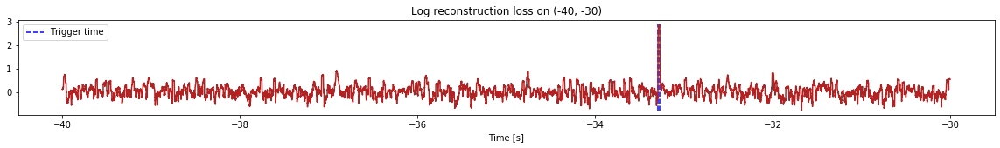

Triggered at:  [-33.271297]
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


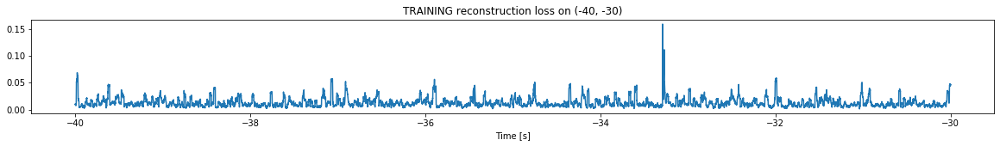

Finished training, median of the log(loss) is:  -1.976710820782895
Triggering for section:  (-30, -20)
Using this median for triggering: -1.790498014430181


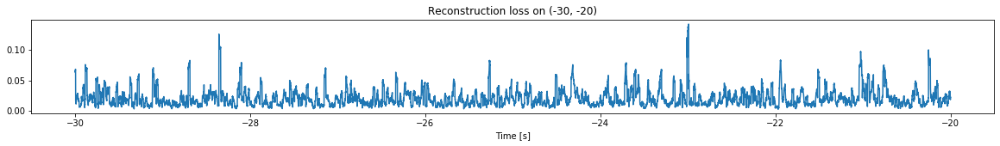

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


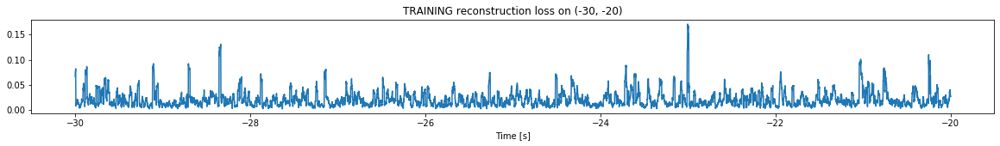

Finished training, median of the log(loss) is:  -1.7601772592471316
Triggering for section:  (-20, -10)
Using this median for triggering: -1.976710820782895


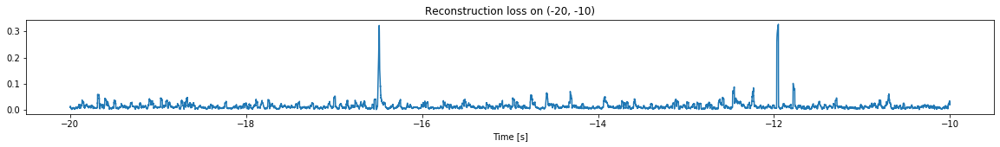

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


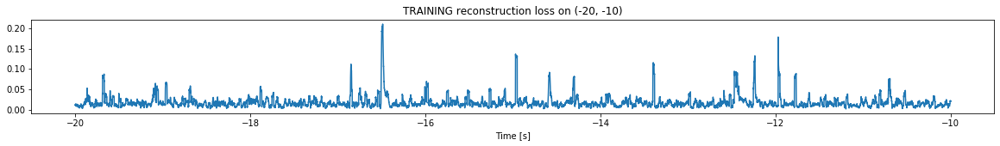

Finished training, median of the log(loss) is:  -1.830052315775771
Triggering for section:  (-10, 0)
Using this median for triggering: -1.7601772592471316


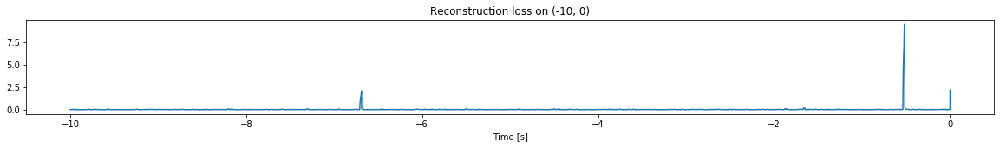

Other trigger time:  [-0.51739997]
Their log loss values are:  [2.73732944]


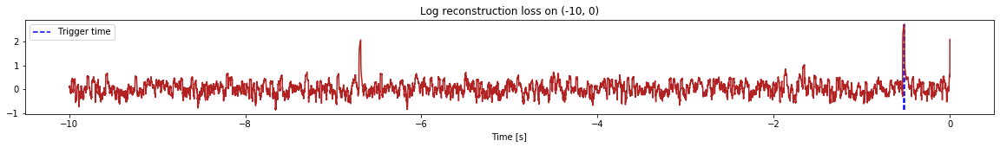

Triggered at:  [-0.51739997]
<--------
Finished simulation, all the triggered times are:  [-33.271297, -0.51739997]


In [14]:
simulation("./data/Ramp28/", 10, (-60,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (997500, 12)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


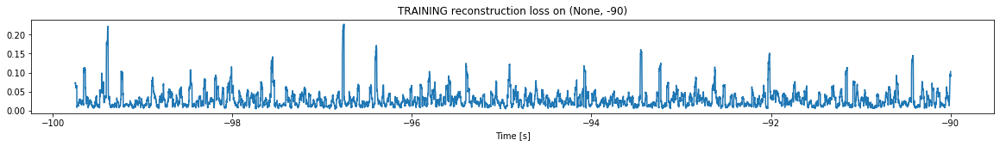

Finished training, median of the log(loss) is:  -1.6449088188660625
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


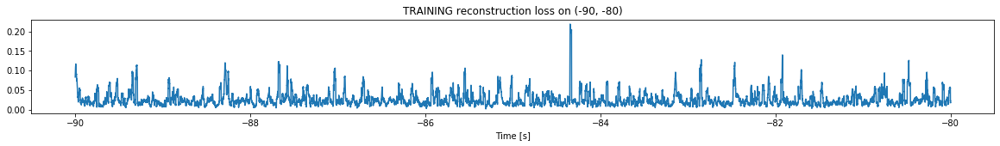

Finished training, median of the log(loss) is:  -1.668288137820193
Triggering for section:  (-80, -70)
Using this median for triggering: -1.6449088188660625


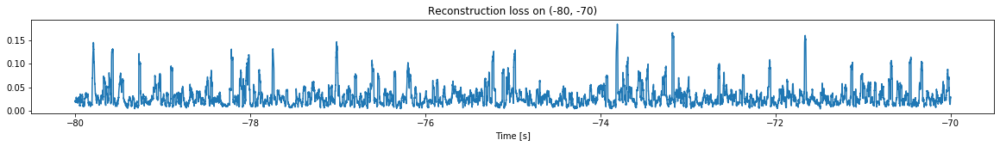

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


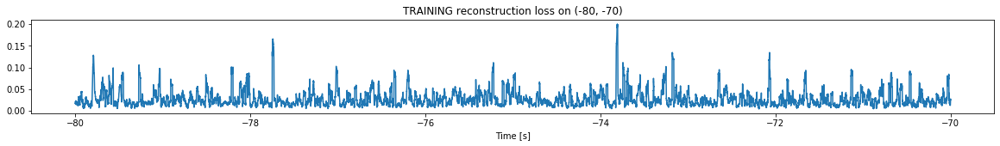

Finished training, median of the log(loss) is:  -1.6492886225926935
Triggering for section:  (-70, -60)
Using this median for triggering: -1.668288137820193


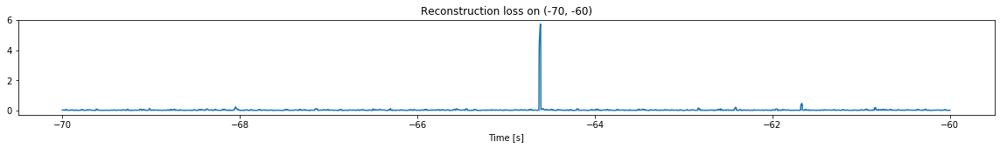

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


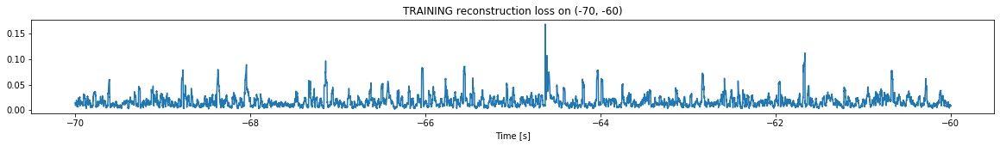

Finished training, median of the log(loss) is:  -1.8495683890224548
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6492886225926935


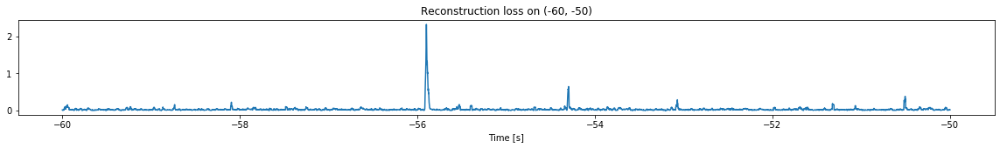

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


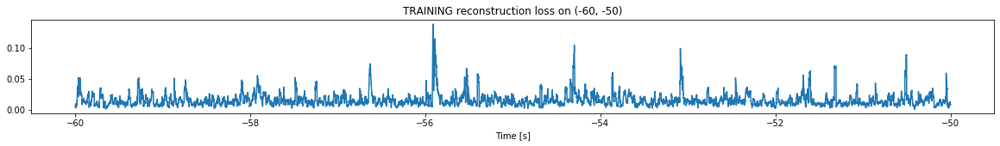

Finished training, median of the log(loss) is:  -1.864844584739806
Triggering for section:  (-50, -40)
Using this median for triggering: -1.8495683890224548


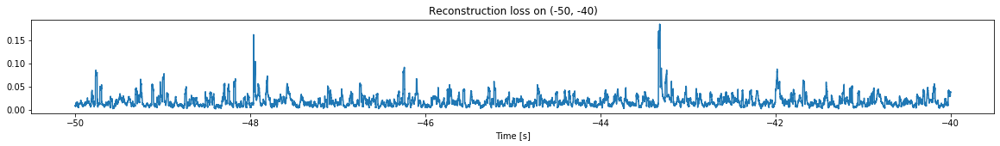

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


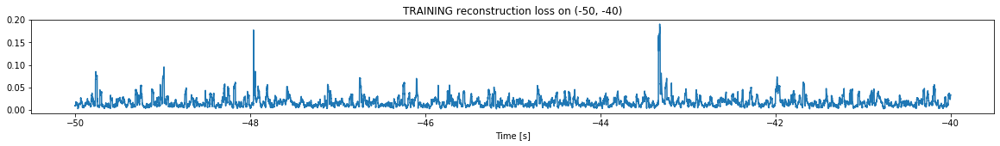

Finished training, median of the log(loss) is:  -1.8404986779356163
Triggering for section:  (-40, -30)
Using this median for triggering: -1.864844584739806


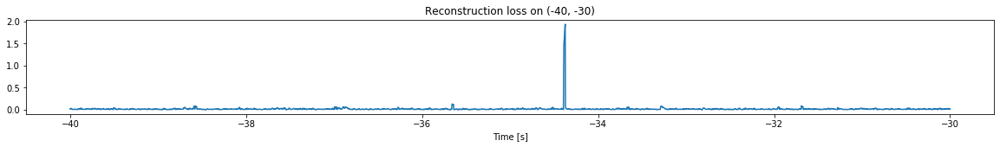

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


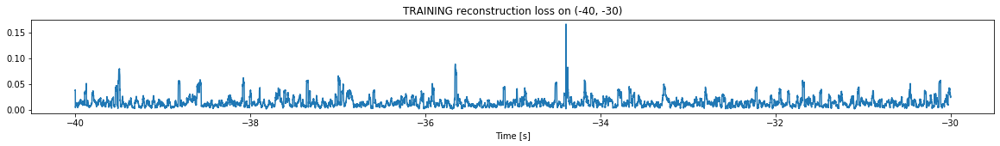

Finished training, median of the log(loss) is:  -1.912184297358341
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8404986779356163


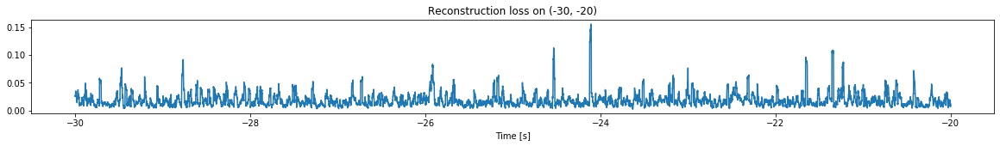

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


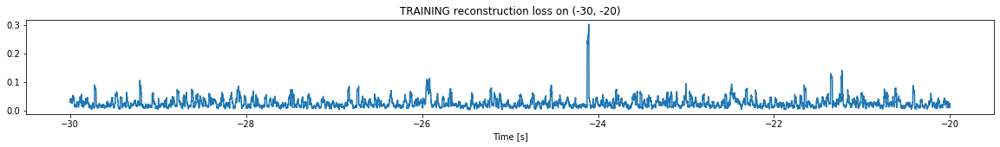

Finished training, median of the log(loss) is:  -1.6560005172729724
Triggering for section:  (-20, -10)
Using this median for triggering: -1.912184297358341


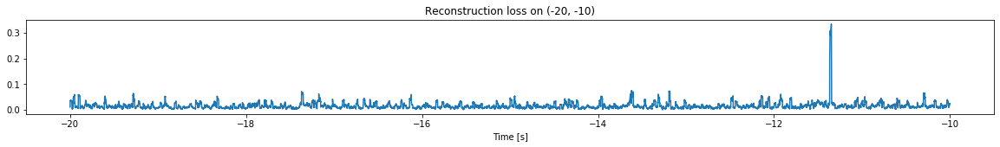

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


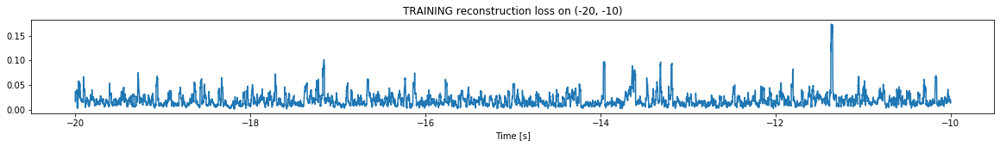

Finished training, median of the log(loss) is:  -1.7892358117183538
Triggering for section:  (-10, 0)
Using this median for triggering: -1.6560005172729724


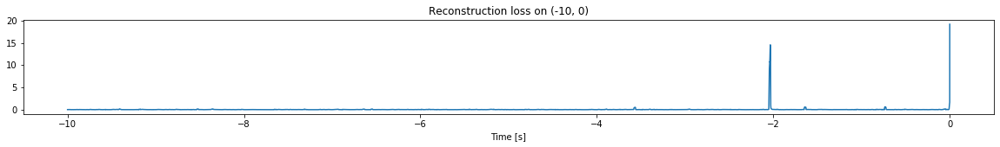

Other trigger time:  [-2.0335]
Their log loss values are:  [2.81945872]


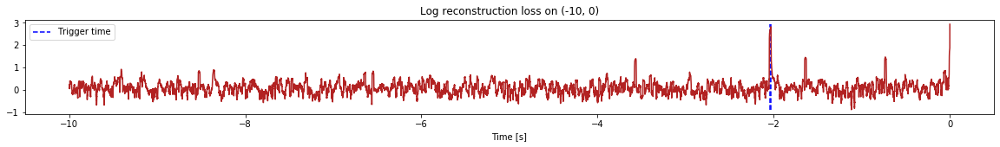

Triggered at:  [-2.0335]
<--------
Finished simulation, all the triggered times are:  [-2.0335]


In [15]:
simulation("./data/Ramp29/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1197500, 12)
Flushing input history
Number of sections: 12
Entering sections:  (-120, -110)
-------->
Entering sections:  (-110, -100)
-------->
Training for section:  (None, -110)


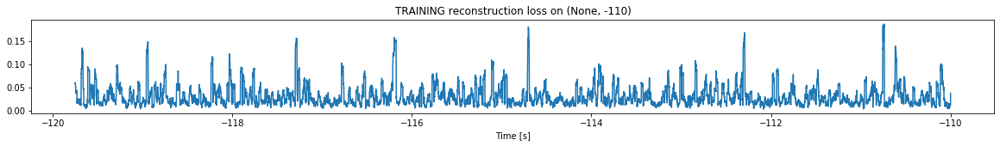

Finished training, median of the log(loss) is:  -1.6062671281173806
<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


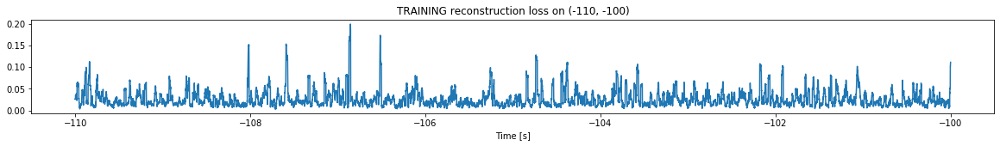

Finished training, median of the log(loss) is:  -1.682779771925502
Triggering for section:  (-100, -90)
Using this median for triggering: -1.6062671281173806


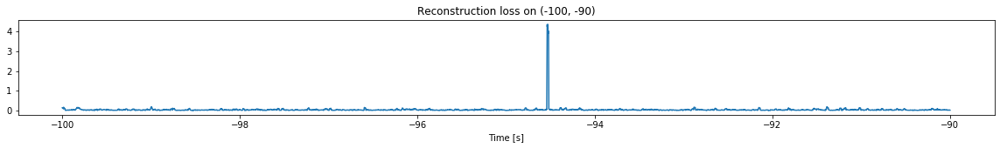

<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


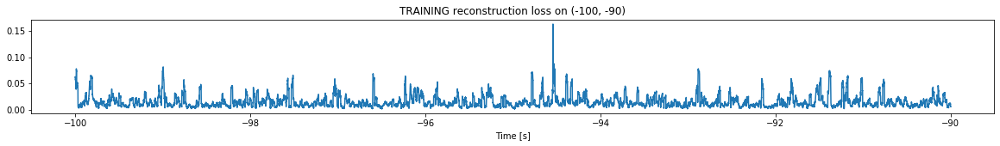

Finished training, median of the log(loss) is:  -1.9062098093684035
Triggering for section:  (-90, -80)
Using this median for triggering: -1.682779771925502


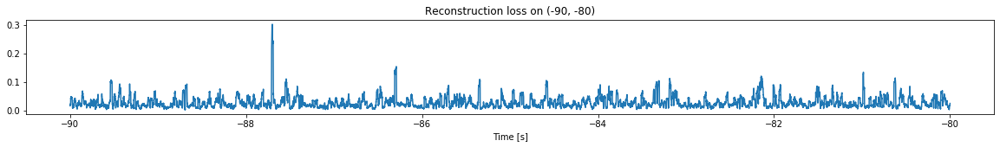

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


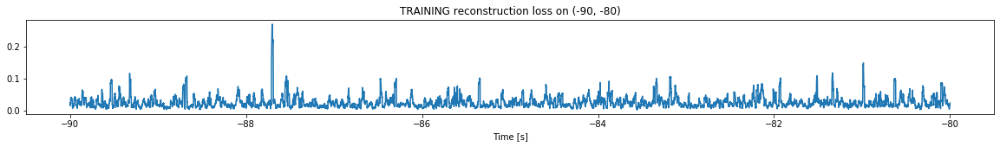

Finished training, median of the log(loss) is:  -1.6544281496953848
Triggering for section:  (-80, -70)
Using this median for triggering: -1.9062098093684035


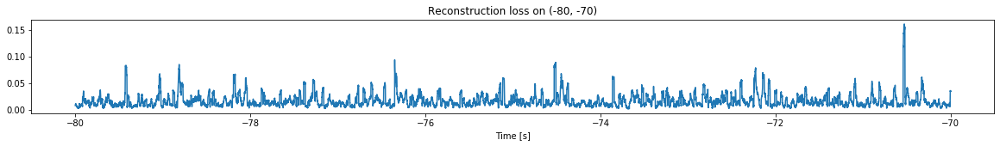

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


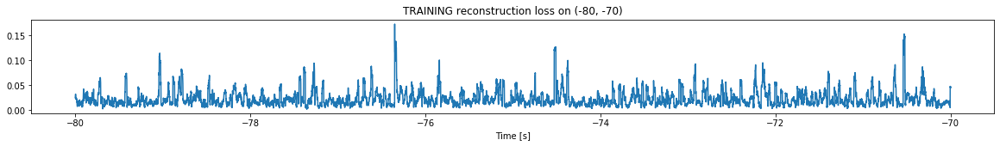

Finished training, median of the log(loss) is:  -1.7179964582106457
Triggering for section:  (-70, -60)
Using this median for triggering: -1.6544281496953848


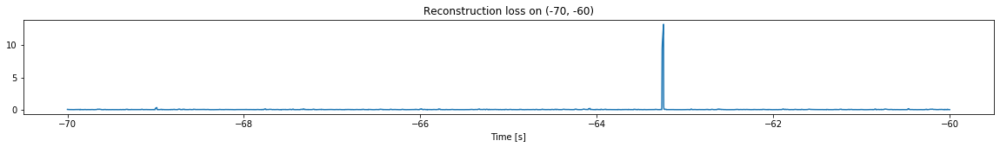

Other trigger time:  [-63.242798]
Their log loss values are:  [2.77598741]


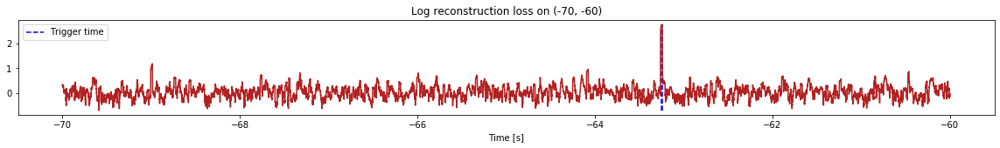

Triggered at:  [-63.242798]
<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


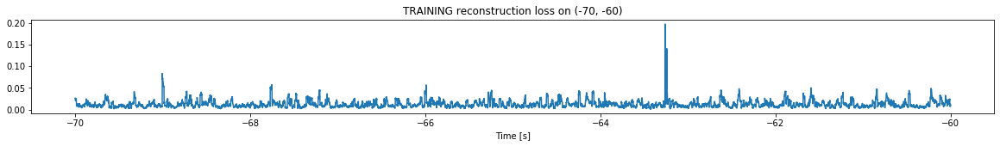

Finished training, median of the log(loss) is:  -1.9801635886331606
Triggering for section:  (-60, -50)
Using this median for triggering: -1.7179964582106457


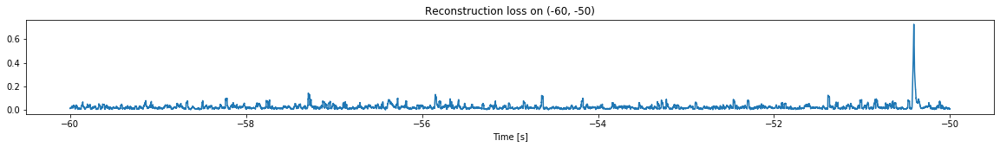

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


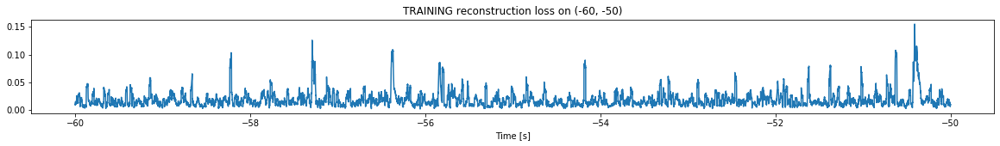

Finished training, median of the log(loss) is:  -1.8153220053616428
Triggering for section:  (-50, -40)
Using this median for triggering: -1.9801635886331606


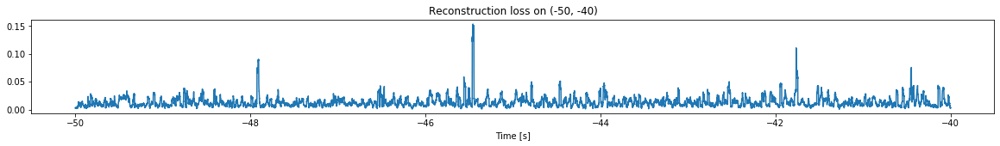

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


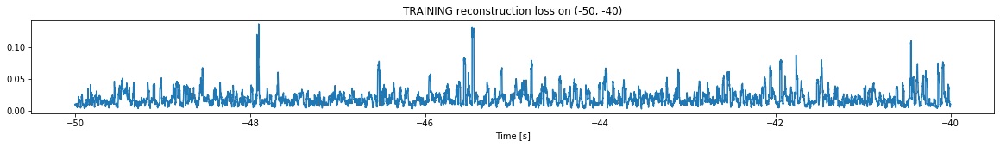

Finished training, median of the log(loss) is:  -1.7706979495376247
Triggering for section:  (-40, -30)
Using this median for triggering: -1.8153220053616428


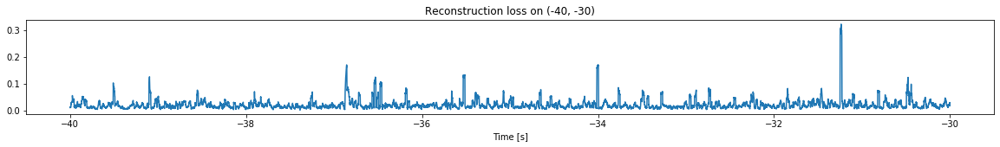

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


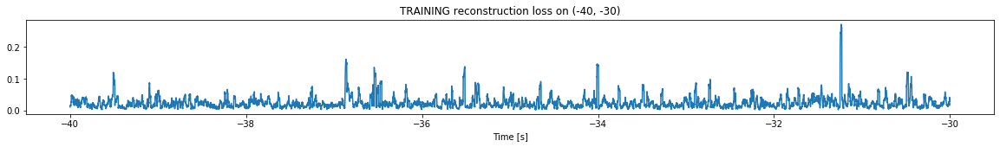

Finished training, median of the log(loss) is:  -1.682942489425612
Triggering for section:  (-30, -20)
Using this median for triggering: -1.7706979495376247


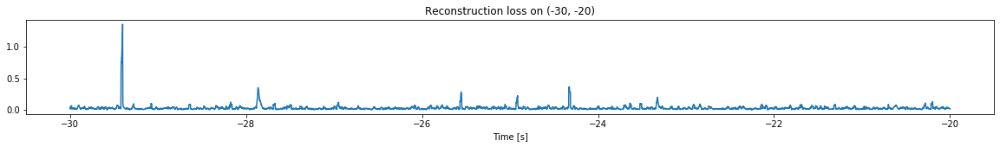

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


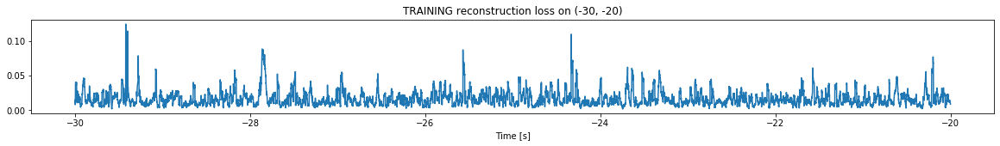

Finished training, median of the log(loss) is:  -1.8407537547113195
Triggering for section:  (-20, -10)
Using this median for triggering: -1.682942489425612


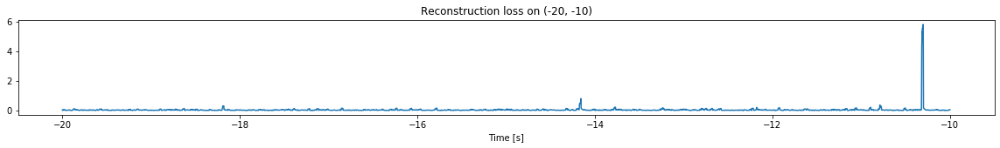

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


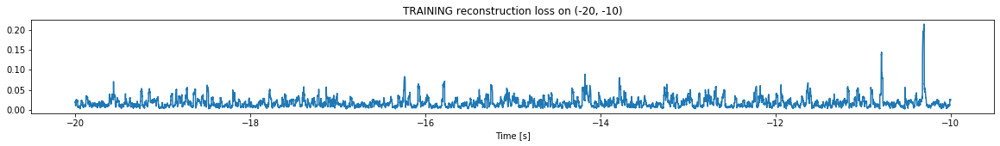

Finished training, median of the log(loss) is:  -1.8277706939667144
Triggering for section:  (-10, 0)
Using this median for triggering: -1.8407537547113195


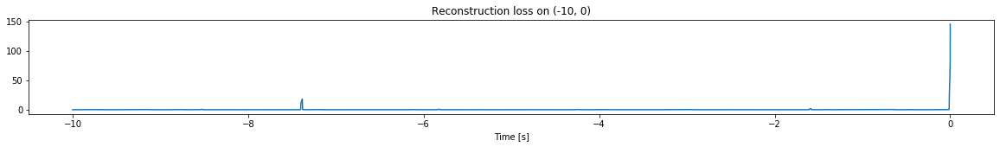

Other trigger time:  [-7.3820996]
Their log loss values are:  [3.09616287]


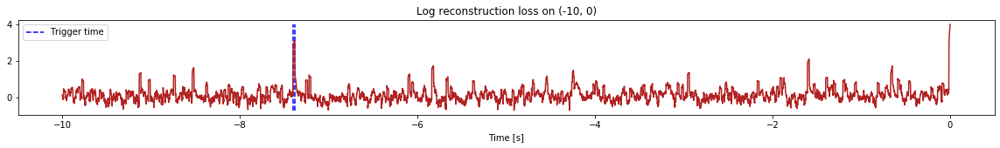

Triggered at:  [-7.3820996]
<--------
Finished simulation, all the triggered times are:  [-63.242798, -7.3820996]


In [16]:
simulation("./data/Ramp30/", 10, (-120,0))